# Assignment 2

In [ ]:
Students:
    
    

In this assingment, we implement two agents: A simple reflex agent, and a model based reflex agent. The former acts solely on the input it is perceiving from the environment, while the model based reflex agent creates an inner model of its environment, remembering important things that helps it take better decisions.

These two agents will act on two different environments, a partially and a fully observable one. The first environment will allow the agents to see only the tiles next to them, while the second environment will show the content of all the tiles at any gien moment. In this regard, the model based agent has a big advantage over the simple reflex agent, as it will be able to remember the items from the tiles it has observed, unlike the simple reflex agent which will not be able to recall the state of the world, and therefore, will not know what is there in the tiles already explored in the partially obserbable environment. For the fully observable environment, we expect the behaviour to be quite similar, as the only difference will be that the model based environment will be able to avoid re visiting tiles, which is an action that is penalised, but not severely, speciallyif the agent then visits a tile containing gold.

# 1.0 Coding

## 1.1 Libraries

In [46]:
from agents import Environment, Thing, Agent, Direction, SimpleReflexAgentProgram
from random import randrange, seed
import matplotlib.pyplot as plt 
#import matplotlib
from matplotlib.pyplot import figure

# 1.2 Coding the grid environment

In [2]:
class GridEnvironment(Environment):
    def __init__(self, things, agent, fully_observable = True, width = 5, height = 5):
        super().__init__()
        
        self.fully_observable = fully_observable
        
        self.step_num = 0 
        self.width  = width
        self.score_history=[]
        self.agent_position_history = []
        self.height  = height
        self.x_start, self.y_start = (0, 0)
        self.x_end, self.y_end = (self.width - 1, self.height  - 1)
        
        for thing in things: self.things.append(thing)
        self.things.append(agent)
        
        self.agent = agent
        self.agent.performance = 100
        self.agent_visited_cells = [agent.location]
        if self.agent.internal_state != None: 
            self.agent.internal_state = self.percept()["things"]
        
        if not self.fully_observable and self.agent.visited_cells != None:
            known_cells = []
            for visited_cell in self.agent.visited_cells:
                x, y = self.agent.location
                known_cells = self.agent.known_cells
                if (x, y) not in known_cells and self.is_inbounds((x, y)): known_cells.append((x, y))
                if (x - 1, y) not in known_cells and self.is_inbounds((x - 1, y)): known_cells.append((x - 1, y))
                if (x + 1, y) not in known_cells and self.is_inbounds((x + 1, y)): known_cells.append((x + 1, y))
                if (x, y - 1) not in known_cells and self.is_inbounds((x, y - 1)): known_cells.append((x, y - 1))
                if (x, y + 1) not in known_cells and self.is_inbounds((x, y + 1)): known_cells.append((x, y + 1))
                if (x - 1, y - 1) not in known_cells and self.is_inbounds((x - 1, y - 1)): known_cells.append((x - 1, y - 1))
                if (x - 1, y + 1) not in known_cells and self.is_inbounds((x - 1, y + 1)): known_cells.append((x - 1, y + 1))
                if (x + 1, y - 1) not in known_cells and self.is_inbounds((x + 1, y - 1)): known_cells.append((x + 1, y - 1))
                if (x + 1, y + 1) not in known_cells and self.is_inbounds((x + 1, y + 1)): known_cells.append((x + 1, y + 1))
            self.agent.known_cells = known_cells
        elif self.agent.visited_cells != None:
            known_cells = []
            for y in range(self.height):
                for x in range(self.width):
                    known_cells.append((x,y))
            self.agent.known_cells = known_cells
        print("<STARTING>")
        self.print_environment_state()
        self.print_percept(self.percept())
        self.print_internal_state()
        
    def percept(self):
        percept = {}
        percept["location"] = self.agent.location
        percept["direction"] = self.agent.direction
        percept["things"] = self.things if self.fully_observable else [thing for thing in self.things if (thing.location[0] >= self.agent.location[0] - 1 and thing.location[0] <= self.agent.location[0] + 1) and (thing.location[1] >= self.agent.location[1] - 1 and thing.location[1] <= self.agent.location[1] + 1)]
        return percept
                
    def is_done(self):
        no_gold = not any(isinstance(thing, Gold) for thing in self.things)
        dead_agent = not self.agent.is_alive()
        return dead_agent or no_gold
    
    def step(self):       
        if self.is_done(): return
        self.step_num += 1
        action = self.agent.program(self.percept())
        self.execute_action(action)
        
        print("<STEP {0}>".format(self.step_num))
        print("SELECTED ACTION: {0}".format(action.capitalize()))
        self.print_environment_state()
        self.print_percept(self.percept())
        self.print_internal_state()
        
    def execute_action(self, action):
        if action == "turn":
            self.agent.turn()
            self.agent.performance -= 1
        elif action == "advance":
            self.agent.performance -=1
            new_location  = self.agent.direction.move_forward(self.agent.location) 
            outside_grid = not self.is_inbounds(new_location)
            if not outside_grid: self.agent.advance()
            if self.agent.location in self.agent_visited_cells: self.agent.performance -=2
            else: self.agent_visited_cells.append(self.agent.location)
            if self.agent.internal_state != None:
                things = self.percept()["things"]
                internal_state = things
                things_locations = [thing.location for thing in things]
                for thing in self.agent.internal_state:
                    if thing.location not in things_locations:
                        internal_state.append(thing)  
                self.agent.internal_state = internal_state
            if self.agent.known_cells != None:
                x, y = self.agent.location
                known_cells = self.agent.known_cells
                if (x, y) not in known_cells and self.is_inbounds((x, y)): known_cells.append((x, y))
                if (x - 1, y) not in known_cells and self.is_inbounds((x - 1, y)): known_cells.append((x - 1, y))
                if (x + 1, y) not in known_cells and self.is_inbounds((x + 1, y)): known_cells.append((x + 1, y))
                if (x, y - 1) not in known_cells and self.is_inbounds((x, y - 1)): known_cells.append((x, y - 1))
                if (x, y + 1) not in known_cells and self.is_inbounds((x, y + 1)): known_cells.append((x, y + 1))
                if (x - 1, y - 1) not in known_cells and self.is_inbounds((x - 1, y - 1)): known_cells.append((x - 1, y - 1))
                if (x - 1, y + 1) not in known_cells and self.is_inbounds((x - 1, y + 1)): known_cells.append((x - 1, y + 1))
                if (x + 1, y - 1) not in known_cells and self.is_inbounds((x + 1, y - 1)): known_cells.append((x + 1, y - 1))
                if (x + 1, y + 1) not in known_cells and self.is_inbounds((x + 1, y + 1)): known_cells.append((x + 1, y + 1))
                self.agent.known_cells = known_cells
        elif action == "stay":
            pass
        
        golds = self.list_things_at(self.agent.location, tclass = Gold)
        if len(golds) != 0:
            if self.agent.dig(golds[0]):
#                 if self.agent.internal_state != None: self.agent.internal_state.remove(golds[0])
                self.delete_thing(golds[0])
                self.agent.performance += 10
        traps = self.list_things_at(self.agent.location, tclass = Trap)
        if len(traps) != 0:
            if self.agent.get_trapped(traps[0]):
#                 if self.agent.internal_state != None: self.agent.internal_state.remove(traps[0])
                self.delete_thing(traps[0])     
                self.agent.performance -= 5
        self.agent_position_history.append(self.agent.location)
                
    def is_inbounds(self, location):
        x, y = location
        return not (x < self.x_start or x > self.x_end or y < self.y_start or y > self.y_end)
    
    def print_environment_state(self):
        print("Agent state: ({0}, {1}, {2})".format(self.agent.location[0], self.agent.location[1], self.agent.direction.direction.capitalize()))
        state_msg = ""
        for y in range(self.height + 2):
            for x in range(self.width + 1):
                cell = (x - 1, y - 2)
                if y == 0: state_msg += "    {0}   ".format(cell[0]) if x != 0 else " "
                elif y == 1: state_msg += " (A G T)" if x != 0  else " "
                elif x == 0: state_msg += str(cell[1])
                else:
                    A = "V" if cell in self.agent_visited_cells else "-"
                    G = str(len(self.list_things_at(cell, tclass = Gold))) if self.some_things_at(cell, tclass = Gold) else "-"
                    T = str(len(self.list_things_at(cell, tclass = Trap))) if self.some_things_at(cell, tclass = Trap) else "-"
                    state_msg += " ({0} {1} {2})".format(A, G, T)
                if x == self.width and y != self.height + 1: state_msg += "\n"
        print(state_msg)
        print("Agent performance: {0}".format(self.agent.performance))
    
    def print_percept(self, percept):
        self.score_history.append(self.agent.performance)
        if not self.fully_observable:
            x , y = percept["location"]
            x_min = x - 1 if self.is_inbounds((x - 1, y)) else x
            x_max = x + 1 if self.is_inbounds((x + 1, y)) else x
            y_min = y - 1 if self.is_inbounds((x, y - 1)) else y
            y_max = y + 1 if self.is_inbounds((x, y + 1)) else y
        else: 
            x_min = 0
            x_max = self.width - 1
            y_min = 0
            y_max = self.height - 1
            
        percept_msg = ""
        for y in range(y_max + 3 - y_min):
            for x in range(x_max + 2 - x_min):
                cell = (x + x_min - 1, y + y_min - 2)
                if y == 0: percept_msg += "    {0}   ".format(cell[0]) if x != 0 else " "
                elif y == 1: percept_msg += " (A G T)" if x != 0  else " "
                elif x == 0: percept_msg += str(cell[1])
                else:
                    A = percept["direction"].direction.capitalize()[0] if percept["location"] == cell else "-"
                    G = str(len([thing for thing in percept["things"] if thing.location == cell and isinstance(thing, Gold)]))
                    T = str(len([thing for thing in percept["things"] if thing.location == cell and isinstance(thing, Trap)]))
                    percept_msg += " ({0} {1} {2})".format(A, G if G != "0" else "-", T if T != "0" else "-")
                if x == x_max - x_min + 1 and y != y_max - y_min + 2: percept_msg += "\n"
        print("PERCEPT")
        print(percept_msg)
        
    def print_internal_state(self):
        known_cells = []
        visited_cells = [self.agent.location] if self.agent.visited_cells == None else self.agent.visited_cells
        internal_state = self.percept()["things"] if self.agent.visited_cells == None else self.agent.internal_state
        if not self.fully_observable:
            for visited_cell in visited_cells:
                (x, y) = visited_cell
                if (x, y) not in known_cells and self.is_inbounds((x, y)): known_cells.append((x, y))
                if (x - 1, y) not in known_cells and self.is_inbounds((x - 1, y)): known_cells.append((x - 1, y))
                if (x + 1, y) not in known_cells and self.is_inbounds((x + 1, y)): known_cells.append((x + 1, y))
                if (x, y - 1) not in known_cells and self.is_inbounds((x, y - 1)): known_cells.append((x, y - 1))
                if (x, y + 1) not in known_cells and self.is_inbounds((x, y + 1)): known_cells.append((x, y + 1))
                if (x - 1, y - 1) not in known_cells and self.is_inbounds((x - 1, y - 1)): known_cells.append((x - 1, y - 1))
                if (x - 1, y + 1) not in known_cells and self.is_inbounds((x - 1, y + 1)): known_cells.append((x - 1, y + 1))
                if (x + 1, y - 1) not in known_cells and self.is_inbounds((x + 1, y - 1)): known_cells.append((x + 1, y - 1))
                if (x + 1, y + 1) not in known_cells and self.is_inbounds((x + 1, y + 1)): known_cells.append((x + 1, y + 1))
        else:
            for y in range(self.height):
                for x in range(self.width):
                    known_cells.append((x,y))
        state_msg = ""
        for y in range(self.height + 2):
            for x in range(self.width + 1):
                cell = (x - 1, y - 2)
                if y == 0: state_msg += "    {0}   ".format(cell[0]) if x != 0 else " "
                elif y == 1: state_msg += " (A G T)" if x != 0  else " "
                elif x == 0: state_msg += str(cell[1])
                else:
                    A = "?" if cell not in known_cells else "V" if cell in visited_cells else "-"
                    G = "?" if cell not in known_cells else str(len([thing for thing in internal_state if isinstance(thing, Gold) and thing.location == cell]))
                    T = "?" if cell not in known_cells else str(len([thing for thing in internal_state if isinstance(thing, Trap) and thing.location == cell]))
                    state_msg += " ({0} {1} {2})".format(A, G if G != "0" else "-", T if T != "0" else "-")
                if x == self.width and y != self.height + 1: state_msg += "\n"
        print("AGENT'S INTERNAL STATE")
        print(state_msg)
        

## 1.3 Coding the Gold and Trap classes, and the skeleton for both agents

In [3]:
class Gold(Thing):
    def __init__(self, location):
        self.location = location
        
class Trap(Thing):
    def __init__(self, location):
        self.location = location
class GoldDiggerAgent():
    def __init__(self, location, direction):
        self.location = location
        self.direction = direction  
        self.visited_cells = None
        self.internal_state = None
        self.known_cells = None

    def turn(self):
        self.direction += Direction.R
        
    def advance(self):
        self.location = self.direction.move_forward(self.location)
            
    def dig(self, thing):
        if isinstance(thing, Gold):
            return True
        return False
    
    def get_trapped(self, thing):
        if isinstance(thing, Trap):
            return True
        return False
    
    def is_alive(self):
        return self.performance > 0

## 1.4 Coding the simple reflex agent

In [4]:
class ReflexGoldDiggerAgent(GoldDiggerAgent):
    def __init__(self, location, direction):
        super().__init__(location,direction)
    def program(self, percept):
        location = percept["location"]
        direction = percept["direction"]
        things = percept["things"]

        things_in_front = []
        front_location = location
        for i in range(4):
            front_location = direction.move_forward(front_location)
            things_in_front += [thing for thing in things if thing.location == front_location]


        things_to_the_right = []
        right_location = location
        for i in range(4):
            right_location = (direction + Direction.R).move_forward(right_location)   
            things_to_the_right += [thing for thing in things if thing.location == right_location]


        things_behind = []
        back_location = location
        for i in range(4):
            back_location = (direction + Direction.R + Direction.R).move_forward(back_location)  
            things_behind += [thing for thing in things if thing.location == back_location]


        things_to_the_left = []
        left_location = location
        for i in range(4):
            left_location = (direction + Direction.L).move_forward(left_location)  
            things_to_the_left += [thing for thing in things if thing.location == left_location]

        front_location = direction.move_forward(location)
        right_location = (direction + Direction.R).move_forward(location)
        left_location  = (direction + Direction.L).move_forward(location)
        back_location  = (direction + Direction.R + Direction.R).move_forward(location)

        things_in_cell = [thing for thing in things if thing.location == location]

        things_directly_in_front = [thing for thing in things if thing.location == front_location]

        things_directly_around = [thing for thing in things if thing.location == right_location or thing.location == left_location or thing.location == back_location] 

        num_golds_in_front = len([thing for thing in things_in_front if isinstance(thing, Gold)])
        num_traps_in_front = len([thing for thing in things_in_front if isinstance(thing, Trap)])

        num_golds_to_the_right = len([thing for thing in things_to_the_right if isinstance(thing, Gold)])
        num_traps_to_the_right = len([thing for thing in things_to_the_right if isinstance(thing, Trap)])

        num_golds_behind = len([thing for thing in things_behind if isinstance(thing, Gold)])
        num_traps_behind  = len([thing for thing in things_behind if isinstance(thing, Trap)])

        num_golds_to_the_left = len([thing for thing in things_to_the_left if isinstance(thing, Gold)])
        num_traps_to_the_left  = len([thing for thing in things_to_the_left if isinstance(thing, Trap)])

        options = []
        options.append(num_golds_in_front - num_traps_in_front if num_golds_in_front > 0 else -1000)
        options.append(num_golds_to_the_right - num_traps_to_the_right if num_golds_to_the_right > 0 else -1000)
        options.append(num_golds_behind - num_traps_behind if num_golds_behind > 0 else -1000)
        options.append(num_golds_to_the_left - num_traps_to_the_left if num_golds_to_the_left > 0 else -1000)

        better_option = options.index(max(options))  

        if front_location[0] < 0 or front_location[0] > 4 or front_location[1] < 0 or front_location[1] > 4:
            return "turn"

        if len(things_in_cell):
            if any(thing for thing in things_in_cell if isinstance(thing, Gold)):
                return "advance"
            elif any(thing for thing in things_in_cell if isinstance(thing, Trap)): 
                return "advance"
        if len(things_directly_in_front):
            if any(thing for thing in things_directly_in_front if isinstance(thing, Gold)):
                return "advance"        
            elif any(thing for thing in things_directly_in_front if isinstance(thing, Trap)):
                return "turn" if num_traps_in_front > num_golds_in_front else "advance"

        if len(things_directly_around):
            if any(thing for thing in things_directly_around if isinstance(thing, Gold)):
                if better_option != 0:
                    return "turn"
            if any(thing for thing in things_directly_around if isinstance(thing, Trap)):
                return "advance"

        if(better_option == 0):
            if len(things_in_front):
                return "advance"
        elif(better_option == 1):
            if len(things_to_the_right):
                return "turn"
        elif(better_option == 2):
            if len(things_behind):
                return "turn"
        elif(better_option == 3):
            if len(things_to_the_left):
                return "turn"
        return "advance" if randrange(3) < 2 else "turn"


## 1.5 Coding the Model Based Reflex Agent

In [5]:
class ModelGoldDiggerAgent(GoldDiggerAgent):
    def __init__(self, location, direction):
        super().__init__(location,direction)
        self.model = {"gold": 10, "advance": -1, "turn": -1, "trap": -5, "visited": -2}
        self.visited_cells = [location]
        self.internal_state = []
        self.known_cells = []
        
    def advance(self):
        super().advance()
        self.visited_cells.append(self.location)
        
    def program(self, percept):
        things = percept["things"]
        internal_state = things
        things_locations = [thing.location for thing in things]
        for thing in self.internal_state:
            if thing.location not in things_locations:
                internal_state.append(thing)  
        self.internal_state = internal_state
        location = percept["location"]
        direction = percept["direction"]
        things = self.internal_state
        
        things_in_front = []
        front_location = location
        for i in range(4):
            front_location = direction.move_forward(front_location)
            things_in_front += [thing for thing in things if thing.location == front_location]


        things_to_the_right = []
        right_location = location
        for i in range(4):
            right_location = (direction + Direction.R).move_forward(right_location)   
            things_to_the_right += [thing for thing in things if thing.location == right_location]


        things_behind = []
        back_location = location
        for i in range(4):
            back_location = (direction + Direction.R + Direction.R).move_forward(back_location)  
            things_behind += [thing for thing in things if thing.location == back_location]


        things_to_the_left = []
        left_location = location
        for i in range(4):
            left_location = (direction + Direction.L).move_forward(left_location)  
            things_to_the_left += [thing for thing in things if thing.location == left_location]

        front_location = direction.move_forward(location)
        right_location = (direction + Direction.R).move_forward(location)
        left_location  = (direction + Direction.L).move_forward(location)
        back_location  = (direction + Direction.R + Direction.R).move_forward(location)

        things_in_cell = [thing for thing in things if thing.location == location]

        things_directly_in_front = [thing for thing in things if thing.location == front_location]
        things_directly_around = [thing for thing in things if thing.location == right_location or thing.location == left_location or thing.location == back_location] 

        front_move_costs = []
        iterator = direction.move_forward(location)
        cost = 0
        while iterator in self.known_cells:
            cost += self.model["advance"]
            if any(thing for thing in things if isinstance(thing, Gold) and thing.location == iterator): cost += 10 * self.model["gold"]
            if any(thing for thing in things if isinstance(thing, Trap) and thing.location == iterator): cost += self.model["trap"]
            if iterator in self.visited_cells: cost += self.model["visited"]
            front_move_costs.append(cost)
            iterator = direction.move_forward(iterator)
        best_front_move = -1000 if front_move_costs == [] else max(front_move_costs)
        
        right_move_costs = []
        iterator = (direction + Direction.R).move_forward(location)
        cost = self.model["turn"]
        while iterator in self.known_cells:
            cost += self.model["advance"]
            if any(thing for thing in things if isinstance(thing, Gold) and thing.location == iterator): cost += 10 * self.model["gold"]
            if any(thing for thing in things if isinstance(thing, Trap) and thing.location == iterator): cost += self.model["trap"]
            if iterator in self.visited_cells: cost += self.model["visited"]
            right_move_costs.append(cost)
            iterator = (direction + Direction.R).move_forward(iterator)
        best_right_move = -1000 if right_move_costs == [] else max(right_move_costs)
        
        back_move_costs = []
        iterator = (direction + Direction.R + Direction.R).move_forward(location)
        cost = 2 * self.model["turn"]
        while iterator in self.known_cells:
            cost += self.model["advance"]
            if any(thing for thing in things if isinstance(thing, Gold) and thing.location == iterator): cost += 10 * self.model["gold"]
            if any(thing for thing in things if isinstance(thing, Trap) and thing.location == iterator): cost += self.model["trap"]
            if iterator in self.visited_cells: cost += self.model["visited"]
            back_move_costs.append(cost)
            iterator = (direction + Direction.R + Direction.R).move_forward(iterator)
        best_back_move = -1000 if back_move_costs == [] else max(back_move_costs)
        
        left_move_costs = []
        iterator = (direction + Direction.L).move_forward(location)
        cost = 3 * self.model["turn"]
        while iterator in self.known_cells:
            cost += self.model["advance"]
            if any(thing for thing in things if isinstance(thing, Gold) and thing.location == iterator): cost += 10 * self.model["gold"]
            if any(thing for thing in things if isinstance(thing, Trap) and thing.location == iterator): cost += self.model["trap"]
            if iterator in self.visited_cells: cost += self.model["visited"]
            left_move_costs.append(cost)
            iterator = (direction + Direction.L).move_forward(iterator)
        best_left_move = -1000 if left_move_costs == [] else max(left_move_costs)
        
        options = [best_front_move, best_right_move, best_back_move, best_left_move]
        better_option = options.index(max(options))  

        if front_location[0] < 0 or front_location[0] > 4 or front_location[1] < 0 or front_location[1] > 4:
            return "turn"
        if len(things_in_cell):
            if any(thing for thing in things_in_cell if isinstance(thing, Gold)):
                return "stay"
            elif any(thing for thing in things_in_cell if isinstance(thing, Trap)): 
                return "advance"
        if any(thing for thing in things_directly_in_front if isinstance(thing, Gold)):
                return "advance"        
        if any(thing for thing in things_directly_around if isinstance(thing, Gold)):
                return "turn"
        if better_option != 0: 
            return "turn"
        else: 
            return "advance"
        return "advance"

# 2.0 Testing the framework

## 2.1 Creating a gold mine with traps

In [73]:
width = 5
height = 5

directions = [Direction.U, Direction.R, Direction.D, Direction.L]
total_golds = 5
total_traps = 5

things = []

for i in range(total_golds):
    x = randrange(width)
    y = randrange(height)
    things.append(Gold((x,y)))
    
while total_traps > 0:
    total_traps -= 1
    x = randrange(width)
    y = randrange(height)
    things.append(Trap((x,y)))

agent_x = randrange(width)
agent_y = randrange(height)
agent_dir = directions[randrange(4)]

n = randrange(1000)
print(n)
seed(n)

361


## 2.2 Running the Simple Reflex agent in a Partially Observable environment

In [74]:
agent = ReflexGoldDiggerAgent((agent_x, agent_y), Direction(agent_dir))
environment = GridEnvironment(things = things, agent = agent, fully_observable = False, width = width, height = height)
environment.run()
nonobservable_reflex_score = environment.score_history
nonobservable_reflex_history = environment.agent_position_history

<STARTING>
Agent state: (0, 2, Up)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - -) (- - -) (- 1 -) (- - -)
1 (- - -) (- - -) (- - -) (- - -) (- - -)
2 (V - -) (- - 1) (- 2 -) (- - -) (- - -)
3 (- - -) (- - 2) (- - -) (- 1 -) (- 1 1)
4 (- - 1) (- - -) (- - -) (- - -) (- - -)
Agent performance: 100
PERCEPT
     0       1   
  (A G T) (A G T)
1 (- - -) (- - -)
2 (U - -) (- - 1)
3 (- - -) (- - 2)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
1 (- - -) (- - -) (? ? ?) (? ? ?) (? ? ?)
2 (V - -) (- - 1) (? ? ?) (? ? ?) (? ? ?)
3 (- - -) (- - 2) (? ? ?) (? ? ?) (? ? ?)
4 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
<STEP 1>
SELECTED ACTION: Advance
Agent state: (0, 1, Up)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - -) (- - -) (- 1 -) (- - -)
1 (V - -) (- - -) (- - -) (- - -) (- - -)
2 (V - 

### The agent interacts with the environment as it is expected. Its behaviour will be analysed in forth coming sections. The agent doesn't create an inner representation of the outside world, and therefore, it has access only to the information that is presented to it by the environment.

## 2.3 Running the Model Based agent in a Partially Observable environment

In [75]:
agent = ModelGoldDiggerAgent((agent_x, agent_y), Direction(agent_dir))
environment = GridEnvironment(things = things, agent = agent, fully_observable = False, width = width, height = height)
environment.run()
nonobservable_model_score = environment.score_history
nonobservable_model_history = environment.agent_position_history

<STARTING>
Agent state: (0, 2, Up)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - -) (- - -) (- 1 -) (- - -)
1 (- - -) (- - -) (- - -) (- - -) (- - -)
2 (V - -) (- - 1) (- 2 -) (- - -) (- - -)
3 (- - -) (- - 2) (- - -) (- 1 -) (- 1 1)
4 (- - 1) (- - -) (- - -) (- - -) (- - -)
Agent performance: 100
PERCEPT
     0       1   
  (A G T) (A G T)
1 (- - -) (- - -)
2 (U - -) (- - 1)
3 (- - -) (- - 2)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
1 (- - -) (- - -) (? ? ?) (? ? ?) (? ? ?)
2 (V - -) (- - 1) (? ? ?) (? ? ?) (? ? ?)
3 (- - -) (- - 2) (? ? ?) (? ? ?) (? ? ?)
4 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
<STEP 1>
SELECTED ACTION: Advance
Agent state: (0, 1, Up)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - -) (- - -) (- 1 -) (- - -)
1 (V - -) (- - -) (- - -) (- - -) (- - -)
2 (V - 

### In the output, the internal state of the agent shows how it creates an internal representation of the world. And its knowledge of its surroundings is enriched every time it travels to a tile that allows it to explore beyond its current knowledge.

## 2.4 Running the simple reflex agent in a fully observable environment

In [76]:
agent = ReflexGoldDiggerAgent((agent_x, agent_y), Direction(agent_dir))
environment = GridEnvironment(things = things, agent = agent, fully_observable = True, width = width, height = height)
environment.run()
observable_reflex_score = environment.score_history
observable_reflex_history = environment.agent_position_history

<STARTING>
Agent state: (0, 2, Up)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - -) (- - -) (- 1 -) (- - -)
1 (- - -) (- - -) (- - -) (- - -) (- - -)
2 (V - -) (- - 1) (- 2 -) (- - -) (- - -)
3 (- - -) (- - 2) (- - -) (- 1 -) (- 1 1)
4 (- - 1) (- - -) (- - -) (- - -) (- - -)
Agent performance: 100
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - -) (- - -) (- 1 -) (- - -)
1 (- - -) (- - -) (- - -) (- - -) (- - -)
2 (U - -) (- - 1) (- 2 -) (- - -) (- - -)
3 (- - -) (- - 2) (- - -) (- 1 -) (- 1 1)
4 (- - 1) (- - -) (- - -) (- - -) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - -) (- - -) (- 1 -) (- - -)
1 (- - -) (- - -) (- - -) (- - -) (- - -)
2 (V - -) (- - 1) (- 2 -) (- - -) (- - -)
3 (- - -) (- - 2) (- - -) (- 1 -) (- 1 1)
4 (- - 1) (- - -) (- - -) (- - -) (- - -)
<STEP 1>
SELECTED ACTION: Adv

### In this case, the inner representation of the agent is always equal to the acual map of the environment.

## 2.5 Running the model based agent in a fuly observable environment.

In [77]:
agent = ModelGoldDiggerAgent((agent_x, agent_y), Direction(agent_dir))
environment = GridEnvironment(things = things, agent = agent, fully_observable = True, width = width, height = height)
environment.run()

observable_model_score = environment.score_history
observable_model_history = environment.agent_position_history

<STARTING>
Agent state: (0, 2, Up)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - -) (- - -) (- 1 -) (- - -)
1 (- - -) (- - -) (- - -) (- - -) (- - -)
2 (V - -) (- - 1) (- 2 -) (- - -) (- - -)
3 (- - -) (- - 2) (- - -) (- 1 -) (- 1 1)
4 (- - 1) (- - -) (- - -) (- - -) (- - -)
Agent performance: 100
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - -) (- - -) (- 1 -) (- - -)
1 (- - -) (- - -) (- - -) (- - -) (- - -)
2 (U - -) (- - 1) (- 2 -) (- - -) (- - -)
3 (- - -) (- - 2) (- - -) (- 1 -) (- 1 1)
4 (- - 1) (- - -) (- - -) (- - -) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - -) (- - -) (- 1 -) (- - -)
1 (- - -) (- - -) (- - -) (- - -) (- - -)
2 (V - -) (- - 1) (- 2 -) (- - -) (- - -)
3 (- - -) (- - 2) (- - -) (- 1 -) (- 1 1)
4 (- - 1) (- - -) (- - -) (- - -) (- - -)
<STEP 1>
SELECTED ACTION: Tur

### The agent has access to all the information of the environment. It also knows where it has already been, so it can avoid being there in further actions, and be penalised.

# 3.0 Analysis

## 3.1 Plotting the performance measures against the turns.

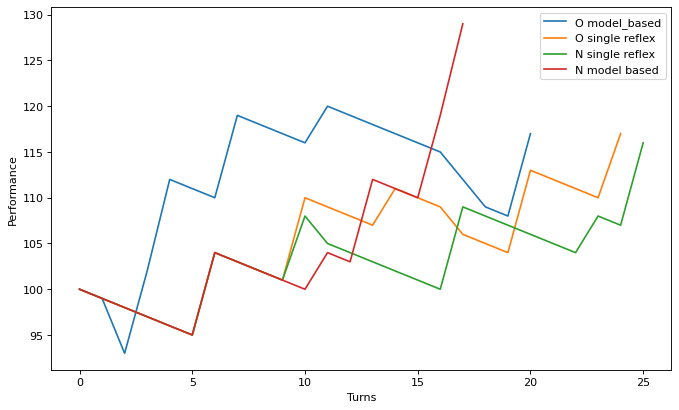

In [85]:
figure(num=None, figsize=(10, 6), dpi=80, facecolor='w', edgecolor='k')
plt.plot(observable_model_score, label = 'O model_based')
plt.plot(observable_reflex_score, label = 'O single reflex')
plt.plot(nonobservable_reflex_score, label = 'N single reflex')
plt.plot(nonobservable_model_score, label = 'N model based')
plt.xlabel('Turns')
plt.ylabel('Performance')
plt.legend()
plt.show()

### For some cases, the model based agents were the worst performers, maybe beacuse they do not want to re visit already visited tiles, which reduces the searh space for their solution, and may lead to worse results, at least in the presented configuration with 5 gold and 5 traps. More combinations of gold and traps are presented in further sections.

## 3.2 Visualizing the trajectory of the agents

In [86]:
def plot_trajectory(history, ax, text):
    size = 2000
    iterator = 1
    norms = []
    colors = []
    ln = len(history)
    for element in history:
        #size = -9990/(len(environment.agent_position_history)+1)*iterator +10000
        s_norm =iterator/ln
        #print(iterator/ln)
        #print(s_norm)
        norms.append(s_norm)
        colors.append([s_norm, s_norm, s_norm])
        iterator +=1

    colourmap = matplotlib.colors.ListedColormap(colors)
    norm_full = matplotlib.colors.Normalize(vmin=0, vmax=ln)
    iterator = 1
    for element in history:
        ax.scatter(element[1], element[0], s = size, c=ln-iterator, cmap = 'plasma', norm = norm_full, linewidths = 1, edgecolors = 'black')
        ax.set_title(text)
        size *= 0.9
        iterator +=1

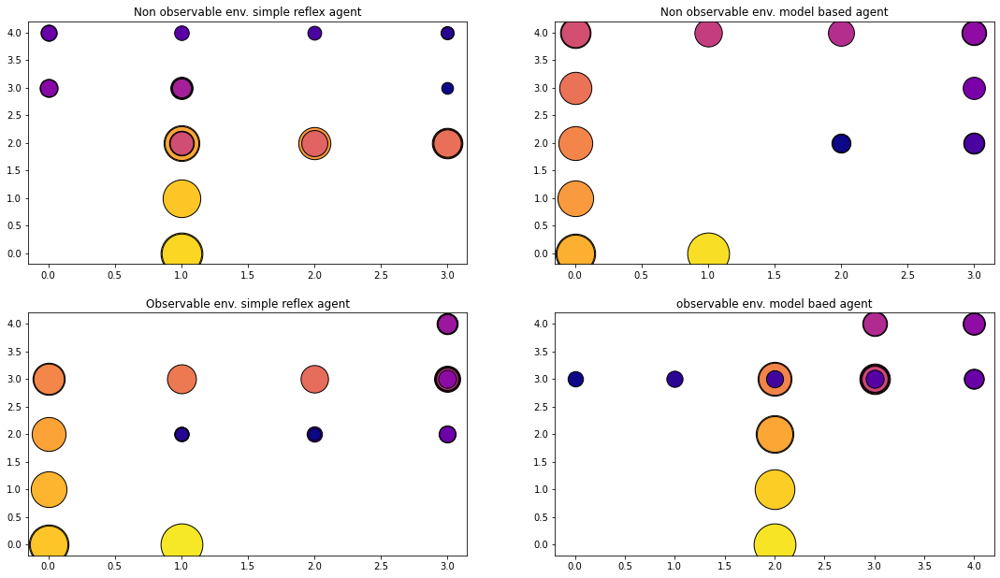

In [87]:
fig, ax = plt.subplots(2,2)
plot_trajectory(nonobservable_reflex_history, ax[0,0],'Non observable env. simple reflex agent')
plot_trajectory(nonobservable_model_history, ax[0,1], 'Non observable env. model based agent')
plot_trajectory(observable_reflex_history, ax[1,0], 'Observable env. simple reflex agent')
plot_trajectory(observable_model_history, ax[1,1], 'observable env. model baed agent')
fig.set_size_inches(18.5, 10.5)
fig.savefig('roads.jpg', dpi=200)

### This visualisation technique shows the first step of the agent in yellow, with a predefined size, and plots further positions of the agent with every time smaller circles, that are colour mapped to every time darker shades, that end up being small blue dots. 

### In general, the model based agents tend to have less overlap than the simple reflex agents, as they have a model that tells them the tiles they should avoid.

## 3.3 Testing for different combinations of gold and traps.

In [88]:
def run_experiment(n_gold, n_traps):
    
    width = 5
    height = 5

    directions = [Direction.U, Direction.R, Direction.D, Direction.L]
    total_golds = n_gold
    total_traps = n_traps

    things = []

    for i in range(total_golds):
        x = randrange(width)
        y = randrange(height)
        things.append(Gold((x,y)))

    while total_traps > 0:
        total_traps -= 1
        x = randrange(width)
        y = randrange(height)
        things.append(Trap((x,y)))

    agent_x = randrange(width)
    agent_y = randrange(height)
    agent_dir = directions[randrange(4)]

    n = randrange(1000)
    print(n)
    seed(n)
    
    agent = ReflexGoldDiggerAgent((agent_x, agent_y), Direction(agent_dir))
    environment = GridEnvironment(things = things, agent = agent, fully_observable = False, width = width, height = height)
    environment.run()
    nonobservable_reflex_score = environment.score_history
    
    agent = ModelGoldDiggerAgent((agent_x, agent_y), Direction(agent_dir))
    environment = GridEnvironment(things = things, agent = agent, fully_observable = False, width = width, height = height)
    environment.run()
    nonobservable_model_score = environment.score_history
    
    agent = ReflexGoldDiggerAgent((agent_x, agent_y), Direction(agent_dir))
    environment = GridEnvironment(things = things, agent = agent, fully_observable = True, width = width, height = height)
    environment.run()
    observable_reflex_score = environment.score_history
    
    agent = ModelGoldDiggerAgent((agent_x, agent_y), Direction(agent_dir))
    environment = GridEnvironment(things = things, agent = agent, fully_observable = True, width = width, height = height)
    environment.run()
    observable_model_score = environment.score_history
    
    return([nonobservable_reflex_score, nonobservable_model_score, observable_reflex_score, observable_model_score])

In [14]:
def plot_experiment(pro_array):
    plt.plot(pro_array[3], label = 'O model_based')
    plt.plot(pro_array[2], label = 'O single reflex')
    plt.plot(pro_array[0], label = 'N single reflex')
    plt.plot(pro_array[1], label = 'N model based')
    plt.xlabel('Turns')
    plt.ylabel('Performance')
    plt.legend()
    plt.show()
plot_experiment(array5)

## 3.4 Runnig same number of traps and gold

In [15]:
array5 = run_experiment(5, 5)
array10 = run_experiment(10, 10)
array100 = run_experiment(100, 100)
array500 = run_experiment(500, 500)

30
<STARTING>
Agent state: (0, 0, Down)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - 2) (- - -) (- - -) (- 1 -) (- - -)
1 (- - -) (- 1 -) (- 1 -) (- - 1) (- - -)
2 (- - -) (- - -) (- - 1) (- - -) (- - -)
3 (- - -) (- - -) (- - -) (- - 1) (- 1 -)
4 (- - -) (- - -) (- - -) (- 1 -) (- - -)
Agent performance: 100
PERCEPT
     0       1   
  (A G T) (A G T)
0 (D - 2) (- - -)
1 (- - -) (- 1 -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - 2) (- - -) (? ? ?) (? ? ?) (? ? ?)
1 (- - -) (- 1 -) (? ? ?) (? ? ?) (? ? ?)
2 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
3 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
4 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
<STEP 1>
SELECTED ACTION: Advance
Agent state: (0, 1, Down)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - 2) (- - -) (- - -) (- 1 -) (- - -)
1 (V - -) (- 1 -) (- 1 -) (- - 1) (- - -)
2 (- - -) (- - -) 

4 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
<STEP 28>
SELECTED ACTION: Turn
Agent state: (3, 0, Up)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- 1 -) (- - 1) (V - -) (V - -)
1 (- 1 -) (- - 1) (- - -) (V - -) (- - -)
2 (- - -) (- - 1) (- - 1) (V - -) (V - -)
3 (- 1 1) (- - -) (- 1 -) (- - -) (- - -)
4 (- 1 1) (- 1 -) (- - 1) (- - -) (- 1 -)
Agent performance: 77
PERCEPT
     2       3       4   
  (A G T) (A G T) (A G T)
0 (- - 1) (U - -) (- - -)
1 (- - -) (- - -) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (? ? ?) (? ? ?) (- - 1) (V - -) (- - -)
1 (? ? ?) (? ? ?) (- - -) (- - -) (- - -)
2 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
3 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
4 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
<STEP 29>
SELECTED ACTION: Turn
Agent state: (3, 0, Right)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- 1

<STEP 26>
SELECTED ACTION: Turn
Agent state: (0, 0, Right)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - -) (- - 1) (- 1 -) (- 1 2)
1 (V - -) (- - 1) (- - -) (- - -) (- - -)
2 (V - -) (- - 1) (- - 1) (- 1 1) (V - -)
3 (V - -) (- - -) (- 1 -) (- - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - -)
Agent performance: 113
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (R - -) (- - -) (- - 1) (- 1 -) (- 1 2)
1 (- - -) (- - 1) (- - -) (- - -) (- - -)
2 (- - -) (- - 1) (- - 1) (- 1 1) (- - -)
3 (- - -) (- - -) (- 1 -) (- - -) (- - -)
4 (- - -) (- - -) (- - -) (- - -) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (- - -) (- - 1) (- 1 -) (- 1 2)
1 (- - -) (- - 1) (- - -) (- - -) (- - -)
2 (- - -) (- - 1) (- - 1) (- 1 1) (- - -)
3 (- - -) (- - -) (- 1 -) (- - -) (- - -)
4 (- - -) (- - -) (- - -) (- - -) (- - -)
<STEP

PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (U - -) (- - -) (- - 1) (- - -) (- - -)
1 (- - -) (- - 1) (- - -) (- - -) (- - -)
2 (- - -) (- - 1) (- - 1) (- - -) (- - -)
3 (- - -) (- - -) (- 1 -) (- - -) (- - -)
4 (- - -) (- - -) (- - -) (- - -) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - -) (- - 1) (V - -) (V - -)
1 (V - -) (- - 1) (- - -) (V - -) (V - -)
2 (V - -) (- - 1) (- - 1) (V - -) (V - -)
3 (V - -) (- - -) (- 1 -) (- - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - -)
<STEP 78>
SELECTED ACTION: Turn
Agent state: (0, 0, Right)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - -) (- - 1) (V - -) (V - -)
1 (V - -) (- - 1) (- - -) (V - -) (V - -)
2 (V - -) (- - 1) (- - 1) (V - -) (V - -)
3 (V - -) (- - -) (- 1 -) (- - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - -)
Agent performance: 46
PERCEP

4 (V - -) (V 2 1) (V - -) (V - -) (V - 5)
Agent performance: 283
PERCEPT
     1       2       3   
  (A G T) (A G T) (A G T)
3 (- 1 3) (- 4 -) (- 2 3)
4 (- 2 1) (L - -) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
1 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
2 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
3 (? ? ?) (- 1 3) (- 4 -) (- 2 3) (? ? ?)
4 (? ? ?) (- 2 1) (V - -) (- - -) (? ? ?)
<STEP 99>
SELECTED ACTION: Advance
Agent state: (1, 4, Left)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V 1 -) (V - -) (V - -) (V - 2)
1 (V - -) (V - -) (V - -) (V 3 1) (V - -)
2 (V 2 5) (- 7 4) (V - 2) (V 3 4) (V - 2)
3 (V 2 1) (- 1 3) (V 4 -) (V 2 3) (V 2 2)
4 (V - -) (V 1 -) (V - -) (V - -) (V - 5)
Agent performance: 285
PERCEPT
     0       1       2   
  (A G T) (A G T) (A G T)
3 (- 2 1) (- 1 3) (- 4 -)
4 (- - -) (L 1 -) (- - -)
AGENT'S INTERNAL

4 (V - -) (V - -) (V - -) (V - -) (V - 5)
Agent performance: 76
PERCEPT
     0       1       2   
  (A G T) (A G T) (A G T)
3 (- - -) (- - 1) (- - -)
4 (- - -) (R - -) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
1 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
2 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
3 (- - -) (- - 1) (- - -) (? ? ?) (? ? ?)
4 (- - -) (V - -) (- - -) (? ? ?) (? ? ?)
<STEP 288>
SELECTED ACTION: Advance
Agent state: (2, 4, Right)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V 1 -) (V - -) (V - -) (V - 2)
1 (V - -) (V - -) (V - -) (V - -) (V - -)
2 (V - 3) (- 7 4) (V - 1) (V - 1) (V - 2)
3 (V - -) (V - 1) (V - -) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - 5)
Agent performance: 73
PERCEPT
     1       2       3   
  (A G T) (A G T) (A G T)
3 (- - 1) (- - -) (- - -)
4 (- - -) (R - -) (- - -)
AGENT'S INTERNAL

4 (- 4 -) (- 6 5) (- 4 3) (- 4 4) (- - 9)
Agent performance: 451
PERCEPT
     0       1   
  (A G T) (A G T)
2 (- 6 9) (- 7 4)
3 (L 5 4) (- - 2)
4 (- 4 -) (- 6 5)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - -) (V - -) (V - -) (V - 4)
1 (V - 2) (V - -) (V - -) (V - -) (V - -)
2 (- 6 9) (- 7 4) (- 2 4) (- 4 5) (V - 2)
3 (V 6 5) (V - 2) (V - -) (V - 1) (V - -)
4 (- 4 -) (- 6 5) (- 4 3) (- 4 4) (- - 9)
<STEP 60>
SELECTED ACTION: Turn
Agent state: (0, 3, Up)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - -) (V - -) (V - -) (V - 4)
1 (V - 2) (V - -) (V - -) (V - -) (V - -)
2 (- 6 9) (- 7 4) (- 2 4) (- 4 5) (V - 2)
3 (V 4 3) (V - 2) (V - -) (V - 1) (V - -)
4 (- 4 -) (- 6 5) (- 4 3) (- 4 4) (- - 9)
Agent performance: 455
PERCEPT
     0       1   
  (A G T) (A G T)
2 (- 6 9) (- 7 4)
3 (U 4 3) (- - 2)
4 (- 4 -) (- 6 5)
AGENT'S INTERNAL STATE
     0       1       2    

4 (- 4 -) (- 6 5) (- 4 3) (- 4 4) (- - 9)
Agent performance: 145
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 4 -) (- 6 5) (- - -) (- 2 1) (R 1 5)
1 (- 2 4) (- 2 2) (- 4 2) (- 6 4) (- 4 3)
2 (- 6 9) (- 7 4) (- 2 4) (- 4 5) (- 2 4)
3 (- 6 5) (- 1 3) (- 6 2) (- 3 4) (- 4 4)
4 (- 4 -) (- 6 5) (- 4 3) (- 4 4) (- - 9)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 4 -) (- 6 5) (- - -) (- 2 1) (V 1 5)
1 (- 2 4) (- 2 2) (- 4 2) (- 6 4) (- 4 3)
2 (- 6 9) (- 7 4) (- 2 4) (- 4 5) (- 2 4)
3 (- 6 5) (- 1 3) (- 6 2) (- 3 4) (- 4 4)
4 (- 4 -) (- 6 5) (- 4 3) (- 4 4) (- - 9)
<STEP 11>
SELECTED ACTION: Turn
Agent state: (4, 0, Down)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V 4 -) (V 6 5) (V - -) (V 2 1) (V - 4)
1 (V 2 4) (V 2 2) (V 4 2) (V 6 4) (- 4 3)
2 (- 6 9) (- 7 4) (- 2 4) (- 4 5) (- 2 4)
3 (- 6 5) (- 1 3) (- 6 2) (- 3 4) (- 4 4)
4 (- 4

4 (- - -) (- 3 2) (- 1 -) (- - -) (- - 5)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- 4 3) (- - -) (- - -) (- - 2)
1 (- - 2) (- 2 2) (- 4 2) (- 5 3) (- 2 1)
2 (V 3 6) (- 7 4) (- 2 4) (- 3 4) (- - 2)
3 (- 3 2) (- 1 3) (- 6 2) (- 2 3) (- 2 2)
4 (- - -) (- 3 2) (- 1 -) (- - -) (- - 5)
<STEP 62>
SELECTED ACTION: Advance
Agent state: (0, 1, Up)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V 4 3) (V - -) (V - -) (V - 2)
1 (V - 1) (V 2 2) (V 4 2) (V 5 3) (V 2 1)
2 (V 3 6) (- 7 4) (- 2 4) (V 3 4) (V - 2)
3 (V 3 2) (- 1 3) (- 6 2) (V 2 3) (V 2 2)
4 (V - -) (V 3 2) (V 1 -) (V - -) (V - 5)
Agent performance: 245
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- 4 3) (- - -) (- - -) (- - 2)
1 (U - 1) (- 2 2) (- 4 2) (- 5 3) (- 2 1)
2 (- 3 6) (- 7 4) (- 2 4) (- 3 4) (- - 2)
3 (- 3 2) (- 1 3) (- 6 2) (- 2 3) (- 2 2)
4 (- 

AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - -) (- - -) (- - -) (- - 2)
1 (- - -) (- - -) (- - -) (- - -) (- - -)
2 (- - 3) (- - -) (- - 2) (- 2 3) (- - 2)
3 (- - -) (V - -) (- 4 -) (- 1 2) (- 2 2)
4 (- - -) (- - -) (- - -) (- - -) (- - 5)
<STEP 167>
SELECTED ACTION: Advance
Agent state: (2, 3, Right)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - -) (V - -) (V - -) (V - 2)
1 (V - -) (V - -) (V - -) (V - -) (V - -)
2 (V - 3) (V - -) (V - 2) (V 2 3) (V - 2)
3 (V - -) (V - -) (V 3 -) (V 1 2) (V 2 2)
4 (V - -) (V - -) (V - -) (V - -) (V - 5)
Agent performance: 272
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - -) (- - -) (- - -) (- - 2)
1 (- - -) (- - -) (- - -) (- - -) (- - -)
2 (- - 3) (- - -) (- - 2) (- 2 3) (- - 2)
3 (- - -) (- - -) (R 3 -) (- 1 2) (- 2 2)
4 (- - -) (- - -) (- - -) (- - -) (- - 5)
A

<STEP 110>
SELECTED ACTION: Turn
Agent state: (3, 1, Left)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - -) (V - -) (V - -) (V - 4)
1 (V - -) (V - -) (V - -) (V - -) (V - -)
2 (V - 2) (- 7 4) (- 2 4) (V - 1) (V - 2)
3 (V - -) (V - 2) (V - -) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (- - 9)
Agent performance: 586
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - -) (- - -) (- - -) (- - 4)
1 (- - -) (- - -) (- - -) (L - -) (- - -)
2 (- - 2) (- 7 4) (- 2 4) (- - 1) (- - 2)
3 (- - -) (- - 2) (- - -) (- - -) (- - -)
4 (- - -) (- - -) (- - -) (- - -) (- - 9)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - -) (V - -) (V - -) (V - 4)
1 (V - -) (V - -) (V - -) (V - -) (V - -)
2 (V - 2) (- 7 4) (- 2 4) (V - 1) (V - 2)
3 (V - -) (V - 2) (V - -) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (- - 9)
<STEP

     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V 10 13) (V 16 23) (V 25 17) (V 14 16) (V 14 19)
1 (V 18 21) (- 19 27) (- 13 24) (- 20 21) (V 19 18)
2 (V 22 20) (- 29 18) (- 29 20) (- 14 11) (V 20 27)
3 (V 16 14) (- 17 18) (- 15 20) (- 18 21) (V 28 20)
4 (V 23 18) (V 21 25) (V 20 17) (V 16 17) (- 27 18)
Agent performance: 168
PERCEPT
     3       4   
  (A G T) (A G T)
2 (- 14 11) (- 20 27)
3 (- 18 21) (D 28 20)
4 (- 16 17) (- 27 18)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
1 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
2 (? ? ?) (? ? ?) (? ? ?) (- 14 11) (- 20 27)
3 (? ? ?) (? ? ?) (? ? ?) (- 18 21) (V 28 20)
4 (? ? ?) (? ? ?) (? ? ?) (- 16 17) (- 27 18)
<STEP 18>
SELECTED ACTION: Advance
Agent state: (4, 4, Down)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V 10 13) (V 16 23) (V 25 17) (V 14 16) (V 14 1

     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V 8 11) (V 15 22) (V 24 16) (V 13 15) (V 12 17)
1 (V 17 20) (- 19 27) (- 13 24) (- 20 21) (V 18 17)
2 (V 21 19) (- 29 18) (- 29 20) (- 14 11) (V 19 26)
3 (V 15 13) (- 17 18) (- 15 20) (- 18 21) (V 27 19)
4 (V 20 15) (V 19 23) (V 18 15) (V 14 15) (V 23 14)
Agent performance: 232
PERCEPT
     0       1   
  (A G T) (A G T)
3 (- 15 13) (- 17 18)
4 (L 20 15) (- 19 23)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
1 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
2 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
3 (- 15 13) (- 17 18) (? ? ?) (? ? ?) (? ? ?)
4 (V 20 15) (- 19 23) (? ? ?) (? ? ?) (? ? ?)
<STEP 44>
SELECTED ACTION: Turn
Agent state: (0, 4, Up)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V 8 11) (V 15 22) (V 24 16) (V 13 15) (V 12 17)
1 (V 17 20) (- 19 27) (- 13 24

4 (V 17 12) (V 18 22) (V 17 14) (V 13 14) (V 21 12)
Agent performance: 312
PERCEPT
     3       4   
  (A G T) (A G T)
1 (- 20 21) (- 16 15)
2 (- 14 11) (D 17 24)
3 (- 18 21) (- 26 18)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
1 (? ? ?) (? ? ?) (? ? ?) (- 20 21) (- 16 15)
2 (? ? ?) (? ? ?) (? ? ?) (- 14 11) (V 17 24)
3 (? ? ?) (? ? ?) (? ? ?) (- 18 21) (- 26 18)
4 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
<STEP 77>
SELECTED ACTION: Advance
Agent state: (4, 3, Down)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V 4 7) (V 13 20) (V 22 14) (V 11 13) (V 8 13)
1 (V 15 18) (- 19 27) (- 13 24) (- 20 21) (V 16 15)
2 (V 19 17) (- 29 18) (- 29 20) (- 14 11) (V 17 24)
3 (V 13 11) (- 17 18) (- 15 20) (- 18 21) (V 25 17)
4 (V 17 12) (V 18 22) (V 17 14) (V 13 14) (V 21 12)
Agent performance: 314
PERCEPT
     3       4   
  (A G T) (A G T)
2 (- 14 11) (- 17

     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V 8 15) (V 17 9) (V 6 8) (V - 3)
1 (V 10 13) (- 19 27) (- 13 24) (- 20 21) (V 11 10)
2 (V 14 12) (- 29 18) (- 29 20) (- 14 11) (V 12 19)
3 (V 8 6) (- 17 18) (- 15 20) (- 18 21) (V 20 12)
4 (V 7 2) (V 12 16) (V 11 8) (V 7 8) (V 9 -)
Agent performance: 501
PERCEPT
     0       1       2   
  (A G T) (A G T) (A G T)
3 (- 8 6) (- 17 18) (- 15 20)
4 (- 7 2) (L 12 16) (- 11 8)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
1 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
2 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
3 (- 8 6) (- 17 18) (- 15 20) (? ? ?) (? ? ?)
4 (- 7 2) (V 12 16) (- 11 8) (? ? ?) (? ? ?)
<STEP 183>
SELECTED ACTION: Advance
Agent state: (0, 4, Left)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V 8 15) (V 17 9) (V 6 8) (V - 3)
1 (V 10 13) (- 19

     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V 5 12) (V 14 6) (V 3 5) (V - -)
1 (V 7 10) (- 19 27) (- 13 24) (- 20 21) (V 8 7)
2 (V 11 9) (- 29 18) (- 29 20) (- 14 11) (V 9 16)
3 (V 5 3) (- 17 18) (- 15 20) (- 18 21) (V 17 9)
4 (V - -) (V 9 13) (V 8 5) (V 4 5) (V 3 -)
Agent performance: 627
PERCEPT
     0       1   
  (A G T) (A G T)
3 (- 5 3) (- 17 18)
4 (L - -) (- 9 13)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
1 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
2 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
3 (- 5 3) (- 17 18) (? ? ?) (? ? ?) (? ? ?)
4 (V - -) (- 9 13) (? ? ?) (? ? ?) (? ? ?)
<STEP 244>
SELECTED ACTION: Turn
Agent state: (0, 4, Up)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V 5 12) (V 14 6) (V 3 5) (V - -)
1 (V 7 10) (- 19 27) (- 13 24) (- 20 21) (V 8 7)
2 (V 11 9) (- 29 18) 

     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V 3 10) (V 12 4) (V 1 3) (V - -)
1 (V 5 8) (- 19 27) (- 13 24) (- 20 21) (V 6 5)
2 (V 9 7) (- 29 18) (- 29 20) (- 14 11) (V 7 14)
3 (V 3 1) (- 17 18) (- 15 20) (- 18 21) (V 15 7)
4 (V - -) (V 8 12) (V 7 4) (V 3 4) (V - -)
Agent performance: 671
PERCEPT
     3       4   
  (A G T) (A G T)
3 (- 18 21) (- 15 7)
4 (- 3 4) (D - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
1 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
2 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
3 (? ? ?) (? ? ?) (? ? ?) (- 18 21) (- 15 7)
4 (? ? ?) (? ? ?) (? ? ?) (- 3 4) (V - -)
<STEP 279>
SELECTED ACTION: Turn
Agent state: (4, 4, Left)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V 3 10) (V 12 4) (V 1 3) (V - -)
1 (V 5 8) (- 19 27) (- 13 24) (- 20 21) (V 6 5)
2 (V 9 7) (- 29 18) (-

4 (V - -) (V 6 10) (V 5 2) (V 1 2) (V - -)
Agent performance: 689
PERCEPT
     0       1       2   
  (A G T) (A G T) (A G T)
0 (- - -) (R 1 8) (- 11 3)
1 (- 3 6) (- 19 27) (- 13 24)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (V 1 8) (- 11 3) (? ? ?) (? ? ?)
1 (- 3 6) (- 19 27) (- 13 24) (? ? ?) (? ? ?)
2 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
3 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
4 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
<STEP 311>
SELECTED ACTION: Advance
Agent state: (2, 0, Right)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V 1 8) (V 10 2) (V - 2) (V - -)
1 (V 3 6) (- 19 27) (- 13 24) (- 20 21) (V 5 4)
2 (V 7 5) (- 29 18) (- 29 20) (- 14 11) (V 6 13)
3 (V 1 -) (- 17 18) (- 15 20) (- 18 21) (V 14 6)
4 (V - -) (V 6 10) (V 5 2) (V 1 2) (V - -)
Agent performance: 691
PERCEPT
     1       2       3   
  (A G T) (A G T) (A G T)
0 (- 1 8) (R 10 2) (- - 2)
1 (- 1

     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 7) (V 9 1) (V - -) (V - -)
1 (V 2 5) (- 19 27) (- 13 24) (V 19 20) (V 4 3)
2 (V 6 4) (- 29 18) (- 29 20) (V 13 10) (V 5 12)
3 (V - -) (- 17 18) (- 15 20) (V 17 20) (V 13 5)
4 (V - -) (V 1 5) (V - -) (V - -) (V - -)
Agent performance: 704
PERCEPT
     1       2       3   
  (A G T) (A G T) (A G T)
3 (- 17 18) (- 15 20) (- 17 20)
4 (- 1 5) (R - -) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
1 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
2 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
3 (? ? ?) (- 17 18) (- 15 20) (- 17 20) (? ? ?)
4 (? ? ?) (- 1 5) (V - -) (- - -) (? ? ?)
<STEP 356>
SELECTED ACTION: Turn
Agent state: (2, 4, Down)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 7) (V 9 1) (V - -) (V - -)
1 (V 2 5) (- 19 27) (- 13 24) (V 19 2

Agent state: (0, 0, Right)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 7) (V 9 1) (V - -) (V - -)
1 (V - 2) (- 19 27) (- 13 24) (V 19 20) (V 4 3)
2 (V 3 1) (- 29 18) (- 29 20) (V 13 10) (V 5 12)
3 (V - -) (- 17 18) (- 15 20) (V 17 20) (V 13 5)
4 (V - -) (V - 4) (V - -) (V - -) (V - -)
Agent performance: 673
PERCEPT
     0       1   
  (A G T) (A G T)
0 (R - -) (- - 7)
1 (- - 2) (- 19 27)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (- - 7) (? ? ?) (? ? ?) (? ? ?)
1 (- - 2) (- 19 27) (? ? ?) (? ? ?) (? ? ?)
2 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
3 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
4 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
<STEP 388>
SELECTED ACTION: Turn
Agent state: (0, 0, Down)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 7) (V 9 1) (V - -) (V - -)
1 (V - 2) (- 19 27) (- 13 24) (V 19 20) (V 4 3)
2 

     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (- - 7) (? ? ?) (? ? ?) (? ? ?)
1 (- - 2) (- 19 27) (? ? ?) (? ? ?) (? ? ?)
2 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
3 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
4 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
<STEP 497>
SELECTED ACTION: Turn
Agent state: (0, 0, Left)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 7) (V 9 1) (V - -) (V - -)
1 (V - 2) (- 19 27) (- 13 24) (V 19 20) (V 4 3)
2 (V 3 1) (- 29 18) (- 29 20) (V 13 10) (V 5 12)
3 (V - -) (- 17 18) (- 15 20) (V 17 20) (V 13 5)
4 (V - -) (V - 4) (V - -) (V - -) (V - -)
Agent performance: 563
PERCEPT
     0       1   
  (A G T) (A G T)
0 (L - -) (- - 7)
1 (- - 2) (- 19 27)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (- - 7) (? ? ?) (? ? ?) (? ? ?)
1 (- - 2) (- 19 27) (? ? ?) (? ? ?) (? ? ?)
2 (? ? ?) (? ? ?) (? ? ?) (? ? ?)

4 (V - -) (V - 4) (V - -) (V - -) (V - -)
Agent performance: 512
PERCEPT
     0       1   
  (A G T) (A G T)
0 (D - -) (- - 7)
1 (- - 2) (- 19 27)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (- - 7) (? ? ?) (? ? ?) (? ? ?)
1 (- - 2) (- 19 27) (? ? ?) (? ? ?) (? ? ?)
2 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
3 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
4 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
<STEP 549>
SELECTED ACTION: Turn
Agent state: (0, 0, Left)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 7) (V 9 1) (V - -) (V - -)
1 (V - 2) (- 19 27) (- 13 24) (V 19 20) (V 4 3)
2 (V 3 1) (- 29 18) (- 29 20) (V 13 10) (V 5 12)
3 (V - -) (- 17 18) (- 15 20) (V 17 20) (V 13 5)
4 (V - -) (V - 4) (V - -) (V - -) (V - -)
Agent performance: 511
PERCEPT
     0       1   
  (A G T) (A G T)
0 (L - -) (- - 7)
1 (- - 2) (- 19 27)
AGENT'S INTERNAL STATE
     0       1       2       3   

Agent performance: 397
PERCEPT
     0       1   
  (A G T) (A G T)
0 (R - -) (- - 7)
1 (- - 2) (- 19 27)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (- - 7) (? ? ?) (? ? ?) (? ? ?)
1 (- - 2) (- 19 27) (? ? ?) (? ? ?) (? ? ?)
2 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
3 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
4 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
<STEP 664>
SELECTED ACTION: Turn
Agent state: (0, 0, Down)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 7) (V 9 1) (V - -) (V - -)
1 (V - 2) (- 19 27) (- 13 24) (V 19 20) (V 4 3)
2 (V 3 1) (- 29 18) (- 29 20) (V 13 10) (V 5 12)
3 (V - -) (- 17 18) (- 15 20) (V 17 20) (V 13 5)
4 (V - -) (V - 4) (V - -) (V - -) (V - -)
Agent performance: 396
PERCEPT
     0       1   
  (A G T) (A G T)
0 (D - -) (- - 7)
1 (- - 2) (- 19 27)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T)

PERCEPT
     0       1   
  (A G T) (A G T)
0 (R - -) (- - 7)
1 (- - 2) (- 19 27)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (- - 7) (? ? ?) (? ? ?) (? ? ?)
1 (- - 2) (- 19 27) (? ? ?) (? ? ?) (? ? ?)
2 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
3 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
4 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
<STEP 724>
SELECTED ACTION: Turn
Agent state: (0, 0, Down)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 7) (V 9 1) (V - -) (V - -)
1 (V - 2) (- 19 27) (- 13 24) (V 19 20) (V 4 3)
2 (V 3 1) (- 29 18) (- 29 20) (V 13 10) (V 5 12)
3 (V - -) (- 17 18) (- 15 20) (V 17 20) (V 13 5)
4 (V - -) (V - 4) (V - -) (V - -) (V - -)
Agent performance: 336
PERCEPT
     0       1   
  (A G T) (A G T)
0 (D - -) (- - 7)
1 (- - 2) (- 19 27)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (- -

<STEP 830>
SELECTED ACTION: Turn
Agent state: (0, 0, Up)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 7) (V 9 1) (V - -) (V - -)
1 (V - 2) (- 19 27) (- 13 24) (V 19 20) (V 4 3)
2 (V 3 1) (- 29 18) (- 29 20) (V 13 10) (V 5 12)
3 (V - -) (- 17 18) (- 15 20) (V 17 20) (V 13 5)
4 (V - -) (V - 4) (V - -) (V - -) (V - -)
Agent performance: 230
PERCEPT
     0       1   
  (A G T) (A G T)
0 (U - -) (- - 7)
1 (- - 2) (- 19 27)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (- - 7) (? ? ?) (? ? ?) (? ? ?)
1 (- - 2) (- 19 27) (? ? ?) (? ? ?) (? ? ?)
2 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
3 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
4 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
<STEP 831>
SELECTED ACTION: Turn
Agent state: (0, 0, Right)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 7) (V 9 1) (V - -) (V - -)
1 (V - 2) (- 19 27)

PERCEPT
     0       1   
  (A G T) (A G T)
0 (L - -) (- - 7)
1 (- - 2) (- 19 27)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (- - 7) (? ? ?) (? ? ?) (? ? ?)
1 (- - 2) (- 19 27) (? ? ?) (? ? ?) (? ? ?)
2 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
3 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
4 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
<STEP 894>
SELECTED ACTION: Turn
Agent state: (0, 0, Up)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 7) (V 9 1) (V - -) (V - -)
1 (V - 2) (- 19 27) (- 13 24) (V 19 20) (V 4 3)
2 (V 3 1) (- 29 18) (- 29 20) (V 13 10) (V 5 12)
3 (V - -) (- 17 18) (- 15 20) (V 17 20) (V 13 5)
4 (V - -) (V - 4) (V - -) (V - -) (V - -)
Agent performance: 166
PERCEPT
     0       1   
  (A G T) (A G T)
0 (U - -) (- - 7)
1 (- - 2) (- 19 27)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (- - 7

PERCEPT
     0       1   
  (A G T) (A G T)
0 (D - -) (- - 7)
1 (- - 2) (- 19 27)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (- - 7) (? ? ?) (? ? ?) (? ? ?)
1 (- - 2) (- 19 27) (? ? ?) (? ? ?) (? ? ?)
2 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
3 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
4 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
<STEP 997>
SELECTED ACTION: Turn
Agent state: (0, 0, Left)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 7) (V 9 1) (V - -) (V - -)
1 (V - 2) (- 19 27) (- 13 24) (V 19 20) (V 4 3)
2 (V 3 1) (- 29 18) (- 29 20) (V 13 10) (V 5 12)
3 (V - -) (- 17 18) (- 15 20) (V 17 20) (V 13 5)
4 (V - -) (V - 4) (V - -) (V - -) (V - -)
Agent performance: 63
PERCEPT
     0       1   
  (A G T) (A G T)
0 (L - -) (- - 7)
1 (- - 2) (- 19 27)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (- - 

     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 12 15) (- 17 24) (- 26 18) (- 15 17) (- 16 21)
1 (- 19 22) (- 19 27) (- 13 24) (- 20 21) (- 20 19)
2 (- 23 21) (- 29 18) (- 29 20) (- 14 11) (- 21 28)
3 (- 17 15) (- 17 18) (- 15 20) (- 18 21) (- 29 21)
4 (- 25 20) (- 22 26) (V 16 13) (V - 1) (- 27 18)
Agent performance: 204
PERCEPT
     1       2       3   
  (A G T) (A G T) (A G T)
3 (- 17 18) (- 15 20) (- 18 21)
4 (- 22 26) (L 16 13) (- - 1)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
1 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
2 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
3 (? ? ?) (- 17 18) (- 15 20) (- 18 21) (- 29 21)
4 (? ? ?) (- 22 26) (V 17 14) (V - 1) (- 27 18)
<STEP 22>
SELECTED ACTION: Stay
Agent state: (2, 4, Left)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 12 15) (- 17 24) (- 26 18) (- 15 17

     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 12 15) (- 17 24) (- 26 18) (- 15 17) (- 16 21)
1 (- 19 22) (- 19 27) (- 13 24) (- 20 21) (- 20 19)
2 (- 23 21) (- 29 18) (- 29 20) (- 14 11) (- 21 28)
3 (- 17 15) (- 17 18) (- 15 20) (- 18 21) (- 29 21)
4 (- 25 20) (V 12 16) (V - -) (V - 1) (- 27 18)
Agent performance: 348
PERCEPT
     0       1       2   
  (A G T) (A G T) (A G T)
3 (- 17 15) (- 17 18) (- 15 20)
4 (- 25 20) (L 12 16) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
1 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
2 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
3 (- 17 15) (- 17 18) (- 15 20) (- 18 21) (- 29 21)
4 (- 25 20) (V 13 17) (V - -) (V - 1) (- 27 18)
<STEP 48>
SELECTED ACTION: Stay
Agent state: (1, 4, Left)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 12 15) (- 17 24) (- 26 18) (- 15 17

PERCEPT
     0       1   
  (A G T) (A G T)
1 (- 19 22) (- 19 27)
2 (U 18 16) (- 29 18)
3 (- - -) (- 17 18)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
1 (- 19 22) (- 19 27) (? ? ?) (? ? ?) (? ? ?)
2 (V 19 17) (- 29 18) (? ? ?) (? ? ?) (? ? ?)
3 (V - -) (- 17 18) (- 15 20) (- 18 21) (- 29 21)
4 (V - -) (V - 4) (V - -) (V - 1) (- 27 18)
<STEP 107>
SELECTED ACTION: Stay
Agent state: (0, 2, Up)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 12 15) (- 17 24) (- 26 18) (- 15 17) (- 16 21)
1 (- 19 22) (- 19 27) (- 13 24) (- 20 21) (- 20 19)
2 (V 17 15) (- 29 18) (- 29 20) (- 14 11) (- 21 28)
3 (V - -) (- 17 18) (- 15 20) (- 18 21) (- 29 21)
4 (V - -) (V - 4) (V - -) (V - 1) (- 27 18)
Agent performance: 679
PERCEPT
     0       1   
  (A G T) (A G T)
1 (- 19 22) (- 19 27)
2 (U 17 15) (- 29 18)
3 (- - -) (- 17 18)
AGENT'S INTERNAL STATE
     0      

4 (V - -) (V - 4) (V - -) (V - 1) (- 27 18)
Agent performance: 778
PERCEPT
     0       1   
  (A G T) (A G T)
0 (- 12 15) (- 17 24)
1 (U 18 21) (- 19 27)
2 (- - -) (- 29 18)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 12 15) (- 17 24) (? ? ?) (? ? ?) (? ? ?)
1 (V 19 22) (- 19 27) (? ? ?) (? ? ?) (? ? ?)
2 (V - -) (- 29 18) (? ? ?) (? ? ?) (? ? ?)
3 (V - -) (- 17 18) (- 15 20) (- 18 21) (- 29 21)
4 (V - -) (V - 4) (V - -) (V - 1) (- 27 18)
<STEP 126>
SELECTED ACTION: Stay
Agent state: (0, 1, Up)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 12 15) (- 17 24) (- 26 18) (- 15 17) (- 16 21)
1 (V 17 20) (- 19 27) (- 13 24) (- 20 21) (- 20 19)
2 (V - -) (- 29 18) (- 29 20) (- 14 11) (- 21 28)
3 (V - -) (- 17 18) (- 15 20) (- 18 21) (- 29 21)
4 (V - -) (V - 4) (V - -) (V - 1) (- 27 18)
Agent performance: 783
PERCEPT
     0       1   
  (A G T) (A G T)
0 (- 12 15) (- 17 24)
1 (U 17 20

     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - 3) (V 12 19) (- 26 18) (- 15 17) (- 16 21)
1 (V - 3) (- 19 27) (- 13 24) (- 20 21) (- 20 19)
2 (V - -) (- 29 18) (- 29 20) (- 14 11) (- 21 28)
3 (V - -) (- 17 18) (- 15 20) (- 18 21) (- 29 21)
4 (V - -) (V - 4) (V - -) (V - 1) (- 27 18)
Agent performance: 950
PERCEPT
     0       1       2   
  (A G T) (A G T) (A G T)
0 (- - 3) (R 12 19) (- 26 18)
1 (- - 3) (- 19 27) (- 13 24)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - 3) (V 13 20) (- 26 18) (? ? ?) (? ? ?)
1 (V - 3) (- 19 27) (- 13 24) (? ? ?) (? ? ?)
2 (V - -) (- 29 18) (? ? ?) (? ? ?) (? ? ?)
3 (V - -) (- 17 18) (- 15 20) (- 18 21) (- 29 21)
4 (V - -) (V - 4) (V - -) (V - 1) (- 27 18)
<STEP 161>
SELECTED ACTION: Stay
Agent state: (1, 0, Right)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - 3) (V 11 18) (- 26 18) (- 15 17) (- 16 21

Agent state: (4, 1, Down)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - 3) (V - 7) (V - -) (V - 2) (V - 5)
1 (V - 3) (- 19 27) (- 13 24) (- 20 21) (V 7 6)
2 (V - -) (- 29 18) (- 29 20) (- 14 11) (- 21 28)
3 (V - -) (- 17 18) (- 15 20) (- 18 21) (- 29 21)
4 (V - -) (V - 4) (V - -) (V - 1) (- 27 18)
Agent performance: 1395
PERCEPT
     3       4   
  (A G T) (A G T)
0 (- - 2) (- - 5)
1 (- 20 21) (D 7 6)
2 (- 14 11) (- 21 28)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - 3) (V - 7) (V - -) (V - 2) (V - 5)
1 (V - 3) (- 19 27) (- 13 24) (- 20 21) (V 8 7)
2 (V - -) (- 29 18) (? ? ?) (- 14 11) (- 21 28)
3 (V - -) (- 17 18) (- 15 20) (- 18 21) (- 29 21)
4 (V - -) (V - 4) (V - -) (V - 1) (- 27 18)
<STEP 243>
SELECTED ACTION: Stay
Agent state: (4, 1, Down)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - 3) (V - 7) (V - -) (V - 2) (V - 5)
1 (V

PERCEPT
     3       4   
  (A G T) (A G T)
2 (- 14 11) (- - 7)
3 (- 18 21) (U - -)
4 (- - 1) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - 3) (V - 7) (V - -) (V - 2) (V - 5)
1 (V - 3) (- 19 27) (- 13 24) (- 20 21) (V - -)
2 (V - -) (- 29 18) (? ? ?) (- 14 11) (V - 7)
3 (V - -) (- 17 18) (- 15 20) (- 18 21) (V - -)
4 (V - -) (V - 4) (V - -) (V - 1) (V - -)
<STEP 329>
SELECTED ACTION: Turn
Agent state: (4, 3, Right)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - 3) (V - 7) (V - -) (V - 2) (V - 5)
1 (V - 3) (- 19 27) (- 13 24) (- 20 21) (V - -)
2 (V - -) (- 29 18) (- 29 20) (- 14 11) (V - 7)
3 (V - -) (- 17 18) (- 15 20) (- 18 21) (V - -)
4 (V - -) (V - 4) (V - -) (V - 1) (V - -)
Agent performance: 1896
PERCEPT
     3       4   
  (A G T) (A G T)
2 (- 14 11) (- - 7)
3 (- 18 21) (R - -)
4 (- - 1) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  

SELECTED ACTION: Advance
Agent state: (0, 2, Up)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - 3) (V - 7) (V - -) (V - 2) (V - 5)
1 (V - 3) (- 19 27) (- 13 24) (- 20 21) (V - -)
2 (V - -) (- 29 18) (- 29 20) (- 14 11) (V - 7)
3 (V - -) (V - 1) (V - 5) (V - 3) (V - -)
4 (V - -) (V - 4) (V - -) (V - 1) (V - -)
Agent performance: 2134
PERCEPT
     0       1   
  (A G T) (A G T)
1 (- - 3) (- 19 27)
2 (U - -) (- 29 18)
3 (- - -) (- - 1)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - 3) (V - 7) (V - -) (V - 2) (V - 5)
1 (V - 3) (- 19 27) (- 13 24) (- 20 21) (V - -)
2 (V - -) (- 29 18) (- 29 20) (- 14 11) (V - 7)
3 (V - -) (V - 1) (V - 5) (V - 3) (V - -)
4 (V - -) (V - 4) (V - -) (V - 1) (V - -)
<STEP 385>
SELECTED ACTION: Turn
Agent state: (0, 2, Right)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - 3) (V - 7) (V - -) (V - 2) (V - 5)
1 (V

PERCEPT
     1       2       3   
  (A G T) (A G T) (A G T)
1 (- 19 27) (- 13 24) (- 20 21)
2 (- - -) (R 18 9) (- 14 11)
3 (- - 1) (- - 5) (- - 3)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - 3) (V - 7) (V - -) (V - 2) (V - 5)
1 (V - 3) (- 19 27) (- 13 24) (- 20 21) (V - -)
2 (V - -) (V - -) (V 19 10) (- 14 11) (V - 7)
3 (V - -) (V - 1) (V - 5) (V - 3) (V - -)
4 (V - -) (V - 4) (V - -) (V - 1) (V - -)
<STEP 426>
SELECTED ACTION: Stay
Agent state: (2, 2, Right)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - 3) (V - 7) (V - -) (V - 2) (V - 5)
1 (V - 3) (- 19 27) (- 13 24) (- 20 21) (V - -)
2 (V - -) (V - -) (V 17 8) (- 14 11) (V - 7)
3 (V - -) (V - 1) (V - 5) (V - 3) (V - -)
4 (V - -) (V - 4) (V - -) (V - 1) (V - -)
Agent performance: 2391
PERCEPT
     1       2       3   
  (A G T) (A G T) (A G T)
1 (- 19 27) (- 13 24) (- 20 21)
2 (- - -) (R 17 8) (- 14 11)
3 (- - 1) (- - 5) 

PERCEPT
     0       1       2   
  (A G T) (A G T) (A G T)
0 (- - 3) (- - 7) (- - -)
1 (- - 3) (U 17 25) (- - 11)
2 (- - -) (- - -) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - 3) (V - 7) (V - -) (V - -) (V - 5)
1 (V - 3) (V 18 26) (V - 11) (V - 1) (V - -)
2 (V - -) (V - -) (V - -) (V - -) (V - 7)
3 (V - -) (V - 1) (V - 5) (V - 3) (V - -)
4 (V - -) (V - 4) (V - -) (V - 1) (V - -)
<STEP 508>
SELECTED ACTION: Stay
Agent state: (1, 1, Up)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - 3) (V - 7) (V - -) (V - -) (V - 5)
1 (V - 3) (V 16 24) (V - 11) (V - 1) (V - -)
2 (V - -) (V - -) (V - -) (V - -) (V - 7)
3 (V - -) (V - 1) (V - 5) (V - 3) (V - -)
4 (V - -) (V - 4) (V - -) (V - 1) (V - -)
Agent performance: 2749
PERCEPT
     0       1       2   
  (A G T) (A G T) (A G T)
0 (- - 3) (- - 7) (- - -)
1 (- - 3) (U 16 24) (- - 11)
2 (- - -) (- - -) (- - -)
AGENT'S INTERNAL STA

     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V 11 14) (- 17 24) (- 26 18) (- 15 17) (- 16 21)
1 (V 18 21) (- 19 27) (- 13 24) (- 20 21) (- 20 19)
2 (V 22 20) (- 29 18) (- 29 20) (- 14 11) (- 21 28)
3 (V 16 14) (- 17 18) (- 15 20) (- 18 21) (- 29 21)
4 (V 23 18) (V 21 25) (V 20 17) (V 16 17) (- 27 18)
Agent performance: 132
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (U 11 14) (- 17 24) (- 26 18) (- 15 17) (- 16 21)
1 (- 18 21) (- 19 27) (- 13 24) (- 20 21) (- 20 19)
2 (- 22 20) (- 29 18) (- 29 20) (- 14 11) (- 21 28)
3 (- 16 14) (- 17 18) (- 15 20) (- 18 21) (- 29 21)
4 (- 23 18) (- 21 25) (- 20 17) (- 16 17) (- 27 18)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V 11 14) (- 17 24) (- 26 18) (- 15 17) (- 16 21)
1 (- 18 21) (- 19 27) (- 13 24) (- 20 21) (- 20 19)
2 (- 22 20) (- 29 18) (- 29 20) (- 14 11) (- 21 28)
3 (- 16 14) (- 17 

     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V 10 13) (V 16 23) (V 25 17) (V 14 16) (V 14 19)
1 (V 18 21) (- 19 27) (- 13 24) (- 20 21) (V 19 18)
2 (V 22 20) (- 29 18) (- 29 20) (- 14 11) (V 20 27)
3 (V 16 14) (- 17 18) (- 15 20) (- 18 21) (V 28 20)
4 (V 21 16) (V 20 24) (V 19 16) (V 15 16) (V 25 16)
Agent performance: 188
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 10 13) (- 16 23) (- 25 17) (- 14 16) (- 14 19)
1 (- 18 21) (- 19 27) (- 13 24) (- 20 21) (- 19 18)
2 (- 22 20) (- 29 18) (- 29 20) (- 14 11) (- 20 27)
3 (- 16 14) (- 17 18) (- 15 20) (- 18 21) (- 28 20)
4 (U 21 16) (- 20 24) (- 19 16) (- 15 16) (- 25 16)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 10 13) (- 16 23) (- 25 17) (- 14 16) (- 14 19)
1 (- 18 21) (- 19 27) (- 13 24) (- 20 21) (- 19 18)
2 (- 22 20) (- 29 18) (- 29 20) (- 14 11) (- 20 27)
3 (- 16 14) (- 17 

AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 8 11) (- 15 22) (- 24 16) (- 13 15) (- 12 17)
1 (- 17 20) (- 19 27) (- 13 24) (- 20 21) (- 18 17)
2 (- 21 19) (- 29 18) (- 29 20) (- 14 11) (- 19 26)
3 (- 15 13) (- 17 18) (- 15 20) (- 18 21) (- 27 19)
4 (- 21 16) (- 20 24) (- 19 16) (- 15 16) (V 23 14)
<STEP 40>
SELECTED ACTION: Advance
Agent state: (3, 4, Left)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V 8 11) (V 15 22) (V 24 16) (V 13 15) (V 12 17)
1 (V 17 20) (- 19 27) (- 13 24) (- 20 21) (V 18 17)
2 (V 21 19) (- 29 18) (- 29 20) (- 14 11) (V 19 26)
3 (V 15 13) (- 17 18) (- 15 20) (- 18 21) (V 27 19)
4 (V 21 16) (V 20 24) (V 19 16) (V 14 15) (V 23 14)
Agent performance: 226
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 8 11) (- 15 22) (- 24 16) (- 13 15) (- 12 17)
1 (- 17 20) (- 19 27) (- 13 24) (- 20 21) (- 18 17)
2 (- 21 19) 

     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V 6 9) (V 14 21) (V 23 15) (V 12 14) (V 10 15)
1 (V 16 19) (- 19 27) (- 13 24) (- 20 21) (V 17 16)
2 (V 20 18) (- 29 18) (- 29 20) (- 14 11) (V 19 26)
3 (V 14 12) (- 17 18) (- 15 20) (- 18 21) (V 27 19)
4 (V 19 14) (V 19 23) (V 18 15) (V 14 15) (V 23 14)
Agent performance: 262
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 6 9) (- 14 21) (- 23 15) (- 12 14) (- 10 15)
1 (- 16 19) (- 19 27) (- 13 24) (- 20 21) (D 17 16)
2 (- 20 18) (- 29 18) (- 29 20) (- 14 11) (- 19 26)
3 (- 14 12) (- 17 18) (- 15 20) (- 18 21) (- 27 19)
4 (- 19 14) (- 19 23) (- 18 15) (- 14 15) (- 23 14)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 6 9) (- 14 21) (- 23 15) (- 12 14) (- 10 15)
1 (- 16 19) (- 19 27) (- 13 24) (- 20 21) (V 17 16)
2 (- 20 18) (- 29 18) (- 29 20) (- 14 11) (- 19 26)
3 (- 14 12) (- 17 18) (-

AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - 3) (- 11 18) (- 20 12) (- 9 11) (- 4 9)
1 (- 13 16) (- 19 27) (- 13 24) (- 20 21) (- 14 13)
2 (- 17 15) (- 29 18) (- 29 20) (- 14 11) (V 15 22)
3 (- 11 9) (- 17 18) (- 15 20) (- 18 21) (- 24 16)
4 (- 13 8) (- 16 20) (- 15 12) (- 11 12) (- 17 8)
<STEP 117>
SELECTED ACTION: Advance
Agent state: (4, 3, Down)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - 3) (V 11 18) (V 20 12) (V 9 11) (V 4 9)
1 (V 13 16) (- 19 27) (- 13 24) (- 20 21) (V 14 13)
2 (V 17 15) (- 29 18) (- 29 20) (- 14 11) (V 15 22)
3 (V 11 9) (- 17 18) (- 15 20) (- 18 21) (V 23 15)
4 (V 13 8) (V 16 20) (V 15 12) (V 11 12) (V 17 8)
Agent performance: 410
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - 3) (- 11 18) (- 20 12) (- 9 11) (- 4 9)
1 (- 13 16) (- 19 27) (- 13 24) (- 20 21) (- 14 13)
2 (- 17 15) (- 29 18) (- 29 2

AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- 9 16) (- 18 10) (- 7 9) (- - 5)
1 (- 11 14) (- 19 27) (- 13 24) (- 20 21) (- 12 11)
2 (- 15 13) (- 29 18) (- 29 20) (- 14 11) (- 13 20)
3 (- 9 7) (- 17 18) (- 15 20) (- 18 21) (V 21 13)
4 (- 9 4) (- 14 18) (- 13 10) (- 9 10) (- 13 4)
<STEP 158>
SELECTED ACTION: Advance
Agent state: (4, 4, Down)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V 9 16) (V 18 10) (V 7 9) (V - 5)
1 (V 11 14) (- 19 27) (- 13 24) (- 20 21) (V 12 11)
2 (V 15 13) (- 29 18) (- 29 20) (- 14 11) (V 13 20)
3 (V 9 7) (- 17 18) (- 15 20) (- 18 21) (V 21 13)
4 (V 9 4) (V 14 18) (V 13 10) (V 9 10) (V 12 3)
Agent performance: 473
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- 9 16) (- 18 10) (- 7 9) (- - 5)
1 (- 11 14) (- 19 27) (- 13 24) (- 20 21) (- 12 11)
2 (- 15 13) (- 29 18) (- 29 20) (- 14 11)

Agent state: (0, 4, Up)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V 8 15) (V 17 9) (V 6 8) (V - 3)
1 (V 10 13) (- 19 27) (- 13 24) (- 20 21) (V 11 10)
2 (V 14 12) (- 29 18) (- 29 20) (- 14 11) (V 12 19)
3 (V 8 6) (- 17 18) (- 15 20) (- 18 21) (V 20 12)
4 (V 5 -) (V 12 16) (V 11 8) (V 7 8) (V 9 -)
Agent performance: 507
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- 8 15) (- 17 9) (- 6 8) (- - 3)
1 (- 10 13) (- 19 27) (- 13 24) (- 20 21) (- 11 10)
2 (- 14 12) (- 29 18) (- 29 20) (- 14 11) (- 12 19)
3 (- 8 6) (- 17 18) (- 15 20) (- 18 21) (- 20 12)
4 (U 5 -) (- 12 16) (- 11 8) (- 7 8) (- 9 -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- 8 15) (- 17 9) (- 6 8) (- - 3)
1 (- 10 13) (- 19 27) (- 13 24) (- 20 21) (- 11 10)
2 (- 14 12) (- 29 18) (- 29 20) (- 14 11) (- 12 19)
3 (- 8 6) (- 17 18) (- 15 20) (- 18 

     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V 3 10) (V 12 4) (V 1 3) (V - -)
1 (V 5 8) (- 19 27) (- 13 24) (- 20 21) (V 6 5)
2 (V 9 7) (- 29 18) (- 29 20) (- 14 11) (V 7 14)
3 (V 3 1) (- 17 18) (- 15 20) (- 18 21) (V 15 7)
4 (V - -) (V 7 11) (V 6 3) (V 2 3) (V - -)
Agent performance: 676
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- 3 10) (- 12 4) (- 1 3) (- - -)
1 (- 5 8) (- 19 27) (- 13 24) (- 20 21) (- 6 5)
2 (- 9 7) (- 29 18) (- 29 20) (- 14 11) (- 7 14)
3 (- 3 1) (- 17 18) (- 15 20) (- 18 21) (- 15 7)
4 (- - -) (L 7 11) (- 6 3) (- 2 3) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- 3 10) (- 12 4) (- 1 3) (- - -)
1 (- 5 8) (- 19 27) (- 13 24) (- 20 21) (- 6 5)
2 (- 9 7) (- 29 18) (- 29 20) (- 14 11) (- 7 14)
3 (- 3 1) (- 17 18) (- 15 20) (- 18 21) (- 15 7)
4 (- - -) (V 7 11) (- 6 3) (- 2 3) (- 

4 (V - -) (V 5 9) (V 4 1) (V - 1) (V - -)
Agent performance: 690
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- 1 8) (- 10 2) (- - 1) (- - -)
1 (- 3 6) (- 19 27) (- 13 24) (- 20 21) (- 4 3)
2 (- 7 5) (- 29 18) (- 29 20) (- 14 11) (- 5 12)
3 (U - -) (- 17 18) (- 15 20) (- 18 21) (- 13 5)
4 (- - -) (- 5 9) (- 4 1) (- - 1) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- 1 8) (- 10 2) (- - 1) (- - -)
1 (- 3 6) (- 19 27) (- 13 24) (- 20 21) (- 4 3)
2 (- 7 5) (- 29 18) (- 29 20) (- 14 11) (- 5 12)
3 (V - -) (- 17 18) (- 15 20) (- 18 21) (- 13 5)
4 (- - -) (- 5 9) (- 4 1) (- - 1) (- - -)
<STEP 326>
SELECTED ACTION: Advance
Agent state: (0, 2, Up)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V 1 8) (V 10 2) (V - 1) (V - -)
1 (V 3 6) (- 19 27) (- 13 24) (- 20 21) (V 4 3)
2 (V 6 4) (- 29 18) (- 29 20) (- 14 11)

Agent performance: 672
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - 5) (- 7 -) (- - -) (- - -)
1 (U - 2) (- 19 27) (- 13 24) (- 17 18) (- 4 3)
2 (- 3 1) (- 29 18) (- 29 20) (- 11 8) (- 5 12)
3 (- - -) (- 17 18) (- 15 20) (- 15 18) (- 13 5)
4 (- - -) (- 2 6) (- 1 -) (- - -) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - 5) (- 7 -) (- - -) (- - -)
1 (V - 2) (- 19 27) (- 13 24) (- 17 18) (- 4 3)
2 (- 3 1) (- 29 18) (- 29 20) (- 11 8) (- 5 12)
3 (- - -) (- 17 18) (- 15 20) (- 15 18) (- 13 5)
4 (- - -) (- 2 6) (- 1 -) (- - -) (- - -)
<STEP 382>
SELECTED ACTION: Advance
Agent state: (0, 0, Up)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 5) (V 7 -) (V - -) (V - -)
1 (V - 2) (- 19 27) (- 13 24) (V 17 18) (V 4 3)
2 (V 3 1) (- 29 18) (- 29 20) (V 11 8) (V 5 12)
3 (V - -) (- 17 18) (- 15 20) (V 15 18

PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - 3) (- 5 -) (- - -) (- - -)
1 (- - 1) (- 19 27) (- 13 24) (- 5 6) (- 4 3)
2 (- 2 -) (- 29 18) (- 29 20) (- - -) (- 5 12)
3 (- - -) (- 17 18) (- 15 20) (- 3 6) (- 13 5)
4 (- - -) (- 1 5) (- - -) (D - -) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - 3) (- 5 -) (- - -) (- - -)
1 (- - 1) (- 19 27) (- 13 24) (- 5 6) (- 4 3)
2 (- 2 -) (- 29 18) (- 29 20) (- - -) (- 5 12)
3 (- - -) (- 17 18) (- 15 20) (- 3 6) (- 13 5)
4 (- - -) (- 1 5) (- - -) (V - -) (- - -)
<STEP 470>
SELECTED ACTION: Turn
Agent state: (3, 4, Left)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V 5 -) (V - -) (V - -)
1 (V - 1) (- 19 27) (- 13 24) (V 5 6) (V 4 3)
2 (V 2 -) (- 29 18) (- 29 20) (V - -) (V 5 12)
3 (V - -) (- 17 18) (- 15 20) (V 3 6) (V 13 5)
4 (V - -) (V 1 5) (V - -) (V

SELECTED ACTION: Turn
Agent state: (4, 1, Down)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V 5 -) (V - -) (V - -)
1 (V - -) (V 18 26) (V 12 23) (V 4 5) (V - -)
2 (V 1 -) (- 29 18) (- 29 20) (V - -) (V - 4)
3 (V - -) (- 17 18) (- 15 20) (V 3 6) (V 5 -)
4 (V - -) (V - 4) (V - -) (V - -) (V - -)
Agent performance: 666
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - 3) (- 5 -) (- - -) (- - -)
1 (- - -) (- 18 26) (- 12 23) (- 4 5) (D - -)
2 (- 1 -) (- 29 18) (- 29 20) (- - -) (- - 4)
3 (- - -) (- 17 18) (- 15 20) (- 3 6) (- 5 -)
4 (- - -) (- - 4) (- - -) (- - -) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - 3) (- 5 -) (- - -) (- - -)
1 (- - -) (- 18 26) (- 12 23) (- 4 5) (V - -)
2 (- 1 -) (- 29 18) (- 29 20) (- - -) (- - 4)
3 (- - -) (- 17 18) (- 15 20) (- 3 6) (- 5 -)
4 (- - -) (- - 4) (- -

Agent state: (2, 2, Left)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V 5 -) (V - -) (V - -)
1 (V - -) (V 18 26) (V 12 23) (V 2 3) (V - -)
2 (V - -) (V 26 15) (V 25 16) (V - -) (V - -)
3 (V - -) (V 16 17) (V 14 19) (V - 3) (V - -)
4 (V - -) (V - 4) (V - -) (V - -) (V - -)
Agent performance: 658
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - 3) (- 5 -) (- - -) (- - -)
1 (- - -) (- 18 26) (- 12 23) (- 2 3) (- - -)
2 (- - -) (- 26 15) (L 25 16) (- - -) (- - -)
3 (- - -) (- 16 17) (- 14 19) (- - 3) (- - -)
4 (- - -) (- - 4) (- - -) (- - -) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - 3) (- 5 -) (- - -) (- - -)
1 (- - -) (- 18 26) (- 12 23) (- 2 3) (- - -)
2 (- - -) (- 26 15) (V 25 16) (- - -) (- - -)
3 (- - -) (- 16 17) (- 14 19) (- - 3) (- - -)
4 (- - -) (- - 4) (- - -) (- - -) (- - -)
<S

Agent state: (1, 0, Right)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 1) (V 2 -) (V - -) (V - -)
1 (V - -) (V 18 26) (V 11 22) (V - 1) (V - -)
2 (V - -) (V - -) (V - -) (V - -) (V - -)
3 (V - -) (V 16 17) (V 12 17) (V - 3) (V - -)
4 (V - -) (V - 4) (V - -) (V - -) (V - -)
Agent performance: 723
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (R - 1) (- 2 -) (- - -) (- - -)
1 (- - -) (- 18 26) (- 11 22) (- - 1) (- - -)
2 (- - -) (- - -) (- - -) (- - -) (- - -)
3 (- - -) (- 16 17) (- 12 17) (- - 3) (- - -)
4 (- - -) (- - 4) (- - -) (- - -) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (V - 1) (- 2 -) (- - -) (- - -)
1 (- - -) (- 18 26) (- 11 22) (- - 1) (- - -)
2 (- - -) (- - -) (- - -) (- - -) (- - -)
3 (- - -) (- 16 17) (- 12 17) (- - 3) (- - -)
4 (- - -) (- - 4) (- - -) (- - -) (- - -)
<STEP 735>
SE

AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - 1) (- - -) (- - -) (- - -)
1 (- - -) (- 18 26) (- - 11) (- - 1) (- - -)
2 (- - -) (- - -) (- - -) (- - -) (- - -)
3 (- - -) (- 16 17) (- - 5) (- - 3) (- - -)
4 (- - -) (- - 4) (V - -) (- - -) (- - -)
<STEP 853>
SELECTED ACTION: Turn
Agent state: (2, 4, Right)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 1) (V - -) (V - -) (V - -)
1 (V - -) (V 18 26) (V - 11) (V - 1) (V - -)
2 (V - -) (V - -) (V - -) (V - -) (V - -)
3 (V - -) (V 16 17) (V - 5) (V - 3) (V - -)
4 (V - -) (V - 4) (V - -) (V - -) (V - -)
Agent performance: 597
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - 1) (- - -) (- - -) (- - -)
1 (- - -) (- 18 26) (- - 11) (- - 1) (- - -)
2 (- - -) (- - -) (- - -) (- - -) (- - -)
3 (- - -) (- 16 17) (- - 5) (- - 3) (- - -)
4 (- - -) (- - 4) (R - -) (- - 

     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 12 15) (- 17 24) (- 26 18) (- 15 17) (- 16 21)
1 (- 19 22) (- 19 27) (- 13 24) (- 20 21) (- 20 19)
2 (- 23 21) (- 29 18) (- 29 20) (- 14 11) (- 21 28)
3 (- 17 15) (- 17 18) (- 15 20) (- 18 21) (- 29 21)
4 (- 25 20) (- 22 26) (- 21 18) (V 16 17) (- 27 18)
Agent performance: 100
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 12 15) (- 17 24) (- 26 18) (- 15 17) (- 16 21)
1 (- 19 22) (- 19 27) (- 13 24) (- 20 21) (- 20 19)
2 (- 23 21) (- 29 18) (- 29 20) (- 14 11) (- 21 28)
3 (- 17 15) (- 17 18) (- 15 20) (- 18 21) (- 29 21)
4 (- 25 20) (- 22 26) (- 21 18) (L 16 17) (- 27 18)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 12 15) (- 17 24) (- 26 18) (- 15 17) (- 16 21)
1 (- 19 22) (- 19 27) (- 13 24) (- 20 21) (- 20 19)
2 (- 23 21) (- 29 18) (- 29 20) (- 14 11) (- 21 28)
3 (- 17 15) (- 17 

<STEP 11>
SELECTED ACTION: Stay
Agent state: (3, 4, Left)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 12 15) (- 17 24) (- 26 18) (- 15 17) (- 16 21)
1 (- 19 22) (- 19 27) (- 13 24) (- 20 21) (- 20 19)
2 (- 23 21) (- 29 18) (- 29 20) (- 14 11) (- 21 28)
3 (- 17 15) (- 17 18) (- 15 20) (- 18 21) (- 29 21)
4 (- 25 20) (- 22 26) (- 21 18) (V 5 6) (- 27 18)
Agent performance: 155
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 12 15) (- 17 24) (- 26 18) (- 15 17) (- 16 21)
1 (- 19 22) (- 19 27) (- 13 24) (- 20 21) (- 20 19)
2 (- 23 21) (- 29 18) (- 29 20) (- 14 11) (- 21 28)
3 (- 17 15) (- 17 18) (- 15 20) (- 18 21) (- 29 21)
4 (- 25 20) (- 22 26) (- 21 18) (L 5 6) (- 27 18)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 12 15) (- 17 24) (- 26 18) (- 15 17) (- 16 21)
1 (- 19 22) (- 19 27) (- 13 24) (- 20 21) (- 20 19)
2 (- 23 21) (- 2

     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 12 15) (- 17 24) (- 26 18) (- 15 17) (- 16 21)
1 (- 19 22) (- 19 27) (- 13 24) (- 20 21) (- 20 19)
2 (- 23 21) (- 29 18) (- 29 20) (- 14 11) (- 21 28)
3 (- 17 15) (- 17 18) (- 15 20) (- 18 21) (- 29 21)
4 (- 25 20) (- 22 26) (V 14 11) (V - 1) (- 27 18)
Agent performance: 214
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 12 15) (- 17 24) (- 26 18) (- 15 17) (- 16 21)
1 (- 19 22) (- 19 27) (- 13 24) (- 20 21) (- 20 19)
2 (- 23 21) (- 29 18) (- 29 20) (- 14 11) (- 21 28)
3 (- 17 15) (- 17 18) (- 15 20) (- 18 21) (- 29 21)
4 (- 25 20) (- 22 26) (L 14 11) (- - 1) (- 27 18)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 12 15) (- 17 24) (- 26 18) (- 15 17) (- 16 21)
1 (- 19 22) (- 19 27) (- 13 24) (- 20 21) (- 20 19)
2 (- 23 21) (- 29 18) (- 29 20) (- 14 11) (- 21 28)
3 (- 17 15) (- 17 18) 

PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 12 15) (- 17 24) (- 26 18) (- 15 17) (- 16 21)
1 (- 19 22) (- 19 27) (- 13 24) (- 20 21) (- 20 19)
2 (- 23 21) (- 29 18) (- 29 20) (- 14 11) (- 21 28)
3 (- 17 15) (- 17 18) (- 15 20) (- 18 21) (- 29 21)
4 (- 25 20) (L 12 16) (- - -) (- - 1) (- 27 18)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 12 15) (- 17 24) (- 26 18) (- 15 17) (- 16 21)
1 (- 19 22) (- 19 27) (- 13 24) (- 20 21) (- 20 19)
2 (- 23 21) (- 29 18) (- 29 20) (- 14 11) (- 21 28)
3 (- 17 15) (- 17 18) (- 15 20) (- 18 21) (- 29 21)
4 (- 25 20) (V 12 16) (V - -) (V - 1) (- 27 18)
<STEP 48>
SELECTED ACTION: Stay
Agent state: (1, 4, Left)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 12 15) (- 17 24) (- 26 18) (- 15 17) (- 16 21)
1 (- 19 22) (- 19 27) (- 13 24) (- 20 21) (- 20 19)
2 (- 23 21) (- 29 18) (- 29 20) (- 14 11) (

PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - 3) (- - 7) (R 20 12) (- 15 17) (- 16 21)
1 (- - 3) (- 19 27) (- 13 24) (- 20 21) (- 20 19)
2 (- - -) (- 29 18) (- 29 20) (- 14 11) (- 21 28)
3 (- - -) (- 17 18) (- 15 20) (- 18 21) (- 29 21)
4 (- - -) (- - 4) (- - -) (- - 1) (- 27 18)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - 3) (V - 7) (V 20 12) (- 15 17) (- 16 21)
1 (V - 3) (- 19 27) (- 13 24) (- 20 21) (- 20 19)
2 (V - -) (- 29 18) (- 29 20) (- 14 11) (- 21 28)
3 (V - -) (- 17 18) (- 15 20) (- 18 21) (- 29 21)
4 (V - -) (V - 4) (V - -) (V - 1) (- 27 18)
<STEP 179>
SELECTED ACTION: Stay
Agent state: (2, 0, Right)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - 3) (V - 7) (V 19 11) (- 15 17) (- 16 21)
1 (V - 3) (- 19 27) (- 13 24) (- 20 21) (- 20 19)
2 (V - -) (- 29 18) (- 29 20) (- 14 11) (- 21 28)
3 (V - -) (- 17 18) (- 15

4 (V - -) (V - 4) (V - -) (V - 1) (- 27 18)
<STEP 246>
SELECTED ACTION: Stay
Agent state: (4, 1, Down)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - 3) (V - 7) (V - -) (V - 2) (V - 5)
1 (V - 3) (- 19 27) (- 13 24) (- 20 21) (V 3 2)
2 (V - -) (- 29 18) (- 29 20) (- 14 11) (- 21 28)
3 (V - -) (- 17 18) (- 15 20) (- 18 21) (- 29 21)
4 (V - -) (V - 4) (V - -) (V - 1) (- 27 18)
Agent performance: 1415
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - 3) (- - 7) (- - -) (- - 2) (- - 5)
1 (- - 3) (- 19 27) (- 13 24) (- 20 21) (D 3 2)
2 (- - -) (- 29 18) (- 29 20) (- 14 11) (- 21 28)
3 (- - -) (- 17 18) (- 15 20) (- 18 21) (- 29 21)
4 (- - -) (- - 4) (- - -) (- - 1) (- 27 18)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - 3) (V - 7) (V - -) (V - 2) (V - 5)
1 (V - 3) (- 19 27) (- 13 24) (- 20 21) (V 3 2)
2 (V - -) (- 29 18) (- 29 20) (-

<STEP 314>
SELECTED ACTION: Stay
Agent state: (4, 4, Left)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - 3) (V - 7) (V - -) (V - 2) (V - 5)
1 (V - 3) (- 19 27) (- 13 24) (- 20 21) (V - -)
2 (V - -) (- 29 18) (- 29 20) (- 14 11) (V - 7)
3 (V - -) (- 17 18) (- 15 20) (- 18 21) (V - -)
4 (V - -) (V - 4) (V - -) (V - 1) (V 12 3)
Agent performance: 1796
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - 3) (- - 7) (- - -) (- - 2) (- - 5)
1 (- - 3) (- 19 27) (- 13 24) (- 20 21) (- - -)
2 (- - -) (- 29 18) (- 29 20) (- 14 11) (- - 7)
3 (- - -) (- 17 18) (- 15 20) (- 18 21) (- - -)
4 (- - -) (- - 4) (- - -) (- - 1) (L 12 3)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - 3) (V - 7) (V - -) (V - 2) (V - 5)
1 (V - 3) (- 19 27) (- 13 24) (- 20 21) (V - -)
2 (V - -) (- 29 18) (- 29 20) (- 14 11) (V - 7)
3 (V - -) (- 17 18) (- 15 20) (- 18 21

Agent performance: 2312
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - 3) (- - 7) (- - -) (- - 2) (- - 5)
1 (- - 3) (- 19 27) (- 13 24) (- 20 21) (- - -)
2 (- - -) (R 2 -) (- 29 20) (- 14 11) (- - 7)
3 (- - -) (- - 1) (- - 5) (- - 3) (- - -)
4 (- - -) (- - 4) (- - -) (- - 1) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - 3) (V - 7) (V - -) (V - 2) (V - 5)
1 (V - 3) (- 19 27) (- 13 24) (- 20 21) (V - -)
2 (V - -) (V 2 -) (- 29 20) (- 14 11) (V - 7)
3 (V - -) (V - 1) (V - 5) (V - 3) (V - -)
4 (V - -) (V - 4) (V - -) (V - 1) (V - -)
<STEP 413>
SELECTED ACTION: Stay
Agent state: (1, 2, Right)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - 3) (V - 7) (V - -) (V - 2) (V - 5)
1 (V - 3) (- 19 27) (- 13 24) (- 20 21) (V - -)
2 (V - -) (V 1 -) (- 29 20) (- 14 11) (V - 7)
3 (V - -) (V - 1) (V - 5) (V - 3) (V - -)
4 (V - -) (V - 

     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - 3) (- - 7) (- - -) (- - -) (- - 5)
1 (- - 3) (- 19 27) (D 6 17) (- - 1) (- - -)
2 (- - -) (- - -) (- - -) (- - -) (- - 7)
3 (- - -) (- - 1) (- - 5) (- - 3) (- - -)
4 (- - -) (- - 4) (- - -) (- - 1) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - 3) (V - 7) (V - -) (V - -) (V - 5)
1 (V - 3) (- 19 27) (V 6 17) (V - 1) (V - -)
2 (V - -) (V - -) (V - -) (V - -) (V - 7)
3 (V - -) (V - 1) (V - 5) (V - 3) (V - -)
4 (V - -) (V - 4) (V - -) (V - 1) (V - -)
<STEP 496>
SELECTED ACTION: Stay
Agent state: (2, 1, Down)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - 3) (V - 7) (V - -) (V - -) (V - 5)
1 (V - 3) (- 19 27) (V 5 16) (V - 1) (V - -)
2 (V - -) (V - -) (V - -) (V - -) (V - 7)
3 (V - -) (V - 1) (V - 5) (V - 3) (V - -)
4 (V - -) (V - 4) (V - -) (V - 1) (V - -)
Agent performance: 2718
PER

In [39]:
def plot_pro_arrays(array, axis,title, mark, mkw):
    axis.plot(array[3], label = 'Fully observable model based agent', marker = mark, markeredgewidth=mkw[0])
    axis.plot(array[2], label = 'Fully observable single reflex agent', marker = mark, markeredgewidth=mkw[1])
    axis.plot(array[0], label = 'Nonobserbable single reflex agent', marker = mark, markeredgewidth=mkw[2])
    axis.plot(array[1], label = 'Nonobservable model based agent', marker = mark, markeredgewidth=mkw[3])
    plt.setp(axis, xlabel='Turns')
    plt.setp(axis, ylabel='Performance')
    axis.set_title(title)
    axis.legend()

### Visualization for the same number of traps and gold.

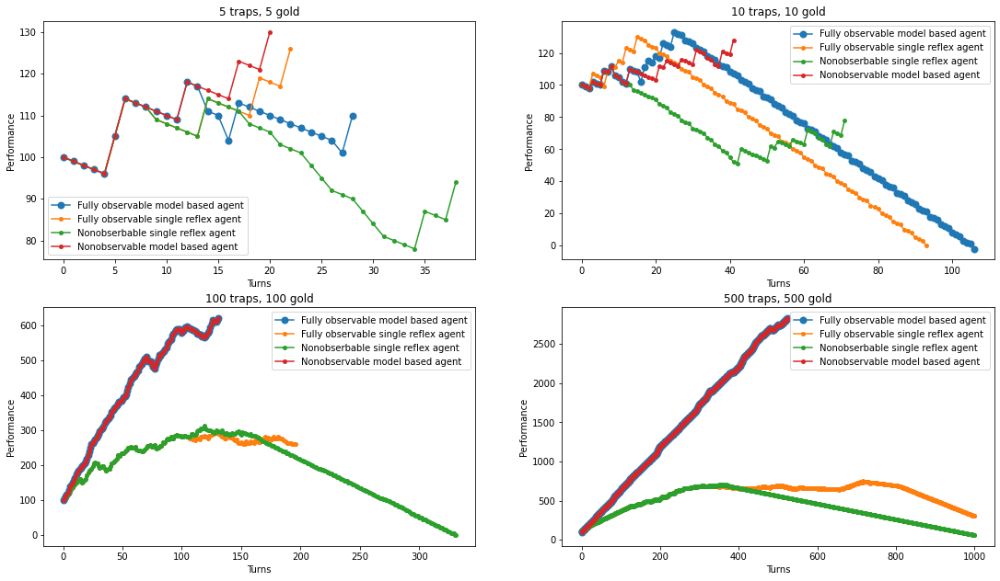

In [45]:
fig, ax = plt.subplots(2,2)
plot_pro_arrays(array5, ax[0,0], '5 traps, 5 gold', '.', [5,2,2,2])
plot_pro_arrays(array10, ax[0,1], '10 traps, 10 gold', '.', [5,2,2,2])
plot_pro_arrays(array100, ax[1,0], '100 traps, 100 gold', '.', [5,2,2,2])
plot_pro_arrays(array500, ax[1,1], '500 traps, 500 gold', '.', [5,2,2,2])
fig.set_size_inches(18.5, 10.5)
fig.savefig('5-10-100-500_equal.jpg', dpi=200)

### When the nuber of traps and gold is small, it is very hard to predict which agent will perform better in a given environment, sometimes the environment will have a greater effect than the type of agent, and sometimes the distribuition of the gold and traps is more important. In the large scale, an interesting phenomenon arises, where the model based agent outperforms the single reflex agents, even in the partially observable environment, which does not pose a threat to the performance, as the number of gold allows a higher number of actions, that will allow the agent to create a complete model of ints environment.

### Another interesting phenomenon, is that the single reflex agent, performs slightly better when it is in a fully observable environment, which makes sense, as the partially observable environment will not have valuable information to make choices that allow the agent to have a better score. Furthermore, the simple reflex agent in the nonobservable environment always ends up having a performance of zero, and then halts, which means that it never gets to collect all the gold, which is the second halting condition.

## 3.5 Fixed number of gold to 5, growing the number of traps.

In [89]:
array5_1 = run_experiment(5, 1)
array5_10 = run_experiment(5, 10)
array5_100 = run_experiment(5, 100)
array5_500= run_experiment(5, 500)

393
<STARTING>
Agent state: (4, 4, Up)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - -) (- - -) (- - -) (- - -)
1 (- - -) (- - -) (- - -) (- - -) (- - -)
2 (- - -) (- - -) (- - -) (- - -) (- 1 -)
3 (- - 1) (- - -) (- 1 -) (- - -) (- - -)
4 (- - -) (- 2 -) (- - -) (- 1 -) (V - -)
Agent performance: 100
PERCEPT
     3       4   
  (A G T) (A G T)
3 (- - -) (- - -)
4 (- 1 -) (U - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
1 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
2 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
3 (? ? ?) (? ? ?) (? ? ?) (- - -) (- - -)
4 (? ? ?) (? ? ?) (? ? ?) (- 1 -) (V - -)
<STEP 1>
SELECTED ACTION: Turn
Agent state: (4, 4, Right)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - -) (- - -) (- - -) (- - -)
1 (- - -) (- - -) (- - -) (- - -) (- - -)
2 (- - -) (- - -) (- 

AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - -) (V - -) (V - -) (V - -)
1 (V - -) (V - -) (V - -) (V - -) (V - -)
2 (- - -) (- - -) (- - 1) (- - 1) (V - -)
3 (? ? ?) (? ? ?) (? ? ?) (- - -) (- - 2)
4 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
<STEP 69>
SELECTED ACTION: Turn
Agent state: (4, 0, Right)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - -) (V - -) (V - -) (V - -)
1 (V - -) (V - -) (V - -) (V - -) (V - -)
2 (- - -) (- - -) (- - 1) (- - 1) (V - -)
3 (- - 1) (- - -) (- - -) (- - -) (- - 2)
4 (- - -) (- 1 1) (- - -) (- 1 1) (- - 2)
Agent performance: 6
PERCEPT
     3       4   
  (A G T) (A G T)
0 (- - -) (R - -)
1 (- - -) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - -) (V - -) (V - -) (V - -)
1 (V - -) (V - -) (V - -) (V - -) (V - -)
2 (- - -) (- - -) (- - 1) (- - 1) (V -

PERCEPT
     1       2       3   
  (A G T) (A G T) (A G T)
0 (- - 1) (R - 1) (- - 5)
1 (- - 3) (- - 2) (- - 4)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (? ? ?) (- - 1) (V - 2) (- - 5) (? ? ?)
1 (? ? ?) (- - 3) (- - 2) (- - 4) (? ? ?)
2 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
3 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
4 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
<STEP 2>
SELECTED ACTION: Advance
Agent state: (3, 0, Right)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 1 2) (- - 1) (V - 1) (V - 4) (- - 4)
1 (- 1 5) (- - 3) (- - 2) (- - 4) (- - 2)
2 (- - 3) (- - 3) (- - 3) (- 1 1) (- - 6)
3 (- 1 8) (- - 3) (- - 6) (- - 6) (- 1 5)
4 (- - 8) (- - 2) (- - 6) (- - 4) (- - 6)
Agent performance: 88
PERCEPT
     2       3       4   
  (A G T) (A G T) (A G T)
0 (- - 1) (R - 4) (- - 4)
1 (- - 2) (- - 4) (- - 2)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T)

4 (V - 28) (V - 15) (V - 21) (V - 19) (V - 25)
<STEP 17>
SELECTED ACTION: Advance
Agent state: (2, 0, Right)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - 15) (V - 13) (V - 19) (- - 22) (- - 18)
1 (V - 21) (- - 21) (- - 29) (- - 18) (V - 13)
2 (V - 14) (- - 21) (- - 27) (- 1 22) (V - 14)
3 (V - 20) (- 2 16) (- 1 23) (- - 18) (V - 11)
4 (V - 28) (V - 15) (V - 21) (V - 19) (V - 25)
Agent performance: 8
PERCEPT
     1       2       3   
  (A G T) (A G T) (A G T)
0 (- - 13) (R - 19) (- - 22)
1 (- - 21) (- - 29) (- - 18)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - 15) (V - 13) (V - 20) (- - 22) (- - 18)
1 (V - 21) (- - 21) (- - 29) (- - 18) (V - 13)
2 (V - 14) (- - 21) (? ? ?) (- 1 22) (V - 14)
3 (V - 20) (- 2 16) (- 1 23) (- - 18) (V - 11)
4 (V - 28) (V - 15) (V - 21) (V - 19) (V - 25)
<STEP 18>
SELECTED ACTION: Advance
Agent state: (3, 0, Right)
     0       1       2       3

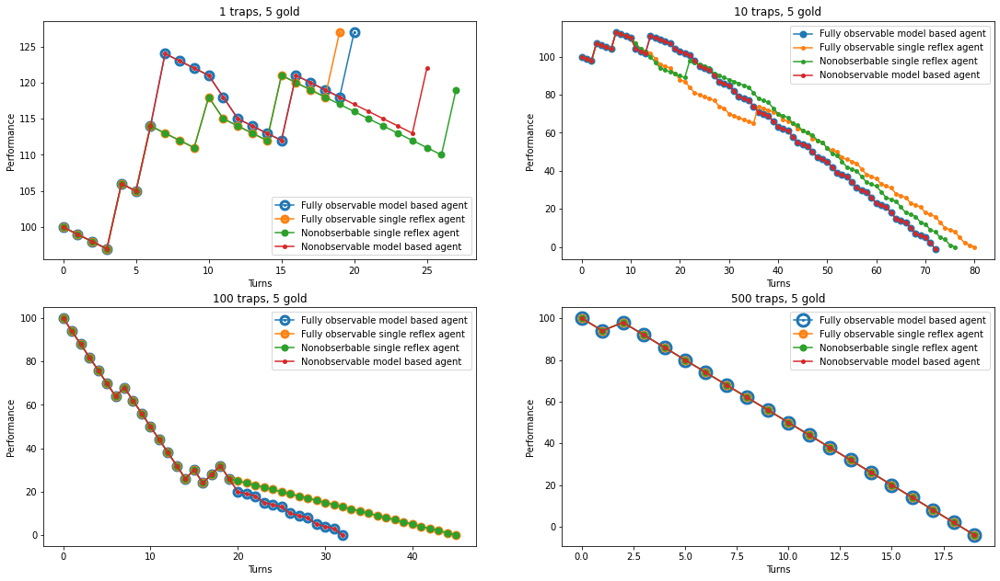

In [90]:
fig, ax = plt.subplots(2,2)
plot_pro_arrays(array5_1, ax[0,0], '1 traps, 5 gold', '.', [9,7,5,2])
plot_pro_arrays(array5_10, ax[0,1], '10 traps, 5 gold', '.', [5,2,2,2])
plot_pro_arrays(array5_100, ax[1,0], '100 traps, 5 gold', '.', [9,7,5,2])
plot_pro_arrays(array5_500, ax[1,1], '500 traps, 5 gold', '.', [13,7,5,2])
fig.set_size_inches(18.5, 10.5)
fig.savefig('vary_traps.jpg', dpi=200)

### In general, all the agents behave well when there is only one trap, but whenevery there are more traps than gold, the agents' performance will drop dramatically, sometimes losing after less than 20 turns.

## 3.6 Fixed number of traps to 5, growing the number of gold.

In [22]:
array1_5 = run_experiment(1, 5)
array10_5 = run_experiment(10, 5)
array100_5 = run_experiment(100, 5)
array500_5= run_experiment(500, 5)

355
<STARTING>
Agent state: (0, 1, Right)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- 1 -) (- - -) (- - 1) (- - -)
1 (V - -) (- - -) (- - -) (- - -) (- - -)
2 (- - -) (- - -) (- - 1) (- - -) (- - -)
3 (- - -) (- - 2) (- - -) (- - -) (- - -)
4 (- - -) (- - -) (- - -) (- - 1) (- - -)
Agent performance: 100
PERCEPT
     0       1   
  (A G T) (A G T)
0 (- - -) (- 1 -)
1 (R - -) (- - -)
2 (- - -) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- 1 -) (? ? ?) (? ? ?) (? ? ?)
1 (V - -) (- - -) (? ? ?) (? ? ?) (? ? ?)
2 (- - -) (- - -) (? ? ?) (? ? ?) (? ? ?)
3 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
4 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
<STEP 1>
SELECTED ACTION: Advance
Agent state: (1, 1, Right)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- 1 -) (- - -) (- - 1) (- - -)
1 (V - -) (V - -) (- - -) (- - -) (- - 

AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (? ? ?) (? ? ?) (- 1 -) (V 3 -) (- 2 -)
1 (? ? ?) (? ? ?) (- 7 1) (- 5 -) (- 5 -)
2 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
3 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
4 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
<STEP 12>
SELECTED ACTION: Advance
Agent state: (4, 0, Right)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V 5 -) (V 1 -) (V 3 -) (V 1 -)
1 (V 1 -) (- 3 -) (- 7 1) (- 5 -) (- 5 -)
2 (V 1 -) (- 4 -) (- 3 -) (- 5 -) (- 5 -)
3 (V 5 -) (V 6 -) (V 3 -) (V 2 1) (- 2 -)
4 (- 3 -) (- 7 -) (- 4 1) (- 4 1) (- 3 -)
Agent performance: 203
PERCEPT
     3       4   
  (A G T) (A G T)
0 (- 3 -) (R 1 -)
1 (- 5 -) (- 5 -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (? ? ?) (? ? ?) (? ? ?) (- 3 -) (V 1 -)
1 (? ? ?) (? ? ?) (? ? ?) (- 5 -) (- 5 -)
2 (? ? ?) (? ? ?) (? ? ?) (? ? ?)

Agent performance: 720
PERCEPT
     0       1       2   
  (A G T) (A G T) (A G T)
0 (- - -) (- 1 -) (- - -)
1 (- - -) (U - -) (- 3 -)
2 (- - -) (- - -) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- 1 -) (- - -) (? ? ?) (? ? ?)
1 (- - -) (V - -) (- 3 -) (? ? ?) (? ? ?)
2 (- - -) (- - -) (- - -) (? ? ?) (? ? ?)
3 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
4 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
<STEP 142>
SELECTED ACTION: Advance
Agent state: (1, 0, Up)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - -) (V - -) (V - -) (V - -)
1 (V - -) (V - -) (V 3 -) (V - -) (V - -)
2 (V - -) (V - -) (V - -) (V - -) (V - -)
3 (V - -) (V 2 -) (V 1 -) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - -)
Agent performance: 727
PERCEPT
     0       1       2   
  (A G T) (A G T) (A G T)
0 (- - -) (U - -) (- - -)
1 (- - -) (- - -) (- 3 -)
AGENT'S INTERNAL STATE
     0    

<STEP 74>
SELECTED ACTION: Advance
Agent state: (0, 3, Up)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - -) (V - -) (V - -) (V - -)
1 (V - -) (- 3 -) (- 7 1) (- 5 -) (V - -)
2 (V - -) (- 4 -) (- 3 -) (- 5 -) (V - -)
3 (V - -) (V - -) (V - -) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - -)
Agent performance: 784
PERCEPT
     0       1   
  (A G T) (A G T)
2 (- - -) (- 4 -)
3 (U - -) (- - -)
4 (- - -) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - -) (V - -) (V - -) (V - -)
1 (V - -) (- 3 -) (- 7 1) (- 5 -) (V - -)
2 (V - -) (- 4 -) (- 3 -) (- 5 -) (V - -)
3 (V - -) (V - -) (V - -) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - -)
<STEP 75>
SELECTED ACTION: Advance
Agent state: (0, 2, Up)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - -) (V - -) (V - -) (V - -)
1 (V - -) (- 3 -) (- 7 1

PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- 5 -) (- 1 -) (- 3 -) (- - -)
1 (- - -) (- 2 -) (- 6 -) (- 4 -) (- 2 -)
2 (- - -) (- 3 -) (- 2 -) (- 4 -) (- 1 -)
3 (U 1 -) (- 5 -) (- 2 -) (- 1 -) (- - -)
4 (- - -) (- 5 -) (- 2 -) (- 2 -) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- 5 -) (- 1 -) (- 3 -) (- - -)
1 (- - -) (- 2 -) (- 6 -) (- 4 -) (- 2 -)
2 (- - -) (- 3 -) (- 2 -) (- 4 -) (- 1 -)
3 (V 1 -) (- 5 -) (- 2 -) (- 1 -) (- - -)
4 (- - -) (- 5 -) (- 2 -) (- 2 -) (- - -)
<STEP 57>
SELECTED ACTION: Advance
Agent state: (0, 2, Up)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V 5 -) (V 1 -) (V 3 -) (V - -)
1 (V - -) (V 2 -) (V 6 -) (V 4 -) (V 2 -)
2 (V - -) (V 3 -) (V 2 -) (V 4 -) (V 1 -)
3 (V 1 -) (V 5 -) (V 2 -) (V 1 -) (V - -)
4 (V - -) (V 5 -) (V 2 -) (V 2 -) (V - -)
Agent performance: 468
PERCE

4 (- 3 -) (- 7 -) (- 4 1) (- 4 1) (- 3 -)
Agent performance: 124
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 2 -) (- 6 -) (- 2 -) (- 4 -) (- 2 -)
1 (- 2 1) (- 3 -) (- 7 1) (- 5 -) (- 5 -)
2 (- 2 -) (- 4 -) (- 3 -) (- 5 -) (- 5 -)
3 (- 7 -) (- 7 -) (L 3 -) (- - -) (- 2 -)
4 (- 3 -) (- 7 -) (- 4 1) (- 4 1) (- 3 -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 2 -) (- 6 -) (- 2 -) (- 4 -) (- 2 -)
1 (- 2 1) (- 3 -) (- 7 1) (- 5 -) (- 5 -)
2 (- 2 -) (- 4 -) (- 3 -) (- 5 -) (- 5 -)
3 (- 7 -) (- 7 -) (V 3 -) (V - -) (- 2 -)
4 (- 3 -) (- 7 -) (- 4 1) (- 4 1) (- 3 -)
<STEP 4>
SELECTED ACTION: Stay
Agent state: (2, 3, Left)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 2 -) (- 6 -) (- 2 -) (- 4 -) (- 2 -)
1 (- 2 1) (- 3 -) (- 7 1) (- 5 -) (- 5 -)
2 (- 2 -) (- 4 -) (- 3 -) (- 5 -) (- 5 -)
3 (- 7 -) (- 7 -) (V 2 -) (V - -) (- 2 -)
4 (- 3 

Agent state: (0, 4, Up)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - -) (V - -) (V - -) (V - -)
1 (V - -) (- 3 -) (- 7 1) (- 5 -) (V - -)
2 (V - -) (- 4 -) (- 3 -) (- 5 -) (V - -)
3 (V - -) (V - -) (V - -) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - -)
Agent performance: 787
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - -) (- - -) (- - -) (- - -)
1 (- - -) (- 3 -) (- 7 1) (- 5 -) (- - -)
2 (- - -) (- 4 -) (- 3 -) (- 5 -) (- - -)
3 (- - -) (- - -) (- - -) (- - -) (- - -)
4 (U - -) (- - -) (- - -) (- - -) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - -) (V - -) (V - -) (V - -)
1 (V - -) (- 3 -) (- 7 1) (- 5 -) (V - -)
2 (V - -) (- 4 -) (- 3 -) (- 5 -) (V - -)
3 (V - -) (V - -) (V - -) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - -)
<STEP 74>
SELECTED ACTION: Advance
Agent

SELECTED ACTION: Advance
Agent state: (4, 1, Down)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V 10 -) (V 18 -) (V 22 -) (V 16 -) (V 13 -)
1 (V 15 -) (- 19 -) (- 15 1) (- 17 -) (V 11 -)
2 (V 22 -) (V 16 -) (V 21 1) (- 22 -) (V 19 -)
3 (V 7 -) (- 20 1) (- 24 -) (- 25 -) (V 18 -)
4 (V 14 -) (V 15 -) (V 25 -) (V 27 -) (V 17 -)
Agent performance: 510
PERCEPT
     3       4   
  (A G T) (A G T)
0 (- 16 -) (- 13 -)
1 (- 17 -) (D 11 -)
2 (- 22 -) (- 19 -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (? ? ?) (? ? ?) (? ? ?) (- 16 -) (- 13 -)
1 (? ? ?) (? ? ?) (? ? ?) (- 17 -) (V 11 -)
2 (? ? ?) (? ? ?) (? ? ?) (- 22 -) (- 19 -)
3 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
4 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
<STEP 53>
SELECTED ACTION: Advance
Agent state: (4, 2, Down)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V 10 -) (V 18 -) (V 22 -) (V 16 -

4 (V 6 -) (V 11 -) (V 21 -) (V 23 -) (V 8 -)
Agent performance: 1123
PERCEPT
     3       4   
  (A G T) (A G T)
3 (- 25 -) (- 13 -)
4 (- 23 -) (D 8 -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
1 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
2 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
3 (? ? ?) (? ? ?) (? ? ?) (- 25 -) (- 13 -)
4 (? ? ?) (? ? ?) (? ? ?) (- 23 -) (V 8 -)
<STEP 136>
SELECTED ACTION: Turn
Agent state: (4, 4, Left)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V 2 -) (V 14 -) (V 18 -) (V 12 -) (V 5 -)
1 (V 11 -) (- 19 -) (- 15 1) (- 17 -) (V 7 -)
2 (V 18 -) (V 16 -) (V 21 1) (- 22 -) (V 14 -)
3 (V 3 -) (- 20 1) (- 24 -) (- 25 -) (V 13 -)
4 (V 6 -) (V 11 -) (V 21 -) (V 23 -) (V 7 -)
Agent performance: 1132
PERCEPT
     3       4   
  (A G T) (A G T)
3 (- 25 -) (- 13 -)
4 (- 23 -) (L 7 -)
AGENT'S INTERNAL STATE
     0       1       2    

4 (V - -) (V 5 -) (V 15 -) (V 17 -) (V - -)
Agent performance: 1584
PERCEPT
     0       1   
  (A G T) (A G T)
3 (- - -) (- 20 1)
4 (R - -) (- 5 -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
1 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
2 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
3 (- - -) (- 20 1) (? ? ?) (? ? ?) (? ? ?)
4 (V - -) (- 5 -) (? ? ?) (? ? ?) (? ? ?)
<STEP 215>
SELECTED ACTION: Advance
Agent state: (1, 4, Right)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V 11 -) (V 15 -) (V 9 -) (V - -)
1 (V 8 -) (- 19 -) (- 15 1) (- 17 -) (V 4 -)
2 (V 15 -) (V 16 -) (V 21 1) (- 22 -) (V 11 -)
3 (V - -) (- 20 1) (- 24 -) (- 25 -) (V 10 -)
4 (V - -) (V 4 -) (V 15 -) (V 17 -) (V - -)
Agent performance: 1591
PERCEPT
     0       1       2   
  (A G T) (A G T) (A G T)
3 (- - -) (- 20 1) (- 24 -)
4 (- - -) (R 4 -) (- 15 -)
AGENT'S INTERNAL STAT

<STEP 343>
SELECTED ACTION: Advance
Agent state: (1, 0, Left)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - -) (V 7 -) (V 1 -) (V - -)
1 (V 8 -) (V 14 -) (- 15 1) (- 17 -) (V - -)
2 (V 15 -) (V 11 -) (V 21 1) (- 22 -) (V 7 -)
3 (V - -) (V 15 -) (- 24 -) (- 25 -) (V 6 -)
4 (V - -) (V - -) (V 5 -) (V 7 -) (V - -)
Agent performance: 2054
PERCEPT
     0       1       2   
  (A G T) (A G T) (A G T)
0 (- - -) (L - -) (- 7 -)
1 (- 8 -) (- 14 -) (- 15 1)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (V - -) (- 7 -) (? ? ?) (? ? ?)
1 (- 8 -) (- 14 -) (- 15 1) (? ? ?) (? ? ?)
2 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
3 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
4 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
<STEP 344>
SELECTED ACTION: Turn
Agent state: (1, 0, Up)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - -) (V 7 -) (V 1 -) (V

4 (V - -) (V - -) (V - -) (V - -) (V - -)
Agent performance: 2370
PERCEPT
     1       2       3   
  (A G T) (A G T) (A G T)
3 (- 11 -) (- 22 -) (- 20 -)
4 (- - -) (U - -) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
1 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
2 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
3 (? ? ?) (- 11 -) (- 22 -) (- 20 -) (? ? ?)
4 (? ? ?) (- - -) (V - -) (- - -) (? ? ?)
<STEP 432>
SELECTED ACTION: Advance
Agent state: (2, 3, Up)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - -) (V - -) (V - -) (V - -)
1 (V 8 -) (V 10 -) (V 13 -) (V 12 -) (V - -)
2 (V 15 -) (V 7 -) (V 19 -) (V 17 -) (V 7 -)
3 (V - -) (V 11 -) (V 21 -) (V 20 -) (V 6 -)
4 (V - -) (V - -) (V - -) (V - -) (V - -)
Agent performance: 2377
PERCEPT
     1       2       3   
  (A G T) (A G T) (A G T)
2 (- 7 -) (- 19 -) (- 17 -)
3 (- 11 -) (U 21 -) (- 2

     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - -) (V - -) (V - -) (V - -)
1 (V 5 -) (V 10 -) (V - -) (V 11 -) (V - -)
2 (V 11 -) (V 6 -) (V 5 -) (V 16 -) (V - -)
3 (V - -) (V 11 -) (V 9 -) (V 20 -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - -)
Agent performance: 2702
PERCEPT
     0       1   
  (A G T) (A G T)
0 (D - -) (- - -)
1 (- 5 -) (- 10 -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (- - -) (? ? ?) (? ? ?) (? ? ?)
1 (- 5 -) (- 10 -) (? ? ?) (? ? ?) (? ? ?)
2 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
3 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
4 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
<STEP 562>
SELECTED ACTION: Advance
Agent state: (0, 1, Down)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - -) (V - -) (V - -) (V - -)
1 (V 4 -) (V 10 -) (V - -) (V 11 -) (V - -)
2 (V 11 -) (V 6 -) (V 5 -) (V 16 -) (V - -)
3

PERCEPT
     2       3       4   
  (A G T) (A G T) (A G T)
1 (- - -) (- - -) (- - -)
2 (- - -) (D 9 -) (- - -)
3 (- 9 -) (- 20 -) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
1 (? ? ?) (? ? ?) (- - -) (- - -) (- - -)
2 (? ? ?) (? ? ?) (- - -) (V 9 -) (- - -)
3 (? ? ?) (? ? ?) (- 9 -) (- 20 -) (- - -)
4 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
<STEP 719>
SELECTED ACTION: Advance
Agent state: (3, 3, Down)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - -) (V - -) (V - -) (V - -)
1 (V - -) (V - -) (V - -) (V - -) (V - -)
2 (V - -) (V - -) (V - -) (V 9 -) (V - -)
3 (V - -) (V 11 -) (V 9 -) (V 19 -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - -)
Agent performance: 2908
PERCEPT
     2       3       4   
  (A G T) (A G T) (A G T)
2 (- - -) (- 9 -) (- - -)
3 (- 9 -) (D 19 -) (- - -)
4 (- - -) (- - -) (- - -)
AGENT'S INTERNAL STATE

     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 16 -) (- 21 -) (- 25 1) (- 19 -) (- 19 -)
1 (- 18 -) (- 19 -) (- 15 1) (- 17 -) (- 14 -)
2 (V 25 -) (V - -) (V - -) (- 22 -) (- 21 1)
3 (- 9 -) (- 20 1) (- 24 -) (- 25 -) (- 20 -)
4 (- 18 -) (- 17 -) (- 27 -) (- 29 -) (- 21 -)
Agent performance: 483
PERCEPT
     0       1   
  (A G T) (A G T)
1 (- 18 -) (- 19 -)
2 (L 25 -) (- - -)
3 (- 9 -) (- 20 1)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
1 (- 18 -) (- 19 -) (- 15 1) (- 17 -) (? ? ?)
2 (V 26 -) (V - -) (V - -) (- 22 -) (? ? ?)
3 (- 9 -) (- 20 1) (- 24 -) (- 25 -) (? ? ?)
4 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
<STEP 40>
SELECTED ACTION: Turn
Agent state: (0, 2, Up)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 16 -) (- 21 -) (- 25 1) (- 19 -) (- 19 -)
1 (- 18 -) (- 19 -) (- 15 1) (- 17 -) (- 14 -)

4 (- 18 -) (- 17 -) (- 27 -) (- 29 -) (- 21 -)
Agent performance: 939
PERCEPT
     0       1   
  (A G T) (A G T)
0 (R 13 -) (- 21 -)
1 (- - -) (- 19 -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V 14 -) (- 21 -) (? ? ?) (? ? ?) (? ? ?)
1 (V - -) (- 19 -) (- 15 1) (- 17 -) (? ? ?)
2 (V - -) (V - -) (V - -) (- 22 -) (? ? ?)
3 (- 9 -) (- 20 1) (- 24 -) (- 25 -) (? ? ?)
4 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
<STEP 86>
SELECTED ACTION: Stay
Agent state: (0, 0, Right)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V 12 -) (- 21 -) (- 25 1) (- 19 -) (- 19 -)
1 (V - -) (- 19 -) (- 15 1) (- 17 -) (- 14 -)
2 (V - -) (V - -) (V - -) (- 22 -) (- 21 1)
3 (- 9 -) (- 20 1) (- 24 -) (- 25 -) (- 20 -)
4 (- 18 -) (- 17 -) (- 27 -) (- 29 -) (- 21 -)
Agent performance: 949
PERCEPT
     0       1   
  (A G T) (A G T)
0 (R 12 -) (- 21 -)
1 (- - -) (- 19 -)
AGENT'S INTERNAL STATE
     0       1     

Agent state: (3, 4, Left)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - -) (V - -) (V - -) (V - -)
1 (V - -) (- 19 -) (- 15 1) (- 17 -) (V - -)
2 (V - -) (V - -) (V - -) (- 22 -) (V - -)
3 (- 9 -) (- 20 1) (- 24 -) (- 25 -) (V - -)
4 (- 18 -) (- 17 -) (- 27 -) (V 22 -) (V - -)
Agent performance: 2718
PERCEPT
     2       3       4   
  (A G T) (A G T) (A G T)
3 (- 24 -) (- 25 -) (- - -)
4 (- 27 -) (L 22 -) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - -) (V - -) (V - -) (V - -)
1 (V - -) (- 19 -) (- 15 1) (- 17 -) (V - -)
2 (V - -) (V - -) (V - -) (- 22 -) (V - -)
3 (- 9 -) (- 20 1) (- 24 -) (- 25 -) (V - -)
4 (? ? ?) (? ? ?) (- 27 -) (V 23 -) (V - -)
<STEP 266>
SELECTED ACTION: Stay
Agent state: (3, 4, Left)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - -) (V - -) (V - -) (V - -)
1 (V - -) (- 19 -)

SELECTED ACTION: Stay
Agent state: (2, 4, Left)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - -) (V - -) (V - -) (V - -)
1 (V - -) (- 19 -) (- 15 1) (- 17 -) (V - -)
2 (V - -) (V - -) (V - -) (- 22 -) (V - -)
3 (- 9 -) (- 20 1) (- 24 -) (- 25 -) (V - -)
4 (- 18 -) (- 17 -) (V 17 -) (V - -) (V - -)
Agent performance: 3037
PERCEPT
     1       2       3   
  (A G T) (A G T) (A G T)
3 (- 20 1) (- 24 -) (- 25 -)
4 (- 17 -) (L 17 -) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - -) (V - -) (V - -) (V - -)
1 (V - -) (- 19 -) (- 15 1) (- 17 -) (V - -)
2 (V - -) (V - -) (V - -) (- 22 -) (V - -)
3 (- 9 -) (- 20 1) (- 24 -) (- 25 -) (V - -)
4 (? ? ?) (- 17 -) (V 18 -) (V - -) (V - -)
<STEP 298>
SELECTED ACTION: Stay
Agent state: (2, 4, Left)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - -) (V - -) (V - -) (V -

4 (V 4 -) (V - -) (V - -) (V - -) (V - -)
Agent performance: 3514
PERCEPT
     0       1   
  (A G T) (A G T)
3 (- 9 -) (- 20 1)
4 (U 4 -) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - -) (V - -) (V - -) (V - -)
1 (V - -) (- 19 -) (- 15 1) (- 17 -) (V - -)
2 (V - -) (V - -) (V - -) (- 22 -) (V - -)
3 (- 9 -) (- 20 1) (- 24 -) (- 25 -) (V - -)
4 (V 5 -) (V - -) (V - -) (V - -) (V - -)
<STEP 346>
SELECTED ACTION: Stay
Agent state: (0, 4, Up)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - -) (V - -) (V - -) (V - -)
1 (V - -) (- 19 -) (- 15 1) (- 17 -) (V - -)
2 (V - -) (V - -) (V - -) (- 22 -) (V - -)
3 (- 9 -) (- 20 1) (- 24 -) (- 25 -) (V - -)
4 (V 3 -) (V - -) (V - -) (V - -) (V - -)
Agent performance: 3524
PERCEPT
     0       1   
  (A G T) (A G T)
3 (- 9 -) (- 20 1)
4 (U 3 -) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
 

<STEP 467>
SELECTED ACTION: Stay
Agent state: (3, 1, Up)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - -) (V - -) (V - -) (V - -)
1 (V - -) (- 19 -) (- 15 1) (V 3 -) (V - -)
2 (V - -) (V - -) (V - -) (V - -) (V - -)
3 (V - -) (V - -) (V - -) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - -)
Agent performance: 4679
PERCEPT
     2       3       4   
  (A G T) (A G T) (A G T)
0 (- - -) (- - -) (- - -)
1 (- 15 1) (U 3 -) (- - -)
2 (- - -) (- - -) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - -) (V - -) (V - -) (V - -)
1 (V - -) (- 19 -) (- 15 1) (V 4 -) (V - -)
2 (V - -) (V - -) (V - -) (V - -) (V - -)
3 (V - -) (V - -) (V - -) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - -)
<STEP 468>
SELECTED ACTION: Stay
Agent state: (3, 1, Up)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - -) (V - -

AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 14 -) (- 20 -) (- 24 -) (- 18 -) (- 17 -)
1 (- 17 -) (- 19 -) (- 15 1) (- 17 -) (- 13 -)
2 (- 24 -) (- 16 -) (- 21 1) (- 22 -) (V 20 -)
3 (- 9 -) (- 20 1) (- 24 -) (- 25 -) (- 20 -)
4 (- 18 -) (- 17 -) (- 27 -) (- 29 -) (- 21 -)
<STEP 14>
SELECTED ACTION: Advance
Agent state: (4, 3, Down)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V 14 -) (V 20 -) (V 24 -) (V 18 -) (V 17 -)
1 (V 17 -) (- 19 -) (- 15 1) (- 17 -) (V 13 -)
2 (V 24 -) (V 16 -) (V 21 1) (- 22 -) (V 20 -)
3 (- 9 -) (- 20 1) (- 24 -) (- 25 -) (V 19 -)
4 (- 18 -) (- 17 -) (- 27 -) (- 29 -) (- 21 -)
Agent performance: 216
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 14 -) (- 20 -) (- 24 -) (- 18 -) (- 17 -)
1 (- 17 -) (- 19 -) (- 15 1) (- 17 -) (- 13 -)
2 (- 24 -) (- 16 -) (- 21 1) (- 22 -) (- 20 -)
3 (- 9 -) (- 20 1) (- 24

Agent performance: 790
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 6 -) (- 16 -) (- 20 -) (- 14 -) (R 10 -)
1 (- 13 -) (- 19 -) (- 15 1) (- 17 -) (- 10 -)
2 (- 20 -) (- 16 -) (- 21 1) (- 22 -) (- 17 -)
3 (- 5 -) (- 20 1) (- 24 -) (- 25 -) (- 16 -)
4 (- 10 -) (- 13 -) (- 23 -) (- 25 -) (- 13 -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 6 -) (- 16 -) (- 20 -) (- 14 -) (V 10 -)
1 (- 13 -) (- 19 -) (- 15 1) (- 17 -) (- 10 -)
2 (- 20 -) (- 16 -) (- 21 1) (- 22 -) (- 17 -)
3 (- 5 -) (- 20 1) (- 24 -) (- 25 -) (- 16 -)
4 (- 10 -) (- 13 -) (- 23 -) (- 25 -) (- 13 -)
<STEP 91>
SELECTED ACTION: Turn
Agent state: (4, 0, Down)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V 6 -) (V 16 -) (V 20 -) (V 14 -) (V 9 -)
1 (V 13 -) (- 19 -) (- 15 1) (- 17 -) (V 10 -)
2 (V 20 -) (V 16 -) (V 21 1) (- 22 -) (V 17 -)
3 (V 5 -) (- 20 1) (- 24 -) (- 

4 (V 2 -) (V 9 -) (V 19 -) (V 21 -) (V 5 -)
Agent performance: 1341
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (R 12 -) (- 17 -) (- 11 -) (- 3 -)
1 (- 9 -) (- 19 -) (- 15 1) (- 17 -) (- 6 -)
2 (- 16 -) (- 16 -) (- 21 1) (- 22 -) (- 13 -)
3 (- 1 -) (- 20 1) (- 24 -) (- 25 -) (- 12 -)
4 (- 2 -) (- 9 -) (- 19 -) (- 21 -) (- 5 -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (V 12 -) (- 17 -) (- 11 -) (- 3 -)
1 (- 9 -) (- 19 -) (- 15 1) (- 17 -) (- 6 -)
2 (- 16 -) (- 16 -) (- 21 1) (- 22 -) (- 13 -)
3 (- 1 -) (- 20 1) (- 24 -) (- 25 -) (- 12 -)
4 (- 2 -) (- 9 -) (- 19 -) (- 21 -) (- 5 -)
<STEP 168>
SELECTED ACTION: Advance
Agent state: (2, 0, Right)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V 12 -) (V 16 -) (V 11 -) (V 3 -)
1 (V 9 -) (- 19 -) (- 15 1) (- 17 -) (V 6 -)
2 (V 16 -) (V 16 -) (V 21 1) (- 22 -) (V 1

SELECTED ACTION: Advance
Agent state: (2, 4, Right)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V 11 -) (V 15 -) (V 9 -) (V - -)
1 (V 8 -) (- 19 -) (- 15 1) (- 17 -) (V 4 -)
2 (V 15 -) (V 16 -) (V 21 1) (- 22 -) (V 11 -)
3 (V - -) (- 20 1) (- 24 -) (- 25 -) (V 10 -)
4 (V - -) (V 6 -) (V 16 -) (V 19 -) (V 1 -)
Agent performance: 1556
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- 11 -) (- 15 -) (- 9 -) (- - -)
1 (- 8 -) (- 19 -) (- 15 1) (- 17 -) (- 4 -)
2 (- 15 -) (- 16 -) (- 21 1) (- 22 -) (- 11 -)
3 (- - -) (- 20 1) (- 24 -) (- 25 -) (- 10 -)
4 (- - -) (- 6 -) (R 16 -) (- 19 -) (- 1 -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- 11 -) (- 15 -) (- 9 -) (- - -)
1 (- 8 -) (- 19 -) (- 15 1) (- 17 -) (- 4 -)
2 (- 15 -) (- 16 -) (- 21 1) (- 22 -) (- 11 -)
3 (- - -) (- 20 1) (- 24 -) (- 25 -) (- 10 -)
4 (- - 

AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- 11 -) (- 15 -) (- 9 -) (- - -)
1 (- 8 -) (- 19 -) (- 15 1) (- 17 -) (- 4 -)
2 (- 15 -) (- 16 -) (- 21 1) (- 22 -) (- 11 -)
3 (- - -) (- 20 1) (- 24 -) (- 25 -) (- 10 -)
4 (- - -) (- - -) (V 10 -) (- 13 -) (- - -)
<STEP 241>
SELECTED ACTION: Advance
Agent state: (3, 4, Right)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V 11 -) (V 15 -) (V 9 -) (V - -)
1 (V 8 -) (- 19 -) (- 15 1) (- 17 -) (V 4 -)
2 (V 15 -) (V 16 -) (V 21 1) (- 22 -) (V 11 -)
3 (V - -) (- 20 1) (- 24 -) (- 25 -) (V 10 -)
4 (V - -) (V - -) (V 10 -) (V 12 -) (V - -)
Agent performance: 1669
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- 11 -) (- 15 -) (- 9 -) (- - -)
1 (- 8 -) (- 19 -) (- 15 1) (- 17 -) (- 4 -)
2 (- 15 -) (- 16 -) (- 21 1) (- 22 -) (- 11 -)
3 (- - -) (- 20 1) (- 24 -) (- 25 -) (- 10

AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- 9 -) (- 14 -) (- 8 -) (- - -)
1 (- 8 -) (- 18 -) (- 15 1) (- 17 -) (- 3 -)
2 (- 15 -) (V 14 -) (- 21 1) (- 22 -) (- 10 -)
3 (- - -) (- 18 -) (- 24 -) (- 25 -) (- 9 -)
4 (- - -) (- - -) (- 8 -) (- 10 -) (- - -)
<STEP 269>
SELECTED ACTION: Advance
Agent state: (1, 1, Up)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V 9 -) (V 14 -) (V 8 -) (V - -)
1 (V 8 -) (V 17 -) (- 15 1) (- 17 -) (V 3 -)
2 (V 15 -) (V 14 -) (V 21 1) (- 22 -) (V 10 -)
3 (V - -) (V 18 -) (- 24 -) (- 25 -) (V 9 -)
4 (V - -) (V - -) (V 8 -) (V 10 -) (V - -)
Agent performance: 1768
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- 9 -) (- 14 -) (- 8 -) (- - -)
1 (- 8 -) (U 17 -) (- 15 1) (- 17 -) (- 3 -)
2 (- 15 -) (- 14 -) (- 21 1) (- 22 -) (- 10 -)
3 (- - -) (- 18 -) (- 24 -) (- 25 -) (- 9 -)
4 (- - 

     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - -) (- 8 -) (- 2 -) (- - -)
1 (- 8 -) (- 14 -) (- 15 1) (- 17 -) (V - -)
2 (- 15 -) (- 11 -) (- 21 1) (- 22 -) (- 7 -)
3 (- - -) (- 15 -) (- 24 -) (- 25 -) (- 6 -)
4 (- - -) (- - -) (- 5 -) (- 7 -) (- - -)
<STEP 341>
SELECTED ACTION: Advance
Agent state: (4, 2, Down)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - -) (V 8 -) (V 2 -) (V - -)
1 (V 8 -) (V 14 -) (- 15 1) (- 17 -) (V - -)
2 (V 15 -) (V 11 -) (V 21 1) (- 22 -) (V 6 -)
3 (V - -) (V 15 -) (- 24 -) (- 25 -) (V 6 -)
4 (V - -) (V - -) (V 5 -) (V 7 -) (V - -)
Agent performance: 2048
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - -) (- 8 -) (- 2 -) (- - -)
1 (- 8 -) (- 14 -) (- 15 1) (- 17 -) (- - -)
2 (- 15 -) (- 11 -) (- 21 1) (- 22 -) (D 6 -)
3 (- - -) (- 15 -) (- 24 -) (- 25 -) (- 6 -)
4 (- - -) (- - -) (- 5 -) (- 7 -) (-

AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - -) (- 2 -) (- - -) (- - -)
1 (- 8 -) (- 10 -) (- 14 -) (- 13 -) (- - -)
2 (- 15 -) (- 7 -) (- 20 -) (- 18 -) (- 5 -)
3 (- - -) (- 11 -) (- 23 -) (V 21 -) (- 4 -)
4 (- - -) (- - -) (- - -) (- - -) (- - -)
<STEP 424>
SELECTED ACTION: Advance
Agent state: (3, 4, Down)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - -) (V 2 -) (V - -) (V - -)
1 (V 8 -) (V 10 -) (V 14 -) (V 13 -) (V - -)
2 (V 15 -) (V 7 -) (V 20 -) (V 18 -) (V 5 -)
3 (V - -) (V 11 -) (V 23 -) (V 21 -) (V 4 -)
4 (V - -) (V - -) (V - -) (V - -) (V - -)
Agent performance: 2339
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - -) (- 2 -) (- - -) (- - -)
1 (- 8 -) (- 10 -) (- 14 -) (- 13 -) (- - -)
2 (- 15 -) (- 7 -) (- 20 -) (- 18 -) (- 5 -)
3 (- - -) (- 11 -) (- 23 -) (- 21 -) (- 4 -)
4 (- - -) (- - -

     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - -) (V 2 -) (V - -) (V - -)
1 (V 8 -) (V 10 -) (V 14 -) (V - -) (V - -)
2 (V 15 -) (V 7 -) (V 20 -) (V 4 -) (V 5 -)
3 (V - -) (V 11 -) (V 23 -) (V 7 -) (V 4 -)
4 (V - -) (V - -) (V - -) (V - -) (V - -)
Agent performance: 2559
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - -) (- 2 -) (- - -) (- - -)
1 (- 8 -) (- 10 -) (- 14 -) (- - -) (- - -)
2 (- 15 -) (- 7 -) (- 20 -) (- 4 -) (- 5 -)
3 (- - -) (- 11 -) (- 23 -) (- 7 -) (- 4 -)
4 (- - -) (- - -) (- - -) (D - -) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - -) (- 2 -) (- - -) (- - -)
1 (- 8 -) (- 10 -) (- 14 -) (- - -) (- - -)
2 (- 15 -) (- 7 -) (- 20 -) (- 4 -) (- 5 -)
3 (- - -) (- 11 -) (- 23 -) (- 7 -) (- 4 -)
4 (- - -) (- - -) (- - -) (V - -) (- - -)
<STEP 507>
SELECTED ACTION: Turn
Agent state:

AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - -) (- 2 -) (- - -) (- - -)
1 (V 2 -) (- 10 -) (- 14 -) (- - -) (- - -)
2 (- 9 -) (- 6 -) (- 19 -) (- - -) (- - -)
3 (- - -) (- 11 -) (- 23 -) (- 2 -) (- - -)
4 (- - -) (- - -) (- - -) (- - -) (- - -)
<STEP 583>
SELECTED ACTION: Advance
Agent state: (0, 2, Down)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - -) (V 2 -) (V - -) (V - -)
1 (V 2 -) (V 10 -) (V 14 -) (V - -) (V - -)
2 (V 8 -) (V 6 -) (V 19 -) (V - -) (V - -)
3 (V - -) (V 11 -) (V 23 -) (V 2 -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - -)
Agent performance: 2722
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - -) (- 2 -) (- - -) (- - -)
1 (- 2 -) (- 10 -) (- 14 -) (- - -) (- - -)
2 (D 8 -) (- 6 -) (- 19 -) (- - -) (- - -)
3 (- - -) (- 11 -) (- 23 -) (- 2 -) (- - -)
4 (- - -) (- - -) (- - -) (-

PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - -) (- 2 -) (- - -) (- - -)
1 (- - -) (- - -) (- 1 -) (- - -) (- - -)
2 (D 1 -) (- 6 -) (- 19 -) (- - -) (- - -)
3 (- - -) (- 10 -) (- 22 -) (- - -) (- - -)
4 (- - -) (- - -) (- - -) (- - -) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - -) (- 2 -) (- - -) (- - -)
1 (- - -) (- - -) (- 1 -) (- - -) (- - -)
2 (V 1 -) (- 6 -) (- 19 -) (- - -) (- - -)
3 (- - -) (- 10 -) (- 22 -) (- - -) (- - -)
4 (- - -) (- - -) (- - -) (- - -) (- - -)
<STEP 686>
SELECTED ACTION: Advance
Agent state: (0, 3, Down)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - -) (V 2 -) (V - -) (V - -)
1 (V - -) (V - -) (V 1 -) (V - -) (V - -)
2 (V 1 -) (V 6 -) (V 19 -) (V - -) (V - -)
3 (V - -) (V 10 -) (V 22 -) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - -)
Agent performanc

AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - -) (- - -) (- - -) (- - -)
1 (- - -) (- - -) (- - -) (- - -) (- - -)
2 (- - -) (- - -) (- - -) (- - -) (- - -)
3 (- - -) (- 10 -) (- 17 -) (- - -) (- - -)
4 (- - -) (- - -) (V - -) (- - -) (- - -)
<STEP 792>
SELECTED ACTION: Turn
Agent state: (2, 4, Left)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - -) (V - -) (V - -) (V - -)
1 (V - -) (V - -) (V - -) (V - -) (V - -)
2 (V - -) (V - -) (V - -) (V - -) (V - -)
3 (V - -) (V 10 -) (V 17 -) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - -)
Agent performance: 2981
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - -) (- - -) (- - -) (- - -)
1 (- - -) (- - -) (- - -) (- - -) (- - -)
2 (- - -) (- - -) (- - -) (- - -) (- - -)
3 (- - -) (- 10 -) (- 17 -) (- - -) (- - -)
4 (- - -) (- - -) (L - -) (- - -) (- - -

<STEP 16>
SELECTED ACTION: Stay
Agent state: (2, 2, Left)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 16 -) (- 21 -) (- 25 1) (- 19 -) (- 19 -)
1 (- 18 -) (- 19 -) (- 15 1) (- 17 -) (- 14 -)
2 (- 26 -) (- 17 -) (V 5 -) (- 22 -) (- 21 1)
3 (- 9 -) (- 20 1) (- 24 -) (- 25 -) (- 20 -)
4 (- 18 -) (- 17 -) (- 27 -) (- 29 -) (- 21 -)
Agent performance: 255
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 16 -) (- 21 -) (- 25 1) (- 19 -) (- 19 -)
1 (- 18 -) (- 19 -) (- 15 1) (- 17 -) (- 14 -)
2 (- 26 -) (- 17 -) (L 5 -) (- 22 -) (- 21 1)
3 (- 9 -) (- 20 1) (- 24 -) (- 25 -) (- 20 -)
4 (- 18 -) (- 17 -) (- 27 -) (- 29 -) (- 21 -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 16 -) (- 21 -) (- 25 1) (- 19 -) (- 19 -)
1 (- 18 -) (- 19 -) (- 15 1) (- 17 -) (- 14 -)
2 (- 26 -) (- 17 -) (V 5 -) (- 22 -) (- 21 1)
3 (- 9 -) (- 20 1) (- 24 -) (-

AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 16 -) (- 21 -) (- 25 1) (- 19 -) (- 19 -)
1 (- 18 -) (- 19 -) (- 15 1) (- 17 -) (- 14 -)
2 (V 9 -) (V - -) (V - -) (- 22 -) (- 21 1)
3 (- 9 -) (- 20 1) (- 24 -) (- 25 -) (- 20 -)
4 (- 18 -) (- 17 -) (- 27 -) (- 29 -) (- 21 -)
<STEP 56>
SELECTED ACTION: Stay
Agent state: (0, 2, Up)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 16 -) (- 21 -) (- 25 1) (- 19 -) (- 19 -)
1 (- 18 -) (- 19 -) (- 15 1) (- 17 -) (- 14 -)
2 (V 8 -) (V - -) (V - -) (- 22 -) (- 21 1)
3 (- 9 -) (- 20 1) (- 24 -) (- 25 -) (- 20 -)
4 (- 18 -) (- 17 -) (- 27 -) (- 29 -) (- 21 -)
Agent performance: 652
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 16 -) (- 21 -) (- 25 1) (- 19 -) (- 19 -)
1 (- 18 -) (- 19 -) (- 15 1) (- 17 -) (- 14 -)
2 (U 8 -) (- - -) (- - -) (- 22 -) (- 21 1)
3 (- 9 -) (- 20 1) (- 24 -) (- 25 -) (

4 (- 18 -) (- 17 -) (- 27 -) (- 29 -) (- 21 -)
Agent performance: 1208
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (R 7 -) (- 25 1) (- 19 -) (- 19 -)
1 (- - -) (- 19 -) (- 15 1) (- 17 -) (- 14 -)
2 (- - -) (- - -) (- - -) (- 22 -) (- 21 1)
3 (- 9 -) (- 20 1) (- 24 -) (- 25 -) (- 20 -)
4 (- 18 -) (- 17 -) (- 27 -) (- 29 -) (- 21 -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V 7 -) (- 25 1) (- 19 -) (- 19 -)
1 (V - -) (- 19 -) (- 15 1) (- 17 -) (- 14 -)
2 (V - -) (V - -) (V - -) (- 22 -) (- 21 1)
3 (- 9 -) (- 20 1) (- 24 -) (- 25 -) (- 20 -)
4 (- 18 -) (- 17 -) (- 27 -) (- 29 -) (- 21 -)
<STEP 113>
SELECTED ACTION: Stay
Agent state: (1, 0, Right)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V 6 -) (- 25 1) (- 19 -) (- 19 -)
1 (V - -) (- 19 -) (- 15 1) (- 17 -) (- 14 -)
2 (V - -) (V - -) (V - -) (- 22 -) (- 2

PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - -) (R 8 -) (- 19 -) (- 19 -)
1 (- - -) (- 19 -) (- 15 1) (- 17 -) (- 14 -)
2 (- - -) (- - -) (- - -) (- 22 -) (- 21 1)
3 (- 9 -) (- 20 1) (- 24 -) (- 25 -) (- 20 -)
4 (- 18 -) (- 17 -) (- 27 -) (- 29 -) (- 21 -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - -) (V 8 -) (- 19 -) (- 19 -)
1 (V - -) (- 19 -) (- 15 1) (- 17 -) (- 14 -)
2 (V - -) (V - -) (V - -) (- 22 -) (- 21 1)
3 (- 9 -) (- 20 1) (- 24 -) (- 25 -) (- 20 -)
4 (- 18 -) (- 17 -) (- 27 -) (- 29 -) (- 21 -)
<STEP 137>
SELECTED ACTION: Stay
Agent state: (2, 0, Right)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - -) (V 7 -) (- 19 -) (- 19 -)
1 (V - -) (- 19 -) (- 15 1) (- 17 -) (- 14 -)
2 (V - -) (V - -) (V - -) (- 22 -) (- 21 1)
3 (- 9 -) (- 20 1) (- 24 -) (- 25 -) (- 20 -)
4 (- 18 -) (- 17 -) (- 

AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - -) (V - -) (V 2 -) (- 19 -)
1 (V - -) (- 19 -) (- 15 1) (- 17 -) (- 14 -)
2 (V - -) (V - -) (V - -) (- 22 -) (- 21 1)
3 (- 9 -) (- 20 1) (- 24 -) (- 25 -) (- 20 -)
4 (- 18 -) (- 17 -) (- 27 -) (- 29 -) (- 21 -)
<STEP 162>
SELECTED ACTION: Stay
Agent state: (3, 0, Right)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - -) (V - -) (V 1 -) (- 19 -)
1 (V - -) (- 19 -) (- 15 1) (- 17 -) (- 14 -)
2 (V - -) (V - -) (V - -) (- 22 -) (- 21 1)
3 (- 9 -) (- 20 1) (- 24 -) (- 25 -) (- 20 -)
4 (- 18 -) (- 17 -) (- 27 -) (- 29 -) (- 21 -)
Agent performance: 1701
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - -) (- - -) (R 1 -) (- 19 -)
1 (- - -) (- 19 -) (- 15 1) (- 17 -) (- 14 -)
2 (- - -) (- - -) (- - -) (- 22 -) (- 21 1)
3 (- 9 -) (- 20 1) (- 24 -) (- 25 -) (- 20 -)
4 

<STEP 201>
SELECTED ACTION: Stay
Agent state: (4, 2, Down)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - -) (V - -) (V - -) (V - -)
1 (V - -) (- 19 -) (- 15 1) (- 17 -) (V - -)
2 (V - -) (V - -) (V - -) (- 22 -) (V 16 -)
3 (- 9 -) (- 20 1) (- 24 -) (- 25 -) (- 20 -)
4 (- 18 -) (- 17 -) (- 27 -) (- 29 -) (- 21 -)
Agent performance: 2082
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - -) (- - -) (- - -) (- - -)
1 (- - -) (- 19 -) (- 15 1) (- 17 -) (- - -)
2 (- - -) (- - -) (- - -) (- 22 -) (D 16 -)
3 (- 9 -) (- 20 1) (- 24 -) (- 25 -) (- 20 -)
4 (- 18 -) (- 17 -) (- 27 -) (- 29 -) (- 21 -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - -) (V - -) (V - -) (V - -)
1 (V - -) (- 19 -) (- 15 1) (- 17 -) (V - -)
2 (V - -) (V - -) (V - -) (- 22 -) (V 16 -)
3 (- 9 -) (- 20 1) (- 24 -) (- 25 -) (- 20 -)
4 (- 18 -

Agent performance: 2788
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - -) (- - -) (- - -) (- - -)
1 (- - -) (- 19 -) (- 15 1) (- 17 -) (- - -)
2 (- - -) (- - -) (- - -) (- 22 -) (- - -)
3 (- 9 -) (- 20 1) (- 24 -) (- 25 -) (- - -)
4 (- 18 -) (- 17 -) (- 27 -) (L 15 -) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - -) (V - -) (V - -) (V - -)
1 (V - -) (- 19 -) (- 15 1) (- 17 -) (V - -)
2 (V - -) (V - -) (V - -) (- 22 -) (V - -)
3 (- 9 -) (- 20 1) (- 24 -) (- 25 -) (V - -)
4 (- 18 -) (- 17 -) (- 27 -) (V 15 -) (V - -)
<STEP 273>
SELECTED ACTION: Stay
Agent state: (3, 4, Left)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - -) (V - -) (V - -) (V - -)
1 (V - -) (- 19 -) (- 15 1) (- 17 -) (V - -)
2 (V - -) (V - -) (V - -) (- 22 -) (V - -)
3 (- 9 -) (- 20 1) (- 24 -) (- 25 -) (V - -)
4 (- 18 -) (- 17 

SELECTED ACTION: Stay
Agent state: (1, 4, Left)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - -) (V - -) (V - -) (V - -)
1 (V - -) (- 19 -) (- 15 1) (- 17 -) (V - -)
2 (V - -) (V - -) (V - -) (- 22 -) (V - -)
3 (- 9 -) (- 20 1) (- 24 -) (- 25 -) (V - -)
4 (- 18 -) (V 13 -) (V - -) (V - -) (V - -)
Agent performance: 3246
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - -) (- - -) (- - -) (- - -)
1 (- - -) (- 19 -) (- 15 1) (- 17 -) (- - -)
2 (- - -) (- - -) (- - -) (- 22 -) (- - -)
3 (- 9 -) (- 20 1) (- 24 -) (- 25 -) (- - -)
4 (- 18 -) (L 13 -) (- - -) (- - -) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - -) (V - -) (V - -) (V - -)
1 (V - -) (- 19 -) (- 15 1) (- 17 -) (V - -)
2 (V - -) (V - -) (V - -) (- 22 -) (V - -)
3 (- 9 -) (- 20 1) (- 24 -) (- 25 -) (V - -)
4 (- 18 -) (V 13 -) (V - -) (V -

AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - -) (V - -) (V - -) (V - -)
1 (V - -) (- 19 -) (- 15 1) (- 17 -) (V - -)
2 (V - -) (V - -) (V - -) (- 22 -) (V - -)
3 (V - -) (V 2 -) (- 24 -) (- 25 -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - -)
<STEP 378>
SELECTED ACTION: Stay
Agent state: (1, 3, Right)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - -) (V - -) (V - -) (V - -)
1 (V - -) (- 19 -) (- 15 1) (- 17 -) (V - -)
2 (V - -) (V - -) (V - -) (- 22 -) (V - -)
3 (V - -) (V 1 -) (- 24 -) (- 25 -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - -)
Agent performance: 3826
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - -) (- - -) (- - -) (- - -)
1 (- - -) (- 19 -) (- 15 1) (- 17 -) (- - -)
2 (- - -) (- - -) (- - -) (- 22 -) (- - -)
3 (- - -) (R 1 -) (- 24 -) (- 25 -) (- - -)
4 (- - -) (- - -) (- - -) (

AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - -) (V - -) (V - -) (V - -)
1 (V - -) (- 19 -) (- 15 1) (V 3 -) (V - -)
2 (V - -) (V - -) (V - -) (V - -) (V - -)
3 (V - -) (V - -) (V - -) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - -)
<STEP 468>
SELECTED ACTION: Stay
Agent state: (3, 1, Up)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - -) (V - -) (V - -) (V - -)
1 (V - -) (- 19 -) (- 15 1) (V 2 -) (V - -)
2 (V - -) (V - -) (V - -) (V - -) (V - -)
3 (V - -) (V - -) (V - -) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - -)
Agent performance: 4689
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - -) (- - -) (- - -) (- - -)
1 (- - -) (- 19 -) (- 15 1) (U 2 -) (- - -)
2 (- - -) (- - -) (- - -) (- - -) (- - -)
3 (- - -) (- - -) (- - -) (- - -) (- - -)
4 (- - -) (- - -) (- - -) (- - -) (- - -)


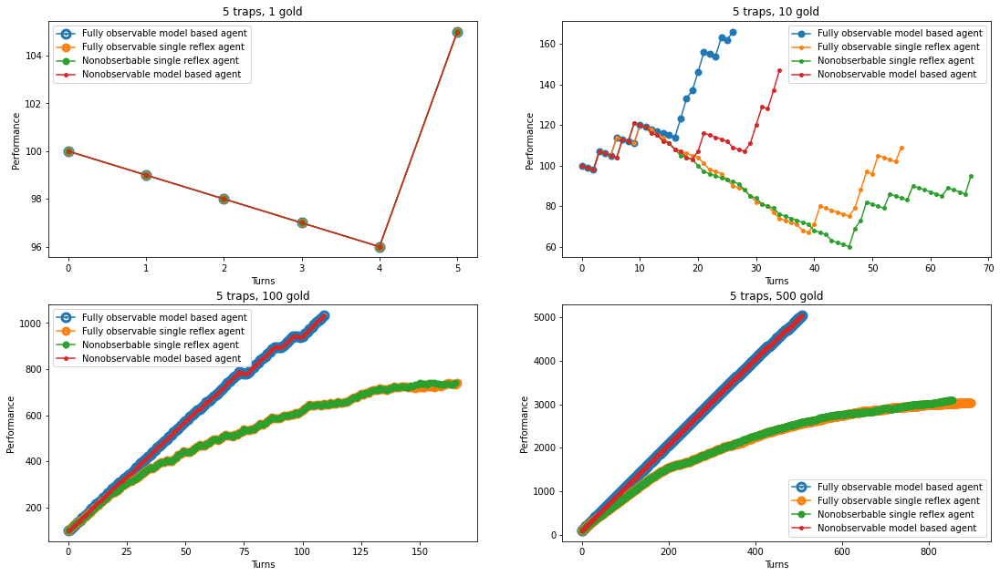

In [43]:
fig, ax = plt.subplots(2,2)
plot_pro_arrays(array1_5, ax[0,0], '5 traps, 1 gold', '.', [9,7,5,2])
plot_pro_arrays(array10_5, ax[0,1], '5 traps, 10 gold', '.', [5,2,2,2])
plot_pro_arrays(array100_5, ax[1,0], '5 traps, 100 gold', '.', [9,7,5,2])
plot_pro_arrays(array500_5, ax[1,1], '5 traps, 500 gold', '.', [9,7,5,2])
fig.set_size_inches(18.5, 10.5)
fig.savefig('vary_gold.jpg', dpi=200)

### When there are 5 traps and just 1 gold, the agents behave very siilarly. When there are 10 gold and 5 traps, the fully obserbable model based agent outperforms all the others, being the partially observable model based agent second and then the single reflex agents, where the nonobserbable version tends to be worse.

### For 100 gold and beyond, the two versions of the model based agent always outperform the simple reflex in both versions. It appears as the observability of the environment becomes negligible at some when the number of gold is high enough.

## 3.7 Testing agent's different positions.

In [170]:
total_golds = 100
total_traps = 100

things = []

for i in range(total_golds):
        x = randrange(width)
        y = randrange(height)
        things.append(Gold((x,y)))

while total_traps > 0:
        total_traps -= 1
        x = randrange(width)
        y = randrange(height)
        things.append(Trap((x,y)))

def run_experiment(env_observable, reflex, position):
    
    width = 5
    height = 5

    directions = [Direction.U, Direction.R, Direction.D, Direction.L]

    agent_x = position[0]
    agent_y = position[1]
    agent_dir = directions[0]

    n = randrange(1000)
    print(n)
    seed(n)
    
    if reflex:
        agent = ReflexGoldDiggerAgent((agent_x, agent_y), Direction(agent_dir))
        environment = GridEnvironment(things = things, agent = agent, fully_observable = env_observable, width = width, height = height)
        environment.run()
        model_score_history = environment.score_history
    
    else:
        agent = ModelGoldDiggerAgent((agent_x, agent_y), Direction(agent_dir))
        environment = GridEnvironment(things = things, agent = agent, fully_observable = env_observable, width = width, height = height)
        environment.run()
        model_score_history = environment.score_history
    
    
    return(model_score_history)

## Perform the computations for all the possible starting points in a given scenario

### There, the gold and traps are kept in a fixed position, and the miner is spawned in every possible position, with the direction arbitrarily decided to be upwards.

In [171]:
Obs_reflex = []
for i in range(5):
    inner_array = []
    for j in range(5):
        exp = run_experiment(True, True, [i,j])
        inner_array.append(exp)
    Obs_reflex.append(inner_array)
    
Obs_model = []
for i in range(5):
    inner_array = []
    for j in range(5):
        exp = run_experiment(True, False, [i,j])
        inner_array.append(exp)
    Obs_model.append(inner_array)

NObs_reflex = []
for i in range(5):
    inner_array = []
    for j in range(5):
        exp = run_experiment(False, True, [i,j])
        inner_array.append(exp)
    NObs_reflex.append(inner_array)
    
Nobs_model = []
for i in range(5):
    inner_array = []
    for j in range(5):
        exp = run_experiment(False, False, [i,j])
        inner_array.append(exp)
    Nobs_model.append(inner_array)


875
<STARTING>
Agent state: (0, 0, Up)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V 6 5) (- 3 7) (- 6 -) (- 2 2) (- 7 5)
1 (- 4 6) (- 3 4) (- 2 4) (- 3 4) (- 1 8)
2 (- 3 8) (- 3 4) (- 5 3) (- 3 2) (- 3 2)
3 (- 2 5) (- 5 6) (- 2 2) (- 9 5) (- 4 2)
4 (- 3 1) (- 7 6) (- 3 2) (- 8 3) (- 3 4)
Agent performance: 100
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (U 6 5) (- 3 7) (- 6 -) (- 2 2) (- 7 5)
1 (- 4 6) (- 3 4) (- 2 4) (- 3 4) (- 1 8)
2 (- 3 8) (- 3 4) (- 5 3) (- 3 2) (- 3 2)
3 (- 2 5) (- 5 6) (- 2 2) (- 9 5) (- 4 2)
4 (- 3 1) (- 7 6) (- 3 2) (- 8 3) (- 3 4)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V 6 5) (- 3 7) (- 6 -) (- 2 2) (- 7 5)
1 (- 4 6) (- 3 4) (- 2 4) (- 3 4) (- 1 8)
2 (- 3 8) (- 3 4) (- 5 3) (- 3 2) (- 3 2)
3 (- 2 5) (- 5 6) (- 2 2) (- 9 5) (- 4 2)
4 (- 3 1) (- 7 6) (- 3 2) (- 8 3) (- 3 4)
<STEP 1>
SELECTED ACTION:

     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - -) (- - -) (- - -) (- - -)
1 (- 2 4) (- 2 3) (D 1 3) (- 3 4) (- - 5)
2 (- 1 6) (- 2 3) (- 5 3) (- 3 2) (- - -)
3 (- - 3) (- 4 5) (- 2 2) (- 9 5) (- 1 -)
4 (- - -) (- - -) (- - -) (- 1 -) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - -) (- - -) (- - -) (- - -)
1 (- 2 4) (- 2 3) (V 1 3) (- 3 4) (- - 5)
2 (- 1 6) (- 2 3) (- 5 3) (- 3 2) (- - -)
3 (- - 3) (- 4 5) (- 2 2) (- 9 5) (- 1 -)
4 (- - -) (- - -) (- - -) (- 1 -) (- - -)
<STEP 100>
SELECTED ACTION: Advance
Agent state: (2, 2, Down)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - -) (V - -) (V - -) (V - -)
1 (V 2 4) (V 2 3) (V 1 3) (- 3 4) (V - 5)
2 (V 1 6) (V 2 3) (V 4 2) (- 3 2) (V - -)
3 (V - 3) (V 4 5) (- 2 2) (- 9 5) (V 1 -)
4 (V - -) (V - -) (V - -) (V 1 -) (V - -)
Agent performance: 277
PERCEPT
  

Agent state: (4, 0, Right)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - -) (V - -) (V - -) (V - -)
1 (V - 2) (V - 1) (V - 1) (V - 1) (V - 5)
2 (V - 4) (V - 1) (V 2 -) (V - -) (V - -)
3 (V - -) (V - -) (V - -) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - -)
Agent performance: 98
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - -) (- - -) (- - -) (R - -)
1 (- - 2) (- - 1) (- - 1) (- - 1) (- - 5)
2 (- - 4) (- - 1) (- 2 -) (- - -) (- - -)
3 (- - -) (- - -) (- - -) (- - -) (- - -)
4 (- - -) (- - -) (- - -) (- - -) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - -) (- - -) (- - -) (V - -)
1 (- - 2) (- - 1) (- - 1) (- - 1) (- - 5)
2 (- - 4) (- - 1) (- 2 -) (- - -) (- - -)
3 (- - -) (- - -) (- - -) (- - -) (- - -)
4 (- - -) (- - -) (- - -) (- - -) (- - -)
<STEP 278>
SELECTED ACTION: Turn
Agent

4 (V - -) (V 4 3) (V - -) (V 5 -) (V - -)
Agent performance: 262
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - 4) (- 3 -) (- - -) (- 1 -)
1 (- 2 4) (- 3 4) (- 2 4) (- 3 4) (- - 5)
2 (- 1 6) (- 3 4) (- 5 3) (- 3 2) (- - -)
3 (- - 3) (- 5 6) (- 2 2) (- 9 5) (- 1 -)
4 (- - -) (L 4 3) (- - -) (- 5 -) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - 4) (- 3 -) (- - -) (- 1 -)
1 (- 2 4) (- 3 4) (- 2 4) (- 3 4) (- - 5)
2 (- 1 6) (- 3 4) (- 5 3) (- 3 2) (- - -)
3 (- - 3) (- 5 6) (- 2 2) (- 9 5) (- 1 -)
4 (- - -) (V 4 3) (- - -) (- 5 -) (- - -)
<STEP 56>
SELECTED ACTION: Advance
Agent state: (0, 4, Left)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 4) (V 3 -) (V - -) (V 1 -)
1 (V 2 4) (- 3 4) (- 2 4) (- 3 4) (V - 5)
2 (V 1 6) (- 3 4) (- 5 3) (- 3 2) (V - -)
3 (V - 3) (- 5 6) (- 2 2) (- 9 5) (V 1 -)
4 (

4 (V - -) (V - -) (V - -) (V - -) (V - -)
Agent performance: 271
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - -) (- - -) (- - -) (- - -)
1 (- - 2) (- 2 3) (- - 2) (- - 1) (- - 5)
2 (- - 4) (- 2 3) (- 3 1) (- - -) (- - -)
3 (D - -) (- 3 4) (- - -) (- - -) (- - -)
4 (- - -) (- - -) (- - -) (- - -) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - -) (- - -) (- - -) (- - -)
1 (- - 2) (- 2 3) (- - 2) (- - 1) (- - 5)
2 (- - 4) (- 2 3) (- 3 1) (- - -) (- - -)
3 (V - -) (- 3 4) (- - -) (- - -) (- - -)
4 (- - -) (- - -) (- - -) (- - -) (- - -)
<STEP 171>
SELECTED ACTION: Turn
Agent state: (0, 3, Left)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - -) (V - -) (V - -) (V - -)
1 (V - 2) (V 2 3) (V - 2) (V - 1) (V - 5)
2 (V - 4) (V 2 3) (V 3 1) (V - -) (V - -)
3 (V - -) (V 3 4) (V - -) (V - -) (V - -)
4 (V 

PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (L - -) (- - -) (- - -) (- - -) (- - -)
1 (- - 2) (- - 1) (- - 1) (- - 1) (- - 5)
2 (- - 4) (- - 1) (- 2 -) (- - -) (- - -)
3 (- - -) (- - -) (- - -) (- - -) (- - -)
4 (- - -) (- - -) (- - -) (- - -) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (- - -) (- - -) (- - -) (- - -)
1 (- - 2) (- - 1) (- - 1) (- - 1) (- - 5)
2 (- - 4) (- - 1) (- 2 -) (- - -) (- - -)
3 (- - -) (- - -) (- - -) (- - -) (- - -)
4 (- - -) (- - -) (- - -) (- - -) (- - -)
<STEP 321>
SELECTED ACTION: Turn
Agent state: (0, 0, Up)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - -) (V - -) (V - -) (V - -)
1 (V - 2) (V - 1) (V - 1) (V - 1) (V - 5)
2 (V - 4) (V - 1) (V 2 -) (V - -) (V - -)
3 (V - -) (V - -) (V - -) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - -)
Agent performance: 12
PERCEPT


AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 2 1) (- 1 5) (- 4 -) (- - -) (- 3 1)
1 (- 2 4) (- 3 4) (- 2 4) (- 3 4) (- - 6)
2 (- 2 7) (- 3 4) (- 5 3) (- 3 2) (- 1 -)
3 (- 1 4) (- 5 6) (- 2 2) (- 9 5) (- 2 -)
4 (V - -) (- 5 4) (- 1 -) (- 6 1) (- - -)
<STEP 39>
SELECTED ACTION: Advance
Agent state: (0, 3, Up)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V 2 1) (V 1 5) (V 4 -) (V - -) (V 3 1)
1 (V 2 4) (- 3 4) (- 2 4) (- 3 4) (V - 6)
2 (V 2 7) (- 3 4) (- 5 3) (- 3 2) (V 1 -)
3 (V - 3) (- 5 6) (- 2 2) (- 9 5) (V 2 -)
4 (V - -) (V 5 4) (V 1 -) (V 6 1) (V - -)
Agent performance: 219
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 2 1) (- 1 5) (- 4 -) (- - -) (- 3 1)
1 (- 2 4) (- 3 4) (- 2 4) (- 3 4) (- - 6)
2 (- 2 7) (- 3 4) (- 5 3) (- 3 2) (- 1 -)
3 (U - 3) (- 5 6) (- 2 2) (- 9 5) (- 2 -)
4 (- - -) (- 5 4) (- 1 -) (- 6 1) (- - -)
AGENT

     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - -) (- - -) (- - -) (- - -)
1 (- 1 3) (- 2 3) (- - 2) (- - 1) (- - 5)
2 (- 1 6) (- 2 3) (- 3 1) (D - -) (- - -)
3 (- - 3) (- 4 5) (- - -) (- 1 -) (- 1 -)
4 (- - -) (- - -) (- - -) (- - -) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - -) (- - -) (- - -) (- - -)
1 (- 1 3) (- 2 3) (- - 2) (- - 1) (- - 5)
2 (- 1 6) (- 2 3) (- 3 1) (V - -) (- - -)
3 (- - 3) (- 4 5) (- - -) (- 1 -) (- 1 -)
4 (- - -) (- - -) (- - -) (- - -) (- - -)
<STEP 152>
SELECTED ACTION: Advance
Agent state: (3, 3, Down)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - -) (V - -) (V - -) (V - -)
1 (V 1 3) (V 2 3) (V - 2) (V - 1) (V - 5)
2 (V 1 6) (V 2 3) (V 3 1) (V - -) (V - -)
3 (V - 3) (V 4 5) (V - -) (V - -) (V 1 -)
4 (V - -) (V - -) (V - -) (V - -) (V - -)
Agent performance: 304
PERCEPT
  

PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - -) (R - -) (- - -) (- - -)
1 (- - 2) (- - 1) (- - 2) (- - 1) (- - 5)
2 (- - 5) (- - 1) (- 3 1) (- - -) (- - -)
3 (- - 1) (- 1 2) (- - -) (- - -) (- - -)
4 (- - -) (- - -) (- - -) (- - -) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - -) (V - -) (- - -) (- - -)
1 (- - 2) (- - 1) (- - 2) (- - 1) (- - 5)
2 (- - 5) (- - 1) (- 3 1) (- - -) (- - -)
3 (- - 1) (- 1 2) (- - -) (- - -) (- - -)
4 (- - -) (- - -) (- - -) (- - -) (- - -)
<STEP 316>
SELECTED ACTION: Advance
Agent state: (3, 0, Right)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - -) (V - -) (V - -) (V - -)
1 (V - 2) (V - 1) (V - 2) (V - 1) (V - 5)
2 (V - 5) (V - 1) (V 3 1) (V - -) (V - -)
3 (V - 1) (V 1 2) (V - -) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - -)
Agent performance: 31
PE

Agent performance: 263
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - 4) (- 3 -) (- - -) (- 1 -)
1 (- 1 3) (- 3 4) (- 2 4) (- 3 4) (- - 5)
2 (- - 5) (- 3 4) (- 5 3) (- 3 2) (- - -)
3 (- - 3) (- 5 6) (- 2 2) (- 9 5) (- 1 -)
4 (- - -) (R 3 2) (- - -) (- 5 -) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - 4) (- 3 -) (- - -) (- 1 -)
1 (- 1 3) (- 3 4) (- 2 4) (- 3 4) (- - 5)
2 (- - 5) (- 3 4) (- 5 3) (- 3 2) (- - -)
3 (- - 3) (- 5 6) (- 2 2) (- 9 5) (- 1 -)
4 (- - -) (V 3 2) (- - -) (- 5 -) (- - -)
<STEP 62>
SELECTED ACTION: Advance
Agent state: (2, 4, Right)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 4) (V 3 -) (V - -) (V 1 -)
1 (V 1 3) (- 3 4) (- 2 4) (- 3 4) (V - 5)
2 (V - 5) (- 3 4) (- 5 3) (- 3 2) (V - -)
3 (V - 3) (- 5 6) (- 2 2) (- 9 5) (V 1 -)
4 (V - -) (V 3 2) (V - -) (V 5 -) (V - -)
Ag

AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (- - -) (- - -) (- - -) (- - -)
1 (- - 2) (- - 1) (- - 2) (- - 1) (- - 5)
2 (- - 4) (- - 1) (- 3 1) (- - -) (- - -)
3 (- - 1) (- 1 2) (- - -) (- - -) (- - -)
4 (- - -) (- - -) (- - -) (- - -) (- - -)
<STEP 205>
SELECTED ACTION: Turn
Agent state: (0, 0, Up)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - -) (V - -) (V - -) (V - -)
1 (V - 2) (V - 1) (V - 2) (V - 1) (V - 5)
2 (V - 4) (V - 1) (V 3 1) (V - -) (V - -)
3 (V - 1) (V 1 2) (V - -) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - -)
Agent performance: 229
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (U - -) (- - -) (- - -) (- - -) (- - -)
1 (- - 2) (- - 1) (- - 2) (- - 1) (- - 5)
2 (- - 4) (- - 1) (- 3 1) (- - -) (- - -)
3 (- - 1) (- 1 2) (- - -) (- - -) (- - -)
4 (- - -) (- - -) (- - -) (- - -) (- - -)
AGENT'S

<STEP 24>
SELECTED ACTION: Advance
Agent state: (0, 0, Up)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V 3 2) (V 2 6) (V 5 -) (V 1 1) (V 5 3)
1 (V 2 4) (- 3 4) (- 2 4) (- 3 4) (V - 7)
2 (V 1 6) (- 3 4) (- 5 3) (- 3 2) (V 2 1)
3 (V - 3) (- 5 6) (- 2 2) (- 9 5) (V 3 1)
4 (V 1 -) (V 6 5) (V 2 1) (V 7 2) (V 1 2)
Agent performance: 196
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (U 3 2) (- 2 6) (- 5 -) (- 1 1) (- 5 3)
1 (- 2 4) (- 3 4) (- 2 4) (- 3 4) (- - 7)
2 (- 1 6) (- 3 4) (- 5 3) (- 3 2) (- 2 1)
3 (- - 3) (- 5 6) (- 2 2) (- 9 5) (- 3 1)
4 (- 1 -) (- 6 5) (- 2 1) (- 7 2) (- 1 2)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V 3 2) (- 2 6) (- 5 -) (- 1 1) (- 5 3)
1 (- 2 4) (- 3 4) (- 2 4) (- 3 4) (- - 7)
2 (- 1 6) (- 3 4) (- 5 3) (- 3 2) (- 2 1)
3 (- - 3) (- 5 6) (- 2 2) (- 9 5) (- 3 1)
4 (- 1 -) (- 6 5) (- 2 1) (- 7 2) (- 1 2)
<STEP

AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - 4) (- 3 -) (V - -) (- 1 -)
1 (- 1 3) (- 3 4) (- 2 4) (- 2 3) (- - 5)
2 (- - 5) (- 3 4) (- 5 3) (- 2 1) (- - -)
3 (- - 1) (- 4 5) (- 1 1) (- 7 3) (- - -)
4 (- - -) (- - -) (- - -) (- - -) (- - -)
<STEP 103>
SELECTED ACTION: Advance
Agent state: (4, 0, Right)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 4) (V 3 -) (V - -) (V - -)
1 (V 1 3) (- 3 4) (- 2 4) (V 2 3) (V - 5)
2 (V - 5) (- 3 4) (- 5 3) (V 2 1) (V - -)
3 (V - 1) (V 4 5) (V 1 1) (V 7 3) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - -)
Agent performance: 289
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - 4) (- 3 -) (- - -) (R - -)
1 (- 1 3) (- 3 4) (- 2 4) (- 2 3) (- - 5)
2 (- - 5) (- 3 4) (- 5 3) (- 2 1) (- - -)
3 (- - 1) (- 4 5) (- 1 1) (- 7 3) (- - -)
4 (- - -) (- - -) (- - -) (- - -) (- - -)
A

4 (V - -) (V - -) (V - -) (V - -) (V - -)
Agent performance: 142
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - 3) (- - -) (R - -) (- - -)
1 (- - 2) (- 3 4) (- - 1) (- - 1) (- - 5)
2 (- - 4) (- 3 4) (- 2 -) (- - -) (- - -)
3 (- - -) (- - -) (- - -) (- - -) (- - -)
4 (- - -) (- - -) (- - -) (- - -) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - 3) (- - -) (V - -) (- - -)
1 (- - 2) (- 3 4) (- - 1) (- - 1) (- - 5)
2 (- - 4) (- 3 4) (- 2 -) (- - -) (- - -)
3 (- - -) (- - -) (- - -) (- - -) (- - -)
4 (- - -) (- - -) (- - -) (- - -) (- - -)
<STEP 241>
SELECTED ACTION: Advance
Agent state: (4, 0, Right)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1 (V - 2) (- 3 4) (V - 1) (V - 1) (V - 5)
2 (V - 4) (- 3 4) (V 2 -) (V - -) (V - -)
3 (V - -) (V - -) (V - -) (V - -) (V - -)
4

     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V 4 3) (V 1 5) (V 4 -) (V - -) (V 3 1)
1 (V 3 5) (- 3 4) (- 2 4) (- 3 4) (V - 6)
2 (V 2 7) (- 3 4) (- 5 3) (- 3 2) (V 1 -)
3 (V 1 4) (- 5 6) (- 2 2) (- 9 5) (V 2 -)
4 (V - -) (V 5 4) (V 1 -) (V 6 1) (V - -)
Agent performance: 211
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 4 3) (- 1 5) (- 4 -) (- - -) (- 3 1)
1 (- 3 5) (- 3 4) (- 2 4) (- 3 4) (- - 6)
2 (- 2 7) (- 3 4) (- 5 3) (- 3 2) (- 1 -)
3 (- 1 4) (- 5 6) (- 2 2) (- 9 5) (- 2 -)
4 (U - -) (- 5 4) (- 1 -) (- 6 1) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 4 3) (- 1 5) (- 4 -) (- - -) (- 3 1)
1 (- 3 5) (- 3 4) (- 2 4) (- 3 4) (- - 6)
2 (- 2 7) (- 3 4) (- 5 3) (- 3 2) (- 1 -)
3 (- 1 4) (- 5 6) (- 2 2) (- 9 5) (- 2 -)
4 (V - -) (- 5 4) (- 1 -) (- 6 1) (- - -)
<STEP 36>
SELECTED ACTION: Advance
Agent state: (0, 3, Up)
     

4 (V - -) (V - -) (V - -) (V - -) (V - -)
Agent performance: 276
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - -) (- - -) (- - -) (- - -)
1 (- - 2) (- 2 3) (- - 2) (- - 1) (- - 5)
2 (- - 4) (- 2 3) (- 3 1) (- - -) (- - -)
3 (- - -) (R 2 3) (- - -) (- - -) (- - -)
4 (- - -) (- - -) (- - -) (- - -) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - -) (- - -) (- - -) (- - -)
1 (- - 2) (- 2 3) (- - 2) (- - 1) (- - 5)
2 (- - 4) (- 2 3) (- 3 1) (- - -) (- - -)
3 (- - -) (V 2 3) (- - -) (- - -) (- - -)
4 (- - -) (- - -) (- - -) (- - -) (- - -)
<STEP 173>
SELECTED ACTION: Advance
Agent state: (2, 3, Right)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - -) (V - -) (V - -) (V - -)
1 (V - 2) (V 2 3) (V - 2) (V - 1) (V - 5)
2 (V - 4) (V 2 3) (V 3 1) (V - -) (V - -)
3 (V - -) (V 2 3) (V - -) (V - -) (V - -)
4

AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 6 5) (- 1 5) (- 5 -) (V 1 1) (- 7 5)
1 (- 4 6) (- 3 4) (- 2 4) (- 3 4) (- 1 8)
2 (- 3 8) (- 3 4) (- 5 3) (- 3 2) (- 3 2)
3 (- 2 5) (- 5 6) (- 2 2) (- 9 5) (- 4 2)
4 (- 3 1) (- 7 6) (- 3 2) (- 8 3) (- 3 4)
<STEP 5>
SELECTED ACTION: Advance
Agent state: (4, 0, Right)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 6 5) (V 1 5) (V 5 -) (V 1 1) (V 6 4)
1 (- 4 6) (V 3 4) (- 2 4) (- 3 4) (- 1 8)
2 (- 3 8) (- 3 4) (- 5 3) (- 3 2) (- 3 2)
3 (- 2 5) (- 5 6) (- 2 2) (- 9 5) (- 4 2)
4 (- 3 1) (- 7 6) (- 3 2) (- 8 3) (- 3 4)
Agent performance: 125
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 6 5) (- 1 5) (- 5 -) (- 1 1) (R 6 4)
1 (- 4 6) (- 3 4) (- 2 4) (- 3 4) (- 1 8)
2 (- 3 8) (- 3 4) (- 5 3) (- 3 2) (- 3 2)
3 (- 2 5) (- 5 6) (- 2 2) (- 9 5) (- 4 2)
4 (- 3 1) (- 7 6) (- 3 2) (- 8 3) (- 3 4)
AGE

4 (- - -) (V - -) (- - -) (- 1 -) (- - -)
<STEP 80>
SELECTED ACTION: Advance
Agent state: (1, 3, Up)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V 2 1) (V - 3) (V 3 -) (V - -) (V 1 -)
1 (V 2 4) (V 3 4) (- 2 4) (- 3 4) (V - 5)
2 (V 1 6) (- 3 4) (- 5 3) (- 3 2) (V - -)
3 (V - 3) (V 4 5) (- 2 2) (- 9 5) (V 1 -)
4 (V - -) (V - -) (V - -) (V 1 -) (V - -)
Agent performance: 259
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 2 1) (- - 3) (- 3 -) (- - -) (- 1 -)
1 (- 2 4) (- 3 4) (- 2 4) (- 3 4) (- - 5)
2 (- 1 6) (- 3 4) (- 5 3) (- 3 2) (- - -)
3 (- - 3) (U 4 5) (- 2 2) (- 9 5) (- 1 -)
4 (- - -) (- - -) (- - -) (- 1 -) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 2 1) (- - 3) (- 3 -) (- - -) (- 1 -)
1 (- 2 4) (- 3 4) (- 2 4) (- 3 4) (- - 5)
2 (- 1 6) (- 3 4) (- 5 3) (- 3 2) (- - -)
3 (- - 3) (V 4 5) (- 2 2) (- 9 5) (- 1 -)
4 (- 

PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - -) (- - -) (- - -) (- - -)
1 (- - 2) (- 2 3) (- - 2) (- - 1) (- - 5)
2 (- - 4) (- 2 3) (- 3 1) (- - -) (- - -)
3 (D - -) (- 3 4) (- - -) (- - -) (- - -)
4 (- - -) (- - -) (- - -) (- - -) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - -) (- - -) (- - -) (- - -)
1 (- - 2) (- 2 3) (- - 2) (- - 1) (- - 5)
2 (- - 4) (- 2 3) (- 3 1) (- - -) (- - -)
3 (V - -) (- 3 4) (- - -) (- - -) (- - -)
4 (- - -) (- - -) (- - -) (- - -) (- - -)
<STEP 170>
SELECTED ACTION: Turn
Agent state: (0, 3, Left)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - -) (V - -) (V - -) (V - -)
1 (V - 2) (V 2 3) (V - 2) (V - 1) (V - 5)
2 (V - 4) (V 2 3) (V 3 1) (V - -) (V - -)
3 (V - -) (V 3 4) (V - -) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - -)
Agent performance: 273
PERCE

SELECTED ACTION: Turn
Agent state: (0, 0, Right)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - -) (V - -) (V - -) (V - -)
1 (V - 2) (V - 1) (V - 1) (V - 1) (V - 5)
2 (V - 4) (V - 1) (V 2 -) (V - -) (V - -)
3 (V - -) (V - -) (V - -) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - -)
Agent performance: 30
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (R - -) (- - -) (- - -) (- - -) (- - -)
1 (- - 2) (- - 1) (- - 1) (- - 1) (- - 5)
2 (- - 4) (- - 1) (- 2 -) (- - -) (- - -)
3 (- - -) (- - -) (- - -) (- - -) (- - -)
4 (- - -) (- - -) (- - -) (- - -) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (- - -) (- - -) (- - -) (- - -)
1 (- - 2) (- - 1) (- - 1) (- - 1) (- - 5)
2 (- - 4) (- - 1) (- 2 -) (- - -) (- - -)
3 (- - -) (- - -) (- - -) (- - -) (- - -)
4 (- - -) (- - -) (- - -) (- - -) (- - -)
<STEP 314>
SELEC

     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V 2 1) (V - 3) (V 3 -) (V - -) (V 3 1)
1 (V 2 4) (V 2 3) (- 2 4) (- 3 4) (V - 6)
2 (V 1 6) (V 3 4) (- 5 3) (- 3 2) (V 1 -)
3 (V - 3) (- 5 6) (- 2 2) (- 9 5) (V 2 -)
4 (V - -) (V 5 4) (V 1 -) (V 6 1) (V - -)
Agent performance: 230
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 2 1) (- - 3) (R 3 -) (- - -) (- 3 1)
1 (- 2 4) (- 2 3) (- 2 4) (- 3 4) (- - 6)
2 (- 1 6) (- 3 4) (- 5 3) (- 3 2) (- 1 -)
3 (- - 3) (- 5 6) (- 2 2) (- 9 5) (- 2 -)
4 (- - -) (- 5 4) (- 1 -) (- 6 1) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 2 1) (- - 3) (V 3 -) (- - -) (- 3 1)
1 (- 2 4) (- 2 3) (- 2 4) (- 3 4) (- - 6)
2 (- 1 6) (- 3 4) (- 5 3) (- 3 2) (- 1 -)
3 (- - 3) (- 5 6) (- 2 2) (- 9 5) (- 2 -)
4 (- - -) (- 5 4) (- 1 -) (- 6 1) (- - -)
<STEP 45>
SELECTED ACTION: Advance
Agent state: (3, 0, Right)
  

<STEP 110>
SELECTED ACTION: Turn
Agent state: (2, 0, Right)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - -) (V - -) (V - -) (V - -)
1 (V 2 4) (V 1 2) (V - 2) (- 3 4) (V - 5)
2 (V 1 6) (V 2 3) (V 3 1) (- 3 2) (V - -)
3 (V - 3) (V 4 5) (V - -) (- 9 5) (V 1 -)
4 (V - -) (V - -) (V - -) (V 1 -) (V - -)
Agent performance: 280
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - -) (R - -) (- - -) (- - -)
1 (- 2 4) (- 1 2) (- - 2) (- 3 4) (- - 5)
2 (- 1 6) (- 2 3) (- 3 1) (- 3 2) (- - -)
3 (- - 3) (- 4 5) (- - -) (- 9 5) (- 1 -)
4 (- - -) (- - -) (- - -) (- 1 -) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - -) (V - -) (- - -) (- - -)
1 (- 2 4) (- 1 2) (- - 2) (- 3 4) (- - 5)
2 (- 1 6) (- 2 3) (- 3 1) (- 3 2) (- - -)
3 (- - 3) (- 4 5) (- - -) (- 9 5) (- 1 -)
4 (- - -) (- - -) (- - -) (- 1 -) (- - -)
<STE

     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - -) (- - -) (- - -) (- - -)
1 (- - 2) (U - -) (- - 1) (- - 1) (- - 5)
2 (- - 4) (- - 1) (- 2 -) (- - -) (- - -)
3 (- - -) (- - -) (- - -) (- - -) (- - -)
4 (- - -) (- - -) (- - -) (- - -) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - -) (- - -) (- - -) (- - -)
1 (- - 2) (V - -) (- - 1) (- - 1) (- - 5)
2 (- - 4) (- - 1) (- 2 -) (- - -) (- - -)
3 (- - -) (- - -) (- - -) (- - -) (- - -)
4 (- - -) (- - -) (- - -) (- - -) (- - -)
<STEP 256>
SELECTED ACTION: Advance
Agent state: (1, 0, Up)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - -) (V - -) (V - -) (V - -)
1 (V - 2) (V - -) (V - 1) (V - 1) (V - 5)
2 (V - 4) (V - 1) (V 2 -) (V - -) (V - -)
3 (V - -) (V - -) (V - -) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - -)
Agent performance: 122
PERCEPT
    

<STEP 62>
SELECTED ACTION: Advance
Agent state: (3, 4, Right)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V 2 1) (V - 3) (V 3 -) (V - -) (V 1 -)
1 (V 2 4) (V 2 3) (- 2 4) (- 3 4) (V - 5)
2 (V 1 6) (V 2 3) (- 5 3) (- 3 2) (V - -)
3 (V - 3) (V 5 6) (- 2 2) (- 9 5) (V 1 -)
4 (V - -) (V 3 2) (V - -) (V 4 -) (V - -)
Agent performance: 256
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 2 1) (- - 3) (- 3 -) (- - -) (- 1 -)
1 (- 2 4) (- 2 3) (- 2 4) (- 3 4) (- - 5)
2 (- 1 6) (- 2 3) (- 5 3) (- 3 2) (- - -)
3 (- - 3) (- 5 6) (- 2 2) (- 9 5) (- 1 -)
4 (- - -) (- 3 2) (- - -) (R 4 -) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 2 1) (- - 3) (- 3 -) (- - -) (- 1 -)
1 (- 2 4) (- 2 3) (- 2 4) (- 3 4) (- - 5)
2 (- 1 6) (- 2 3) (- 5 3) (- 3 2) (- - -)
3 (- - 3) (- 5 6) (- 2 2) (- 9 5) (- 1 -)
4 (- - -) (- 3 2) (- - -) (V 4 -) (- - -)
<S

AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - -) (- - -) (- - -) (- - -)
1 (- - 2) (- 1 2) (- - 2) (- - 1) (- - 5)
2 (- - 4) (- 1 2) (- 3 1) (- - -) (- - -)
3 (V - -) (- 3 4) (- - -) (- - -) (- - -)
4 (- - -) (- - -) (- - -) (- - -) (- - -)
<STEP 172>
SELECTED ACTION: Turn
Agent state: (0, 3, Left)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - -) (V - -) (V - -) (V - -)
1 (V - 2) (V 1 2) (V - 2) (V - 1) (V - 5)
2 (V - 4) (V 1 2) (V 3 1) (V - -) (V - -)
3 (V - -) (V 3 4) (V - -) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - -)
Agent performance: 277
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - -) (- - -) (- - -) (- - -)
1 (- - 2) (- 1 2) (- - 2) (- - 1) (- - 5)
2 (- - 4) (- 1 2) (- 3 1) (- - -) (- - -)
3 (L - -) (- 3 4) (- - -) (- - -) (- - -)
4 (- - -) (- - -) (- - -) (- - -) (- - -)
AGENT

AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 2 1) (- - 3) (V 3 -) (- - -) (- 3 1)
1 (- 2 4) (- 2 3) (- 2 4) (- 3 4) (- - 6)
2 (- 1 6) (- 2 3) (- 5 3) (- 3 2) (- 1 -)
3 (- - 3) (- 4 5) (- 2 2) (- 9 5) (- 2 -)
4 (- - -) (- 5 4) (- 1 -) (- 6 1) (- - -)
<STEP 47>
SELECTED ACTION: Advance
Agent state: (3, 0, Right)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V 2 1) (V - 3) (V 3 -) (V - -) (V 3 1)
1 (V 2 4) (V 2 3) (- 2 4) (- 3 4) (V - 6)
2 (V 1 6) (V 2 3) (- 5 3) (- 3 2) (V 1 -)
3 (V - 3) (V 4 5) (- 2 2) (- 9 5) (V 2 -)
4 (V - -) (V 5 4) (V 1 -) (V 6 1) (V - -)
Agent performance: 233
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 2 1) (- - 3) (- 3 -) (R - -) (- 3 1)
1 (- 2 4) (- 2 3) (- 2 4) (- 3 4) (- - 6)
2 (- 1 6) (- 2 3) (- 5 3) (- 3 2) (- 1 -)
3 (- - 3) (- 4 5) (- 2 2) (- 9 5) (- 2 -)
4 (- - -) (- 5 4) (- 1 -) (- 6 1) (- - -)
AG

PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (R - -) (- - -) (- - -) (- - -) (- - -)
1 (- 1 3) (- 1 2) (- - 2) (- - 1) (- - 5)
2 (- - 5) (- 1 2) (- 3 1) (- - -) (- - -)
3 (- - 1) (- 2 3) (- - -) (- - -) (- - -)
4 (- - -) (- - -) (- - -) (- - -) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (- - -) (- - -) (- - -) (- - -)
1 (- 1 3) (- 1 2) (- - 2) (- - 1) (- - 5)
2 (- - 5) (- 1 2) (- 3 1) (- - -) (- - -)
3 (- - 1) (- 2 3) (- - -) (- - -) (- - -)
4 (- - -) (- - -) (- - -) (- - -) (- - -)
<STEP 169>
SELECTED ACTION: Turn
Agent state: (0, 0, Down)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - -) (V - -) (V - -) (V - -)
1 (V 1 3) (V 1 2) (V - 2) (V - 1) (V - 5)
2 (V - 5) (V 1 2) (V 3 1) (V - -) (V - -)
3 (V - 1) (V 2 3) (V - -) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - -)
Agent performance: 294
PERCE

Agent state: (0, 3, Down)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - -) (V - -) (V - -) (V - -)
1 (V - 2) (V 1 2) (V - 2) (V - 1) (V - 5)
2 (V - 4) (V 1 2) (V 3 1) (V - -) (V - -)
3 (V - -) (V - 1) (V - -) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - -)
Agent performance: 20
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - -) (- - -) (- - -) (- - -)
1 (- - 2) (- 1 2) (- - 2) (- - 1) (- - 5)
2 (- - 4) (- 1 2) (- 3 1) (- - -) (- - -)
3 (D - -) (- - 1) (- - -) (- - -) (- - -)
4 (- - -) (- - -) (- - -) (- - -) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - -) (- - -) (- - -) (- - -)
1 (- - 2) (- 1 2) (- - 2) (- - 1) (- - 5)
2 (- - 4) (- 1 2) (- 3 1) (- - -) (- - -)
3 (V - -) (- - 1) (- - -) (- - -) (- - -)
4 (- - -) (- - -) (- - -) (- - -) (- - -)
<STEP 335>
SELECTED ACTION: Advance
Age

AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 2 1) (- 1 5) (V 3 -) (- - -) (- 3 1)
1 (- 2 4) (- 3 4) (- 2 4) (- 3 4) (- - 6)
2 (- 1 6) (- 3 4) (- 5 3) (- 3 2) (- 1 -)
3 (- - 3) (- 5 6) (- 2 2) (- 9 5) (- 2 -)
4 (- - -) (- 5 4) (- 1 -) (- 6 1) (- - -)
<STEP 42>
SELECTED ACTION: Advance
Agent state: (3, 0, Right)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V 2 1) (V 1 5) (V 3 -) (V - -) (V 3 1)
1 (V 2 4) (- 3 4) (- 2 4) (- 3 4) (V - 6)
2 (V 1 6) (- 3 4) (- 5 3) (- 3 2) (V 1 -)
3 (V - 3) (- 5 6) (- 2 2) (- 9 5) (V 2 -)
4 (V - -) (V 5 4) (V 1 -) (V 6 1) (V - -)
Agent performance: 227
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 2 1) (- 1 5) (- 3 -) (R - -) (- 3 1)
1 (- 2 4) (- 3 4) (- 2 4) (- 3 4) (- - 6)
2 (- 1 6) (- 3 4) (- 5 3) (- 3 2) (- 1 -)
3 (- - 3) (- 5 6) (- 2 2) (- 9 5) (- 2 -)
4 (- - -) (- 5 4) (- 1 -) (- 6 1) (- - -)
AG

PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 2 1) (- - 3) (- 2 -) (- - -) (D - -)
1 (- 2 4) (- 2 3) (- 2 4) (- 3 4) (- - 5)
2 (- 1 6) (- 2 3) (- 5 3) (- 3 2) (- - -)
3 (- - 3) (- 4 5) (- 2 2) (- 9 5) (- 1 -)
4 (- - -) (- - -) (- - -) (- 1 -) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 2 1) (- - 3) (- 2 -) (- - -) (V - -)
1 (- 2 4) (- 2 3) (- 2 4) (- 3 4) (- - 5)
2 (- 1 6) (- 2 3) (- 5 3) (- 3 2) (- - -)
3 (- - 3) (- 4 5) (- 2 2) (- 9 5) (- 1 -)
4 (- - -) (- - -) (- - -) (- 1 -) (- - -)
<STEP 87>
SELECTED ACTION: Turn
Agent state: (4, 0, Left)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V 2 1) (V - 3) (V 2 -) (V - -) (V - -)
1 (V 2 4) (V 2 3) (- 2 4) (- 3 4) (V - 5)
2 (V 1 6) (V 2 3) (- 5 3) (- 3 2) (V - -)
3 (V - 3) (V 4 5) (- 2 2) (- 9 5) (V 1 -)
4 (V - -) (V - -) (V - -) (V 1 -) (V - -)
Agent performance: 276
PERCEP

<STEP 151>
SELECTED ACTION: Turn
Agent state: (4, 3, Down)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 2) (V 1 -) (V - -) (V - -)
1 (V 1 3) (V 2 3) (- 2 4) (V - -) (V - 5)
2 (V - 5) (V 2 3) (- 5 3) (V - -) (V - -)
3 (V - 2) (V 4 5) (- 2 2) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - -)
Agent performance: 284
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - 2) (- 1 -) (- - -) (- - -)
1 (- 1 3) (- 2 3) (- 2 4) (- - -) (- - 5)
2 (- - 5) (- 2 3) (- 5 3) (- - -) (- - -)
3 (- - 2) (- 4 5) (- 2 2) (- - -) (D - -)
4 (- - -) (- - -) (- - -) (- - -) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - 2) (- 1 -) (- - -) (- - -)
1 (- 1 3) (- 2 3) (- 2 4) (- - -) (- - 5)
2 (- - 5) (- 2 3) (- 5 3) (- - -) (- - -)
3 (- - 2) (- 4 5) (- 2 2) (- - -) (V - -)
4 (- - -) (- - -) (- - -) (- - -) (- - -)
<STEP

<STEP 290>
SELECTED ACTION: Turn
Agent state: (0, 0, Down)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 2) (V - -) (V - -) (V - -)
1 (V - 2) (V 2 3) (V - 1) (V - -) (V - 5)
2 (V - 3) (V 1 2) (V 1 -) (V - -) (V - -)
3 (V - -) (V - 1) (V - -) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - -)
Agent performance: 149
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (D - -) (- - 2) (- - -) (- - -) (- - -)
1 (- - 2) (- 2 3) (- - 1) (- - -) (- - 5)
2 (- - 3) (- 1 2) (- 1 -) (- - -) (- - -)
3 (- - -) (- - 1) (- - -) (- - -) (- - -)
4 (- - -) (- - -) (- - -) (- - -) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (- - 2) (- - -) (- - -) (- - -)
1 (- - 2) (- 2 3) (- - 1) (- - -) (- - 5)
2 (- - 3) (- 1 2) (- 1 -) (- - -) (- - -)
3 (- - -) (- - 1) (- - -) (- - -) (- - -)
4 (- - -) (- - -) (- - -) (- - -) (- - -)
<STEP

     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (- - 2) (- - -) (- - -) (- - -)
1 (- - 2) (- 2 3) (- - 1) (- - -) (- - 5)
2 (- - 3) (- 1 2) (- 1 -) (- - -) (- - -)
3 (- - -) (- - 1) (- - -) (- - -) (- - -)
4 (- - -) (- - -) (- - -) (- - -) (- - -)
<STEP 419>
SELECTED ACTION: Turn
Agent state: (0, 0, Left)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 2) (V - -) (V - -) (V - -)
1 (V - 2) (V 2 3) (V - 1) (V - -) (V - 5)
2 (V - 3) (V 1 2) (V 1 -) (V - -) (V - -)
3 (V - -) (V - 1) (V - -) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - -)
Agent performance: 20
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (L - -) (- - 2) (- - -) (- - -) (- - -)
1 (- - 2) (- 2 3) (- - 1) (- - -) (- - 5)
2 (- - 3) (- 1 2) (- 1 -) (- - -) (- - -)
3 (- - -) (- - 1) (- - -) (- - -) (- - -)
4 (- - -) (- - -) (- - -) (- - -) (- - -)
AGENT'S INTERNAL STATE
     0

4 (V - -) (V 5 4) (V 1 -) (V 6 1) (V - -)
Agent performance: 230
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (R 2 1) (- 2 6) (- 3 -) (- - -) (- 3 1)
1 (- 2 4) (- 3 4) (- 2 4) (- 3 4) (- - 6)
2 (- 1 6) (- 3 4) (- 5 3) (- 3 2) (- 1 -)
3 (- - 3) (- 5 6) (- 2 2) (- 9 5) (- 2 -)
4 (- - -) (- 5 4) (- 1 -) (- 6 1) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V 2 1) (- 2 6) (- 3 -) (- - -) (- 3 1)
1 (- 2 4) (- 3 4) (- 2 4) (- 3 4) (- - 6)
2 (- 1 6) (- 3 4) (- 5 3) (- 3 2) (- 1 -)
3 (- - 3) (- 5 6) (- 2 2) (- 9 5) (- 2 -)
4 (- - -) (- 5 4) (- 1 -) (- 6 1) (- - -)
<STEP 41>
SELECTED ACTION: Advance
Agent state: (1, 0, Right)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V 2 1) (V 1 5) (V 3 -) (V - -) (V 3 1)
1 (V 2 4) (- 3 4) (V 2 4) (- 3 4) (V - 6)
2 (V 1 6) (- 3 4) (- 5 3) (- 3 2) (V 1 -)
3 (V - 3) (- 5 6) (- 2 2) (- 9 5) (V 2 -)
4 

<STEP 134>
SELECTED ACTION: Advance
Agent state: (3, 2, Up)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V 2 1) (V - 3) (V - -) (V - -) (V - -)
1 (V 2 4) (V 2 3) (V - 2) (V - 1) (V - 5)
2 (V 1 6) (V 2 3) (V 3 1) (V - -) (V - -)
3 (V - 3) (V 4 5) (V - -) (V 3 -) (V 1 -)
4 (V - -) (V - -) (V - -) (V - -) (V - -)
Agent performance: 311
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 2 1) (- - 3) (- - -) (- - -) (- - -)
1 (- 2 4) (- 2 3) (- - 2) (- - 1) (- - 5)
2 (- 1 6) (- 2 3) (- 3 1) (U - -) (- - -)
3 (- - 3) (- 4 5) (- - -) (- 3 -) (- 1 -)
4 (- - -) (- - -) (- - -) (- - -) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 2 1) (- - 3) (- - -) (- - -) (- - -)
1 (- 2 4) (- 2 3) (- - 2) (- - 1) (- - 5)
2 (- 1 6) (- 2 3) (- 3 1) (V - -) (- - -)
3 (- - 3) (- 4 5) (- - -) (- 3 -) (- 1 -)
4 (- - -) (- - -) (- - -) (- - -) (- - -)
<STE

4 (- 3 1) (- 7 6) (- 3 2) (- 8 3) (- 3 4)
Agent performance: 126
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 6 5) (- 3 7) (- 4 -) (R 1 1) (- 7 5)
1 (- 4 6) (- 3 4) (- 1 3) (- 3 4) (- 1 8)
2 (- 3 8) (- 3 4) (- 5 3) (- 3 2) (- 3 2)
3 (- 2 5) (- 5 6) (- 2 2) (- 9 5) (- 4 2)
4 (- 3 1) (- 7 6) (- 3 2) (- 8 3) (- 3 4)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 6 5) (- 3 7) (- 4 -) (V 1 1) (- 7 5)
1 (- 4 6) (- 3 4) (- 1 3) (- 3 4) (- 1 8)
2 (- 3 8) (- 3 4) (- 5 3) (- 3 2) (- 3 2)
3 (- 2 5) (- 5 6) (- 2 2) (- 9 5) (- 4 2)
4 (- 3 1) (- 7 6) (- 3 2) (- 8 3) (- 3 4)
<STEP 5>
SELECTED ACTION: Advance
Agent state: (4, 0, Right)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 6 5) (- 3 7) (V 4 -) (V 1 1) (V 6 4)
1 (- 4 6) (- 3 4) (V 1 3) (- 3 4) (- 1 8)
2 (- 3 8) (- 3 4) (V 5 3) (- 3 2) (- 3 2)
3 (- 2 5) (- 5 6) (- 2 2) (- 9 5) (- 4 2)
4 (

<STEP 110>
SELECTED ACTION: Advance
Agent state: (3, 3, Down)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V 2 1) (V - 3) (V - -) (V - -) (V - -)
1 (V 2 4) (V 2 3) (V - 1) (V 2 3) (V - 5)
2 (V 1 6) (V 2 3) (V 3 1) (V 2 1) (V - -)
3 (V - 3) (V 4 5) (V - -) (V 8 4) (V 1 -)
4 (V - -) (V - -) (V - -) (V 1 -) (V - -)
Agent performance: 293
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 2 1) (- - 3) (- - -) (- - -) (- - -)
1 (- 2 4) (- 2 3) (- - 1) (- 2 3) (- - 5)
2 (- 1 6) (- 2 3) (- 3 1) (- 2 1) (- - -)
3 (- - 3) (- 4 5) (- - -) (D 8 4) (- 1 -)
4 (- - -) (- - -) (- - -) (- 1 -) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 2 1) (- - 3) (- - -) (- - -) (- - -)
1 (- 2 4) (- 2 3) (- - 1) (- 2 3) (- - 5)
2 (- 1 6) (- 2 3) (- 3 1) (- 2 1) (- - -)
3 (- - 3) (- 4 5) (- - -) (V 8 4) (- 1 -)
4 (- - -) (- - -) (- - -) (- 1 -) (- - -)
<S

PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (U - -) (- - 3) (- - -) (- - -) (- - -)
1 (- - 1) (- 2 3) (- - -) (- - 1) (- - 5)
2 (- - 2) (- 1 2) (- - -) (- - -) (- - -)
3 (- - -) (- - 1) (- - -) (- - -) (- - -)
4 (- - -) (- - -) (- - -) (- - -) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (- - 3) (- - -) (- - -) (- - -)
1 (- - 1) (- 2 3) (- - -) (- - 1) (- - 5)
2 (- - 2) (- 1 2) (- - -) (- - -) (- - -)
3 (- - -) (- - 1) (- - -) (- - -) (- - -)
4 (- - -) (- - -) (- - -) (- - -) (- - -)
<STEP 235>
SELECTED ACTION: Turn
Agent state: (0, 0, Right)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1 (V - 1) (V 2 3) (V - -) (V - 1) (V - 5)
2 (V - 2) (V 1 2) (V - -) (V - -) (V - -)
3 (V - -) (V - 1) (V - -) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - -)
Agent performance: 221
PERC

SELECTED ACTION: Turn
Agent state: (0, 0, Left)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1 (V - 1) (V 2 3) (V - -) (V - 1) (V - 5)
2 (V - 2) (V 1 2) (V - -) (V - -) (V - -)
3 (V - -) (V - 1) (V - -) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - -)
Agent performance: 31
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (L - -) (- - 3) (- - -) (- - -) (- - -)
1 (- - 1) (- 2 3) (- - -) (- - 1) (- - 5)
2 (- - 2) (- 1 2) (- - -) (- - -) (- - -)
3 (- - -) (- - 1) (- - -) (- - -) (- - -)
4 (- - -) (- - -) (- - -) (- - -) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (- - 3) (- - -) (- - -) (- - -)
1 (- - 1) (- 2 3) (- - -) (- - 1) (- - 5)
2 (- - 2) (- 1 2) (- - -) (- - -) (- - -)
3 (- - -) (- - 1) (- - -) (- - -) (- - -)
4 (- - -) (- - -) (- - -) (- - -) (- - -)
<STEP 426>
SELECT

AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 2 1) (- 1 5) (- 2 -) (- - -) (- 1 -)
1 (- 2 4) (- 3 4) (- 1 3) (- 3 4) (- - 5)
2 (- 1 6) (- 3 4) (- 4 2) (- 3 2) (- - -)
3 (- - 3) (- 5 6) (- 2 2) (- 9 5) (V 1 -)
4 (- - -) (- 5 4) (- 1 -) (- 6 1) (- - -)
<STEP 51>
SELECTED ACTION: Advance
Agent state: (4, 4, Down)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V 2 1) (V 1 5) (V 2 -) (V - -) (V 1 -)
1 (V 2 4) (- 3 4) (V 1 3) (- 3 4) (V - 5)
2 (V 1 6) (- 3 4) (V 4 2) (- 3 2) (V - -)
3 (V - 3) (- 5 6) (V 2 2) (- 9 5) (V 1 -)
4 (V - -) (V 5 4) (V 1 -) (V 6 1) (V - -)
Agent performance: 258
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 2 1) (- 1 5) (- 2 -) (- - -) (- 1 -)
1 (- 2 4) (- 3 4) (- 1 3) (- 3 4) (- - 5)
2 (- 1 6) (- 3 4) (- 4 2) (- 3 2) (- - -)
3 (- - 3) (- 5 6) (- 2 2) (- 9 5) (- 1 -)
4 (- - -) (- 5 4) (- 1 -) (- 6 1) (D - -)
AGE

PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 2 1) (- - 3) (- - -) (- - -) (- - -)
1 (- 2 4) (- 2 3) (- - 1) (- - 1) (- - 5)
2 (- 1 6) (- 2 3) (- 2 -) (- - -) (- - -)
3 (- - 3) (- 4 5) (- - -) (- 4 -) (- 1 -)
4 (- - -) (- - -) (- - -) (L - -) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 2 1) (- - 3) (- - -) (- - -) (- - -)
1 (- 2 4) (- 2 3) (- - 1) (- - 1) (- - 5)
2 (- 1 6) (- 2 3) (- 2 -) (- - -) (- - -)
3 (- - 3) (- 4 5) (- - -) (- 4 -) (- 1 -)
4 (- - -) (- - -) (- - -) (V - -) (- - -)
<STEP 134>
SELECTED ACTION: Turn
Agent state: (3, 4, Up)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V 2 1) (V - 3) (V - -) (V - -) (V - -)
1 (V 2 4) (V 2 3) (V - 1) (V - 1) (V - 5)
2 (V 1 6) (V 2 3) (V 2 -) (V - -) (V - -)
3 (V - 3) (V 4 5) (V - -) (V 4 -) (V 1 -)
4 (V - -) (V - -) (V - -) (V - -) (V - -)
Agent performance: 301
PERCEPT

<STEP 300>
SELECTED ACTION: Turn
Agent state: (0, 0, Left)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1 (V - 1) (V 2 3) (V - -) (V - 1) (V - 5)
2 (V - 2) (V 1 2) (V - -) (V - -) (V - -)
3 (V - -) (V - 1) (V - -) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - -)
Agent performance: 158
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (L - -) (- - 3) (- - -) (- - -) (- - -)
1 (- - 1) (- 2 3) (- - -) (- - 1) (- - 5)
2 (- - 2) (- 1 2) (- - -) (- - -) (- - -)
3 (- - -) (- - 1) (- - -) (- - -) (- - -)
4 (- - -) (- - -) (- - -) (- - -) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (- - 3) (- - -) (- - -) (- - -)
1 (- - 1) (- 2 3) (- - -) (- - 1) (- - 5)
2 (- - 2) (- 1 2) (- - -) (- - -) (- - -)
3 (- - -) (- - 1) (- - -) (- - -) (- - -)
4 (- - -) (- - -) (- - -) (- - -) (- - -)
<STEP

Agent state: (4, 3, Down)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 6 5) (- 3 7) (V 4 -) (V 1 1) (V 5 3)
1 (- 4 6) (- 3 4) (V 1 3) (- 3 4) (V - 7)
2 (- 3 8) (- 3 4) (V 4 2) (- 3 2) (V 2 1)
3 (- 2 5) (- 5 6) (V 1 1) (- 9 5) (V 3 1)
4 (- 3 1) (- 7 6) (V 3 2) (- 8 3) (- 3 4)
Agent performance: 154
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 6 5) (- 3 7) (- 4 -) (- 1 1) (- 5 3)
1 (- 4 6) (- 3 4) (- 1 3) (- 3 4) (- - 7)
2 (- 3 8) (- 3 4) (- 4 2) (- 3 2) (- 2 1)
3 (- 2 5) (- 5 6) (- 1 1) (- 9 5) (D 3 1)
4 (- 3 1) (- 7 6) (- 3 2) (- 8 3) (- 3 4)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 6 5) (- 3 7) (- 4 -) (- 1 1) (- 5 3)
1 (- 4 6) (- 3 4) (- 1 3) (- 3 4) (- - 7)
2 (- 3 8) (- 3 4) (- 4 2) (- 3 2) (- 2 1)
3 (- 2 5) (- 5 6) (- 1 1) (- 9 5) (V 3 1)
4 (- 3 1) (- 7 6) (- 3 2) (- 8 3) (- 3 4)
<STEP 12>
SELECTED ACTION: Advance
Age

     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 2 1) (- - 3) (U - -) (- - -) (- - -)
1 (- 2 4) (- 2 3) (- 1 3) (- 3 4) (- - 5)
2 (- 1 6) (- 2 3) (- 4 2) (- 3 2) (- - -)
3 (- - 3) (- 4 5) (- 1 1) (- 9 5) (- 1 -)
4 (- - -) (- - -) (- - -) (- 1 -) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 2 1) (- - 3) (V - -) (- - -) (- - -)
1 (- 2 4) (- 2 3) (- 1 3) (- 3 4) (- - 5)
2 (- 1 6) (- 2 3) (- 4 2) (- 3 2) (- - -)
3 (- - 3) (- 4 5) (- 1 1) (- 9 5) (- 1 -)
4 (- - -) (- - -) (- - -) (- 1 -) (- - -)
<STEP 95>
SELECTED ACTION: Turn
Agent state: (2, 0, Right)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V 2 1) (V - 3) (V - -) (V - -) (V - -)
1 (V 2 4) (V 2 3) (V 1 3) (- 3 4) (V - 5)
2 (V 1 6) (V 2 3) (V 4 2) (- 3 2) (V - -)
3 (V - 3) (V 4 5) (V 1 1) (- 9 5) (V 1 -)
4 (V - -) (V - -) (V - -) (V 1 -) (V - -)
Agent performance: 297
PERCEPT
     

PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (L - -) (- - 3) (- - -) (- - -) (- - -)
1 (- - 1) (- 2 3) (- - -) (- - 1) (- - 5)
2 (- - 2) (- 1 2) (- - -) (- - -) (- - -)
3 (- - -) (- - 1) (- - -) (- - -) (- - -)
4 (- - -) (- - -) (- - -) (- - -) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (- - 3) (- - -) (- - -) (- - -)
1 (- - 1) (- 2 3) (- - -) (- - 1) (- - 5)
2 (- - 2) (- 1 2) (- - -) (- - -) (- - -)
3 (- - -) (- - 1) (- - -) (- - -) (- - -)
4 (- - -) (- - -) (- - -) (- - -) (- - -)
<STEP 236>
SELECTED ACTION: Turn
Agent state: (0, 0, Up)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1 (V - 1) (V 2 3) (V - -) (V - 1) (V - 5)
2 (V - 2) (V 1 2) (V - -) (V - -) (V - -)
3 (V - -) (V - 1) (V - -) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - -)
Agent performance: 224
PERCEPT

4 (V - -) (V - -) (V - -) (V - -) (V - -)
Agent performance: 11
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (R - -) (- - 3) (- - -) (- - -) (- - -)
1 (- - 1) (- 2 3) (- - -) (- - 1) (- - 5)
2 (- - 2) (- 1 2) (- - -) (- - -) (- - -)
3 (- - -) (- - 1) (- - -) (- - -) (- - -)
4 (- - -) (- - -) (- - -) (- - -) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (- - 3) (- - -) (- - -) (- - -)
1 (- - 1) (- 2 3) (- - -) (- - 1) (- - 5)
2 (- - 2) (- 1 2) (- - -) (- - -) (- - -)
3 (- - -) (- - 1) (- - -) (- - -) (- - -)
4 (- - -) (- - -) (- - -) (- - -) (- - -)
<STEP 450>
SELECTED ACTION: Turn
Agent state: (0, 0, Down)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1 (V - 1) (V 2 3) (V - -) (V - 1) (V - 5)
2 (V - 2) (V 1 2) (V - -) (V - -) (V - -)
3 (V - -) (V - 1) (V - -) (V - -) (V - -)
4 (V -

PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 2 1) (R 1 5) (- 5 -) (- - -) (- 3 1)
1 (- 2 4) (- 3 4) (- 2 4) (- 3 4) (- - 6)
2 (- 1 6) (- 3 4) (- 5 3) (- 3 2) (- 1 -)
3 (- - 3) (- 5 6) (- 2 2) (- 9 5) (- 2 -)
4 (- - -) (- 5 4) (- 1 -) (- 6 1) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 2 1) (V 1 5) (- 5 -) (- - -) (- 3 1)
1 (- 2 4) (- 3 4) (- 2 4) (- 3 4) (- - 6)
2 (- 1 6) (- 3 4) (- 5 3) (- 3 2) (- 1 -)
3 (- - 3) (- 5 6) (- 2 2) (- 9 5) (- 2 -)
4 (- - -) (- 5 4) (- 1 -) (- 6 1) (- - -)
<STEP 40>
SELECTED ACTION: Advance
Agent state: (2, 0, Right)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V 2 1) (V 1 5) (V 4 -) (V - -) (V 3 1)
1 (V 2 4) (- 3 4) (- 2 4) (- 3 4) (V - 6)
2 (V 1 6) (- 3 4) (- 5 3) (- 3 2) (V 1 -)
3 (V - 3) (- 5 6) (- 2 2) (- 9 5) (V 2 -)
4 (V - -) (V 5 4) (V 1 -) (V 6 1) (V - -)
Agent performance: 223
PE

4 (V - -) (V - -) (V - -) (V - -) (V - -)
Agent performance: 299
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - 1) (- 1 -) (- - -) (- - -)
1 (- 2 4) (- 2 3) (- 2 4) (- - 1) (- - 5)
2 (- 1 6) (- 2 3) (- 5 3) (- - -) (- - -)
3 (- - 3) (- 4 5) (- 2 2) (D 6 2) (- 1 -)
4 (- - -) (- - -) (- - -) (- - -) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - 1) (- 1 -) (- - -) (- - -)
1 (- 2 4) (- 2 3) (- 2 4) (- - 1) (- - 5)
2 (- 1 6) (- 2 3) (- 5 3) (- - -) (- - -)
3 (- - 3) (- 4 5) (- 2 2) (V 6 2) (- 1 -)
4 (- - -) (- - -) (- - -) (- - -) (- - -)
<STEP 112>
SELECTED ACTION: Advance
Agent state: (3, 4, Down)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 1) (V 1 -) (V - -) (V - -)
1 (V 2 4) (V 2 3) (- 2 4) (V - 1) (V - 5)
2 (V 1 6) (V 2 3) (- 5 3) (V - -) (V - -)
3 (V - 3) (V 4 5) (- 2 2) (V 6 2) (V 1 -)
4 

AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - -) (- - -) (- - -) (- - -)
1 (- 1 3) (- 2 3) (- 1 3) (- - 1) (- - 5)
2 (- - 5) (- 2 3) (- 4 2) (- - -) (- - -)
3 (V - -) (- - 1) (- - -) (- - -) (- - -)
4 (- - -) (- - -) (- - -) (- - -) (- - -)
<STEP 234>
SELECTED ACTION: Turn
Agent state: (0, 3, Down)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - -) (V - -) (V - -) (V - -)
1 (V 1 3) (V 2 3) (V 1 3) (V - 1) (V - 5)
2 (V - 5) (V 2 3) (V 4 2) (V - -) (V - -)
3 (V - -) (V - 1) (V - -) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - -)
Agent performance: 172
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - -) (- - -) (- - -) (- - -)
1 (- 1 3) (- 2 3) (- 1 3) (- - 1) (- - 5)
2 (- - 5) (- 2 3) (- 4 2) (- - -) (- - -)
3 (D - -) (- - 1) (- - -) (- - -) (- - -)
4 (- - -) (- - -) (- - -) (- - -) (- - -)
AGENT

<STEP 21>
SELECTED ACTION: Advance
Agent state: (2, 0, Right)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V 4 3) (V 2 6) (V 5 -) (V - -) (V 5 3)
1 (V 3 5) (- 3 4) (- 2 4) (V 3 4) (V - 7)
2 (V 2 7) (- 3 4) (- 5 3) (- 3 2) (V 2 1)
3 (V 1 4) (- 5 6) (- 2 2) (- 9 5) (V 3 1)
4 (V 1 -) (V 6 5) (V 2 1) (V 7 2) (V 1 2)
Agent performance: 194
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 4 3) (- 2 6) (R 5 -) (- - -) (- 5 3)
1 (- 3 5) (- 3 4) (- 2 4) (- 3 4) (- - 7)
2 (- 2 7) (- 3 4) (- 5 3) (- 3 2) (- 2 1)
3 (- 1 4) (- 5 6) (- 2 2) (- 9 5) (- 3 1)
4 (- 1 -) (- 6 5) (- 2 1) (- 7 2) (- 1 2)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 4 3) (- 2 6) (V 5 -) (- - -) (- 5 3)
1 (- 3 5) (- 3 4) (- 2 4) (- 3 4) (- - 7)
2 (- 2 7) (- 3 4) (- 5 3) (- 3 2) (- 2 1)
3 (- 1 4) (- 5 6) (- 2 2) (- 9 5) (- 3 1)
4 (- 1 -) (- 6 5) (- 2 1) (- 7 2) (- 1 2)
<S

Agent performance: 265
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 2 1) (- - 3) (- 3 -) (L - -) (- - -)
1 (- 2 4) (- 2 3) (- 2 4) (- 3 4) (- - 5)
2 (- 1 6) (- 2 3) (- 5 3) (- 3 2) (- - -)
3 (- - 3) (- 4 5) (- 2 2) (- 9 5) (- 1 -)
4 (- - -) (- - -) (- - -) (- 1 -) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 2 1) (- - 3) (- 3 -) (V - -) (- - -)
1 (- 2 4) (- 2 3) (- 2 4) (- 3 4) (- - 5)
2 (- 1 6) (- 2 3) (- 5 3) (- 3 2) (- - -)
3 (- - 3) (- 4 5) (- 2 2) (- 9 5) (- 1 -)
4 (- - -) (- - -) (- - -) (- 1 -) (- - -)
<STEP 89>
SELECTED ACTION: Advance
Agent state: (2, 0, Left)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V 2 1) (V - 3) (V 2 -) (V - -) (V - -)
1 (V 2 4) (V 2 3) (- 2 4) (V 3 4) (V - 5)
2 (V 1 6) (V 2 3) (- 5 3) (- 3 2) (V - -)
3 (V - 3) (V 4 5) (- 2 2) (- 9 5) (V 1 -)
4 (V - -) (V - -) (V - -) (V 1 -) (V - -)
Age

PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - -) (- - -) (- - -) (- - -)
1 (- 1 3) (- 2 3) (- 1 3) (- - 1) (- - 5)
2 (- - 5) (- 2 3) (- 4 2) (- - -) (- - -)
3 (U - -) (- - 1) (- - -) (- - -) (- - -)
4 (- - -) (- - -) (- - -) (- - -) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - -) (- - -) (- - -) (- - -)
1 (- 1 3) (- 2 3) (- 1 3) (- - 1) (- - 5)
2 (- - 5) (- 2 3) (- 4 2) (- - -) (- - -)
3 (V - -) (- - 1) (- - -) (- - -) (- - -)
4 (- - -) (- - -) (- - -) (- - -) (- - -)
<STEP 276>
SELECTED ACTION: Turn
Agent state: (0, 3, Right)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - -) (V - -) (V - -) (V - -)
1 (V 1 3) (V 2 3) (V 1 3) (V - 1) (V - 5)
2 (V - 5) (V 2 3) (V 4 2) (V - -) (V - -)
3 (V - -) (V - 1) (V - -) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - -)
Agent performance: 100
PERC

Agent state: (0, 4, Up)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V 4 3) (V 2 6) (V 5 -) (V - -) (V 3 1)
1 (V 3 5) (- 3 4) (- 2 4) (V 2 3) (V - 6)
2 (V 2 7) (- 3 4) (- 5 3) (V 3 2) (V 1 -)
3 (V 1 4) (- 5 6) (- 2 2) (- 9 5) (V 2 -)
4 (V - -) (V 5 4) (V 1 -) (V 6 1) (V - -)
Agent performance: 205
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 4 3) (- 2 6) (- 5 -) (- - -) (- 3 1)
1 (- 3 5) (- 3 4) (- 2 4) (- 2 3) (- - 6)
2 (- 2 7) (- 3 4) (- 5 3) (- 3 2) (- 1 -)
3 (- 1 4) (- 5 6) (- 2 2) (- 9 5) (- 2 -)
4 (U - -) (- 5 4) (- 1 -) (- 6 1) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 4 3) (- 2 6) (- 5 -) (- - -) (- 3 1)
1 (- 3 5) (- 3 4) (- 2 4) (- 2 3) (- - 6)
2 (- 2 7) (- 3 4) (- 5 3) (- 3 2) (- 1 -)
3 (- 1 4) (- 5 6) (- 2 2) (- 9 5) (- 2 -)
4 (V - -) (- 5 4) (- 1 -) (- 6 1) (- - -)
<STEP 36>
SELECTED ACTION: Advance
Agent

4 (V - -) (V - -) (V - -) (V - -) (V - -)
Agent performance: 261
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - -) (- - -) (- - -) (- - -)
1 (- 1 3) (- 2 3) (- 1 3) (- - -) (- - 5)
2 (- - 5) (- 2 3) (- 4 2) (- - -) (- - -)
3 (D - -) (- - 1) (- - -) (- - -) (- - -)
4 (- - -) (- - -) (- - -) (- - -) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - -) (- - -) (- - -) (- - -)
1 (- 1 3) (- 2 3) (- 1 3) (- - -) (- - 5)
2 (- - 5) (- 2 3) (- 4 2) (- - -) (- - -)
3 (V - -) (- - 1) (- - -) (- - -) (- - -)
4 (- - -) (- - -) (- - -) (- - -) (- - -)
<STEP 177>
SELECTED ACTION: Advance
Agent state: (0, 4, Down)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - -) (V - -) (V - -) (V - -)
1 (V 1 3) (V 2 3) (V 1 3) (V - -) (V - 5)
2 (V - 5) (V 2 3) (V 4 2) (V - -) (V - -)
3 (V - -) (V - 1) (V - -) (V - -) (V - -)
4 

4 (- 3 1) (- 7 6) (- 3 2) (- 8 3) (- 3 4)
Agent performance: 100
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 6 5) (- 3 7) (- 6 -) (- 2 2) (- 7 5)
1 (- 4 6) (- 3 4) (- 2 4) (- 3 4) (- 1 8)
2 (- 3 8) (- 3 4) (- 5 3) (- 3 2) (- 3 2)
3 (- 2 5) (- 5 6) (- 2 2) (U 9 5) (- 4 2)
4 (- 3 1) (- 7 6) (- 3 2) (- 8 3) (- 3 4)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 6 5) (- 3 7) (- 6 -) (- 2 2) (- 7 5)
1 (- 4 6) (- 3 4) (- 2 4) (- 3 4) (- 1 8)
2 (- 3 8) (- 3 4) (- 5 3) (- 3 2) (- 3 2)
3 (- 2 5) (- 5 6) (- 2 2) (V 9 5) (- 4 2)
4 (- 3 1) (- 7 6) (- 3 2) (- 8 3) (- 3 4)
<STEP 1>
SELECTED ACTION: Advance
Agent state: (3, 2, Up)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 6 5) (- 3 7) (- 6 -) (- 2 2) (- 7 5)
1 (- 4 6) (- 3 4) (- 2 4) (- 3 4) (- 1 8)
2 (- 3 8) (- 3 4) (- 5 3) (V 2 1) (- 3 2)
3 (- 2 5) (- 5 6) (- 2 2) (V 9 5) (- 4 2)
4 (- 3

Agent state: (3, 4, Left)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V 2 1) (V 1 5) (V 4 -) (V - -) (V 1 -)
1 (V 2 4) (- 3 4) (- 2 4) (V 2 3) (V - 5)
2 (V 1 6) (- 3 4) (- 5 3) (V 2 1) (V - -)
3 (V - 3) (- 5 6) (- 2 2) (V 9 5) (V 1 -)
4 (V - -) (V 3 2) (V - -) (V 3 -) (V - -)
Agent performance: 254
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 2 1) (- 1 5) (- 4 -) (- - -) (- 1 -)
1 (- 2 4) (- 3 4) (- 2 4) (- 2 3) (- - 5)
2 (- 1 6) (- 3 4) (- 5 3) (- 2 1) (- - -)
3 (- - 3) (- 5 6) (- 2 2) (- 9 5) (- 1 -)
4 (- - -) (- 3 2) (- - -) (L 3 -) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 2 1) (- 1 5) (- 4 -) (- - -) (- 1 -)
1 (- 2 4) (- 3 4) (- 2 4) (- 2 3) (- - 5)
2 (- 1 6) (- 3 4) (- 5 3) (- 2 1) (- - -)
3 (- - 3) (- 5 6) (- 2 2) (- 9 5) (- 1 -)
4 (- - -) (- 3 2) (- - -) (V 3 -) (- - -)
<STEP 65>
SELECTED ACTION: Advance
Age

4 (- - -) (- - -) (- - -) (- - -) (- - -)
<STEP 168>
SELECTED ACTION: Advance
Agent state: (0, 3, Left)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - -) (V - -) (V - -) (V - -)
1 (V 1 3) (V 2 3) (V 1 3) (V - -) (V - 5)
2 (V - 5) (V 2 3) (V 4 2) (V - -) (V - -)
3 (V - -) (V - 1) (V - -) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - -)
Agent performance: 271
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - -) (- - -) (- - -) (- - -)
1 (- 1 3) (- 2 3) (- 1 3) (- - -) (- - 5)
2 (- - 5) (- 2 3) (- 4 2) (- - -) (- - -)
3 (L - -) (- - 1) (- - -) (- - -) (- - -)
4 (- - -) (- - -) (- - -) (- - -) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - -) (- - -) (- - -) (- - -)
1 (- 1 3) (- 2 3) (- 1 3) (- - -) (- - 5)
2 (- - 5) (- 2 3) (- 4 2) (- - -) (- - -)
3 (V - -) (- - 1) (- - -) (- - -) (- - -)
4 

PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - -) (- - -) (- - -) (- - -)
1 (- 1 3) (- 2 3) (- 1 3) (- - -) (- - 5)
2 (- - 5) (- 2 3) (- 4 2) (- - -) (- - -)
3 (R - -) (- - 1) (- - -) (- - -) (- - -)
4 (- - -) (- - -) (- - -) (- - -) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - -) (- - -) (- - -) (- - -)
1 (- 1 3) (- 2 3) (- 1 3) (- - -) (- - 5)
2 (- - 5) (- 2 3) (- 4 2) (- - -) (- - -)
3 (V - -) (- - 1) (- - -) (- - -) (- - -)
4 (- - -) (- - -) (- - -) (- - -) (- - -)
<STEP 315>
SELECTED ACTION: Turn
Agent state: (0, 3, Down)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - -) (V - -) (V - -) (V - -)
1 (V 1 3) (V 2 3) (V 1 3) (V - -) (V - 5)
2 (V - 5) (V 2 3) (V 4 2) (V - -) (V - -)
3 (V - -) (V - 1) (V - -) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - -)
Agent performance: 28
PERCEP

4 (- - -) (- 5 4) (- 1 -) (- 6 1) (V - -)
<STEP 52>
SELECTED ACTION: Turn
Agent state: (4, 4, Left)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V 2 1) (V 1 5) (V 4 -) (V - -) (V 1 -)
1 (V 2 4) (- 3 4) (- 2 4) (V 2 3) (V - 5)
2 (V 1 6) (- 3 4) (- 5 3) (V 2 1) (V - -)
3 (V - 3) (- 5 6) (- 2 2) (V 8 4) (V 1 -)
4 (V - -) (V 5 4) (V 1 -) (V 6 1) (V - -)
Agent performance: 242
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 2 1) (- 1 5) (- 4 -) (- - -) (- 1 -)
1 (- 2 4) (- 3 4) (- 2 4) (- 2 3) (- - 5)
2 (- 1 6) (- 3 4) (- 5 3) (- 2 1) (- - -)
3 (- - 3) (- 5 6) (- 2 2) (- 8 4) (- 1 -)
4 (- - -) (- 5 4) (- 1 -) (- 6 1) (L - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 2 1) (- 1 5) (- 4 -) (- - -) (- 1 -)
1 (- 2 4) (- 3 4) (- 2 4) (- 2 3) (- - 5)
2 (- 1 6) (- 3 4) (- 5 3) (- 2 1) (- - -)
3 (- - 3) (- 5 6) (- 2 2) (- 8 4) (- 1 -)
4 (- -

Agent state: (2, 1, Down)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - -) (V - -) (V - -) (V - -)
1 (V 1 3) (V 2 3) (V 1 3) (V - -) (V - 5)
2 (V - 5) (V 2 3) (- 5 3) (V - -) (V - -)
3 (V - 1) (V 3 4) (V 1 1) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - -)
Agent performance: 287
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - -) (- - -) (- - -) (- - -)
1 (- 1 3) (- 2 3) (D 1 3) (- - -) (- - 5)
2 (- - 5) (- 2 3) (- 5 3) (- - -) (- - -)
3 (- - 1) (- 3 4) (- 1 1) (- - -) (- - -)
4 (- - -) (- - -) (- - -) (- - -) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - -) (- - -) (- - -) (- - -)
1 (- 1 3) (- 2 3) (V 1 3) (- - -) (- - 5)
2 (- - 5) (- 2 3) (- 5 3) (- - -) (- - -)
3 (- - 1) (- 3 4) (- 1 1) (- - -) (- - -)
4 (- - -) (- - -) (- - -) (- - -) (- - -)
<STEP 153>
SELECTED ACTION: Advance
Ag

AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - -) (- - -) (- - -) (- - -)
1 (- 1 3) (- 2 3) (- 1 3) (- - -) (- - 5)
2 (- - 5) (- 2 3) (- 4 2) (- - -) (- - -)
3 (- - -) (- - 1) (- - -) (- - -) (- - -)
4 (V - -) (- - -) (- - -) (- - -) (- - -)
<STEP 310>
SELECTED ACTION: Advance
Agent state: (0, 3, Up)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - -) (V - -) (V - -) (V - -)
1 (V 1 3) (V 2 3) (V 1 3) (V - -) (V - 5)
2 (V - 5) (V 2 3) (V 4 2) (V - -) (V - -)
3 (V - -) (V - 1) (V - -) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - -)
Agent performance: 39
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - -) (- - -) (- - -) (- - -)
1 (- 1 3) (- 2 3) (- 1 3) (- - -) (- - 5)
2 (- - 5) (- 2 3) (- 4 2) (- - -) (- - -)
3 (U - -) (- - 1) (- - -) (- - -) (- - -)
4 (- - -) (- - -) (- - -) (- - -) (- - -)
AGENT

Agent performance: 285
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - 1) (- 1 -) (- - -) (- - -)
1 (- 2 4) (- 2 3) (- 2 4) (- 2 3) (- - 5)
2 (- 1 6) (- 2 3) (- 5 3) (- 2 1) (- - -)
3 (- - 3) (- 4 5) (- 2 2) (D 8 4) (- 1 -)
4 (- - -) (- - -) (- - -) (- 1 -) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - 1) (- 1 -) (- - -) (- - -)
1 (- 2 4) (- 2 3) (- 2 4) (- 2 3) (- - 5)
2 (- 1 6) (- 2 3) (- 5 3) (- 2 1) (- - -)
3 (- - 3) (- 4 5) (- 2 2) (V 8 4) (- 1 -)
4 (- - -) (- - -) (- - -) (- 1 -) (- - -)
<STEP 99>
SELECTED ACTION: Advance
Agent state: (3, 4, Down)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 1) (V 1 -) (V - -) (V - -)
1 (V 2 4) (V 2 3) (- 2 4) (V 2 3) (V - 5)
2 (V 1 6) (V 2 3) (- 5 3) (V 2 1) (V - -)
3 (V - 3) (V 4 5) (- 2 2) (V 8 4) (V 1 -)
4 (V - -) (V - -) (V - -) (V - -) (V - -)
Age

Agent state: (0, 4, Up)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - -) (V - -) (V - -) (V - -)
1 (V 1 3) (V 2 3) (V 1 3) (V - 1) (V - 5)
2 (V - 5) (V 2 3) (V 4 2) (V - -) (V - -)
3 (V - -) (V - 1) (V - -) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - -)
Agent performance: 90
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - -) (- - -) (- - -) (- - -)
1 (- 1 3) (- 2 3) (- 1 3) (- - 1) (- - 5)
2 (- - 5) (- 2 3) (- 4 2) (- - -) (- - -)
3 (- - -) (- - 1) (- - -) (- - -) (- - -)
4 (U - -) (- - -) (- - -) (- - -) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - -) (- - -) (- - -) (- - -)
1 (- 1 3) (- 2 3) (- 1 3) (- - 1) (- - 5)
2 (- - 5) (- 2 3) (- 4 2) (- - -) (- - -)
3 (- - -) (- - 1) (- - -) (- - -) (- - -)
4 (V - -) (- - -) (- - -) (- - -) (- - -)
<STEP 285>
SELECTED ACTION: Advance
Agent

     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - 4) (- 3 -) (- - -) (- - -)
1 (- 1 3) (- 3 4) (- 2 4) (- 3 4) (- - 6)
2 (- - 5) (- 3 4) (- 5 3) (U 2 1) (- 1 -)
3 (- - 2) (- 5 6) (- 2 2) (- 8 4) (- 2 -)
4 (- - -) (- - -) (- - -) (- - -) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - 4) (- 3 -) (- - -) (- - -)
1 (- 1 3) (- 3 4) (- 2 4) (- 3 4) (- - 6)
2 (- - 5) (- 3 4) (- 5 3) (V 2 1) (- 1 -)
3 (- - 2) (- 5 6) (- 2 2) (- 8 4) (- 2 -)
4 (- - -) (- - -) (- - -) (- - -) (- - -)
<STEP 93>
SELECTED ACTION: Advance
Agent state: (3, 1, Up)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 4) (V 3 -) (V - -) (V - -)
1 (V 1 3) (- 3 4) (- 2 4) (V 2 3) (V - 6)
2 (V - 5) (- 3 4) (- 5 3) (V 2 1) (V 1 -)
3 (V - 2) (- 5 6) (- 2 2) (V 8 4) (V 2 -)
4 (V - -) (V - -) (V - -) (V - -) (V - -)
Agent performance: 278
PERCEPT
     

<STEP 235>
SELECTED ACTION: Advance
Agent state: (0, 4, Down)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 4) (V 3 -) (V - -) (V - -)
1 (V 1 3) (- 3 4) (- 2 4) (V - -) (V - 6)
2 (V - 5) (- 3 4) (- 5 3) (V - -) (V - -)
3 (V - -) (V - 1) (V - -) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - -)
Agent performance: 147
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - 4) (- 3 -) (- - -) (- - -)
1 (- 1 3) (- 3 4) (- 2 4) (- - -) (- - 6)
2 (- - 5) (- 3 4) (- 5 3) (- - -) (- - -)
3 (- - -) (- - 1) (- - -) (- - -) (- - -)
4 (D - -) (- - -) (- - -) (- - -) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - 4) (- 3 -) (- - -) (- - -)
1 (- 1 3) (- 3 4) (- 2 4) (- - -) (- - 6)
2 (- - 5) (- 3 4) (- 5 3) (- - -) (- - -)
3 (- - -) (- - 1) (- - -) (- - -) (- - -)
4 (V - -) (- - -) (- - -) (- - -) (- - -)
<S

<STEP 25>
SELECTED ACTION: Advance
Agent state: (4, 1, Down)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V 4 3) (V 2 6) (V 5 -) (V 1 1) (V 2 -)
1 (V 3 5) (- 3 4) (- 2 4) (- 3 4) (V - 5)
2 (V 2 7) (- 3 4) (- 5 3) (- 3 2) (V 2 1)
3 (V 1 4) (- 5 6) (- 2 2) (- 9 5) (V 3 1)
4 (V 1 -) (V 6 5) (V 2 1) (V 7 2) (V 1 2)
Agent performance: 182
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 4 3) (- 2 6) (- 5 -) (- 1 1) (- 2 -)
1 (- 3 5) (- 3 4) (- 2 4) (- 3 4) (D - 5)
2 (- 2 7) (- 3 4) (- 5 3) (- 3 2) (- 2 1)
3 (- 1 4) (- 5 6) (- 2 2) (- 9 5) (- 3 1)
4 (- 1 -) (- 6 5) (- 2 1) (- 7 2) (- 1 2)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 4 3) (- 2 6) (- 5 -) (- 1 1) (- 2 -)
1 (- 3 5) (- 3 4) (- 2 4) (- 3 4) (V - 5)
2 (- 2 7) (- 3 4) (- 5 3) (- 3 2) (- 2 1)
3 (- 1 4) (- 5 6) (- 2 2) (- 9 5) (- 3 1)
4 (- 1 -) (- 6 5) (- 2 1) (- 7 2) (- 1 2)
<ST

PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - 4) (- 3 -) (- - -) (- - -)
1 (- 1 3) (- 3 4) (- 2 4) (- - -) (- - 5)
2 (- - 5) (- 3 4) (- 5 3) (- - -) (- 1 -)
3 (- - 2) (- 5 6) (- 2 2) (U 4 -) (- 2 -)
4 (- - -) (- - -) (- - -) (- - -) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - 4) (- 3 -) (- - -) (- - -)
1 (- 1 3) (- 3 4) (- 2 4) (- - -) (- - 5)
2 (- - 5) (- 3 4) (- 5 3) (- - -) (- 1 -)
3 (- - 2) (- 5 6) (- 2 2) (V 4 -) (- 2 -)
4 (- - -) (- - -) (- - -) (- - -) (- - -)
<STEP 117>
SELECTED ACTION: Advance
Agent state: (3, 2, Up)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 4) (V 3 -) (V - -) (V - -)
1 (V 1 3) (- 3 4) (- 2 4) (V - -) (V - 5)
2 (V - 5) (- 3 4) (- 5 3) (V - -) (V 1 -)
3 (V - 2) (- 5 6) (- 2 2) (V 4 -) (V 2 -)
4 (V - -) (V - -) (V - -) (V - -) (V - -)
Agent performance: 257
PERC

PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - 4) (- 3 -) (- - -) (- - -)
1 (- 1 3) (- 3 4) (- 2 4) (- - -) (- - 5)
2 (- - 5) (- 3 4) (- 5 3) (- - -) (- - -)
3 (- - -) (- - 1) (- - -) (- - -) (- - -)
4 (L - -) (- - -) (- - -) (- - -) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - 4) (- 3 -) (- - -) (- - -)
1 (- 1 3) (- 3 4) (- 2 4) (- - -) (- - 5)
2 (- - 5) (- 3 4) (- 5 3) (- - -) (- - -)
3 (- - -) (- - 1) (- - -) (- - -) (- - -)
4 (V - -) (- - -) (- - -) (- - -) (- - -)
<STEP 256>
SELECTED ACTION: Turn
Agent state: (0, 4, Up)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 4) (V 3 -) (V - -) (V - -)
1 (V 1 3) (- 3 4) (- 2 4) (V - -) (V - 5)
2 (V - 5) (- 3 4) (- 5 3) (V - -) (V - -)
3 (V - -) (V - 1) (V - -) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - -)
Agent performance: 107
PERCEPT

SELECTED ACTION: Advance
Agent state: (2, 0, Left)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V 2 1) (V 1 5) (V 3 -) (V - -) (V - -)
1 (V 2 4) (- 3 4) (- 2 4) (- 3 4) (V - 5)
2 (V 1 6) (- 3 4) (- 5 3) (- 3 2) (V - -)
3 (V - 3) (- 5 6) (- 2 2) (- 9 5) (V 2 -)
4 (V - -) (V 5 4) (V 1 -) (V 6 1) (V - -)
Agent performance: 243
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 2 1) (- 1 5) (L 3 -) (- - -) (- - -)
1 (- 2 4) (- 3 4) (- 2 4) (- 3 4) (- - 5)
2 (- 1 6) (- 3 4) (- 5 3) (- 3 2) (- - -)
3 (- - 3) (- 5 6) (- 2 2) (- 9 5) (- 2 -)
4 (- - -) (- 5 4) (- 1 -) (- 6 1) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 2 1) (- 1 5) (V 3 -) (- - -) (- - -)
1 (- 2 4) (- 3 4) (- 2 4) (- 3 4) (- - 5)
2 (- 1 6) (- 3 4) (- 5 3) (- 3 2) (- - -)
3 (- - 3) (- 5 6) (- 2 2) (- 9 5) (- 2 -)
4 (- - -) (- 5 4) (- 1 -) (- 6 1) (- - -)
<STEP 49>
SEL

<STEP 147>
SELECTED ACTION: Turn
Agent state: (2, 3, Left)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 4) (V 3 -) (V - -) (V - -)
1 (V 1 3) (- 3 4) (- 2 4) (V - -) (V - 5)
2 (V - 5) (- 3 4) (- 5 3) (V - -) (V - -)
3 (V - -) (V 3 4) (V - -) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - -)
Agent performance: 281
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - 4) (- 3 -) (- - -) (- - -)
1 (- 1 3) (- 3 4) (- 2 4) (- - -) (- - 5)
2 (- - 5) (- 3 4) (- 5 3) (- - -) (- - -)
3 (- - -) (- 3 4) (L - -) (- - -) (- - -)
4 (- - -) (- - -) (- - -) (- - -) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - 4) (- 3 -) (- - -) (- - -)
1 (- 1 3) (- 3 4) (- 2 4) (- - -) (- - 5)
2 (- - 5) (- 3 4) (- 5 3) (- - -) (- - -)
3 (- - -) (- 3 4) (V - -) (- - -) (- - -)
4 (- - -) (- - -) (- - -) (- - -) (- - -)
<STEP

4 (- - -) (- - -) (- - -) (- - -) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - 4) (- 3 -) (- - -) (- - -)
1 (- 1 3) (- 3 4) (- 2 4) (- - -) (- - 5)
2 (- - 5) (- 3 4) (- 5 3) (- - -) (- - -)
3 (V - -) (- - 1) (- - -) (- - -) (- - -)
4 (- - -) (- - -) (- - -) (- - -) (- - -)
<STEP 298>
SELECTED ACTION: Turn
Agent state: (0, 3, Down)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 4) (V 3 -) (V - -) (V - -)
1 (V 1 3) (- 3 4) (- 2 4) (V - -) (V - 5)
2 (V - 5) (- 3 4) (- 5 3) (V - -) (V - -)
3 (V - -) (V - 1) (V - -) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - -)
Agent performance: 41
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - 4) (- 3 -) (- - -) (- - -)
1 (- 1 3) (- 3 4) (- 2 4) (- - -) (- - 5)
2 (- - 5) (- 3 4) (- 5 3) (- - -) (- - -)
3 (D - -) (- - 1) (- - -) (- - -) (- - -)
4 (- -

     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - 4) (- 3 -) (- - -) (- - -)
1 (- 1 3) (- 3 4) (- 2 4) (- 3 4) (- - 5)
2 (- - 5) (- 3 4) (- 5 3) (- 3 2) (- - -)
3 (- - 2) (- 5 6) (- 2 2) (- 9 5) (- 1 -)
4 (- - -) (- 4 3) (- - -) (- 5 -) (D - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - 4) (- 3 -) (- - -) (- - -)
1 (- 1 3) (- 3 4) (- 2 4) (- 3 4) (- - 5)
2 (- - 5) (- 3 4) (- 5 3) (- 3 2) (- - -)
3 (- - 2) (- 5 6) (- 2 2) (- 9 5) (- 1 -)
4 (- - -) (- 4 3) (- - -) (- 5 -) (V - -)
<STEP 67>
SELECTED ACTION: Turn
Agent state: (4, 4, Left)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 4) (V 3 -) (V - -) (V - -)
1 (V 1 3) (- 3 4) (- 2 4) (- 3 4) (V - 5)
2 (V - 5) (- 3 4) (- 5 3) (- 3 2) (V - -)
3 (V - 2) (- 5 6) (- 2 2) (- 9 5) (V 1 -)
4 (V - -) (V 4 3) (V - -) (V 5 -) (V - -)
Agent performance: 257
PERCEPT
     0

AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - 4) (- 3 -) (- - -) (- - -)
1 (- 1 3) (- 3 4) (- 2 4) (- - -) (- - 5)
2 (- - 5) (- 3 4) (- 5 3) (- - -) (- - -)
3 (- - -) (- - 1) (- - -) (- - -) (- - -)
4 (V - -) (- - -) (- - -) (- - -) (- - -)
<STEP 212>
SELECTED ACTION: Turn
Agent state: (0, 4, Up)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 4) (V 3 -) (V - -) (V - -)
1 (V 1 3) (- 3 4) (- 2 4) (V - -) (V - 5)
2 (V - 5) (- 3 4) (- 5 3) (V - -) (V - -)
3 (V - -) (V - 1) (V - -) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - -)
Agent performance: 183
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - 4) (- 3 -) (- - -) (- - -)
1 (- 1 3) (- 3 4) (- 2 4) (- - -) (- - 5)
2 (- - 5) (- 3 4) (- 5 3) (- - -) (- - -)
3 (- - -) (- - 1) (- - -) (- - -) (- - -)
4 (U - -) (- - -) (- - -) (- - -) (- - -)
AGENT'S

     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (R 1 5) (- 6 -) (- 2 2) (- 7 5)
1 (- 4 6) (- 3 4) (- 2 4) (- 3 4) (- 1 8)
2 (- 3 8) (- 3 4) (- 5 3) (- 3 2) (- 3 2)
3 (- 2 5) (- 5 6) (- 2 2) (- 9 5) (- 4 2)
4 (- 3 1) (- 7 6) (- 3 2) (- 8 3) (- 3 4)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V 1 5) (- 6 -) (- 2 2) (- 7 5)
1 (- 4 6) (- 3 4) (- 2 4) (- 3 4) (- 1 8)
2 (- 3 8) (- 3 4) (- 5 3) (- 3 2) (- 3 2)
3 (- 2 5) (- 5 6) (- 2 2) (- 9 5) (- 4 2)
4 (- 3 1) (- 7 6) (- 3 2) (- 8 3) (- 3 4)
<STEP 9>
SELECTED ACTION: Stay
Agent state: (1, 0, Right)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 4) (- 6 -) (- 2 2) (- 7 5)
1 (- 4 6) (- 3 4) (- 2 4) (- 3 4) (- 1 8)
2 (- 3 8) (- 3 4) (- 5 3) (- 3 2) (- 3 2)
3 (- 2 5) (- 5 6) (- 2 2) (- 9 5) (- 4 2)
4 (- 3 1) (- 7 6) (- 3 2) (- 8 3) (- 3 4)
Agent performance: 148
PERCEPT
     0

4 (V - -) (V - -) (V - -) (V - -) (V - 1)
Agent performance: 547
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - 3) (- - -) (- - -) (- - -)
1 (- - 2) (- 3 4) (- - 2) (- 3 4) (- - 7)
2 (- - 5) (- 3 4) (- - -) (- 3 2) (- - -)
3 (- - 3) (- 5 6) (D - -) (- 9 5) (- - -)
4 (- - -) (- - -) (- - -) (- - -) (- - 1)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1 (V - 2) (- 3 4) (V - 2) (- 3 4) (V - 7)
2 (V - 5) (- 3 4) (V - -) (- 3 2) (V - -)
3 (V - 3) (- 5 6) (V - -) (- 9 5) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - 1)
<STEP 80>
SELECTED ACTION: Turn
Agent state: (2, 3, Left)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1 (V - 2) (- 3 4) (V - 2) (- 3 4) (V - 7)
2 (V - 5) (- 3 4) (V - -) (- 3 2) (V - -)
3 (V - 3) (- 5 6) (V - -) (- 9 5) (V - -)
4 (V -

     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 4) (V - -) (V - -) (V - -)
1 (V - 2) (- 3 4) (- 2 4) (- 3 4) (V - 7)
2 (V - 5) (- 3 4) (- 5 3) (- 3 2) (V - -)
3 (V - 3) (- 5 6) (- 2 2) (- 9 5) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - 1)
<STEP 66>
SELECTED ACTION: Advance
Agent state: (0, 1, Up)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 4) (V - -) (V - -) (V - -)
1 (V - 1) (- 3 4) (- 2 4) (- 3 4) (V - 7)
2 (V - 5) (- 3 4) (- 5 3) (- 3 2) (V - -)
3 (V - 3) (- 5 6) (- 2 2) (- 9 5) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - 1)
Agent performance: 503
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - 4) (- - -) (- - -) (- - -)
1 (U - 1) (- 3 4) (- 2 4) (- 3 4) (- - 7)
2 (- - 5) (- 3 4) (- 5 3) (- 3 2) (- - -)
3 (- - 3) (- 5 6) (- 2 2) (- 9 5) (- - -)
4 (- - -) (- - -) (- - -) (- - -) (- - 1)
AGENT'S INTERNAL STATE
     

AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1 (V - -) (V - 1) (V - 1) (V - 1) (V - 5)
2 (V - 2) (V - 1) (V - -) (V - -) (V - -)
3 (V - 1) (V - 1) (V - -) (- 9 5) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - 1)
<STEP 206>
SELECTED ACTION: Advance
Agent state: (0, 1, Down)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1 (V - -) (V - 1) (V - 1) (V - 1) (V - 5)
2 (V - 2) (V - 1) (V - -) (V - -) (V - -)
3 (V - 1) (V - 1) (V - -) (- 9 5) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - 1)
Agent performance: 388
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - 3) (- - -) (- - -) (- - -)
1 (D - -) (- - 1) (- - 1) (- - 1) (- - 5)
2 (- - 2) (- - 1) (- - -) (- - -) (- - -)
3 (- - 1) (- - 1) (- - -) (- 9 5) (- - -)
4 (- - -) (- - -) (- - -) (- - -) (- - 1)
AG

AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1 (V - -) (V - 1) (V - 1) (V - 1) (V - 5)
2 (V - 2) (V - 1) (V - -) (V - -) (V - -)
3 (V - 1) (V - 1) (V - -) (- 9 5) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - 1)
<STEP 356>
SELECTED ACTION: Advance
Agent state: (0, 1, Down)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1 (V - -) (V - 1) (V - 1) (V - 1) (V - 5)
2 (V - 2) (V - 1) (V - -) (V - -) (V - -)
3 (V - 1) (V - 1) (V - -) (- 9 5) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - 1)
Agent performance: 138
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - 3) (- - -) (- - -) (- - -)
1 (D - -) (- - 1) (- - 1) (- - 1) (- - 5)
2 (- - 2) (- - 1) (- - -) (- - -) (- - -)
3 (- - 1) (- - 1) (- - -) (- 9 5) (- - -)
4 (- - -) (- - -) (- - -) (- - -) (- - 1)
AG

AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1 (V - -) (V - 1) (V - 1) (V - 1) (V - 5)
2 (V - 3) (- 3 4) (V - -) (- 3 2) (V - -)
3 (V - 1) (V - 1) (V - -) (- 9 5) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - 1)
<STEP 103>
SELECTED ACTION: Turn
Agent state: (4, 2, Left)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1 (V - -) (V - 1) (V - 1) (V - 1) (V - 5)
2 (V - 3) (- 3 4) (V - -) (- 3 2) (V - -)
3 (V - 1) (V - 1) (V - -) (- 9 5) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - 1)
Agent performance: 525
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - 3) (- - -) (- - -) (- - -)
1 (- - -) (- - 1) (- - 1) (- - 1) (- - 5)
2 (- - 3) (- 3 4) (- - -) (- 3 2) (L - -)
3 (- - 1) (- - 1) (- - -) (- 9 5) (- - -)
4 (- - -) (- - -) (- - -) (- - -) (- - 1)
AGENT

AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1 (V - -) (V - 1) (V - 1) (V - 1) (V - 5)
2 (V - 1) (V - 1) (V - -) (V - -) (V - -)
3 (V - 1) (V - 1) (V - -) (- 9 5) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - 1)
<STEP 252>
SELECTED ACTION: Advance
Agent state: (0, 0, Up)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1 (V - -) (V - 1) (V - 1) (V - 1) (V - 5)
2 (V - 1) (V - 1) (V - -) (V - -) (V - -)
3 (V - 1) (V - 1) (V - -) (- 9 5) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - 1)
Agent performance: 305
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (U - -) (- - 3) (- - -) (- - -) (- - -)
1 (- - -) (- - 1) (- - 1) (- - 1) (- - 5)
2 (- - 1) (- - 1) (- - -) (- - -) (- - -)
3 (- - 1) (- - 1) (- - -) (- 9 5) (- - -)
4 (- - -) (- - -) (- - -) (- - -) (- - 1)
AGEN

4 (- - -) (- - -) (- - -) (- - -) (- - 1)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1 (V - -) (V - 1) (V - 1) (V - 1) (V - 5)
2 (V - 1) (V - 1) (V - -) (V - -) (V - -)
3 (V - 1) (V - 1) (V - -) (- 9 5) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - 1)
<STEP 408>
SELECTED ACTION: Advance
Agent state: (0, 0, Up)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1 (V - -) (V - 1) (V - 1) (V - 1) (V - 5)
2 (V - 1) (V - 1) (V - -) (V - -) (V - -)
3 (V - 1) (V - 1) (V - -) (- 9 5) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - 1)
Agent performance: 45
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (U - -) (- - 3) (- - -) (- - -) (- - -)
1 (- - -) (- - 1) (- - 1) (- - 1) (- - 5)
2 (- - 1) (- - 1) (- - -) (- - -) (- - -)
3 (- - 1) (- - 1) (- - -) (- 9 5) (- - -)
4 (- 

     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 4) (V - -) (V - -) (V - -)
1 (V - 2) (- 3 4) (- 2 4) (- 3 4) (V - 7)
2 (V - 5) (- 3 4) (- 5 3) (- 3 2) (V - -)
3 (V - 3) (V 3 4) (- 2 2) (- 9 5) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - 1)
<STEP 73>
SELECTED ACTION: Stay
Agent state: (1, 3, Up)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 4) (V - -) (V - -) (V - -)
1 (V - 2) (- 3 4) (- 2 4) (- 3 4) (V - 7)
2 (V - 5) (- 3 4) (- 5 3) (- 3 2) (V - -)
3 (V - 3) (V 2 3) (- 2 2) (- 9 5) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - 1)
Agent performance: 518
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - 4) (- - -) (- - -) (- - -)
1 (- - 2) (- 3 4) (- 2 4) (- 3 4) (- - 7)
2 (- - 5) (- 3 4) (- 5 3) (- 3 2) (- - -)
3 (- - 3) (U 2 3) (- 2 2) (- 9 5) (- - -)
4 (- - -) (- - -) (- - -) (- - -) (- - 1)
AGENT'S INTERNAL STATE
     0  

<STEP 33>
SELECTED ACTION: Stay
Agent state: (4, 0, Down)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 4) (V - -) (V - -) (V 3 1)
1 (V - 2) (- 3 4) (- 2 4) (- 3 4) (- 1 8)
2 (V - 5) (- 3 4) (- 5 3) (- 3 2) (- 3 2)
3 (V - 3) (- 5 6) (- 2 2) (- 9 5) (- 4 2)
4 (V - -) (- 7 6) (- 3 2) (- 8 3) (- 3 4)
Agent performance: 300
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - 4) (- - -) (- - -) (D 3 1)
1 (- - 2) (- 3 4) (- 2 4) (- 3 4) (- 1 8)
2 (- - 5) (- 3 4) (- 5 3) (- 3 2) (- 3 2)
3 (- - 3) (- 5 6) (- 2 2) (- 9 5) (- 4 2)
4 (- - -) (- 7 6) (- 3 2) (- 8 3) (- 3 4)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 4) (V - -) (V - -) (V 3 1)
1 (V - 2) (- 3 4) (- 2 4) (- 3 4) (- 1 8)
2 (V - 5) (- 3 4) (- 5 3) (- 3 2) (- 3 2)
3 (V - 3) (- 5 6) (- 2 2) (- 9 5) (- 4 2)
4 (V - -) (- 7 6) (- 3 2) (- 8 3) (- 3 4)
<STEP 

SELECTED ACTION: Stay
Agent state: (2, 0, Right)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 6 5) (V - 4) (V 4 -) (- 2 2) (- 7 5)
1 (- 4 6) (- 3 4) (- 2 4) (- 3 4) (- 1 8)
2 (- 3 8) (- 3 4) (- 5 3) (- 3 2) (- 3 2)
3 (- 2 5) (- 5 6) (- 2 2) (- 9 5) (- 4 2)
4 (- 3 1) (- 7 6) (- 3 2) (- 8 3) (- 3 4)
Agent performance: 133
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 6 5) (- - 4) (R 4 -) (- 2 2) (- 7 5)
1 (- 4 6) (- 3 4) (- 2 4) (- 3 4) (- 1 8)
2 (- 3 8) (- 3 4) (- 5 3) (- 3 2) (- 3 2)
3 (- 2 5) (- 5 6) (- 2 2) (- 9 5) (- 4 2)
4 (- 3 1) (- 7 6) (- 3 2) (- 8 3) (- 3 4)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 6 5) (V - 4) (V 4 -) (- 2 2) (- 7 5)
1 (- 4 6) (- 3 4) (- 2 4) (- 3 4) (- 1 8)
2 (- 3 8) (- 3 4) (- 5 3) (- 3 2) (- 3 2)
3 (- 2 5) (- 5 6) (- 2 2) (- 9 5) (- 4 2)
4 (- 3 1) (- 7 6) (- 3 2) (- 8 3) (- 3 4)
<STEP 6>
SELECT

4 (V - -) (V - -) (V - -) (V - -) (V - 1)
Agent performance: 477
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 6 5) (- - 4) (- - -) (- - -) (- - -)
1 (U - 2) (- 3 4) (- 2 4) (- 3 4) (- - 7)
2 (- - 5) (- 3 4) (- 5 3) (- 3 2) (- - -)
3 (- - 3) (- 5 6) (- 2 2) (- 9 5) (- - -)
4 (- - -) (- - -) (- - -) (- - -) (- - 1)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 6 5) (V - 4) (V - -) (V - -) (V - -)
1 (V - 2) (- 3 4) (- 2 4) (- 3 4) (V - 7)
2 (V - 5) (- 3 4) (- 5 3) (- 3 2) (V - -)
3 (V - 3) (- 5 6) (- 2 2) (- 9 5) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - 1)
<STEP 60>
SELECTED ACTION: Advance
Agent state: (0, 0, Up)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V 5 4) (V - 4) (V - -) (V - -) (V - -)
1 (V - 2) (- 3 4) (- 2 4) (- 3 4) (V - 7)
2 (V - 5) (- 3 4) (- 5 3) (- 3 2) (V - -)
3 (V - 3) (- 5 6) (- 2 2) (- 9 5) (V - -)
4 (V 

4 (- 3 1) (- 7 6) (- 3 2) (- 8 3) (- 3 4)
Agent performance: 229
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 6 5) (- - 4) (- - -) (- - -) (D 1 -)
1 (- 4 6) (- - 1) (- 2 4) (- 3 4) (- 1 8)
2 (- 3 8) (- 3 4) (- 5 3) (- 3 2) (- 3 2)
3 (- 2 5) (- 5 6) (- 2 2) (- 9 5) (- 4 2)
4 (- 3 1) (- 7 6) (- 3 2) (- 8 3) (- 3 4)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 6 5) (V - 4) (V - -) (V - -) (V 1 -)
1 (- 4 6) (V - 1) (- 2 4) (- 3 4) (- 1 8)
2 (- 3 8) (- 3 4) (- 5 3) (- 3 2) (- 3 2)
3 (- 2 5) (- 5 6) (- 2 2) (- 9 5) (- 4 2)
4 (- 3 1) (- 7 6) (- 3 2) (- 8 3) (- 3 4)
<STEP 21>
SELECTED ACTION: Stay
Agent state: (4, 0, Down)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 6 5) (V - 4) (V - -) (V - -) (V - -)
1 (- 4 6) (V - 1) (- 2 4) (- 3 4) (- 1 8)
2 (- 3 8) (- 3 4) (- 5 3) (- 3 2) (- 3 2)
3 (- 2 5) (- 5 6) (- 2 2) (- 9 5) (- 4 2)
4 (- 3

4 (- 3 1) (- 7 6) (- 3 2) (- 8 3) (- 3 4)
Agent performance: 105
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 6 5) (- 3 7) (- 6 -) (- 2 2) (- 7 5)
1 (- 4 6) (- 3 4) (- 2 4) (- 3 4) (- 1 8)
2 (- 3 8) (U 2 3) (- 5 3) (- 3 2) (- 3 2)
3 (- 2 5) (- 5 6) (- 2 2) (- 9 5) (- 4 2)
4 (- 3 1) (- 7 6) (- 3 2) (- 8 3) (- 3 4)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 6 5) (- 3 7) (- 6 -) (- 2 2) (- 7 5)
1 (- 4 6) (- 3 4) (- 2 4) (- 3 4) (- 1 8)
2 (- 3 8) (V 2 3) (- 5 3) (- 3 2) (- 3 2)
3 (- 2 5) (- 5 6) (- 2 2) (- 9 5) (- 4 2)
4 (- 3 1) (- 7 6) (- 3 2) (- 8 3) (- 3 4)
<STEP 2>
SELECTED ACTION: Stay
Agent state: (1, 2, Up)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 6 5) (- 3 7) (- 6 -) (- 2 2) (- 7 5)
1 (- 4 6) (- 3 4) (- 2 4) (- 3 4) (- 1 8)
2 (- 3 8) (V 1 2) (- 5 3) (- 3 2) (- 3 2)
3 (- 2 5) (- 5 6) (- 2 2) (- 9 5) (- 4 2)
4 (- 3 1)

AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1 (V - 2) (V - 1) (V - 2) (- 3 4) (V - 7)
2 (V - 5) (V - 1) (V 4 2) (- 3 2) (V - -)
3 (V - 3) (- 5 6) (- 2 2) (- 9 5) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - 1)
<STEP 78>
SELECTED ACTION: Stay
Agent state: (2, 2, Down)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1 (V - 2) (V - 1) (V - 2) (- 3 4) (V - 7)
2 (V - 5) (V - 1) (V 3 1) (- 3 2) (V - -)
3 (V - 3) (- 5 6) (- 2 2) (- 9 5) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - 1)
Agent performance: 544
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - 3) (- - -) (- - -) (- - -)
1 (- - 2) (- - 1) (- - 2) (- 3 4) (- - 7)
2 (- - 5) (- - 1) (D 3 1) (- 3 2) (- - -)
3 (- - 3) (- 5 6) (- 2 2) (- 9 5) (- - -)
4 (- - -) (- - -) (- - -) (- - -) (- - 1)
AGENT'

Agent performance: 300
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 6 5) (- - 4) (- - -) (- - -) (- - -)
1 (- 4 6) (- - 1) (- 2 4) (- 3 4) (- - 7)
2 (- 3 8) (- - 1) (- 5 3) (- 3 2) (D - -)
3 (- 2 5) (- - 1) (- 2 2) (- 9 5) (- 4 2)
4 (- 3 1) (- 7 6) (- 3 2) (- 8 3) (- 3 4)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 6 5) (V - 4) (V - -) (V - -) (V - -)
1 (- 4 6) (V - 1) (- 2 4) (- 3 4) (V - 7)
2 (- 3 8) (V - 1) (- 5 3) (- 3 2) (V - -)
3 (- 2 5) (V - 1) (- 2 2) (- 9 5) (- 4 2)
4 (- 3 1) (- 7 6) (- 3 2) (- 8 3) (- 3 4)
<STEP 34>
SELECTED ACTION: Advance
Agent state: (4, 3, Down)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 6 5) (V - 4) (V - -) (V - -) (V - -)
1 (- 4 6) (V - 1) (- 2 4) (- 3 4) (V - 7)
2 (- 3 8) (V - 1) (- 5 3) (- 3 2) (V - -)
3 (- 2 5) (V - 1) (- 2 2) (- 9 5) (V 3 1)
4 (- 3 1) (- 7 6) (- 3 2) (- 8 3) (- 3 4)
Age

     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 6 5) (- 3 7) (- 6 -) (- 2 2) (- 7 5)
1 (- 4 6) (- 3 4) (- 2 4) (- 3 4) (- 1 8)
2 (- 3 8) (- 3 4) (- 5 3) (- 3 2) (- 3 2)
3 (- 2 5) (V 1 2) (- 2 2) (- 9 5) (- 4 2)
4 (- 3 1) (V - -) (- 3 2) (- 8 3) (- 3 4)
<STEP 12>
SELECTED ACTION: Stay
Agent state: (1, 3, Up)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 6 5) (- 3 7) (- 6 -) (- 2 2) (- 7 5)
1 (- 4 6) (- 3 4) (- 2 4) (- 3 4) (- 1 8)
2 (- 3 8) (- 3 4) (- 5 3) (- 3 2) (- 3 2)
3 (- 2 5) (V - 1) (- 2 2) (- 9 5) (- 4 2)
4 (- 3 1) (V - -) (- 3 2) (- 8 3) (- 3 4)
Agent performance: 164
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 6 5) (- 3 7) (- 6 -) (- 2 2) (- 7 5)
1 (- 4 6) (- 3 4) (- 2 4) (- 3 4) (- 1 8)
2 (- 3 8) (- 3 4) (- 5 3) (- 3 2) (- 3 2)
3 (- 2 5) (U - 1) (- 2 2) (- 9 5) (- 4 2)
4 (- 3 1) (- - -) (- 3 2) (- 8 3) (- 3 4)
AGENT'S INTERNAL STATE
     0  

     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 6 5) (- 3 7) (V - -) (V - -) (V - -)
1 (- 4 6) (- 3 4) (- 2 4) (- 3 4) (V - 7)
2 (- 3 8) (- 3 4) (- 5 3) (- 3 2) (V 1 -)
3 (- 2 5) (- 5 6) (- 2 2) (- 9 5) (- 4 2)
4 (- 3 1) (- 7 6) (- 3 2) (- 8 3) (- 3 4)
Agent performance: 224
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 6 5) (- 3 7) (- - -) (- - -) (- - -)
1 (- 4 6) (- 3 4) (- 2 4) (- 3 4) (- - 7)
2 (- 3 8) (- 3 4) (- 5 3) (- 3 2) (D 1 -)
3 (- 2 5) (- 5 6) (- 2 2) (- 9 5) (- 4 2)
4 (- 3 1) (- 7 6) (- 3 2) (- 8 3) (- 3 4)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 6 5) (- 3 7) (V - -) (V - -) (V - -)
1 (- 4 6) (- 3 4) (- 2 4) (- 3 4) (V - 7)
2 (- 3 8) (- 3 4) (- 5 3) (- 3 2) (V 1 -)
3 (- 2 5) (- 5 6) (- 2 2) (- 9 5) (- 4 2)
4 (- 3 1) (- 7 6) (- 3 2) (- 8 3) (- 3 4)
<STEP 19>
SELECTED ACTION: Stay
Agent state: (4, 2, Down)
     0

AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 6 5) (- 3 7) (V - -) (V - -) (V - -)
1 (- 4 6) (- 3 4) (V - 2) (- 3 4) (- 1 8)
2 (- 3 8) (- 3 4) (- 5 3) (- 3 2) (- 3 2)
3 (- 2 5) (- 5 6) (- 2 2) (- 9 5) (- 4 2)
4 (- 3 1) (- 7 6) (- 3 2) (- 8 3) (- 3 4)
<STEP 18>
SELECTED ACTION: Advance
Agent state: (4, 1, Down)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 6 5) (- 3 7) (V - -) (V - -) (V - -)
1 (- 4 6) (- 3 4) (V - 2) (- 3 4) (V - 7)
2 (- 3 8) (- 3 4) (- 5 3) (- 3 2) (- 3 2)
3 (- 2 5) (- 5 6) (- 2 2) (- 9 5) (- 4 2)
4 (- 3 1) (- 7 6) (- 3 2) (- 8 3) (- 3 4)
Agent performance: 224
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 6 5) (- 3 7) (- - -) (- - -) (- - -)
1 (- 4 6) (- 3 4) (- - 2) (- 3 4) (D - 7)
2 (- 3 8) (- 3 4) (- 5 3) (- 3 2) (- 3 2)
3 (- 2 5) (- 5 6) (- 2 2) (- 9 5) (- 4 2)
4 (- 3 1) (- 7 6) (- 3 2) (- 8 3) (- 3 4)
AGE

AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 4) (V - -) (V - -) (V - -)
1 (V - 1) (- 3 4) (V - 1) (- 3 4) (V - 7)
2 (V - 4) (- 3 4) (V - -) (- 3 2) (V - -)
3 (V - 1) (V - 1) (V - -) (- 9 5) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - 1)
<STEP 88>
SELECTED ACTION: Advance
Agent state: (0, 0, Up)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 4) (V - -) (V - -) (V - -)
1 (V - 1) (- 3 4) (V - 1) (- 3 4) (V - 7)
2 (V - 4) (- 3 4) (V - -) (- 3 2) (V - -)
3 (V - 1) (V - 1) (V - -) (- 9 5) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - 1)
Agent performance: 540
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (U - -) (- - 4) (- - -) (- - -) (- - -)
1 (- - 1) (- 3 4) (- - 1) (- 3 4) (- - 7)
2 (- - 4) (- 3 4) (- - -) (- 3 2) (- - -)
3 (- - 1) (- - 1) (- - -) (- 9 5) (- - -)
4 (- - -) (- - -) (- - -) (- - -) (- - 1)
AGENT

Agent performance: 387
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 6 5) (- 3 7) (- - -) (- - -) (- - -)
1 (- 4 6) (- 3 4) (- - 2) (- 3 4) (- - 7)
2 (- 3 8) (- 3 4) (- - -) (- 3 2) (- - -)
3 (- 2 5) (- 5 6) (- 2 2) (- 9 5) (- - -)
4 (- 3 1) (- 7 6) (L 2 1) (- - -) (- - 1)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 6 5) (- 3 7) (V - -) (V - -) (V - -)
1 (- 4 6) (- 3 4) (V - 2) (- 3 4) (V - 7)
2 (- 3 8) (- 3 4) (V - -) (- 3 2) (V - -)
3 (- 2 5) (- 5 6) (- 2 2) (- 9 5) (V - -)
4 (- 3 1) (- 7 6) (V 2 1) (V - -) (V - 1)
<STEP 43>
SELECTED ACTION: Stay
Agent state: (2, 4, Left)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 6 5) (- 3 7) (V - -) (V - -) (V - -)
1 (- 4 6) (- 3 4) (V - 2) (- 3 4) (V - 7)
2 (- 3 8) (- 3 4) (V - -) (- 3 2) (V - -)
3 (- 2 5) (- 5 6) (- 2 2) (- 9 5) (V - -)
4 (- 3 1) (- 7 6) (V 1 -) (V - -) (V - 1)
Agent 

4 (V - -) (V - -) (V - -) (V - -) (V - 1)
Agent performance: 538
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (R 1 -) (- 3 7) (- - -) (- - -) (- - -)
1 (- - 2) (- 3 4) (- - 2) (- 3 4) (- - 7)
2 (- - 5) (- 3 4) (- - -) (- 3 2) (- - -)
3 (- - 3) (- 5 6) (- - -) (- 9 5) (- - -)
4 (- - -) (- - -) (- - -) (- - -) (- - 1)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V 1 -) (- 3 7) (V - -) (V - -) (V - -)
1 (V - 2) (- 3 4) (V - 2) (- 3 4) (V - 7)
2 (V - 5) (- 3 4) (V - -) (- 3 2) (V - -)
3 (V - 3) (- 5 6) (V - -) (- 9 5) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - 1)
<STEP 71>
SELECTED ACTION: Stay
Agent state: (0, 0, Right)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (- 3 7) (V - -) (V - -) (V - -)
1 (V - 2) (- 3 4) (V - 2) (- 3 4) (V - 7)
2 (V - 5) (- 3 4) (V - -) (- 3 2) (V - -)
3 (V - 3) (- 5 6) (V - -) (- 9 5) (V - -)
4 (V 

AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1 (V - 1) (- 3 4) (V - 2) (V - 1) (V - 7)
2 (V - 4) (- 3 4) (V - -) (V - -) (V - -)
3 (V - 1) (V - 1) (V - -) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - 1)
<STEP 230>
SELECTED ACTION: Turn
Agent state: (4, 0, Down)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1 (V - 1) (- 3 4) (V - 2) (V - 1) (V - 7)
2 (V - 4) (- 3 4) (V - -) (V - -) (V - -)
3 (V - 1) (V - 1) (V - -) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - 1)
Agent performance: 380
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - 3) (- - -) (- - -) (D - -)
1 (- - 1) (- 3 4) (- - 2) (- - 1) (- - 7)
2 (- - 4) (- 3 4) (- - -) (- - -) (- - -)
3 (- - 1) (- - 1) (- - -) (- - -) (- - -)
4 (- - -) (- - -) (- - -) (- - -) (- - 1)
AGENT

PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - 3) (- - -) (- - -) (L - -)
1 (- - 1) (- 3 4) (- - 2) (- - 1) (- - 7)
2 (- - 4) (- 3 4) (- - -) (- - -) (- - -)
3 (- - 1) (- - 1) (- - -) (- - -) (- - -)
4 (- - -) (- - -) (- - -) (- - -) (- - 1)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1 (V - 1) (- 3 4) (V - 2) (V - 1) (V - 7)
2 (V - 4) (- 3 4) (V - -) (V - -) (V - -)
3 (V - 1) (V - 1) (V - -) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - 1)
<STEP 376>
SELECTED ACTION: Advance
Agent state: (3, 0, Left)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1 (V - 1) (- 3 4) (V - 2) (V - 1) (V - 7)
2 (V - 4) (- 3 4) (V - -) (V - -) (V - -)
3 (V - 1) (V - 1) (V - -) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - 1)
Agent performance: 88
PER

     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 6 5) (- 3 7) (V - -) (V - -) (V - -)
1 (- 4 6) (- 3 4) (V - 2) (- 3 4) (V - 7)
2 (- 3 8) (- 3 4) (V - -) (- 3 2) (V - -)
3 (- 2 5) (- 5 6) (V - -) (- 9 5) (V 2 -)
4 (- 3 1) (- 7 6) (V - -) (- 8 3) (- 3 4)
Agent performance: 314
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 6 5) (- 3 7) (- - -) (- - -) (- - -)
1 (- 4 6) (- 3 4) (- - 2) (- 3 4) (- - 7)
2 (- 3 8) (- 3 4) (- - -) (- 3 2) (- - -)
3 (- 2 5) (- 5 6) (- - -) (- 9 5) (D 2 -)
4 (- 3 1) (- 7 6) (- - -) (- 8 3) (- 3 4)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 6 5) (- 3 7) (V - -) (V - -) (V - -)
1 (- 4 6) (- 3 4) (V - 2) (- 3 4) (V - 7)
2 (- 3 8) (- 3 4) (V - -) (- 3 2) (V - -)
3 (- 2 5) (- 5 6) (V - -) (- 9 5) (V 2 -)
4 (- 3 1) (- 7 6) (V - -) (- 8 3) (- 3 4)
<STEP 34>
SELECTED ACTION: Stay
Agent state: (4, 3, Down)
     0

4 (- 3 1) (- 7 6) (- 3 2) (- 8 3) (- 3 4)
Agent performance: 113
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 6 5) (- 3 7) (- 6 -) (- - -) (R 6 4)
1 (- 4 6) (- 3 4) (- 2 4) (- 3 4) (- 1 8)
2 (- 3 8) (- 3 4) (- 5 3) (- 3 2) (- 3 2)
3 (- 2 5) (- 5 6) (- 2 2) (- 9 5) (- 4 2)
4 (- 3 1) (- 7 6) (- 3 2) (- 8 3) (- 3 4)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 6 5) (- 3 7) (- 6 -) (V - -) (V 6 4)
1 (- 4 6) (- 3 4) (- 2 4) (- 3 4) (- 1 8)
2 (- 3 8) (- 3 4) (- 5 3) (- 3 2) (- 3 2)
3 (- 2 5) (- 5 6) (- 2 2) (- 9 5) (- 4 2)
4 (- 3 1) (- 7 6) (- 3 2) (- 8 3) (- 3 4)
<STEP 4>
SELECTED ACTION: Turn
Agent state: (4, 0, Down)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 6 5) (- 3 7) (- 6 -) (V - -) (V 5 3)
1 (- 4 6) (- 3 4) (- 2 4) (- 3 4) (- 1 8)
2 (- 3 8) (- 3 4) (- 5 3) (- 3 2) (- 3 2)
3 (- 2 5) (- 5 6) (- 2 2) (- 9 5) (- 4 2)
4 (- 3 

     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - 3) (- - -) (- - -) (- - -)
1 (- - 1) (- 3 4) (- - 2) (D 2 3) (- - 7)
2 (- - 4) (- 3 4) (- - -) (- 3 2) (- - -)
3 (- - 1) (- - 1) (- - -) (- 9 5) (- - -)
4 (- - -) (- - -) (- - -) (- - -) (- - 1)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1 (V - 1) (- 3 4) (V - 2) (V 2 3) (V - 7)
2 (V - 4) (- 3 4) (V - -) (- 3 2) (V - -)
3 (V - 1) (V - 1) (V - -) (- 9 5) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - 1)
<STEP 93>
SELECTED ACTION: Stay
Agent state: (3, 1, Down)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1 (V - 1) (- 3 4) (V - 2) (V 1 2) (V - 7)
2 (V - 4) (- 3 4) (V - -) (- 3 2) (V - -)
3 (V - 1) (V - 1) (V - -) (- 9 5) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - 1)
Agent performance: 544
PERCEPT
     0

Agent performance: 560
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - 3) (- - -) (- - -) (- - -)
1 (- - 1) (- 3 4) (- - 2) (- - -) (- - 7)
2 (- - 4) (- 3 4) (- - -) (D - -) (- - -)
3 (- - 1) (- - 1) (- - -) (- 9 5) (- - -)
4 (- - -) (- - -) (- - -) (- - -) (- - 1)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1 (V - 1) (- 3 4) (V - 2) (V - -) (V - 7)
2 (V - 4) (- 3 4) (V - -) (V - -) (V - -)
3 (V - 1) (V - 1) (V - -) (- 9 5) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - 1)
<STEP 99>
SELECTED ACTION: Advance
Agent state: (3, 3, Down)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1 (V - 1) (- 3 4) (V - 2) (V - -) (V - 7)
2 (V - 4) (- 3 4) (V - -) (V - -) (V - -)
3 (V - 1) (V - 1) (V - -) (V 8 4) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - 1)
Age

AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1 (V - 1) (- 3 4) (V - 2) (V - -) (V - 7)
2 (V - 4) (- 3 4) (V - -) (V - -) (V - -)
3 (V - 1) (V - 1) (V - -) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - 1)
<STEP 112>
SELECTED ACTION: Advance
Agent state: (1, 4, Left)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1 (V - 1) (- 3 4) (V - 2) (V - -) (V - 7)
2 (V - 4) (- 3 4) (V - -) (V - -) (V - -)
3 (V - 1) (V - 1) (V - -) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - 1)
Agent performance: 611
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - 3) (- - -) (- - -) (- - -)
1 (- - 1) (- 3 4) (- - 2) (- - -) (- - 7)
2 (- - 4) (- 3 4) (- - -) (- - -) (- - -)
3 (- - 1) (- - 1) (- - -) (- - -) (- - -)
4 (- - -) (L - -) (- - -) (- - -) (- - 1)
AG

AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1 (V - 1) (- 3 4) (V - 2) (V - 1) (V - 7)
2 (V - 4) (- 3 4) (V - -) (V - -) (V - -)
3 (V - 1) (V - 1) (V - -) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - 1)
<STEP 107>
SELECTED ACTION: Turn
Agent state: (4, 0, Down)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1 (V - 1) (- 3 4) (V - 2) (V - 1) (V - 7)
2 (V - 4) (- 3 4) (V - -) (V - -) (V - -)
3 (V - 1) (V - 1) (V - -) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - 1)
Agent performance: 629
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - 3) (- - -) (- - -) (D - -)
1 (- - 1) (- 3 4) (- - 2) (- - 1) (- - 7)
2 (- - 4) (- 3 4) (- - -) (- - -) (- - -)
3 (- - 1) (- - 1) (- - -) (- - -) (- - -)
4 (- - -) (- - -) (- - -) (- - -) (- - 1)
AGENT

4 (V - -) (V - -) (V - -) (V - -) (V - 1)
Agent performance: 321
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - 3) (- - -) (L - -) (- - -)
1 (- - 1) (- 3 4) (- - 2) (- - 1) (- - 7)
2 (- - 4) (- 3 4) (- - -) (- - -) (- - -)
3 (- - 1) (- - 1) (- - -) (- - -) (- - -)
4 (- - -) (- - -) (- - -) (- - -) (- - 1)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1 (V - 1) (- 3 4) (V - 2) (V - 1) (V - 7)
2 (V - 4) (- 3 4) (V - -) (V - -) (V - -)
3 (V - 1) (V - 1) (V - -) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - 1)
<STEP 262>
SELECTED ACTION: Advance
Agent state: (2, 0, Left)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1 (V - 1) (- 3 4) (V - 2) (V - 1) (V - 7)
2 (V - 4) (- 3 4) (V - -) (V - -) (V - -)
3 (V - 1) (V - 1) (V - -) (V - -) (V - -)
4 

AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1 (V - 1) (- 3 4) (V - 2) (V - 1) (V - 7)
2 (V - 4) (- 3 4) (V - -) (V - -) (V - -)
3 (V - 1) (V - 1) (V - -) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - 1)
<STEP 410>
SELECTED ACTION: Advance
Agent state: (4, 0, Right)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1 (V - 1) (- 3 4) (V - 2) (V - 1) (V - 7)
2 (V - 4) (- 3 4) (V - -) (V - -) (V - -)
3 (V - 1) (V - 1) (V - -) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - 1)
Agent performance: 22
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - 3) (- - -) (- - -) (R - -)
1 (- - 1) (- 3 4) (- - 2) (- - 1) (- - 7)
2 (- - 4) (- 3 4) (- - -) (- - -) (- - -)
3 (- - 1) (- - 1) (- - -) (- - -) (- - -)
4 (- - -) (- - -) (- - -) (- - -) (- - 1)
AG

PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 6 5) (- 3 7) (- 6 -) (- - -) (- - -)
1 (- 4 6) (- 3 4) (- 2 4) (- - 1) (- - 7)
2 (U 2 7) (- 3 4) (- 5 3) (- - -) (- - -)
3 (- - 3) (- 5 6) (- 2 2) (- - -) (- - -)
4 (- - -) (- - -) (- - -) (- - -) (- - 1)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 6 5) (- 3 7) (- 6 -) (V - -) (V - -)
1 (- 4 6) (- 3 4) (- 2 4) (V - 1) (V - 7)
2 (V 2 7) (- 3 4) (- 5 3) (V - -) (V - -)
3 (V - 3) (- 5 6) (- 2 2) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - 1)
<STEP 61>
SELECTED ACTION: Stay
Agent state: (0, 2, Up)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 6 5) (- 3 7) (- 6 -) (V - -) (V - -)
1 (- 4 6) (- 3 4) (- 2 4) (V - 1) (V - 7)
2 (V 1 6) (- 3 4) (- 5 3) (V - -) (V - -)
3 (V - 3) (- 5 6) (- 2 2) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - 1)
Agent performance: 474
PERCEPT


PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - 3) (- - -) (- - -) (L - -)
1 (- - 1) (- 3 4) (- - 2) (- - 1) (- - 7)
2 (- - 4) (- 3 4) (- - -) (- - -) (- - -)
3 (- - 1) (- - 1) (- - -) (- - -) (- - -)
4 (- - -) (- - -) (- - -) (- - -) (- - 1)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1 (V - 1) (- 3 4) (V - 2) (V - 1) (V - 7)
2 (V - 4) (- 3 4) (V - -) (V - -) (V - -)
3 (V - 1) (V - 1) (V - -) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - 1)
<STEP 230>
SELECTED ACTION: Advance
Agent state: (3, 0, Left)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1 (V - 1) (- 3 4) (V - 2) (V - 1) (V - 7)
2 (V - 4) (- 3 4) (V - -) (V - -) (V - -)
3 (V - 1) (V - 1) (V - -) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - 1)
Agent performance: 382
PE

<STEP 376>
SELECTED ACTION: Turn
Agent state: (2, 0, Up)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1 (V - 1) (- 3 4) (V - 2) (V - 1) (V - 7)
2 (V - 4) (- 3 4) (V - -) (V - -) (V - -)
3 (V - 1) (V - 1) (V - -) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - 1)
Agent performance: 90
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - 3) (U - -) (- - -) (- - -)
1 (- - 1) (- 3 4) (- - 2) (- - 1) (- - 7)
2 (- - 4) (- 3 4) (- - -) (- - -) (- - -)
3 (- - 1) (- - 1) (- - -) (- - -) (- - -)
4 (- - -) (- - -) (- - -) (- - -) (- - 1)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1 (V - 1) (- 3 4) (V - 2) (V - 1) (V - 7)
2 (V - 4) (- 3 4) (V - -) (V - -) (V - -)
3 (V - 1) (V - 1) (V - -) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - 1)
<STEP 37

4 (V - -) (V - -) (V - -) (V - -) (V - 1)
Agent performance: 643
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - 3) (- - -) (- - -) (- - -)
1 (- - 1) (- 3 4) (- - 2) (- - 1) (- - 7)
2 (- - 4) (L 1 2) (- - -) (- - -) (- - -)
3 (- - 1) (- - 1) (- - -) (- - -) (- - -)
4 (- - -) (- - -) (- - -) (- - -) (- - 1)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1 (V - 1) (- 3 4) (V - 2) (V - 1) (V - 7)
2 (V - 4) (V 1 2) (V - -) (V - -) (V - -)
3 (V - 1) (V - 1) (V - -) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - 1)
<STEP 109>
SELECTED ACTION: Stay
Agent state: (1, 2, Left)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1 (V - 1) (- 3 4) (V - 2) (V - 1) (V - 7)
2 (V - 4) (V - 1) (V - -) (V - -) (V - -)
3 (V - 1) (V - 1) (V - -) (V - -) (V - -)
4 (V 

Agent performance: 588
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - 4) (- - -) (- - -) (- - -)
1 (- - 2) (- 3 4) (- 2 4) (- - 1) (- - 6)
2 (U - 4) (- 3 4) (- 5 3) (- - -) (- - -)
3 (- - 1) (- - 1) (- - -) (- - -) (- - -)
4 (- - -) (- - -) (- - -) (- - -) (- - 1)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 4) (V - -) (V - -) (V - -)
1 (V - 2) (- 3 4) (- 2 4) (V - 1) (V - 6)
2 (V - 4) (- 3 4) (- 5 3) (V - -) (V - -)
3 (V - 1) (V - 1) (V - -) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - 1)
<STEP 103>
SELECTED ACTION: Advance
Agent state: (0, 1, Up)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 4) (V - -) (V - -) (V - -)
1 (V - 1) (- 3 4) (- 2 4) (V - 1) (V - 6)
2 (V - 4) (- 3 4) (- 5 3) (V - -) (V - -)
3 (V - 1) (V - 1) (V - -) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - 1)
Agen

AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 4) (V - -) (V - -) (V - -)
1 (V - 2) (- 3 4) (- 2 4) (- 3 4) (V - 7)
2 (V - 5) (- 3 4) (- 5 3) (- 3 2) (V - -)
3 (V - 3) (- 5 6) (- 2 2) (- 9 5) (- 4 2)
4 (V - -) (V 5 4) (- 3 2) (- 8 3) (- 3 4)
<STEP 46>
SELECTED ACTION: Stay
Agent state: (1, 4, Right)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 4) (V - -) (V - -) (V - -)
1 (V - 2) (- 3 4) (- 2 4) (- 3 4) (V - 7)
2 (V - 5) (- 3 4) (- 5 3) (- 3 2) (V - -)
3 (V - 3) (- 5 6) (- 2 2) (- 9 5) (- 4 2)
4 (V - -) (V 4 3) (- 3 2) (- 8 3) (- 3 4)
Agent performance: 355
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - 4) (- - -) (- - -) (- - -)
1 (- - 2) (- 3 4) (- 2 4) (- 3 4) (- - 7)
2 (- - 5) (- 3 4) (- 5 3) (- 3 2) (- - -)
3 (- - 3) (- 5 6) (- 2 2) (- 9 5) (- 4 2)
4 (- - -) (R 4 3) (- 3 2) (- 8 3) (- 3 4)
AGENT

4 (- 3 1) (- 7 6) (- 3 2) (- 8 3) (- 3 4)
Agent performance: 130
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 6 5) (- 3 7) (- 6 -) (- 2 2) (- 7 5)
1 (- 4 6) (- 3 4) (- 2 4) (- 3 4) (- 1 8)
2 (- 3 8) (- 3 4) (- 5 3) (- 3 2) (- 3 2)
3 (- 2 5) (- 5 6) (- 2 2) (- 9 5) (U - -)
4 (- 3 1) (- 7 6) (- 3 2) (- 8 3) (- 3 4)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 6 5) (- 3 7) (- 6 -) (- 2 2) (- 7 5)
1 (- 4 6) (- 3 4) (- 2 4) (- 3 4) (- 1 8)
2 (- 3 8) (- 3 4) (- 5 3) (- 3 2) (- 3 2)
3 (- 2 5) (- 5 6) (- 2 2) (- 9 5) (V - -)
4 (- 3 1) (- 7 6) (- 3 2) (- 8 3) (- 3 4)
<STEP 5>
SELECTED ACTION: Advance
Agent state: (4, 2, Up)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 6 5) (- 3 7) (- 6 -) (- 2 2) (- 7 5)
1 (- 4 6) (- 3 4) (- 2 4) (- 3 4) (- 1 8)
2 (- 3 8) (- 3 4) (- 5 3) (- 3 2) (V 2 1)
3 (- 2 5) (- 5 6) (- 2 2) (- 9 5) (V - -)
4 (- 3

<STEP 160>
SELECTED ACTION: Advance
Agent state: (4, 0, Right)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1 (V - 1) (- 3 4) (V - 2) (V - 1) (V - 7)
2 (V - 4) (- 3 4) (V - -) (V - -) (V - -)
3 (V - 1) (V - 1) (V - -) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - 1)
Agent performance: 523
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - 3) (- - -) (- - -) (R - -)
1 (- - 1) (- 3 4) (- - 2) (- - 1) (- - 7)
2 (- - 4) (- 3 4) (- - -) (- - -) (- - -)
3 (- - 1) (- - 1) (- - -) (- - -) (- - -)
4 (- - -) (- - -) (- - -) (- - -) (- - 1)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1 (V - 1) (- 3 4) (V - 2) (V - 1) (V - 7)
2 (V - 4) (- 3 4) (V - -) (V - -) (V - -)
3 (V - 1) (V - 1) (V - -) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - 1)
<

<STEP 312>
SELECTED ACTION: Advance
Agent state: (4, 0, Right)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1 (V - 1) (- 3 4) (V - 2) (V - 1) (V - 7)
2 (V - 4) (- 3 4) (V - -) (V - -) (V - -)
3 (V - 1) (V - 1) (V - -) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - 1)
Agent performance: 219
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - 3) (- - -) (- - -) (R - -)
1 (- - 1) (- 3 4) (- - 2) (- - 1) (- - 7)
2 (- - 4) (- 3 4) (- - -) (- - -) (- - -)
3 (- - 1) (- - 1) (- - -) (- - -) (- - -)
4 (- - -) (- - -) (- - -) (- - -) (- - 1)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1 (V - 1) (- 3 4) (V - 2) (V - 1) (V - 7)
2 (V - 4) (- 3 4) (V - -) (V - -) (V - -)
3 (V - 1) (V - 1) (V - -) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - 1)
<

4 (- 3 1) (- 7 6) (- 3 2) (- 8 3) (V - 1)
Agent performance: 175
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 6 5) (- 3 7) (- 6 -) (- 2 2) (R 5 3)
1 (- 4 6) (- 3 4) (- 2 4) (- 3 4) (- - 7)
2 (- 3 8) (- 3 4) (- 5 3) (- 3 2) (- - -)
3 (- 2 5) (- 5 6) (- 2 2) (- 9 5) (- - -)
4 (- 3 1) (- 7 6) (- 3 2) (- 8 3) (- - 1)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 6 5) (- 3 7) (- 6 -) (- 2 2) (V 5 3)
1 (- 4 6) (- 3 4) (- 2 4) (- 3 4) (V - 7)
2 (- 3 8) (- 3 4) (- 5 3) (- 3 2) (V - -)
3 (- 2 5) (- 5 6) (- 2 2) (- 9 5) (V - -)
4 (- 3 1) (- 7 6) (- 3 2) (- 8 3) (V - 1)
<STEP 14>
SELECTED ACTION: Turn
Agent state: (4, 0, Down)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 6 5) (- 3 7) (- 6 -) (- 2 2) (V 4 2)
1 (- 4 6) (- 3 4) (- 2 4) (- 3 4) (V - 7)
2 (- 3 8) (- 3 4) (- 5 3) (- 3 2) (V - -)
3 (- 2 5) (- 5 6) (- 2 2) (- 9 5) (V - -)
4 (- 3

Agent performance: 586
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - 4) (- - -) (- - -) (- - -)
1 (- - 2) (- 3 4) (- 2 4) (- 3 4) (- - 7)
2 (- - 5) (- 3 4) (- 5 3) (U - -) (- - -)
3 (- - 3) (- 5 6) (- 2 2) (- - -) (- - -)
4 (- - -) (- - -) (- - -) (- - -) (- - 1)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 4) (V - -) (V - -) (V - -)
1 (V - 2) (- 3 4) (- 2 4) (- 3 4) (V - 7)
2 (V - 5) (- 3 4) (- 5 3) (V - -) (V - -)
3 (V - 3) (- 5 6) (- 2 2) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - 1)
<STEP 84>
SELECTED ACTION: Advance
Agent state: (3, 1, Up)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 4) (V - -) (V - -) (V - -)
1 (V - 2) (- 3 4) (- 2 4) (V 2 3) (V - 7)
2 (V - 5) (- 3 4) (- 5 3) (V - -) (V - -)
3 (V - 3) (- 5 6) (- 2 2) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - 1)
Agent

AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1 (V - 1) (- 3 4) (V - 2) (V - 1) (V - 7)
2 (V - 4) (- 3 4) (V - -) (V - -) (V - -)
3 (V - 1) (V - 1) (V - -) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - 1)
<STEP 206>
SELECTED ACTION: Turn
Agent state: (2, 0, Up)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1 (V - 1) (- 3 4) (V - 2) (V - 1) (V - 7)
2 (V - 4) (- 3 4) (V - -) (V - -) (V - -)
3 (V - 1) (V - 1) (V - -) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - 1)
Agent performance: 437
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - 3) (U - -) (- - -) (- - -)
1 (- - 1) (- 3 4) (- - 2) (- - 1) (- - 7)
2 (- - 4) (- 3 4) (- - -) (- - -) (- - -)
3 (- - 1) (- - 1) (- - -) (- - -) (- - -)
4 (- - -) (- - -) (- - -) (- - -) (- - 1)
AGENT'S

<STEP 359>
SELECTED ACTION: Turn
Agent state: (2, 0, Right)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1 (V - 1) (- 3 4) (V - 2) (V - 1) (V - 7)
2 (V - 4) (- 3 4) (V - -) (V - -) (V - -)
3 (V - 1) (V - 1) (V - -) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - 1)
Agent performance: 132
PERCEPT
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (- - 3) (R - -) (- - -) (- - -)
1 (- - 1) (- 3 4) (- - 2) (- - 1) (- - 7)
2 (- - 4) (- 3 4) (- - -) (- - -) (- - -)
3 (- - 1) (- - 1) (- - -) (- - -) (- - -)
4 (- - -) (- - -) (- - -) (- - -) (- - 1)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1 (V - 1) (- 3 4) (V - 2) (V - 1) (V - 7)
2 (V - 4) (- 3 4) (V - -) (V - -) (V - -)
3 (V - 1) (V - 1) (V - -) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - 1)
<STE

4 (V - -) (V 2 1) (V - -) (V 3 -) (V - -)
Agent performance: 257
PERCEPT
     0       1       2   
  (A G T) (A G T) (A G T)
3 (- - 3) (- 5 6) (- 2 2)
4 (- - -) (L 2 1) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
1 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
2 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
3 (- - 3) (- 5 6) (- 2 2) (? ? ?) (? ? ?)
4 (- - -) (V 2 1) (- - -) (? ? ?) (? ? ?)
<STEP 67>
SELECTED ACTION: Advance
Agent state: (0, 4, Left)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V 1 -) (V - 4) (V 3 -) (V - -) (V 1 -)
1 (V 2 4) (- 3 4) (- 2 4) (- 3 4) (V - 5)
2 (V 1 6) (- 3 4) (- 5 3) (- 3 2) (V - -)
3 (V - 3) (- 5 6) (- 2 2) (- 9 5) (V 1 -)
4 (V - -) (V 2 1) (V - -) (V 3 -) (V - -)
Agent performance: 254
PERCEPT
     0       1   
  (A G T) (A G T)
3 (- - 3) (- 5 6)
4 (L - -) (- 2 1)
AGENT'S INTERNAL STATE
     0       1       2   

AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (? ? ?) (? ? ?) (? ? ?) (- - -) (V - -)
1 (? ? ?) (? ? ?) (? ? ?) (- - 1) (- - 5)
2 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
3 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
4 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
<STEP 270>
SELECTED ACTION: Turn
Agent state: (4, 0, Down)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - -) (V - -) (V - -) (V - -)
1 (V - 2) (V - 1) (V - 1) (V - 1) (V - 5)
2 (V - 4) (V - 1) (V 2 -) (V - -) (V - -)
3 (V - 1) (V 2 3) (V - -) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - -)
Agent performance: 113
PERCEPT
     3       4   
  (A G T) (A G T)
0 (- - -) (D - -)
1 (- - 1) (- - 5)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (? ? ?) (? ? ?) (? ? ?) (- - -) (V - -)
1 (? ? ?) (? ? ?) (? ? ?) (- - 1) (- - 5)
2 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (?

4 (V - -) (V - -) (V - -) (V 1 -) (V - -)
Agent performance: 268
PERCEPT
     0       1       2   
  (A G T) (A G T) (A G T)
0 (- - -) (R - 2) (- 3 -)
1 (- 2 4) (- 2 3) (- 2 4)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (V - 2) (- 3 -) (? ? ?) (? ? ?)
1 (- 2 4) (- 2 3) (- 2 4) (? ? ?) (? ? ?)
2 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
3 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
4 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
<STEP 86>
SELECTED ACTION: Advance
Agent state: (2, 0, Right)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 2) (V 2 -) (V - -) (V 1 -)
1 (V 2 4) (V 2 3) (- 2 4) (- 3 4) (V - 5)
2 (V 1 6) (V 2 3) (- 5 3) (- 3 2) (V - -)
3 (V - 3) (V 4 5) (- 2 2) (- 9 5) (V 1 -)
4 (V - -) (V - -) (V - -) (V 1 -) (V - -)
Agent performance: 275
PERCEPT
     1       2       3   
  (A G T) (A G T) (A G T)
0 (- - 2) (R 2 -) (- - -)
1 (- 2 3) (- 2 4) (- 3 4)
AGENT'S INTERNA

4 (- 3 1) (- 7 6) (- 3 2) (- 8 3) (- 3 4)
Agent performance: 149
PERCEPT
     3       4   
  (A G T) (A G T)
2 (- 3 2) (- 2 1)
3 (- 9 5) (D 3 1)
4 (- 8 3) (- 3 4)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
1 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
2 (? ? ?) (? ? ?) (? ? ?) (- 3 2) (- 2 1)
3 (? ? ?) (? ? ?) (? ? ?) (- 9 5) (V 3 1)
4 (? ? ?) (? ? ?) (? ? ?) (- 8 3) (- 3 4)
<STEP 12>
SELECTED ACTION: Advance
Agent state: (4, 4, Down)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V 4 3) (V 2 6) (V 5 -) (V 1 1) (V 5 3)
1 (V 3 5) (- 3 4) (- 2 4) (- 3 4) (V - 7)
2 (V 3 8) (- 3 4) (- 5 3) (- 3 2) (V 2 1)
3 (- 2 5) (- 5 6) (- 2 2) (- 9 5) (V 3 1)
4 (- 3 1) (- 7 6) (- 3 2) (- 8 3) (V 2 3)
Agent performance: 153
PERCEPT
     3       4   
  (A G T) (A G T)
3 (- 9 5) (- 3 1)
4 (- 8 3) (D 2 3)
AGENT'S INTERNAL STATE
     0       1       2       3       4 

PERCEPT
     2       3       4   
  (A G T) (A G T) (A G T)
3 (- - -) (- 4 -) (- 1 -)
4 (- - -) (D - -) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
1 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
2 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
3 (? ? ?) (? ? ?) (- - -) (- 4 -) (- 1 -)
4 (? ? ?) (? ? ?) (- - -) (V - -) (- - -)
<STEP 154>
SELECTED ACTION: Turn
Agent state: (3, 4, Left)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - -) (V - -) (V - -) (V - -)
1 (V - 2) (V 1 2) (V - 2) (V - 1) (V - 5)
2 (V - 5) (V 1 2) (V 3 1) (V - -) (V - -)
3 (V - 2) (V 3 4) (V - -) (V 4 -) (V 1 -)
4 (V - -) (V - -) (V - -) (V - -) (V - -)
Agent performance: 280
PERCEPT
     2       3       4   
  (A G T) (A G T) (A G T)
3 (- - -) (- 4 -) (- 1 -)
4 (- - -) (L - -) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) 

4 (- - -) (V 4 3) (- - -) (? ? ?) (? ? ?)
<STEP 58>
SELECTED ACTION: Advance
Agent state: (0, 4, Left)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 4) (V 3 -) (V - -) (V 1 -)
1 (V 1 3) (- 3 4) (- 2 4) (- 3 4) (V - 5)
2 (V - 5) (- 3 4) (- 5 3) (- 3 2) (V - -)
3 (V - 3) (- 5 6) (- 2 2) (- 9 5) (V 1 -)
4 (V - -) (V 4 3) (V - -) (V 5 -) (V - -)
Agent performance: 263
PERCEPT
     0       1   
  (A G T) (A G T)
3 (- - 3) (- 5 6)
4 (L - -) (- 4 3)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
1 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
2 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
3 (- - 3) (- 5 6) (? ? ?) (? ? ?) (? ? ?)
4 (V - -) (- 4 3) (? ? ?) (? ? ?) (? ? ?)
<STEP 59>
SELECTED ACTION: Turn
Agent state: (0, 4, Up)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 4) (V 3 -) (V - -) (V 1 -)
1

     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V 4 3) (V 2 6) (V 5 -) (- 2 2) (- 7 5)
1 (V 3 5) (- 3 4) (- 2 4) (- 3 4) (- 1 8)
2 (V 2 7) (- 3 4) (- 5 3) (- 3 2) (- 3 2)
3 (V 1 4) (- 5 6) (- 2 2) (- 9 5) (- 4 2)
4 (V 3 1) (- 7 6) (- 3 2) (- 8 3) (- 3 4)
Agent performance: 133
PERCEPT
     1       2       3   
  (A G T) (A G T) (A G T)
0 (- 2 6) (R 5 -) (- 2 2)
1 (- 3 4) (- 2 4) (- 3 4)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (? ? ?) (- 2 6) (V 5 -) (- 2 2) (? ? ?)
1 (? ? ?) (- 3 4) (- 2 4) (- 3 4) (? ? ?)
2 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
3 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
4 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
<STEP 8>
SELECTED ACTION: Advance
Agent state: (3, 0, Right)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V 4 3) (V 2 6) (V 5 -) (V 1 1) (- 7 5)
1 (V 3 5) (- 3 4) (- 2 4) (- 3 4) (- 1 8)
2 (V 2 7) (- 3 4) (- 5 3)

4 (V - -) (V - -) (V - -) (V 1 -) (V - -)
Agent performance: 282
PERCEPT
     1       2       3   
  (A G T) (A G T) (A G T)
1 (- 2 3) (- - 2) (- 3 4)
2 (- 2 3) (U 2 -) (- 3 2)
3 (- - 1) (- - -) (- 5 1)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
1 (? ? ?) (- 2 3) (- - 2) (- 3 4) (? ? ?)
2 (? ? ?) (- 2 3) (V 2 -) (- 3 2) (? ? ?)
3 (? ? ?) (- - 1) (- - -) (- 5 1) (? ? ?)
4 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
<STEP 141>
SELECTED ACTION: Advance
Agent state: (2, 1, Up)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1 (V - 2) (V 2 3) (V - 1) (- 3 4) (V - 5)
2 (V - 4) (V 2 3) (V 2 -) (- 3 2) (V - -)
3 (V - -) (V - 1) (V - -) (V 5 1) (V - -)
4 (V - -) (V - -) (V - -) (V 1 -) (V - -)
Agent performance: 274
PERCEPT
     1       2       3   
  (A G T) (A G T) (A G T)
0 (- - 3) (- - -) (- - -)
1 (- 2 3) (U - 1)

<STEP 339>
SELECTED ACTION: Turn
Agent state: (0, 0, Left)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1 (V - 1) (V 2 3) (V - 1) (V - 1) (V - 5)
2 (V - 2) (V 1 2) (V 1 -) (V - -) (V - -)
3 (V - -) (V - 1) (V - -) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - -)
Agent performance: 124
PERCEPT
     0       1   
  (A G T) (A G T)
0 (L - -) (- - 3)
1 (- - 1) (- 2 3)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (- - 3) (? ? ?) (? ? ?) (? ? ?)
1 (- - 1) (- 2 3) (? ? ?) (? ? ?) (? ? ?)
2 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
3 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
4 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
<STEP 340>
SELECTED ACTION: Turn
Agent state: (0, 0, Up)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1 (V - 1) (V 2 3) (V - 1) (V - 1) (V - 5)
2 

4 (V - -) (V 5 4) (V 1 -) (V 6 1) (V - -)
Agent performance: 223
PERCEPT
     0       1   
  (A G T) (A G T)
0 (R 2 1) (- 1 5)
1 (- 2 4) (- 3 4)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V 2 1) (- 1 5) (? ? ?) (? ? ?) (? ? ?)
1 (- 2 4) (- 3 4) (? ? ?) (? ? ?) (? ? ?)
2 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
3 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
4 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
<STEP 41>
SELECTED ACTION: Advance
Agent state: (1, 0, Right)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V 2 1) (V - 4) (V 4 -) (V - -) (V 3 1)
1 (V 2 4) (- 3 4) (- 2 4) (- 3 4) (V - 6)
2 (V 1 6) (- 3 4) (- 5 3) (- 3 2) (V 1 -)
3 (V - 3) (- 5 6) (- 2 2) (- 9 5) (V 2 -)
4 (V - -) (V 5 4) (V 1 -) (V 6 1) (V - -)
Agent performance: 225
PERCEPT
     0       1       2   
  (A G T) (A G T) (A G T)
0 (- 2 1) (R - 4) (- 4 -)
1 (- 2 4) (- 3 4) (- 2 4)
AGENT'S INTERNAL STATE
     0       1       2  

570
<STARTING>
Agent state: (1, 1, Up)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 6 5) (- 3 7) (- 6 -) (- 2 2) (- 7 5)
1 (- 4 6) (V 3 4) (- 2 4) (- 3 4) (- 1 8)
2 (- 3 8) (- 3 4) (- 5 3) (- 3 2) (- 3 2)
3 (- 2 5) (- 5 6) (- 2 2) (- 9 5) (- 4 2)
4 (- 3 1) (- 7 6) (- 3 2) (- 8 3) (- 3 4)
Agent performance: 100
PERCEPT
     0       1       2   
  (A G T) (A G T) (A G T)
0 (- 6 5) (- 3 7) (- 6 -)
1 (- 4 6) (U 3 4) (- 2 4)
2 (- 3 8) (- 3 4) (- 5 3)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 6 5) (- 3 7) (- 6 -) (? ? ?) (? ? ?)
1 (- 4 6) (V 3 4) (- 2 4) (? ? ?) (? ? ?)
2 (- 3 8) (- 3 4) (- 5 3) (? ? ?) (? ? ?)
3 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
4 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
<STEP 1>
SELECTED ACTION: Advance
Agent state: (1, 0, Up)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 6 5) (V 2 6) (- 6 -) (- 2 2) (- 7 5)
1 (- 

PERCEPT
     2       3       4   
  (A G T) (A G T) (A G T)
2 (- 3 1) (- - -) (- - -)
3 (- - -) (D 6 2) (- 1 -)
4 (- - -) (- - -) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
1 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
2 (? ? ?) (? ? ?) (- 3 1) (- - -) (- - -)
3 (? ? ?) (? ? ?) (- - -) (V 6 2) (- 1 -)
4 (? ? ?) (? ? ?) (- - -) (- - -) (- - -)
<STEP 143>
SELECTED ACTION: Advance
Agent state: (3, 4, Down)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - -) (V - -) (V - -) (V - -)
1 (V 1 3) (V 1 2) (V - 2) (V - 1) (V - 5)
2 (V - 5) (V 1 2) (V 3 1) (V - -) (V - -)
3 (V - 2) (V 3 4) (V - -) (V 6 2) (V 1 -)
4 (V - -) (V - -) (V - -) (V - -) (V - -)
Agent performance: 288
PERCEPT
     2       3       4   
  (A G T) (A G T) (A G T)
3 (- - -) (- 6 2) (- 1 -)
4 (- - -) (D - -) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3 

4 (V - -) (V 3 2) (V - -) (V 4 -) (V - -)
Agent performance: 248
PERCEPT
     3       4   
  (A G T) (A G T)
3 (- 9 5) (- 1 -)
4 (- 4 -) (D - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
1 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
2 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
3 (? ? ?) (? ? ?) (? ? ?) (- 9 5) (- 1 -)
4 (? ? ?) (? ? ?) (? ? ?) (- 4 -) (V - -)
<STEP 64>
SELECTED ACTION: Turn
Agent state: (4, 4, Left)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V 2 1) (V - 3) (V 3 -) (V - -) (V 1 -)
1 (V 2 4) (V 2 3) (- 2 4) (- 3 4) (V - 5)
2 (V 1 6) (V 3 4) (- 5 3) (- 3 2) (V - -)
3 (V - 3) (- 5 6) (- 2 2) (- 9 5) (V 1 -)
4 (V - -) (V 3 2) (V - -) (V 4 -) (V - -)
Agent performance: 247
PERCEPT
     3       4   
  (A G T) (A G T)
3 (- 9 5) (- 1 -)
4 (- 4 -) (L - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) 

AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- - -) (V - -) (- - -) (? ? ?) (? ? ?)
1 (- - 1) (- - -) (- - 2) (? ? ?) (? ? ?)
2 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
3 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
4 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
<STEP 228>
SELECTED ACTION: Advance
Agent state: (0, 0, Left)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - -) (V - -) (V - -) (V - -)
1 (V - 1) (V - -) (V - 2) (V - 1) (V - 5)
2 (V - 5) (V - 1) (V 3 1) (V - -) (V - -)
3 (V - 2) (V 2 3) (V - -) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - -)
Agent performance: 177
PERCEPT
     0       1   
  (A G T) (A G T)
0 (L - -) (- - -)
1 (- - 1) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (- - -) (? ? ?) (? ? ?) (? ? ?)
1 (- - 1) (- - -) (? ? ?) (? ? ?) (? ? ?)
2 (? ? ?) (? ? ?) (? ? ?) (? ? ?)

4 (V - -) (V 4 3) (V - -) (V 5 -) (V - -)
Agent performance: 255
PERCEPT
     0       1       2   
  (A G T) (A G T) (A G T)
3 (- - 3) (- 5 6) (- 2 2)
4 (- - -) (L 4 3) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
1 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
2 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
3 (- - 3) (- 5 6) (- 2 2) (? ? ?) (? ? ?)
4 (- - -) (V 4 3) (- - -) (? ? ?) (? ? ?)
<STEP 57>
SELECTED ACTION: Advance
Agent state: (0, 4, Left)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V 2 1) (V - 3) (V 3 -) (V - -) (V 1 -)
1 (V 2 4) (V 2 3) (- 2 4) (- 3 4) (V - 5)
2 (V 1 6) (V 2 3) (- 5 3) (- 3 2) (V - -)
3 (V - 3) (V 5 6) (- 2 2) (- 9 5) (V 1 -)
4 (V - -) (V 4 3) (V - -) (V 5 -) (V - -)
Agent performance: 252
PERCEPT
     0       1   
  (A G T) (A G T)
3 (- - 3) (- 5 6)
4 (L - -) (- 4 3)
AGENT'S INTERNAL STATE
     0       1       2   

<STEP 203>
SELECTED ACTION: Turn
Agent state: (1, 2, Down)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - -) (V - -) (V - -) (V - -)
1 (V 1 3) (V - 1) (V - 2) (V - 1) (V - 5)
2 (V - 5) (V - -) (V - -) (V - -) (V - -)
3 (V - 2) (V 1 2) (V - -) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - -)
Agent performance: 272
PERCEPT
     0       1       2   
  (A G T) (A G T) (A G T)
1 (- 1 3) (- - 1) (- - 2)
2 (- - 5) (D - -) (- - -)
3 (- - 2) (- 1 2) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
1 (- 1 3) (- - 1) (- - 2) (? ? ?) (? ? ?)
2 (- - 5) (V - -) (- - -) (? ? ?) (? ? ?)
3 (- - 2) (- 1 2) (- - -) (? ? ?) (? ? ?)
4 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
<STEP 204>
SELECTED ACTION: Advance
Agent state: (1, 3, Down)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - -) (V - 

PERCEPT
     2       3       4   
  (A G T) (A G T) (A G T)
3 (- 2 2) (- 9 5) (- 2 -)
4 (- 2 1) (L 6 1) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
1 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
2 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
3 (? ? ?) (? ? ?) (- 2 2) (- 9 5) (- 2 -)
4 (? ? ?) (? ? ?) (- 2 1) (V 6 1) (- - -)
<STEP 36>
SELECTED ACTION: Advance
Agent state: (2, 4, Left)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V 4 3) (V - 4) (V 4 -) (V - -) (V 3 1)
1 (V 3 5) (V 2 3) (- 2 4) (- 3 4) (V - 6)
2 (V 2 7) (V 2 3) (- 5 3) (- 3 2) (V 1 -)
3 (V 1 4) (V 4 5) (- 2 2) (- 9 5) (V 2 -)
4 (V 1 -) (V 6 5) (V 1 -) (V 6 1) (V - -)
Agent performance: 217
PERCEPT
     1       2       3   
  (A G T) (A G T) (A G T)
3 (- 4 5) (- 2 2) (- 9 5)
4 (- 6 5) (L 1 -) (- 6 1)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T

4 (? ? ?) (? ? ?) (? ? ?) (- - -) (- - -)
<STEP 209>
SELECTED ACTION: Advance
Agent state: (4, 2, Up)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - -) (V - -) (V - -) (V - -)
1 (V 1 3) (V - 1) (V - 2) (V - 1) (V - 5)
2 (V - 5) (V - -) (V - -) (V - -) (V - -)
3 (V - 2) (V 1 2) (V - -) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - -)
Agent performance: 250
PERCEPT
     3       4   
  (A G T) (A G T)
1 (- - 1) (- - 5)
2 (- - -) (U - -)
3 (- - -) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
1 (? ? ?) (? ? ?) (? ? ?) (- - 1) (- - 5)
2 (? ? ?) (? ? ?) (? ? ?) (- - -) (V - -)
3 (? ? ?) (? ? ?) (? ? ?) (- - -) (- - -)
4 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
<STEP 210>
SELECTED ACTION: Turn
Agent state: (4, 2, Right)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - -) (V -

4 (V 1 -) (V 6 5) (V 2 1) (V 7 2) (V 1 2)
Agent performance: 197
PERCEPT
     3       4   
  (A G T) (A G T)
0 (- - -) (- 3 1)
1 (- 3 4) (D - 6)
2 (- 3 2) (- 2 1)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (? ? ?) (? ? ?) (? ? ?) (- - -) (- 3 1)
1 (? ? ?) (? ? ?) (? ? ?) (- 3 4) (V - 6)
2 (? ? ?) (? ? ?) (? ? ?) (- 3 2) (- 2 1)
3 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
4 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
<STEP 26>
SELECTED ACTION: Advance
Agent state: (4, 2, Down)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V 4 3) (V 2 6) (V 4 -) (V - -) (V 3 1)
1 (V 3 5) (- 3 4) (- 2 4) (- 3 4) (V - 6)
2 (V 2 7) (- 3 4) (- 5 3) (- 3 2) (V 1 -)
3 (V 1 4) (- 5 6) (- 2 2) (- 9 5) (V 3 1)
4 (V 1 -) (V 6 5) (V 2 1) (V 7 2) (V 1 2)
Agent performance: 199
PERCEPT
     3       4   
  (A G T) (A G T)
1 (- 3 4) (- - 6)
2 (- 3 2) (D 1 -)
3 (- 9 5) (- 3 1)
AGENT'S INTERNAL STATE
     0       1       

<STEP 191>
SELECTED ACTION: Turn
Agent state: (4, 0, Left)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - -) (V - -) (V - -) (V - -)
1 (V 1 3) (V - 1) (V - 2) (V - 1) (V - 5)
2 (V - 5) (V - 1) (V 3 1) (V - -) (V - -)
3 (V - 2) (V 2 3) (V - -) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - -)
Agent performance: 269
PERCEPT
     3       4   
  (A G T) (A G T)
0 (- - -) (L - -)
1 (- - 1) (- - 5)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (? ? ?) (? ? ?) (? ? ?) (- - -) (V - -)
1 (? ? ?) (? ? ?) (? ? ?) (- - 1) (- - 5)
2 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
3 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
4 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
<STEP 192>
SELECTED ACTION: Advance
Agent state: (3, 0, Left)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - -) (V - -) (V - -) (V - -)
1 (V 1 3) (V - 1) (V - 2) (V - 1) (V - 

4 (V - -) (V - -) (V - -) (V 1 -) (V - -)
Agent performance: 283
PERCEPT
     1       2       3   
  (A G T) (A G T) (A G T)
0 (- - 3) (R 1 -) (- - -)
1 (- 2 3) (- 2 4) (- 3 4)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (? ? ?) (- - 3) (V 1 -) (- - -) (? ? ?)
1 (? ? ?) (- 2 3) (- 2 4) (- 3 4) (? ? ?)
2 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
3 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
4 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
<STEP 85>
SELECTED ACTION: Advance
Agent state: (3, 0, Right)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V 2 1) (V - 3) (V 1 -) (V - -) (V 1 -)
1 (V 2 4) (V 2 3) (V 2 4) (- 3 4) (V - 5)
2 (V 1 6) (V 2 3) (- 5 3) (- 3 2) (V - -)
3 (V - 3) (V 4 5) (- 2 2) (- 9 5) (V 1 -)
4 (V - -) (V - -) (V - -) (V 1 -) (V - -)
Agent performance: 280
PERCEPT
     2       3       4   
  (A G T) (A G T) (A G T)
0 (- 1 -) (R - -) (- 1 -)
1 (- 2 4) (- 3 4) (- - 5)
AGENT'S INTERNA

4 (V - -) (V - -) (V - -) (V - -) (V - -)
Agent performance: 183
PERCEPT
     3       4   
  (A G T) (A G T)
0 (- - -) (R - -)
1 (- - 1) (- - 5)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (? ? ?) (? ? ?) (? ? ?) (- - -) (V - -)
1 (? ? ?) (? ? ?) (? ? ?) (- - 1) (- - 5)
2 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
3 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
4 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
<STEP 239>
SELECTED ACTION: Turn
Agent state: (4, 0, Down)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1 (V - 2) (V 2 3) (V - 1) (V - 1) (V - 5)
2 (V - 4) (V 2 3) (V 2 -) (V - -) (V - -)
3 (V - -) (V - 1) (V - -) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - -)
Agent performance: 182
PERCEPT
     3       4   
  (A G T) (A G T)
0 (- - -) (D - -)
1 (- - 1) (- - 5)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T)

4 (V - -) (V 5 4) (V 1 -) (V 6 1) (V - -)
Agent performance: 236
PERCEPT
     0       1       2   
  (A G T) (A G T) (A G T)
0 (- 2 1) (R 1 5) (- 3 -)
1 (- 2 4) (- 3 4) (- 1 3)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 2 1) (V 1 5) (- 3 -) (? ? ?) (? ? ?)
1 (- 2 4) (- 3 4) (- 1 3) (? ? ?) (? ? ?)
2 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
3 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
4 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
<STEP 43>
SELECTED ACTION: Advance
Agent state: (2, 0, Right)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V 2 1) (V 1 5) (V 2 -) (V - -) (V 3 1)
1 (V 2 4) (- 3 4) (V 1 3) (- 3 4) (V - 6)
2 (V 1 6) (- 3 4) (V 5 3) (- 3 2) (V 1 -)
3 (V - 3) (- 5 6) (- 2 2) (- 9 5) (V 2 -)
4 (V - -) (V 5 4) (V 1 -) (V 6 1) (V - -)
Agent performance: 243
PERCEPT
     1       2       3   
  (A G T) (A G T) (A G T)
0 (- 1 5) (R 2 -) (- - -)
1 (- 3 4) (- 1 3) (- 3 4)
AGENT'S INTERNA

PERCEPT
     0       1   
  (A G T) (A G T)
0 (D - -) (- - 3)
1 (- - 1) (- 2 3)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (- - 3) (? ? ?) (? ? ?) (? ? ?)
1 (- - 1) (- 2 3) (? ? ?) (? ? ?) (? ? ?)
2 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
3 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
4 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
<STEP 213>
SELECTED ACTION: Turn
Agent state: (0, 0, Left)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1 (V - 1) (V 2 3) (V - -) (V - 1) (V - 5)
2 (V - 2) (V 1 2) (V - -) (V - -) (V - -)
3 (V - -) (V - 1) (V - -) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - -)
Agent performance: 243
PERCEPT
     0       1   
  (A G T) (A G T)
0 (L - -) (- - 3)
1 (- - 1) (- 2 3)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (- - 3) (? ? ?) (? ? ?) (? ? ?

4 (- 3 1) (- 7 6) (- 3 2) (- 8 3) (- 3 4)
Agent performance: 117
PERCEPT
     1       2       3   
  (A G T) (A G T) (A G T)
0 (- 3 7) (U 5 -) (- 2 2)
1 (- 3 4) (- 1 3) (- 3 4)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (? ? ?) (- 3 7) (V 5 -) (- 2 2) (? ? ?)
1 (? ? ?) (- 3 4) (- 1 3) (- 3 4) (? ? ?)
2 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
3 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
4 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
<STEP 4>
SELECTED ACTION: Turn
Agent state: (2, 0, Right)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 6 5) (- 3 7) (V 4 -) (- 2 2) (- 7 5)
1 (- 4 6) (- 3 4) (V 1 3) (- 3 4) (- 1 8)
2 (- 3 8) (- 3 4) (V 4 2) (- 3 2) (- 3 2)
3 (- 2 5) (- 5 6) (V 2 2) (- 9 5) (- 4 2)
4 (- 3 1) (- 7 6) (- 3 2) (- 8 3) (- 3 4)
Agent performance: 126
PERCEPT
     1       2       3   
  (A G T) (A G T) (A G T)
0 (- 3 7) (R 4 -) (- 2 2)
1 (- 3 4) (- 1 3) (- 3 4)
AGENT'S INTERNAL ST

4 (V - -) (V - -) (V - -) (V - -) (V - -)
Agent performance: 305
PERCEPT
     2       3       4   
  (A G T) (A G T) (A G T)
3 (- - -) (- 2 -) (- 1 -)
4 (- - -) (U - -) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
1 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
2 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
3 (? ? ?) (? ? ?) (- - -) (- 2 -) (- 1 -)
4 (? ? ?) (? ? ?) (- - -) (V - -) (- - -)
<STEP 143>
SELECTED ACTION: Advance
Agent state: (3, 3, Up)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V 2 1) (V - 3) (V - -) (V - -) (V - -)
1 (V 2 4) (V 2 3) (V - 1) (V - 1) (V - 5)
2 (V 1 6) (V 2 3) (V 2 -) (V - -) (V - -)
3 (V - 3) (V 4 5) (V - -) (V 1 -) (V 1 -)
4 (V - -) (V - -) (V - -) (V - -) (V - -)
Agent performance: 312
PERCEPT
     2       3       4   
  (A G T) (A G T) (A G T)
2 (- 2 -) (- - -) (- - -)
3 (- - -) (U 1 -) (- 1 -)
4 (- - -) (- - -)

AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (- - 3) (? ? ?) (? ? ?) (? ? ?)
1 (- - 1) (- 2 3) (? ? ?) (? ? ?) (? ? ?)
2 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
3 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
4 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
<STEP 352>
SELECTED ACTION: Turn
Agent state: (0, 0, Left)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1 (V - 1) (V 2 3) (V - -) (V - 1) (V - 5)
2 (V - 2) (V 1 2) (V - -) (V - -) (V - -)
3 (V - -) (V - 1) (V - -) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - -)
Agent performance: 106
PERCEPT
     0       1   
  (A G T) (A G T)
0 (L - -) (- - 3)
1 (- - 1) (- 2 3)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (- - 3) (? ? ?) (? ? ?) (? ? ?)
1 (- - 1) (- 2 3) (? ? ?) (? ? ?) (? ? ?)
2 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (?

4 (V - -) (V 4 3) (V - -) (V 5 -) (V - -)
Agent performance: 270
PERCEPT
     0       1       2   
  (A G T) (A G T) (A G T)
3 (- - 3) (- 5 6) (- 1 1)
4 (- - -) (L 4 3) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
1 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
2 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
3 (- - 3) (- 5 6) (- 1 1) (? ? ?) (? ? ?)
4 (- - -) (V 4 3) (- - -) (? ? ?) (? ? ?)
<STEP 57>
SELECTED ACTION: Advance
Agent state: (0, 4, Left)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V 2 1) (V 1 5) (V 2 -) (V - -) (V 1 -)
1 (V 2 4) (- 3 4) (V 1 3) (- 3 4) (V - 5)
2 (V 1 6) (- 3 4) (V 4 2) (- 3 2) (V - -)
3 (V - 3) (- 5 6) (V 1 1) (- 9 5) (V 1 -)
4 (V - -) (V 4 3) (V - -) (V 5 -) (V - -)
Agent performance: 267
PERCEPT
     0       1   
  (A G T) (A G T)
3 (- - 3) (- 5 6)
4 (L - -) (- 4 3)
AGENT'S INTERNAL STATE
     0       1       2   

Agent performance: 251
PERCEPT
     0       1   
  (A G T) (A G T)
0 (L - -) (- - 3)
1 (- - 1) (- 2 3)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (- - 3) (? ? ?) (? ? ?) (? ? ?)
1 (- - 1) (- 2 3) (? ? ?) (? ? ?) (? ? ?)
2 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
3 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
4 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
<STEP 214>
SELECTED ACTION: Turn
Agent state: (0, 0, Up)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1 (V - 1) (V 2 3) (V - -) (V - 1) (V - 5)
2 (V - 2) (V 1 2) (V - -) (V - -) (V - -)
3 (V - -) (V - 1) (V - -) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - -)
Agent performance: 250
PERCEPT
     0       1   
  (A G T) (A G T)
0 (U - -) (- - 3)
1 (- - 1) (- 2 3)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (- - 3) (

4 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
<STEP 416>
SELECTED ACTION: Turn
Agent state: (0, 0, Down)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1 (V - 1) (V 2 3) (V - -) (V - 1) (V - 5)
2 (V - 2) (V 1 2) (V - -) (V - -) (V - -)
3 (V - -) (V - 1) (V - -) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - -)
Agent performance: 48
PERCEPT
     0       1   
  (A G T) (A G T)
0 (D - -) (- - 3)
1 (- - 1) (- 2 3)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (- - 3) (? ? ?) (? ? ?) (? ? ?)
1 (- - 1) (- 2 3) (? ? ?) (? ? ?) (? ? ?)
2 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
3 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
4 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
<STEP 417>
SELECTED ACTION: Turn
Agent state: (0, 0, Left)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1

Agent performance: 249
PERCEPT
     2       3       4   
  (A G T) (A G T) (A G T)
3 (- 2 2) (- 9 5) (- 1 -)
4 (- - -) (L 1 -) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
1 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
2 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
3 (? ? ?) (? ? ?) (- 2 2) (- 9 5) (- 1 -)
4 (? ? ?) (? ? ?) (- - -) (V 1 -) (- - -)
<STEP 74>
SELECTED ACTION: Advance
Agent state: (2, 4, Left)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V 2 1) (V 1 5) (V 4 -) (V - -) (V 1 -)
1 (V 2 4) (- 3 4) (- 2 4) (- 3 4) (V - 5)
2 (V 1 6) (- 3 4) (- 5 3) (- 3 2) (V - -)
3 (V - 3) (- 5 6) (- 2 2) (- 9 5) (V 1 -)
4 (V - -) (V 1 -) (V - -) (V 1 -) (V - -)
Agent performance: 246
PERCEPT
     1       2       3   
  (A G T) (A G T) (A G T)
3 (- 5 6) (- 2 2) (- 9 5)
4 (- 1 -) (L - -) (- 1 -)
AGENT'S INTERNAL STATE
     0       1       2       3     

<STEP 229>
SELECTED ACTION: Advance
Agent state: (2, 0, Up)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - -) (V - -) (V - -) (V - -)
1 (V 1 3) (V 1 2) (V - 1) (V - 1) (V - 5)
2 (V - 5) (V 1 2) (V 2 -) (V - -) (V - -)
3 (V - -) (V - 1) (V - -) (V - -) (V 1 -)
4 (V - -) (V - -) (V - -) (V - -) (V - -)
Agent performance: 201
PERCEPT
     1       2       3   
  (A G T) (A G T) (A G T)
0 (- - -) (U - -) (- - -)
1 (- 1 2) (- - 1) (- - 1)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (? ? ?) (- - -) (V - -) (- - -) (? ? ?)
1 (? ? ?) (- 1 2) (- - 1) (- - 1) (? ? ?)
2 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
3 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
4 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
<STEP 230>
SELECTED ACTION: Turn
Agent state: (2, 0, Right)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - -) (V - -) (V - -) (V - -)
1 (V 1 3

4 (V - -) (V 5 4) (V 1 -) (V 6 1) (V - -)
Agent performance: 236
PERCEPT
     3       4   
  (A G T) (A G T)
2 (- 3 2) (- - -)
3 (- 9 5) (D 1 -)
4 (- 6 1) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
1 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
2 (? ? ?) (? ? ?) (? ? ?) (- 3 2) (- - -)
3 (? ? ?) (? ? ?) (? ? ?) (- 9 5) (V 1 -)
4 (? ? ?) (? ? ?) (? ? ?) (- 6 1) (- - -)
<STEP 48>
SELECTED ACTION: Advance
Agent state: (4, 4, Down)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V 2 1) (V 1 5) (V 4 -) (V - -) (V 1 -)
1 (V 2 4) (- 3 4) (- 2 4) (V 3 4) (V - 5)
2 (V 1 6) (- 3 4) (- 5 3) (- 3 2) (V - -)
3 (V - 3) (- 5 6) (- 2 2) (- 9 5) (V 1 -)
4 (V - -) (V 5 4) (V 1 -) (V 6 1) (V - -)
Agent performance: 233
PERCEPT
     3       4   
  (A G T) (A G T)
3 (- 9 5) (- 1 -)
4 (- 6 1) (D - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4 

AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
1 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
2 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
3 (- - -) (- - 1) (? ? ?) (? ? ?) (? ? ?)
4 (V - -) (- - -) (? ? ?) (? ? ?) (? ? ?)
<STEP 195>
SELECTED ACTION: Turn
Agent state: (0, 4, Right)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - -) (V 1 -) (V - -) (V - -)
1 (V 1 3) (V 1 2) (- 2 4) (V - 1) (V - 5)
2 (V - 5) (V 1 2) (- 5 3) (V - -) (V - -)
3 (V - -) (V - 1) (V - -) (V - -) (V 1 -)
4 (V - -) (V - -) (V - -) (V - -) (V - -)
Agent performance: 223
PERCEPT
     0       1   
  (A G T) (A G T)
3 (- - -) (- - 1)
4 (R - -) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
1 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
2 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (

4 (- 3 1) (- 7 6) (- 3 2) (- 8 3) (V 2 3)
Agent performance: 136
PERCEPT
     3       4   
  (A G T) (A G T)
3 (- 9 5) (- 3 1)
4 (- 8 3) (D 2 3)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
1 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
2 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
3 (? ? ?) (? ? ?) (? ? ?) (- 9 5) (- 3 1)
4 (? ? ?) (? ? ?) (? ? ?) (- 8 3) (V 2 3)
<STEP 10>
SELECTED ACTION: Turn
Agent state: (4, 4, Left)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 6 5) (- 3 7) (- 6 -) (V - -) (V 5 3)
1 (- 4 6) (- 3 4) (- 2 4) (V 2 3) (V - 7)
2 (- 3 8) (- 3 4) (- 5 3) (V 3 2) (V 2 1)
3 (- 2 5) (- 5 6) (- 2 2) (- 9 5) (V 3 1)
4 (- 3 1) (- 7 6) (- 3 2) (- 8 3) (V 1 2)
Agent performance: 140
PERCEPT
     3       4   
  (A G T) (A G T)
3 (- 9 5) (- 3 1)
4 (- 8 3) (L 1 2)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) 

4 (V - -) (V - -) (V - -) (V 1 -) (V - -)
Agent performance: 258
PERCEPT
     2       3       4   
  (A G T) (A G T) (A G T)
0 (- 1 -) (- - -) (- - -)
1 (- 2 4) (D 1 2) (- - 5)
2 (- 5 3) (- 3 2) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (? ? ?) (? ? ?) (- 1 -) (- - -) (- - -)
1 (? ? ?) (? ? ?) (- 2 4) (V 1 2) (- - 5)
2 (? ? ?) (? ? ?) (- 5 3) (- 3 2) (- - -)
3 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
4 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
<STEP 116>
SELECTED ACTION: Advance
Agent state: (3, 2, Down)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - -) (V 1 -) (V - -) (V - -)
1 (V 1 3) (V 1 2) (- 2 4) (V 1 2) (V - 5)
2 (V - 5) (V 1 2) (- 5 3) (V 2 1) (V - -)
3 (V - 2) (V 3 4) (- 2 2) (- 9 5) (V 1 -)
4 (V - -) (V - -) (V - -) (V 1 -) (V - -)
Agent performance: 260
PERCEPT
     2       3       4   
  (A G T) (A G T) (A G T)
1 (- 2 4) (- 1 2) (- - 5)
2 (- 5 3) (D 2 

4 (V - -) (V - -) (V - -) (V - -) (V - -)
Agent performance: 29
PERCEPT
     3       4   
  (A G T) (A G T)
0 (- - -) (D - -)
1 (- - 1) (- - 5)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (? ? ?) (? ? ?) (? ? ?) (- - -) (V - -)
1 (? ? ?) (? ? ?) (? ? ?) (- - 1) (- - 5)
2 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
3 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
4 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
<STEP 290>
SELECTED ACTION: Turn
Agent state: (4, 0, Left)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - -) (V - -) (V - -) (V - -)
1 (V - 2) (V - 1) (V - 2) (V - 1) (V - 5)
2 (V - 4) (V - 1) (V 3 1) (V 1 -) (V - -)
3 (V - 1) (V 2 3) (V - -) (V 7 3) (V 1 -)
4 (V - -) (V - -) (V - -) (V - -) (V - -)
Agent performance: 28
PERCEPT
     3       4   
  (A G T) (A G T)
0 (- - -) (L - -)
1 (- - 1) (- - 5)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (

4 (V - -) (V - -) (V - -) (V 1 -) (V - -)
Agent performance: 271
PERCEPT
     2       3       4   
  (A G T) (A G T) (A G T)
0 (- 3 -) (R - -) (- 1 -)
1 (- 2 4) (- 2 3) (- - 5)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (? ? ?) (? ? ?) (- 3 -) (V - -) (- 1 -)
1 (? ? ?) (? ? ?) (- 2 4) (- 2 3) (- - 5)
2 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
3 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
4 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
<STEP 87>
SELECTED ACTION: Advance
Agent state: (4, 0, Right)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V 2 1) (V - 3) (V 3 -) (V - -) (V - -)
1 (V 2 4) (V 2 3) (- 2 4) (V 2 3) (V - 5)
2 (V 1 6) (V 2 3) (- 5 3) (V 2 1) (V - -)
3 (V - 3) (V 4 5) (- 2 2) (V 9 5) (V 1 -)
4 (V - -) (V - -) (V - -) (V 1 -) (V - -)
Agent performance: 278
PERCEPT
     3       4   
  (A G T) (A G T)
0 (- - -) (R - -)
1 (- 2 3) (- - 5)
AGENT'S INTERNAL STATE
     0       1       2  

4 (V - -) (V - -) (V - -) (V - -) (V - -)
Agent performance: 165
PERCEPT
     2       3       4   
  (A G T) (A G T) (A G T)
3 (- - -) (- - -) (- - -)
4 (- - -) (D - -) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
1 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
2 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
3 (? ? ?) (? ? ?) (- - -) (- - -) (- - -)
4 (? ? ?) (? ? ?) (- - -) (V - -) (- - -)
<STEP 258>
SELECTED ACTION: Turn
Agent state: (3, 4, Left)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - -) (V - -) (V - -) (V - -)
1 (V 1 3) (V - 1) (V - 2) (V - 1) (V - 5)
2 (V - 5) (V - -) (V 2 -) (V - -) (V - -)
3 (V - -) (V - 1) (V - -) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - -)
Agent performance: 164
PERCEPT
     2       3       4   
  (A G T) (A G T) (A G T)
3 (- - -) (- - -) (- - -)
4 (- - -) (L - -) (- - -)
AGENT'S INTERNAL S

Agent performance: 253
PERCEPT
     0       1       2   
  (A G T) (A G T) (A G T)
3 (- - 3) (- 5 6) (- 2 2)
4 (- - -) (L 4 3) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
1 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
2 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
3 (- - 3) (- 5 6) (- 2 2) (? ? ?) (? ? ?)
4 (- - -) (V 4 3) (- - -) (? ? ?) (? ? ?)
<STEP 56>
SELECTED ACTION: Advance
Agent state: (0, 4, Left)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V 2 1) (V 1 5) (V 4 -) (V - -) (V 1 -)
1 (V 2 4) (- 3 4) (- 2 4) (V 2 3) (V - 5)
2 (V 1 6) (- 3 4) (- 5 3) (V 2 1) (V - -)
3 (V - 3) (- 5 6) (- 2 2) (V 8 4) (V 1 -)
4 (V - -) (V 4 3) (V - -) (V 5 -) (V - -)
Agent performance: 250
PERCEPT
     0       1   
  (A G T) (A G T)
3 (- - 3) (- 5 6)
4 (L - -) (- 4 3)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T)

4 (V - -) (V - -) (V - -) (V - -) (V - -)
Agent performance: 172
PERCEPT
     2       3       4   
  (A G T) (A G T) (A G T)
0 (- - -) (R - -) (- - -)
1 (- - 2) (- - 1) (- - 5)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (? ? ?) (? ? ?) (- - -) (V - -) (- - -)
1 (? ? ?) (? ? ?) (- - 2) (- - 1) (- - 5)
2 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
3 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
4 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
<STEP 220>
SELECTED ACTION: Advance
Agent state: (4, 0, Right)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - -) (V - -) (V - -) (V - -)
1 (V - 2) (V - 1) (V - 2) (V - 1) (V - 5)
2 (V - 4) (V - 1) (V 3 1) (V - -) (V - -)
3 (V - 1) (V 2 3) (V - -) (V 6 2) (V 1 -)
4 (V - -) (V - -) (V - -) (V - -) (V - -)
Agent performance: 169
PERCEPT
     3       4   
  (A G T) (A G T)
0 (- - -) (R - -)
1 (- - 1) (- - 5)
AGENT'S INTERNAL STATE
     0       1       2 

4 (V - -) (V 5 4) (V 1 -) (V 6 1) (V - -)
Agent performance: 201
PERCEPT
     0       1   
  (A G T) (A G T)
3 (- 1 4) (- 5 6)
4 (L - -) (- 5 4)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
1 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
2 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
3 (- 1 4) (- 5 6) (? ? ?) (? ? ?) (? ? ?)
4 (V - -) (- 5 4) (? ? ?) (? ? ?) (? ? ?)
<STEP 32>
SELECTED ACTION: Turn
Agent state: (0, 4, Up)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V 4 3) (V 2 6) (V 5 -) (V 1 1) (V 3 1)
1 (V 3 5) (- 3 4) (- 2 4) (- 3 4) (V - 6)
2 (V 2 7) (- 3 4) (- 5 3) (- 3 2) (V 1 -)
3 (V 1 4) (- 5 6) (- 2 2) (- 9 5) (V 2 -)
4 (V - -) (V 5 4) (V 1 -) (V 6 1) (V - -)
Agent performance: 200
PERCEPT
     0       1   
  (A G T) (A G T)
3 (- 1 4) (- 5 6)
4 (U - -) (- 5 4)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A

     0       1   
  (A G T) (A G T)
2 (- - 5) (- 1 2)
3 (R - -) (- 2 3)
4 (- - -) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
1 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
2 (- - 5) (- 1 2) (? ? ?) (? ? ?) (? ? ?)
3 (V - -) (- 2 3) (? ? ?) (? ? ?) (? ? ?)
4 (- - -) (- - -) (? ? ?) (? ? ?) (? ? ?)
<STEP 157>
SELECTED ACTION: Advance
Agent state: (1, 3, Right)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - -) (V 1 -) (V - -) (V - -)
1 (V 1 3) (V 1 2) (- 2 4) (V - 1) (V - 5)
2 (V - 5) (V 1 2) (- 5 3) (V - -) (V - -)
3 (V - -) (V 1 2) (V 1 1) (V - -) (V 1 -)
4 (V - -) (V - -) (V - -) (V - -) (V - -)
Agent performance: 279
PERCEPT
     0       1       2   
  (A G T) (A G T) (A G T)
2 (- - 5) (- 1 2) (- 5 3)
3 (- - -) (R 1 2) (- 1 1)
4 (- - -) (- - -) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) 

4 (V - -) (V 5 4) (V 1 -) (V 6 1) (V - -)
Agent performance: 202
PERCEPT
     0       1   
  (A G T) (A G T)
3 (- 1 4) (- 5 6)
4 (U - -) (- 5 4)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
1 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
2 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
3 (- 1 4) (- 5 6) (? ? ?) (? ? ?) (? ? ?)
4 (V - -) (- 5 4) (? ? ?) (? ? ?) (? ? ?)
<STEP 34>
SELECTED ACTION: Advance
Agent state: (0, 3, Up)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V 4 3) (V 2 6) (V 5 -) (V 1 1) (V 2 -)
1 (V 3 5) (- 3 4) (- 2 4) (- 3 4) (V - 6)
2 (V 2 7) (- 3 4) (- 5 3) (- 3 2) (V 1 -)
3 (V - 3) (- 5 6) (- 2 2) (- 9 5) (V 2 -)
4 (V - -) (V 5 4) (V 1 -) (V 6 1) (V - -)
Agent performance: 204
PERCEPT
     0       1   
  (A G T) (A G T)
2 (- 2 7) (- 3 4)
3 (U - 3) (- 5 6)
4 (- - -) (- 5 4)
AGENT'S INTERNAL STATE
     0       1       2       3       4   

4 (V - -) (V - -) (V - -) (V - -) (V - -)
Agent performance: 331
PERCEPT
     1       2       3   
  (A G T) (A G T) (A G T)
1 (- 2 3) (- - 2) (- - 1)
2 (- 2 3) (U 2 -) (- - -)
3 (- - 1) (- - -) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
1 (? ? ?) (- 2 3) (- - 2) (- - 1) (? ? ?)
2 (? ? ?) (- 2 3) (V 2 -) (- - -) (? ? ?)
3 (? ? ?) (- - 1) (- - -) (- - -) (? ? ?)
4 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
<STEP 164>
SELECTED ACTION: Advance
Agent state: (2, 1, Up)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 2) (V - -) (V - -) (V - -)
1 (V 1 3) (V 2 3) (V - 1) (V - 1) (V - 6)
2 (V - 5) (V 2 3) (V 2 -) (V - -) (V - -)
3 (V - -) (V - 1) (V - -) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - -)
Agent performance: 323
PERCEPT
     1       2       3   
  (A G T) (A G T) (A G T)
0 (- - 2) (- - -) (- - -)
1 (- 2 3) (U - 1)

<STARTING>
Agent state: (4, 2, Up)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 6 5) (- 3 7) (- 6 -) (- 2 2) (- 7 5)
1 (- 4 6) (- 3 4) (- 2 4) (- 3 4) (- 1 8)
2 (- 3 8) (- 3 4) (- 5 3) (- 3 2) (V 3 2)
3 (- 2 5) (- 5 6) (- 2 2) (- 9 5) (- 4 2)
4 (- 3 1) (- 7 6) (- 3 2) (- 8 3) (- 3 4)
Agent performance: 100
PERCEPT
     3       4   
  (A G T) (A G T)
1 (- 3 4) (- 1 8)
2 (- 3 2) (U 3 2)
3 (- 9 5) (- 4 2)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
1 (? ? ?) (? ? ?) (? ? ?) (- 3 4) (- 1 8)
2 (? ? ?) (? ? ?) (? ? ?) (- 3 2) (V 3 2)
3 (? ? ?) (? ? ?) (? ? ?) (- 9 5) (- 4 2)
4 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
<STEP 1>
SELECTED ACTION: Advance
Agent state: (4, 1, Up)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 6 5) (- 3 7) (- 6 -) (- 2 2) (- 7 5)
1 (- 4 6) (- 3 4) (- 2 4) (- 3 4) (V - 7)
2 (- 3 

Agent state: (3, 0, Right)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 2) (V 2 -) (V - -) (V - -)
1 (V 1 3) (V 2 3) (- 2 4) (- 3 4) (V - 5)
2 (V - 5) (V 2 3) (- 5 3) (- 3 2) (V 1 -)
3 (V - 2) (V 4 5) (- 2 2) (- 9 5) (V 2 -)
4 (V - -) (V - -) (V - -) (V 2 -) (V - -)
Agent performance: 244
PERCEPT
     2       3       4   
  (A G T) (A G T) (A G T)
0 (- 2 -) (R - -) (- - -)
1 (- 2 4) (- 3 4) (- - 5)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (? ? ?) (? ? ?) (- 2 -) (V - -) (- - -)
1 (? ? ?) (? ? ?) (- 2 4) (- 3 4) (- - 5)
2 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
3 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
4 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
<STEP 103>
SELECTED ACTION: Turn
Agent state: (3, 0, Down)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 2) (V 2 -) (V - -) (V - -)
1 (V 1 3) (V 2 3) (- 2 4) (- 3 4) (V - 5)


4 (V - -) (V - -) (V - -) (V - -) (V - -)
Agent performance: 125
PERCEPT
     3       4   
  (A G T) (A G T)
0 (- - -) (R - -)
1 (- - 1) (- - 5)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (? ? ?) (? ? ?) (? ? ?) (- - -) (V - -)
1 (? ? ?) (? ? ?) (? ? ?) (- - 1) (- - 5)
2 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
3 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
4 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
<STEP 286>
SELECTED ACTION: Turn
Agent state: (4, 0, Down)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 2) (V - -) (V - -) (V - -)
1 (V 1 3) (V 2 3) (V - 1) (V - 1) (V - 5)
2 (V - 5) (V 2 3) (V 2 -) (V - -) (V - -)
3 (V - -) (V - 1) (V - -) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - -)
Agent performance: 124
PERCEPT
     3       4   
  (A G T) (A G T)
0 (- - -) (D - -)
1 (- - 1) (- - 5)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T)

4 (V - -) (V 5 4) (V 1 -) (V 6 1) (V - -)
Agent performance: 231
PERCEPT
     3       4   
  (A G T) (A G T)
0 (- - -) (R 1 -)
1 (- 3 4) (- - 5)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (? ? ?) (? ? ?) (? ? ?) (- - -) (V 1 -)
1 (? ? ?) (? ? ?) (? ? ?) (- 3 4) (- - 5)
2 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
3 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
4 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
<STEP 45>
SELECTED ACTION: Turn
Agent state: (4, 0, Down)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V 2 1) (V 1 5) (V 4 -) (V - -) (V - -)
1 (V 2 4) (- 3 4) (- 2 4) (- 3 4) (V - 5)
2 (V 1 6) (- 3 4) (- 5 3) (- 3 2) (V - -)
3 (V - 3) (- 5 6) (- 2 2) (- 9 5) (V 2 -)
4 (V - -) (V 5 4) (V 1 -) (V 6 1) (V - -)
Agent performance: 240
PERCEPT
     3       4   
  (A G T) (A G T)
0 (- - -) (D - -)
1 (- 3 4) (- - 5)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) 

4 (V - -) (V - -) (V - -) (V - -) (V - -)
Agent performance: 253
PERCEPT
     2       3       4   
  (A G T) (A G T) (A G T)
0 (- - -) (L - -) (- - -)
1 (- - 1) (- - 1) (- - 5)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (? ? ?) (? ? ?) (- - -) (V - -) (- - -)
1 (? ? ?) (? ? ?) (- - 1) (- - 1) (- - 5)
2 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
3 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
4 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
<STEP 190>
SELECTED ACTION: Advance
Agent state: (2, 0, Left)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 2) (V - -) (V - -) (V - -)
1 (V 1 3) (V 2 3) (V - 1) (V - 1) (V - 5)
2 (V - 5) (V 2 3) (V 2 -) (V - -) (V - -)
3 (V - -) (V - 1) (V - -) (V - -) (V 2 -)
4 (V - -) (V - -) (V - -) (V - -) (V - -)
Agent performance: 250
PERCEPT
     1       2       3   
  (A G T) (A G T) (A G T)
0 (- - 2) (L - -) (- - -)
1 (- 2 3) (- - 1) (- - 1)
AGENT'S INTERNA

4 (- 3 1) (- 7 6) (- 3 2) (- 8 3) (V 3 4)
Agent performance: 124
PERCEPT
     3       4   
  (A G T) (A G T)
0 (- 2 2) (D 4 2)
1 (- 3 4) (- - 7)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (? ? ?) (? ? ?) (? ? ?) (- 2 2) (V 4 2)
1 (? ? ?) (? ? ?) (? ? ?) (- 3 4) (- - 7)
2 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
3 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
4 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
<STEP 7>
SELECTED ACTION: Advance
Agent state: (4, 1, Down)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 6 5) (- 3 7) (- 6 -) (- 2 2) (V 4 2)
1 (- 4 6) (- 3 4) (- 2 4) (- 3 4) (V - 6)
2 (- 3 8) (- 3 4) (- 5 3) (- 3 2) (V 2 1)
3 (- 2 5) (- 5 6) (- 2 2) (- 9 5) (V 3 1)
4 (- 3 1) (- 7 6) (- 3 2) (- 8 3) (V 3 4)
Agent performance: 116
PERCEPT
     3       4   
  (A G T) (A G T)
0 (- 2 2) (- 4 2)
1 (- 3 4) (D - 6)
2 (- 3 2) (- 2 1)
AGENT'S INTERNAL STATE
     0       1       2       3       4  

PERCEPT
     2       3       4   
  (A G T) (A G T) (A G T)
2 (- 5 3) (- - -) (- - -)
3 (- 2 2) (D 4 -) (- 1 -)
4 (- - -) (- - -) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
1 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
2 (? ? ?) (? ? ?) (- 5 3) (- - -) (- - -)
3 (? ? ?) (? ? ?) (- 2 2) (V 4 -) (- 1 -)
4 (? ? ?) (? ? ?) (- - -) (- - -) (- - -)
<STEP 121>
SELECTED ACTION: Advance
Agent state: (3, 4, Down)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 2) (V 2 -) (V - -) (V - -)
1 (V 1 3) (V 2 3) (- 2 4) (V - 1) (V - 5)
2 (V - 5) (V 2 3) (- 5 3) (V - -) (V - -)
3 (V - 2) (V 4 5) (- 2 2) (V 4 -) (V 1 -)
4 (V - -) (V - -) (V - -) (V - -) (V - -)
Agent performance: 295
PERCEPT
     2       3       4   
  (A G T) (A G T) (A G T)
3 (- 2 2) (- 4 -) (- 1 -)
4 (- - -) (D - -) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3 

4 (V - -) (V - -) (V - -) (V - -) (V - -)
Agent performance: 67
PERCEPT
     1       2       3   
  (A G T) (A G T) (A G T)
0 (- - 2) (L - -) (- - -)
1 (- 2 3) (- - 1) (- - 1)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (? ? ?) (- - 2) (V - -) (- - -) (? ? ?)
1 (? ? ?) (- 2 3) (- - 1) (- - 1) (? ? ?)
2 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
3 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
4 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
<STEP 298>
SELECTED ACTION: Turn
Agent state: (2, 0, Up)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 2) (V - -) (V - -) (V - -)
1 (V 1 3) (V 2 3) (V - 1) (V - 1) (V - 5)
2 (V - 5) (V 2 3) (V 2 -) (V - -) (V - -)
3 (V - -) (V - 1) (V - -) (V - -) (V 1 -)
4 (V - -) (V - -) (V - -) (V - -) (V - -)
Agent performance: 66
PERCEPT
     1       2       3   
  (A G T) (A G T) (A G T)
0 (- - 2) (U - -) (- - -)
1 (- 2 3) (- - 1) (- - 1)
AGENT'S INTERNAL STATE

     0       1   
  (A G T) (A G T)
0 (U - -) (- - 4)
1 (- - 2) (- 3 4)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 4) (V - -) (V - -) (V - -)
1 (V - 2) (- 3 4) (- 2 4) (- 3 4) (V - 7)
2 (V - 5) (- 3 4) (? ? ?) (- 3 2) (V - -)
3 (V - 3) (- 5 6) (- 2 2) (- 9 5) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - 1)
<STEP 67>
SELECTED ACTION: Turn
Agent state: (0, 0, Right)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 4) (V - -) (V - -) (V - -)
1 (V - 2) (- 3 4) (- 2 4) (- 3 4) (V - 7)
2 (V - 5) (- 3 4) (- 5 3) (- 3 2) (V - -)
3 (V - 3) (- 5 6) (- 2 2) (- 9 5) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - 1)
Agent performance: 507
PERCEPT
     0       1   
  (A G T) (A G T)
0 (R - -) (- - 4)
1 (- - 2) (- 3 4)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 4) (V - -) (V - -) (V - -)
1 (V -

Agent performance: 367
PERCEPT
     2       3       4   
  (A G T) (A G T) (A G T)
3 (- 2 2) (- 9 5) (- - -)
4 (- 3 2) (L 4 -) (- - 1)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 4) (V - -) (V - -) (V - -)
1 (V - 2) (- 3 4) (- 2 4) (- 3 4) (V - 7)
2 (- 3 8) (- 3 4) (? ? ?) (- 3 2) (V - -)
3 (? ? ?) (? ? ?) (- 2 2) (- 9 5) (V - -)
4 (? ? ?) (? ? ?) (- 3 2) (V 5 -) (V - 1)
<STEP 44>
SELECTED ACTION: Stay
Agent state: (3, 4, Left)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 4) (V - -) (V - -) (V - -)
1 (V - 2) (- 3 4) (- 2 4) (- 3 4) (V - 7)
2 (- 3 8) (- 3 4) (- 5 3) (- 3 2) (V - -)
3 (- 2 5) (- 5 6) (- 2 2) (- 9 5) (V - -)
4 (- 3 1) (- 7 6) (- 3 2) (V 3 -) (V - 1)
Agent performance: 377
PERCEPT
     2       3       4   
  (A G T) (A G T) (A G T)
3 (- 2 2) (- 9 5) (- - -)
4 (- 3 2) (L 3 -) (- - 1)
AGENT'S INTERNAL STATE
     0       1       2       3       4

AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1 (V - -) (V - 1) (V - 1) (V - 1) (V - 5)
2 (V - 2) (V - 1) (V - -) (V - -) (V - -)
3 (V - 1) (V - 1) (V - -) (- 9 5) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - 1)
<STEP 127>
SELECTED ACTION: Turn
Agent state: (0, 0, Down)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1 (V - -) (V - 1) (V - 1) (V - 1) (V - 5)
2 (V - 2) (V - 1) (V - -) (V - -) (V - -)
3 (V - 1) (V - 1) (V - -) (- 9 5) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - 1)
Agent performance: 521
PERCEPT
     0       1   
  (A G T) (A G T)
0 (D - -) (- - 3)
1 (- - -) (- - 1)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1 (V - -) (V - 1) (V - 1) (V - 1) (V - 5)
2 (V - 2) (V - 1) (V - -) (V - -) (V

AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1 (V - -) (V - 1) (V - 1) (V - 1) (V - 5)
2 (V - 2) (V - 1) (V - -) (V - -) (V - -)
3 (V - 1) (V - 1) (V - -) (- 9 5) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - 1)
<STEP 348>
SELECTED ACTION: Turn
Agent state: (0, 0, Right)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1 (V - -) (V - 1) (V - 1) (V - 1) (V - 5)
2 (V - 2) (V - 1) (V - -) (V - -) (V - -)
3 (V - 1) (V - 1) (V - -) (- 9 5) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - 1)
Agent performance: 152
PERCEPT
     0       1   
  (A G T) (A G T)
0 (R - -) (- - 3)
1 (- - -) (- - 1)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1 (V - -) (V - 1) (V - 1) (V - 1) (V - 5)
2 (V - 2) (V - 1) (V - -) (V - -) (

SELECTED ACTION: Advance
Agent state: (1, 0, Right)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V 2 6) (- 6 -) (- 2 2) (- 7 5)
1 (V - 2) (- 3 4) (- 2 4) (- 3 4) (- 1 8)
2 (V - 5) (- 3 4) (- 5 3) (- 3 2) (- 3 2)
3 (- 2 5) (- 5 6) (- 2 2) (- 9 5) (- 4 2)
4 (- 3 1) (- 7 6) (- 3 2) (- 8 3) (- 3 4)
Agent performance: 171
PERCEPT
     0       1       2   
  (A G T) (A G T) (A G T)
0 (- - -) (R 2 6) (- 6 -)
1 (- - 2) (- 3 4) (- 2 4)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V 3 7) (- 6 -) (? ? ?) (? ? ?)
1 (V - 2) (- 3 4) (- 2 4) (? ? ?) (? ? ?)
2 (V - 5) (- 3 4) (? ? ?) (? ? ?) (? ? ?)
3 (- 2 5) (- 5 6) (? ? ?) (? ? ?) (? ? ?)
4 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
<STEP 15>
SELECTED ACTION: Stay
Agent state: (1, 0, Right)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V 1 5) (- 6 -) (- 2 2) (- 7 5)
1 (V - 2) (- 3 4)

Agent state: (3, 2, Left)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1 (V - -) (V - 1) (V - 1) (V - 1) (V - 5)
2 (V - 3) (- 3 4) (V - -) (V - -) (V - -)
3 (V - 1) (V - 1) (V - -) (- 9 5) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - 1)
Agent performance: 544
PERCEPT
     2       3       4   
  (A G T) (A G T) (A G T)
1 (- - 1) (- - 1) (- - 5)
2 (- - -) (L - -) (- - -)
3 (- - -) (- 9 5) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1 (V - -) (V - 1) (V - 1) (V - 1) (V - 5)
2 (V - 3) (- 3 4) (V - -) (V 1 -) (V - -)
3 (V - 1) (V - 1) (V - -) (- 9 5) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - 1)
<STEP 107>
SELECTED ACTION: Advance
Agent state: (2, 2, Left)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1 (V - -) (V -

     0       1   
  (A G T) (A G T)
0 (- - -) (- - 3)
1 (L - -) (- - 1)
2 (- - 1) (- - 1)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1 (V - -) (V - 1) (V - 1) (V - 1) (V - 5)
2 (V - 1) (V - 1) (V - -) (V - -) (V - -)
3 (V - 1) (V - 1) (V - -) (- 9 5) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - 1)
<STEP 227>
SELECTED ACTION: Turn
Agent state: (0, 1, Up)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1 (V - -) (V - 1) (V - 1) (V - 1) (V - 5)
2 (V - 1) (V - 1) (V - -) (V - -) (V - -)
3 (V - 1) (V - 1) (V - -) (- 9 5) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - 1)
Agent performance: 348
PERCEPT
     0       1   
  (A G T) (A G T)
0 (- - -) (- - 3)
1 (U - -) (- - 1)
2 (- - 1) (- - 1)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V -

1 (- - -) (- - 1)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1 (V - -) (V - 1) (V - 1) (V - 1) (V - 5)
2 (V - 1) (V - 1) (V - -) (V - -) (V - -)
3 (V - 1) (V - 1) (V - -) (- 9 5) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - 1)
<STEP 363>
SELECTED ACTION: Advance
Agent state: (0, 1, Down)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1 (V - -) (V - 1) (V - 1) (V - 1) (V - 5)
2 (V - 1) (V - 1) (V - -) (V - -) (V - -)
3 (V - 1) (V - 1) (V - -) (- 9 5) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - 1)
Agent performance: 120
PERCEPT
     0       1   
  (A G T) (A G T)
0 (- - -) (- - 3)
1 (D - -) (- - 1)
2 (- - 1) (- - 1)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1 (V - -) (V - 1) (V - 1) (V - 1) (V - 

4 (- 3 1) (- 7 6) (- 3 2) (- 8 3) (- 3 4)
Agent performance: 199
PERCEPT
     1       2       3   
  (A G T) (A G T) (A G T)
0 (- - 4) (R 5 -) (- 2 2)
1 (- 3 4) (- 2 4) (- 3 4)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 4) (V 6 -) (- 2 2) (? ? ?)
1 (V - 2) (- 3 4) (- 2 4) (- 3 4) (? ? ?)
2 (V - 5) (- 3 4) (? ? ?) (? ? ?) (? ? ?)
3 (V - 3) (- 5 6) (? ? ?) (? ? ?) (? ? ?)
4 (- 3 1) (- 7 6) (? ? ?) (? ? ?) (? ? ?)
<STEP 20>
SELECTED ACTION: Stay
Agent state: (2, 0, Right)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 4) (V 4 -) (- 2 2) (- 7 5)
1 (V - 2) (- 3 4) (- 2 4) (- 3 4) (- 1 8)
2 (V - 5) (- 3 4) (- 5 3) (- 3 2) (- 3 2)
3 (V - 3) (- 5 6) (- 2 2) (- 9 5) (- 4 2)
4 (- 3 1) (- 7 6) (- 3 2) (- 8 3) (- 3 4)
Agent performance: 209
PERCEPT
     1       2       3   
  (A G T) (A G T) (A G T)
0 (- - 4) (R 4 -) (- 2 2)
1 (- 3 4) (- 2 4) (- 3 4)
AGENT'S INTERNAL S

AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 4) (V - -) (V - -) (V - -)
1 (V - 2) (- 3 4) (- 2 4) (- 3 4) (V - 7)
2 (V - 5) (- 3 4) (? ? ?) (- 3 2) (V - -)
3 (V - 3) (- 5 6) (- 2 2) (- 9 5) (V - -)
4 (V - -) (- 7 6) (- 3 2) (V 8 3) (V - 1)
<STEP 49>
SELECTED ACTION: Stay
Agent state: (3, 4, Left)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 4) (V - -) (V - -) (V - -)
1 (V - 2) (- 3 4) (- 2 4) (- 3 4) (V - 7)
2 (V - 5) (- 3 4) (- 5 3) (- 3 2) (V - -)
3 (V - 3) (- 5 6) (- 2 2) (- 9 5) (V - -)
4 (V - -) (- 7 6) (- 3 2) (V 6 1) (V - 1)
Agent performance: 399
PERCEPT
     2       3       4   
  (A G T) (A G T) (A G T)
3 (- 2 2) (- 9 5) (- - -)
4 (- 3 2) (L 6 1) (- - 1)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 4) (V - -) (V - -) (V - -)
1 (V - 2) (- 3 4) (- 2 4) (- 3 4) (V - 7)
2 (V 

SELECTED ACTION: Advance
Agent state: (0, 0, Up)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V 5 4) (V - 4) (V - -) (V - -) (V - -)
1 (V - 2) (- 3 4) (- 2 4) (- 3 4) (V - 7)
2 (V - 5) (- 3 4) (- 5 3) (- 3 2) (V - -)
3 (V - 3) (- 5 6) (- 2 2) (- 9 5) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - 1)
Agent performance: 481
PERCEPT
     0       1   
  (A G T) (A G T)
0 (U 5 4) (- - 4)
1 (- - 2) (- 3 4)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V 6 5) (V - 4) (V - -) (V - -) (V - -)
1 (V - 2) (- 3 4) (- 2 4) (- 3 4) (V - 7)
2 (V - 5) (- 3 4) (? ? ?) (- 3 2) (V - -)
3 (V - 3) (- 5 6) (- 2 2) (- 9 5) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - 1)
<STEP 61>
SELECTED ACTION: Turn
Agent state: (0, 0, Right)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V 4 3) (V - 4) (V - -) (V - -) (V - -)
1 (V - 2) (- 3 4) (- 2 4) (- 3 4) (V - 7)
2 (V - 5) 

Agent state: (2, 4, Left)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 6 5) (V - 4) (V - -) (V - -) (V - -)
1 (- 4 6) (V - 1) (- 2 4) (- 3 4) (V - 7)
2 (- 3 8) (- 3 4) (- 5 3) (- 3 2) (V - -)
3 (- 2 5) (- 5 6) (- 2 2) (- 9 5) (V - -)
4 (- 3 1) (- 7 6) (V 1 -) (V - -) (V - 1)
Agent performance: 377
PERCEPT
     1       2       3   
  (A G T) (A G T) (A G T)
3 (- 5 6) (- 2 2) (- 9 5)
4 (- 7 6) (L 1 -) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 6 5) (V - 4) (V - -) (V - -) (V - -)
1 (- 4 6) (V - 1) (- 2 4) (- 3 4) (V - 7)
2 (- 3 8) (- 3 4) (- 5 3) (- 3 2) (V - -)
3 (? ? ?) (- 5 6) (- 2 2) (- 9 5) (V - -)
4 (? ? ?) (- 7 6) (V 2 1) (V - -) (V - 1)
<STEP 43>
SELECTED ACTION: Stay
Agent state: (2, 4, Left)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 6 5) (V - 4) (V - -) (V - -) (V - -)
1 (- 4 6) (V - 1) (- 2 4) (- 3 4) (V - 7)
2 

     0       1       2   
  (A G T) (A G T) (A G T)
2 (- 3 8) (- 3 4) (- 5 3)
3 (- 2 5) (U 3 4) (- 2 2)
4 (- 3 1) (- 7 6) (- 3 2)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
1 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
2 (- 3 8) (- 3 4) (- 5 3) (? ? ?) (? ? ?)
3 (- 2 5) (V 4 5) (- 2 2) (? ? ?) (? ? ?)
4 (- 3 1) (- 7 6) (- 3 2) (? ? ?) (? ? ?)
<STEP 3>
SELECTED ACTION: Stay
Agent state: (1, 3, Up)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 6 5) (- 3 7) (- 6 -) (- 2 2) (- 7 5)
1 (- 4 6) (- 3 4) (- 2 4) (- 3 4) (- 1 8)
2 (- 3 8) (- 3 4) (- 5 3) (- 3 2) (- 3 2)
3 (- 2 5) (V 2 3) (- 2 2) (- 9 5) (- 4 2)
4 (- 3 1) (- 7 6) (- 3 2) (- 8 3) (- 3 4)
Agent performance: 115
PERCEPT
     0       1       2   
  (A G T) (A G T) (A G T)
2 (- 3 8) (- 3 4) (- 5 3)
3 (- 2 5) (U 2 3) (- 2 2)
4 (- 3 1) (- 7 6) (- 3 2)
AGENT'S INTERNAL STATE
     0       1      

PERCEPT
     1       2       3   
  (A G T) (A G T) (A G T)
1 (- - 1) (- - 2) (- 3 4)
2 (- - 1) (D 2 -) (- 3 2)
3 (- - 1) (- 2 2) (- 9 5)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1 (V - 2) (V - 1) (V - 2) (- 3 4) (V - 7)
2 (V - 5) (V - 1) (V 3 1) (- 3 2) (V - -)
3 (V - 3) (V - 1) (- 2 2) (- 9 5) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - 1)
<STEP 85>
SELECTED ACTION: Stay
Agent state: (2, 2, Down)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1 (V - 2) (V - 1) (V - 2) (- 3 4) (V - 7)
2 (V - 5) (V - 1) (V 1 -) (- 3 2) (V - -)
3 (V - 3) (V - 1) (- 2 2) (- 9 5) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - 1)
Agent performance: 583
PERCEPT
     1       2       3   
  (A G T) (A G T) (A G T)
1 (- - 1) (- - 2) (- 3 4)
2 (- - 1) (D 1 -) (- 3 2)
3 (- - 1) (- 2 2) (- 9 5)
AGENT'S INTERNAL STATE
     0   

PERCEPT
     1       2       3   
  (A G T) (A G T) (A G T)
1 (- - 1) (- 2 4) (- 3 4)
2 (- - 1) (U 2 -) (- 3 2)
3 (- - 1) (- - -) (- 9 5)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 6 5) (V - 4) (V - -) (V - -) (V - -)
1 (- 4 6) (V - 1) (- 2 4) (- 3 4) (V - 7)
2 (- 3 8) (V - 1) (V 3 1) (- 3 2) (V - -)
3 (- 2 5) (V - 1) (V - -) (- 9 5) (V - -)
4 (- 3 1) (V - -) (V - -) (V - -) (V - 1)
<STEP 65>
SELECTED ACTION: Stay
Agent state: (2, 2, Up)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 6 5) (V - 4) (V - -) (V - -) (V - -)
1 (- 4 6) (V - 1) (- 2 4) (- 3 4) (V - 7)
2 (- 3 8) (V - 1) (V 1 -) (- 3 2) (V - -)
3 (- 2 5) (V - 1) (V - -) (- 9 5) (V - -)
4 (- 3 1) (V - -) (V - -) (V - -) (V - 1)
Agent performance: 496
PERCEPT
     1       2       3   
  (A G T) (A G T) (A G T)
1 (- - 1) (- 2 4) (- 3 4)
2 (- - 1) (U 1 -) (- 3 2)
3 (- - 1) (- - -) (- 9 5)
AGENT'S INTERNAL STATE
     0     

4 (- 3 1) (V - -) (V - -) (V - -) (V - 1)
Agent performance: 398
PERCEPT
     0       1       2   
  (A G T) (A G T) (A G T)
3 (- 2 5) (- 5 6) (- 2 2)
4 (- 3 1) (L - -) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (? ? ?) (- 3 7) (V - -) (V - -) (V - -)
1 (? ? ?) (- 3 4) (- 2 4) (- 3 4) (V - 7)
2 (? ? ?) (? ? ?) (? ? ?) (- 3 2) (V - -)
3 (- 2 5) (- 5 6) (- 2 2) (- 9 5) (V - -)
4 (- 3 1) (V 1 -) (V - -) (V - -) (V - 1)
<STEP 45>
SELECTED ACTION: Advance
Agent state: (0, 4, Left)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 6 5) (- 3 7) (V - -) (V - -) (V - -)
1 (- 4 6) (- 3 4) (- 2 4) (- 3 4) (V - 7)
2 (- 3 8) (- 3 4) (- 5 3) (- 3 2) (V - -)
3 (- 2 5) (- 5 6) (- 2 2) (- 9 5) (V - -)
4 (V 2 -) (V - -) (V - -) (V - -) (V - 1)
Agent performance: 402
PERCEPT
     0       1   
  (A G T) (A G T)
3 (- 2 5) (- 5 6)
4 (L 2 -) (- - -)
AGENT'S INTERNAL STATE
     0       1       2   

     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 6 5) (- 3 7) (V - -) (V - -) (V - -)
1 (- 4 6) (- 3 4) (V - 2) (- 3 4) (V - 7)
2 (- 3 8) (- 3 4) (- 5 3) (- 3 2) (V - -)
3 (- 2 5) (- 5 6) (- 2 2) (- 9 5) (V - -)
4 (- 3 1) (V - -) (V - -) (V - -) (V - 1)
Agent performance: 407
PERCEPT
     0       1       2   
  (A G T) (A G T) (A G T)
3 (- 2 5) (- 5 6) (- 2 2)
4 (- 3 1) (L - -) (- - -)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (? ? ?) (- 3 7) (V - -) (V - -) (V - -)
1 (? ? ?) (- 3 4) (V - 2) (- 3 4) (V - 7)
2 (? ? ?) (- 3 4) (- 5 3) (- 3 2) (V - -)
3 (- 2 5) (- 5 6) (- 2 2) (- 9 5) (V - -)
4 (- 3 1) (V 1 -) (V - -) (V - -) (V - 1)
<STEP 47>
SELECTED ACTION: Advance
Agent state: (0, 4, Left)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 6 5) (- 3 7) (V - -) (V - -) (V - -)
1 (- 4 6) (- 3 4) (V - 2) (- 3 4) (V - 7)
2 (- 3 8) (- 3 4) (- 5 3)

Agent performance: 373
PERCEPT
     2       3       4   
  (A G T) (A G T) (A G T)
3 (- 2 2) (- 9 5) (- - -)
4 (- 3 2) (L 1 -) (- - 1)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (? ? ?) (- 3 7) (V - -) (V - -) (V - -)
1 (? ? ?) (- 3 4) (V - 2) (- 3 4) (V - 7)
2 (? ? ?) (- 3 4) (V - -) (- 3 2) (V - -)
3 (? ? ?) (- 5 6) (- 2 2) (- 9 5) (V - -)
4 (? ? ?) (? ? ?) (- 3 2) (V 2 -) (V - 1)
<STEP 41>
SELECTED ACTION: Stay
Agent state: (3, 4, Left)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 6 5) (- 3 7) (V - -) (V - -) (V - -)
1 (- 4 6) (- 3 4) (V - 2) (- 3 4) (V - 7)
2 (- 3 8) (- 3 4) (V - -) (- 3 2) (V - -)
3 (- 2 5) (- 5 6) (- 2 2) (- 9 5) (V - -)
4 (- 3 1) (- 7 6) (- 3 2) (V - -) (V - 1)
Agent performance: 383
PERCEPT
     2       3       4   
  (A G T) (A G T) (A G T)
3 (- 2 2) (- 9 5) (- - -)
4 (- 3 2) (L - -) (- - 1)
AGENT'S INTERNAL STATE
     0       1       2       3       4

PERCEPT
     2       3       4   
  (A G T) (A G T) (A G T)
0 (- - -) (L - -) (- - -)
1 (- - 2) (- - 1) (- - 7)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1 (V - 1) (- 3 4) (V - 2) (V - 1) (V - 7)
2 (V - 4) (- 3 4) (V - -) (V - -) (V - -)
3 (V - 1) (V - 1) (V - -) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - 1)
<STEP 137>
SELECTED ACTION: Advance
Agent state: (2, 0, Left)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1 (V - 1) (- 3 4) (V - 2) (V - 1) (V - 7)
2 (V - 4) (- 3 4) (V - -) (V - -) (V - -)
3 (V - 1) (V - 1) (V - -) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - 1)
Agent performance: 565
PERCEPT
     1       2       3   
  (A G T) (A G T) (A G T)
0 (- - 3) (L - -) (- - -)
1 (- 3 4) (- - 2) (- - 1)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G 

AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1 (V - 1) (- 3 4) (V - 2) (V - 1) (V - 7)
2 (V - 4) (- 3 4) (V - -) (V - -) (V - -)
3 (V - 1) (V - 1) (V - -) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - 1)
<STEP 333>
SELECTED ACTION: Advance
Agent state: (4, 0, Right)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1 (V - 1) (- 3 4) (V - 2) (V - 1) (V - 7)
2 (V - 4) (- 3 4) (V - -) (V - -) (V - -)
3 (V - 1) (V - 1) (V - -) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - 1)
Agent performance: 173
PERCEPT
     3       4   
  (A G T) (A G T)
0 (- - -) (R - -)
1 (- - 1) (- - 7)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1 (V - 1) (- 3 4) (V - 2) (V - 1) (V - 7)
2 (V - 4) (- 3 4) (V - -) (V - -

4 (- 3 1) (- 7 6) (V - -) (- 8 3) (- 3 4)
Agent performance: 120
PERCEPT
     1       2       3   
  (A G T) (A G T) (A G T)
3 (- 5 6) (- 2 2) (- 9 5)
4 (- 7 6) (U - -) (- 8 3)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
1 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
2 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
3 (? ? ?) (- 5 6) (- 2 2) (- 9 5) (? ? ?)
4 (? ? ?) (- 7 6) (V 1 -) (- 8 3) (? ? ?)
<STEP 4>
SELECTED ACTION: Advance
Agent state: (2, 3, Up)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 6 5) (- 3 7) (- 6 -) (- 2 2) (- 7 5)
1 (- 4 6) (- 3 4) (- 2 4) (- 3 4) (- 1 8)
2 (- 3 8) (- 3 4) (- 5 3) (- 3 2) (- 3 2)
3 (- 2 5) (- 5 6) (V 1 1) (- 9 5) (- 4 2)
4 (- 3 1) (- 7 6) (V - -) (- 8 3) (- 3 4)
Agent performance: 124
PERCEPT
     1       2       3   
  (A G T) (A G T) (A G T)
2 (- 3 4) (- 5 3) (- 3 2)
3 (- 5 6) (U 1 1) (- 9 5)
4 (- 7 6) (- - -) (

AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 4) (V - -) (V - -) (V - -)
1 (V - 2) (- 3 4) (V - 2) (V - 1) (V - 7)
2 (V - 5) (- 3 4) (V - -) (V - -) (V - -)
3 (V - 3) (- 5 6) (V - -) (V - -) (V - -)
4 (V 2 -) (- 7 6) (V - -) (V - -) (V - 1)
<STEP 89>
SELECTED ACTION: Turn
Agent state: (0, 4, Up)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 4) (V - -) (V - -) (V - -)
1 (V - 2) (- 3 4) (V - 2) (V - 1) (V - 7)
2 (V - 5) (- 3 4) (V - -) (V - -) (V - -)
3 (V - 3) (- 5 6) (V - -) (V - -) (V - -)
4 (V - -) (- 7 6) (V - -) (V - -) (V - 1)
Agent performance: 607
PERCEPT
     0       1   
  (A G T) (A G T)
3 (- - 3) (- 5 6)
4 (U - -) (- 7 6)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 4) (V - -) (V - -) (V - -)
1 (V - 2) (- 3 4) (V - 2) (V - 1) (V - 7)
2 (V - 5) (- 3 4) (V - -) (V - -) (V - 

Agent performance: 480
PERCEPT
     1       2       3   
  (A G T) (A G T) (A G T)
0 (- - 4) (R 3 -) (- - -)
1 (- 3 4) (- 2 4) (- 3 4)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 4) (V 4 -) (V - -) (V - -)
1 (V - 2) (- 3 4) (- 2 4) (- 3 4) (V - 7)
2 (V - 5) (- 3 4) (? ? ?) (- 3 2) (V - -)
3 (V - 3) (- 5 6) (- 2 2) (- 9 5) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - 1)
<STEP 63>
SELECTED ACTION: Stay
Agent state: (2, 0, Right)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 4) (V 2 -) (V - -) (V - -)
1 (V - 2) (- 3 4) (- 2 4) (- 3 4) (V - 7)
2 (V - 5) (- 3 4) (- 5 3) (- 3 2) (V - -)
3 (V - 3) (- 5 6) (- 2 2) (- 9 5) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - 1)
Agent performance: 490
PERCEPT
     1       2       3   
  (A G T) (A G T) (A G T)
0 (- - 4) (R 2 -) (- - -)
1 (- 3 4) (- 2 4) (- 3 4)
AGENT'S INTERNAL STATE
     0       1       2       3       

2 (- - 5) (- 3 4)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 6 5) (- 3 7) (- 6 -) (V - -) (V - -)
1 (V 1 3) (- 3 4) (- 2 4) (V - 1) (V - 7)
2 (V - 5) (- 3 4) (- 5 3) (- 3 2) (V - -)
3 (V - 3) (- 5 6) (- 2 2) (- 9 5) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - 1)
<STEP 54>
SELECTED ACTION: Advance
Agent state: (0, 0, Up)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V 5 4) (- 3 7) (- 6 -) (V - -) (V - -)
1 (V - 2) (- 3 4) (- 2 4) (V - 1) (V - 7)
2 (V - 5) (- 3 4) (- 5 3) (- 3 2) (V - -)
3 (V - 3) (- 5 6) (- 2 2) (- 9 5) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - 1)
Agent performance: 422
PERCEPT
     0       1   
  (A G T) (A G T)
0 (U 5 4) (- 3 7)
1 (- - 2) (- 3 4)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V 6 5) (- 3 7) (- 6 -) (V - -) (V - -)
1 (V - 2) (- 3 4) (- 2 4) (V - 1) (V - 7)
2 (V - 5) (- 3 4) 

<STEP 21>
SELECTED ACTION: Stay
Agent state: (4, 0, Down)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 6 5) (- 3 7) (- 6 -) (V - -) (V 3 1)
1 (- 4 6) (- 3 4) (- 2 4) (V - 1) (- 1 8)
2 (- 3 8) (- 3 4) (- 5 3) (V - -) (- 3 2)
3 (- 2 5) (- 5 6) (- 2 2) (V - -) (- 4 2)
4 (- 3 1) (- 7 6) (- 3 2) (- 8 3) (- 3 4)
Agent performance: 224
PERCEPT
     3       4   
  (A G T) (A G T)
0 (- - -) (D 3 1)
1 (- - 1) (- 1 8)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (? ? ?) (? ? ?) (- 6 -) (V - -) (V 4 2)
1 (? ? ?) (? ? ?) (- 2 4) (V - 1) (- 1 8)
2 (? ? ?) (? ? ?) (- 5 3) (V - -) (- 3 2)
3 (? ? ?) (? ? ?) (- 2 2) (V - -) (- 4 2)
4 (? ? ?) (? ? ?) (- 3 2) (- 8 3) (- 3 4)
<STEP 22>
SELECTED ACTION: Stay
Agent state: (4, 0, Down)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 6 5) (- 3 7) (- 6 -) (V - -) (V 2 -)
1 (- 4 6) (- 3 4) (- 2 4) (V - 1) (- 1 8)
2 

AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1 (V - 1) (- 3 4) (V - 2) (V - 1) (V - 7)
2 (V - 4) (- 3 4) (V - -) (V - -) (V - -)
3 (V - 1) (V - 1) (V - -) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - 1)
<STEP 124>
SELECTED ACTION: Turn
Agent state: (4, 0, Left)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1 (V - 1) (- 3 4) (V - 2) (V - 1) (V - 7)
2 (V - 4) (- 3 4) (V - -) (V - -) (V - -)
3 (V - 1) (V - 1) (V - -) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - 1)
Agent performance: 596
PERCEPT
     3       4   
  (A G T) (A G T)
0 (- - -) (L - -)
1 (- - 1) (- - 7)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1 (V - 1) (- 3 4) (V - 2) (V - 1) (V - 7)
2 (V - 4) (- 3 4) (V - -) (V - -) (V

AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1 (V - 1) (- 3 4) (V - 2) (V - 1) (V - 7)
2 (V - 4) (- 3 4) (V - -) (V - -) (V - -)
3 (V - 1) (V - 1) (V - -) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - 1)
<STEP 213>
SELECTED ACTION: Advance
Agent state: (3, 0, Left)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1 (V - 1) (- 3 4) (V - 2) (V - 1) (V - 7)
2 (V - 4) (- 3 4) (V - -) (V - -) (V - -)
3 (V - 1) (V - 1) (V - -) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - 1)
Agent performance: 417
PERCEPT
     2       3       4   
  (A G T) (A G T) (A G T)
0 (- - -) (L - -) (- - -)
1 (- - 2) (- - 1) (- - 7)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1 (V - 1) (- 3 4) (V - 2) (V - 1) (V - 7)
2

<STEP 315>
SELECTED ACTION: Turn
Agent state: (4, 0, Down)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1 (V - 1) (- 3 4) (V - 2) (V - 1) (V - 7)
2 (V - 4) (- 3 4) (V - -) (V - -) (V - -)
3 (V - 1) (V - 1) (V - -) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - 1)
Agent performance: 213
PERCEPT
     3       4   
  (A G T) (A G T)
0 (- - -) (D - -)
1 (- - 1) (- - 7)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1 (V - 1) (- 3 4) (V - 2) (V - 1) (V - 7)
2 (V - 4) (- 3 4) (V - -) (V - -) (V - -)
3 (V - 1) (V - 1) (V - -) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - 1)
<STEP 316>
SELECTED ACTION: Turn
Agent state: (4, 0, Left)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1 (V - 1) (- 3 4) (V - 2) (V - 1) (V - 7)


Agent state: (3, 3, Up)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 6 5) (- 3 7) (- 6 -) (- 2 2) (- 7 5)
1 (- 4 6) (- 3 4) (- 2 4) (- 3 4) (- 1 8)
2 (- 3 8) (- 3 4) (- 5 3) (- 3 2) (- 3 2)
3 (- 2 5) (- 5 6) (- 2 2) (V 4 -) (- 4 2)
4 (- 3 1) (- 7 6) (- 3 2) (V - -) (- 3 4)
Agent performance: 189
PERCEPT
     2       3       4   
  (A G T) (A G T) (A G T)
2 (- 5 3) (- 3 2) (- 3 2)
3 (- 2 2) (U 4 -) (- 4 2)
4 (- 3 2) (- - -) (- 3 4)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
1 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
2 (? ? ?) (? ? ?) (- 5 3) (- 3 2) (- 3 2)
3 (? ? ?) (? ? ?) (- 2 2) (V 5 1) (- 4 2)
4 (? ? ?) (? ? ?) (- 3 2) (V - -) (- 3 4)
<STEP 14>
SELECTED ACTION: Stay
Agent state: (3, 3, Up)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 6 5) (- 3 7) (- 6 -) (- 2 2) (- 7 5)
1 (- 4 6) (- 3 4) (- 2

AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1 (V - 1) (- 3 4) (V - 2) (V - 1) (V - 7)
2 (V - 4) (- 3 4) (V - -) (V - -) (V - -)
3 (V - 1) (V - 1) (V - -) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - 1)
<STEP 141>
SELECTED ACTION: Turn
Agent state: (4, 0, Left)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1 (V - 1) (- 3 4) (V - 2) (V - 1) (V - 7)
2 (V - 4) (- 3 4) (V - -) (V - -) (V - -)
3 (V - 1) (V - 1) (V - -) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - 1)
Agent performance: 561
PERCEPT
     3       4   
  (A G T) (A G T)
0 (- - -) (L - -)
1 (- - 1) (- - 7)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1 (V - 1) (- 3 4) (V - 2) (V - 1) (V - 7)
2 (V - 4) (- 3 4) (V - -) (V - -) (V

Agent performance: 230
PERCEPT
     2       3       4   
  (A G T) (A G T) (A G T)
0 (- - -) (R - -) (- - -)
1 (- - 2) (- - 1) (- - 7)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1 (V - 1) (- 3 4) (V - 2) (V - 1) (V - 7)
2 (V - 4) (- 3 4) (V - -) (V - -) (V - -)
3 (V - 1) (V - 1) (V - -) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - 1)
<STEP 307>
SELECTED ACTION: Advance
Agent state: (4, 0, Right)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1 (V - 1) (- 3 4) (V - 2) (V - 1) (V - 7)
2 (V - 4) (- 3 4) (V - -) (V - -) (V - -)
3 (V - 1) (V - 1) (V - -) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - 1)
Agent performance: 227
PERCEPT
     3       4   
  (A G T) (A G T)
0 (- - -) (R - -)
1 (- - 1) (- - 7)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G 

<STARTING>
Agent state: (4, 0, Up)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 6 5) (- 3 7) (- 6 -) (- 2 2) (V 7 5)
1 (- 4 6) (- 3 4) (- 2 4) (- 3 4) (- 1 8)
2 (- 3 8) (- 3 4) (- 5 3) (- 3 2) (- 3 2)
3 (- 2 5) (- 5 6) (- 2 2) (- 9 5) (- 4 2)
4 (- 3 1) (- 7 6) (- 3 2) (- 8 3) (- 3 4)
Agent performance: 100
PERCEPT
     3       4   
  (A G T) (A G T)
0 (- 2 2) (U 7 5)
1 (- 3 4) (- 1 8)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (? ? ?) (? ? ?) (? ? ?) (- 2 2) (V 7 5)
1 (? ? ?) (? ? ?) (? ? ?) (- 3 4) (- 1 8)
2 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
3 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
4 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
<STEP 1>
SELECTED ACTION: Turn
Agent state: (4, 0, Right)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (- 6 5) (- 3 7) (- 6 -) (- 2 2) (V 6 4)
1 (- 4 6) (- 3 4) (- 2 4) (- 3 4) (- 1 8)
2 (- 3 8) (- 3 4) (- 5 3)

Agent performance: 596
PERCEPT
     2       3       4   
  (A G T) (A G T) (A G T)
2 (- 5 3) (- - -) (- - -)
3 (- 2 2) (D 1 -) (- - -)
4 (- - -) (- - -) (- - 1)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 4) (V - -) (V - -) (V - -)
1 (V - 2) (- 3 4) (- 2 4) (V - 1) (V - 7)
2 (V - 5) (- 3 4) (- 5 3) (V - -) (V - -)
3 (V - 3) (- 5 6) (- 2 2) (V 2 -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - 1)
<STEP 81>
SELECTED ACTION: Stay
Agent state: (3, 3, Down)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 4) (V - -) (V - -) (V - -)
1 (V - 2) (- 3 4) (- 2 4) (V - 1) (V - 7)
2 (V - 5) (- 3 4) (- 5 3) (V - -) (V - -)
3 (V - 3) (- 5 6) (- 2 2) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - 1)
Agent performance: 606
PERCEPT
     2       3       4   
  (A G T) (A G T) (A G T)
2 (- 5 3) (- - -) (- - -)
3 (- 2 2) (D - -) (- - -)
4 (- - -) (- - -) (- - 1)
AGENT'S I

<STEP 36>
SELECTED ACTION: Stay
Agent state: (0, 2, Down)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 4) (V - -) (V - -) (V - -)
1 (V - 2) (- 3 4) (- 2 4) (- 3 4) (V - 7)
2 (V 1 6) (- 3 4) (- 5 3) (- 3 2) (V - -)
3 (- 2 5) (- 5 6) (- 2 2) (- 9 5) (- 4 2)
4 (- 3 1) (- 7 6) (- 3 2) (- 8 3) (- 3 4)
Agent performance: 306
PERCEPT
     0       1   
  (A G T) (A G T)
1 (- - 2) (- 3 4)
2 (D 1 6) (- 3 4)
3 (- 2 5) (- 5 6)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 4) (V - -) (V - -) (V - -)
1 (V - 2) (- 3 4) (- 2 4) (- 3 4) (V - 7)
2 (V 2 7) (- 3 4) (? ? ?) (- 3 2) (V - -)
3 (- 2 5) (- 5 6) (? ? ?) (- 9 5) (- 4 2)
4 (? ? ?) (? ? ?) (? ? ?) (? ? ?) (? ? ?)
<STEP 37>
SELECTED ACTION: Stay
Agent state: (0, 2, Down)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 4) (V - -) (V - -) (V - -)
1 (V - 2) (- 3 4) (- 2 4) 

AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 4) (V - -) (V - -) (V - -)
1 (V - 2) (- 3 4) (- 2 4) (V - 1) (V - 6)
2 (V - 4) (- 3 4) (- 5 3) (V - -) (V - -)
3 (V - 1) (V - 1) (V - -) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - 1)
<STEP 105>
SELECTED ACTION: Advance
Agent state: (0, 0, Up)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 4) (V - -) (V - -) (V - -)
1 (V - 1) (- 3 4) (- 2 4) (V - 1) (V - 6)
2 (V - 4) (- 3 4) (- 5 3) (V - -) (V - -)
3 (V - 1) (V - 1) (V - -) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - 1)
Agent performance: 574
PERCEPT
     0       1   
  (A G T) (A G T)
0 (U - -) (- - 4)
1 (- - 1) (- 3 4)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 4) (V - -) (V - -) (V - -)
1 (V - 1) (- 3 4) (- 2 4) (V - 1) (V - 6)
2 (V - 4) (- 3 4) (- 5 3) (V - -) (

     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 4) (V - -) (V - -) (V - -)
1 (V - 2) (- 3 4) (- 2 4) (- 3 4) (V - 7)
2 (V - 5) (- 3 4) (- 5 3) (- 3 2) (V - -)
3 (V - 3) (- 5 6) (- 2 2) (V 2 -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - 1)
Agent performance: 544
PERCEPT
     2       3       4   
  (A G T) (A G T) (A G T)
2 (- 5 3) (- 3 2) (- - -)
3 (- 2 2) (U 2 -) (- - -)
4 (- - -) (- - -) (- - 1)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 4) (V - -) (V - -) (V - -)
1 (V - 2) (- 3 4) (- 2 4) (- 3 4) (V - 7)
2 (V - 5) (- 3 4) (- 5 3) (- 3 2) (V - -)
3 (V - 3) (- 5 6) (- 2 2) (V 3 -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - 1)
<STEP 78>
SELECTED ACTION: Stay
Agent state: (3, 3, Up)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 4) (V - -) (V - -) (V - -)
1 (V - 2) (- 3 4) (- 2 4) (- 3 4) (V - 7)
2 (V

4 (V - -) (V - -) (V - -) (V - -) (V - 1)
<STEP 211>
SELECTED ACTION: Advance
Agent state: (3, 0, Left)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1 (V - 1) (- 3 4) (V - 2) (V - 1) (V - 7)
2 (V - 4) (- 3 4) (V - -) (V - -) (V - -)
3 (V - 1) (V - 1) (V - -) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - 1)
Agent performance: 422
PERCEPT
     2       3       4   
  (A G T) (A G T) (A G T)
0 (- - -) (L - -) (- - -)
1 (- - 2) (- - 1) (- - 7)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1 (V - 1) (- 3 4) (V - 2) (V - 1) (V - 7)
2 (V - 4) (- 3 4) (V - -) (V - -) (V - -)
3 (V - 1) (V - 1) (V - -) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - 1)
<STEP 212>
SELECTED ACTION: Advance
Agent state: (2, 0, Left)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V

AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1 (V - 1) (- 3 4) (V - 2) (V - 1) (V - 7)
2 (V - 4) (- 3 4) (V - -) (V - -) (V - -)
3 (V - 1) (V - 1) (V - -) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - 1)
<STEP 314>
SELECTED ACTION: Turn
Agent state: (4, 0, Left)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1 (V - 1) (- 3 4) (V - 2) (V - 1) (V - 7)
2 (V - 4) (- 3 4) (V - -) (V - -) (V - -)
3 (V - 1) (V - 1) (V - -) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - 1)
Agent performance: 217
PERCEPT
     3       4   
  (A G T) (A G T)
0 (- - -) (L - -)
1 (- - 1) (- - 7)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1 (V - 1) (- 3 4) (V - 2) (V - 1) (V - 7)
2 (V - 4) (- 3 4) (V - -) (V - -) (V

     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1 (V - 1) (- 3 4) (V - 2) (V - 1) (V - 7)
2 (V - 4) (- 3 4) (V - -) (V - -) (V - -)
3 (V - 1) (V - 1) (V - -) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - 1)
<STEP 408>
SELECTED ACTION: Advance
Agent state: (4, 0, Right)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1 (V - 1) (- 3 4) (V - 2) (V - 1) (V - 7)
2 (V - 4) (- 3 4) (V - -) (V - -) (V - -)
3 (V - 1) (V - 1) (V - -) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - 1)
Agent performance: 27
PERCEPT
     3       4   
  (A G T) (A G T)
0 (- - -) (R - -)
1 (- - 1) (- - 7)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1 (V - 1) (- 3 4) (V - 2) (V - 1) (V - 7)
2 (V - 4) (- 3 4) (V - -) (V - -) (V - -)
3 (V - 1) (V -

Agent performance: 476
PERCEPT
     2       3       4   
  (A G T) (A G T) (A G T)
3 (- 2 2) (- 9 5) (- - -)
4 (- - -) (R 3 -) (- - 1)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 4) (V - -) (V - -) (V - -)
1 (V - 2) (- 3 4) (- 2 4) (- 3 4) (V - 7)
2 (V - 5) (- 3 4) (? ? ?) (- 3 2) (V - -)
3 (V - 3) (- 5 6) (- 2 2) (- 9 5) (V - -)
4 (V - -) (V - -) (V - -) (V 4 -) (V - 1)
<STEP 66>
SELECTED ACTION: Stay
Agent state: (3, 4, Right)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 4) (V - -) (V - -) (V - -)
1 (V - 2) (- 3 4) (- 2 4) (- 3 4) (V - 7)
2 (V - 5) (- 3 4) (- 5 3) (- 3 2) (V - -)
3 (V - 3) (- 5 6) (- 2 2) (- 9 5) (V - -)
4 (V - -) (V - -) (V - -) (V 2 -) (V - 1)
Agent performance: 486
PERCEPT
     2       3       4   
  (A G T) (A G T) (A G T)
3 (- 2 2) (- 9 5) (- - -)
4 (- - -) (R 2 -) (- - 1)
AGENT'S INTERNAL STATE
     0       1       2       3       

<STEP 206>
SELECTED ACTION: Turn
Agent state: (2, 0, Up)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1 (V - 1) (- 3 4) (V - 2) (V - 1) (V - 7)
2 (V - 4) (- 3 4) (V - -) (V - -) (V - -)
3 (V - 1) (V - 1) (V - -) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - 1)
Agent performance: 437
PERCEPT
     1       2       3   
  (A G T) (A G T) (A G T)
0 (- - 3) (U - -) (- - -)
1 (- 3 4) (- - 2) (- - 1)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1 (V - 1) (- 3 4) (V - 2) (V - 1) (V - 7)
2 (V - 4) (- 3 4) (V - -) (V - -) (V - -)
3 (V - 1) (V - 1) (V - -) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - 1)
<STEP 207>
SELECTED ACTION: Turn
Agent state: (2, 0, Right)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1 (V - 1) (

Agent state: (3, 0, Right)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1 (V - 1) (- 3 4) (V - 2) (V - 1) (V - 7)
2 (V - 4) (- 3 4) (V - -) (V - -) (V - -)
3 (V - 1) (V - 1) (V - -) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - 1)
Agent performance: 129
PERCEPT
     2       3       4   
  (A G T) (A G T) (A G T)
0 (- - -) (R - -) (- - -)
1 (- - 2) (- - 1) (- - 7)
AGENT'S INTERNAL STATE
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1 (V - 1) (- 3 4) (V - 2) (V - 1) (V - 7)
2 (V - 4) (- 3 4) (V - -) (V - -) (V - -)
3 (V - 1) (V - 1) (V - -) (V - -) (V - -)
4 (V - -) (V - -) (V - -) (V - -) (V - 1)
<STEP 361>
SELECTED ACTION: Advance
Agent state: (4, 0, Right)
     0       1       2       3       4   
  (A G T) (A G T) (A G T) (A G T) (A G T)
0 (V - -) (V - 3) (V - -) (V - -) (V - -)
1 (V - 1) (- 3 4) (V - 2) (V - 1) (V -

In [172]:
def print_result_matrix(matrix, saveas):
    fig, ax = plt.subplots(5,1)
    for i in range(5):
        ax[i].plot(matrix[i][0], label = str(i+1)+',1', marker = '.', markeredgewidth=9)
        ax[i].plot(matrix[i][1], label = str(i+1)+',2', marker = '.', markeredgewidth=7)
        ax[i].plot(matrix[i][2], label = str(i+1)+',3', marker = '.', markeredgewidth=5)
        ax[i].plot(matrix[i][3], label = str(i+1)+',4', marker = '.', markeredgewidth=3)
        ax[i].plot(matrix[i][4], label = str(i+1)+',4', marker = '.', markeredgewidth=2)
        plt.setp(ax[i], ylabel='Performance')
        plt.setp(ax[i], xlabel='Turns')
        ax[i].set_title('Row '+str(i+1))
        ax[i].legend()
    fig.set_size_inches(18.5, 18.5)
    fig.tight_layout(pad=3.0)
    fig.savefig(saveas, dpi=200)

### The results obtained for the fully observable environment with the simple simple reflex agent.

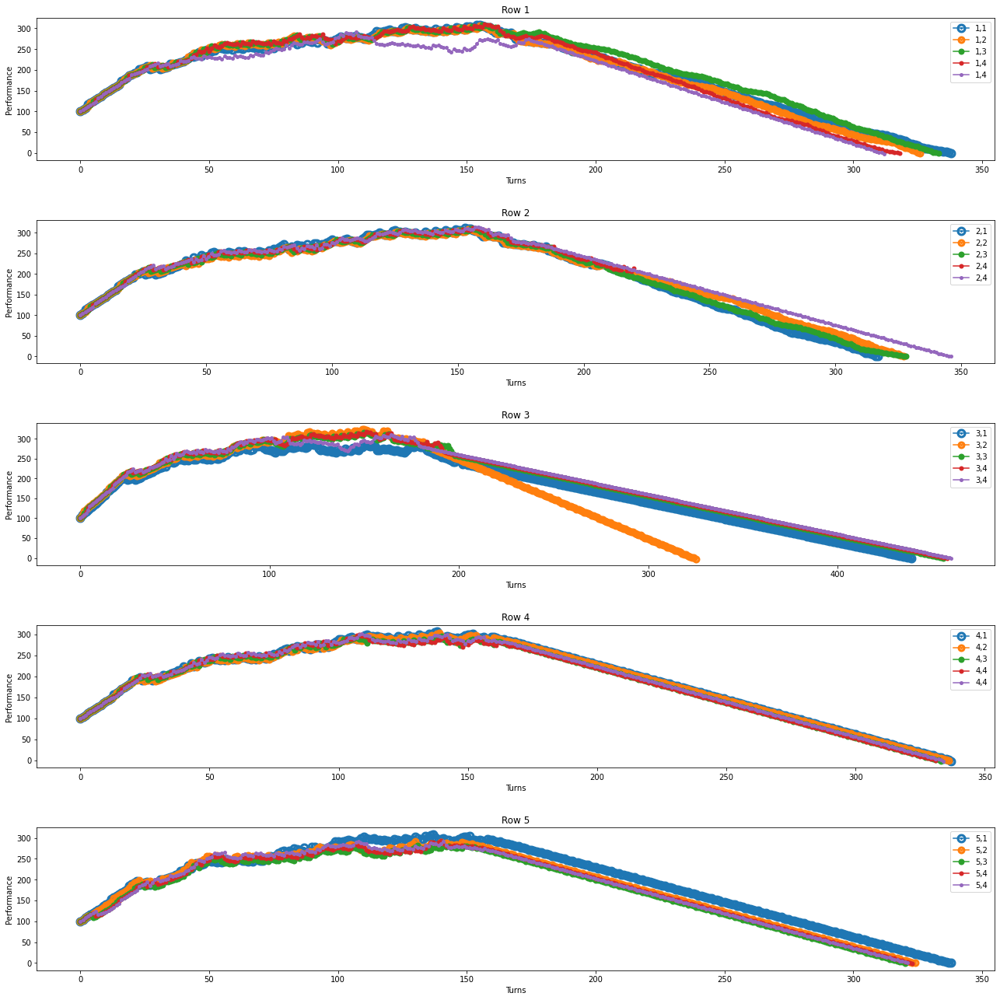

In [173]:
print_result_matrix(Obs_reflex, 'Obs_reflex.jpg')

### Results obtained for the fully observable environment with the model based agent.

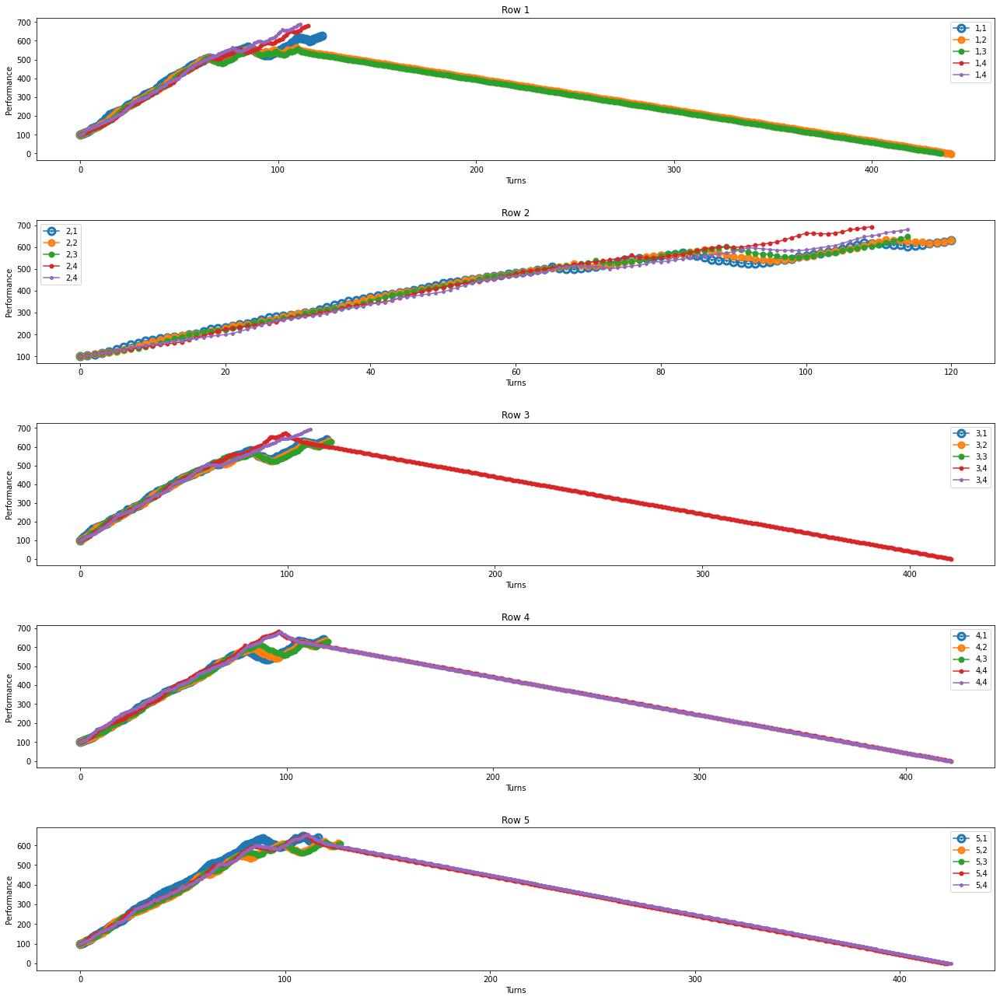

In [174]:
print_result_matrix(Obs_model, 'Obs_model.jpg')

### Results obtained in the partially observable environment with the simple reflex agent.

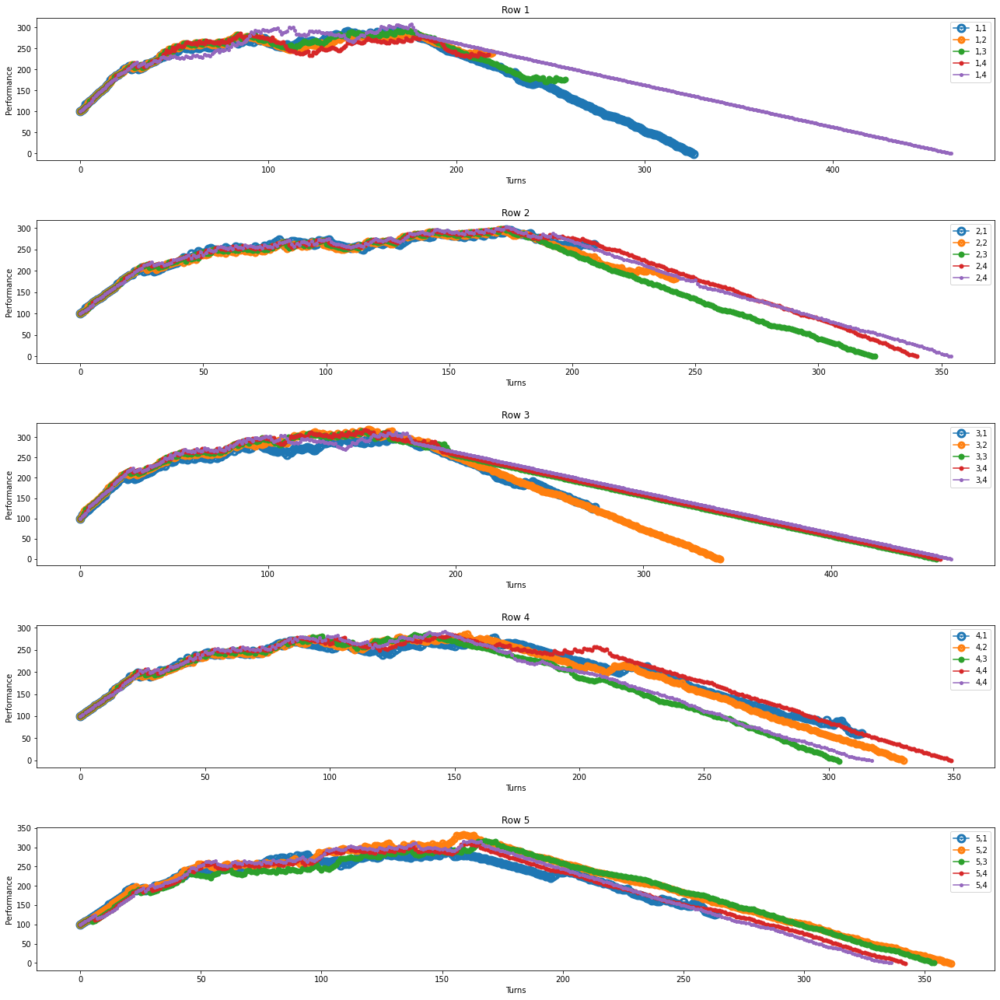

In [175]:
print_result_matrix(NObs_reflex, 'Nobs_reflex.jpg')

### Results obtained in the partially observable environment with the model based agent.

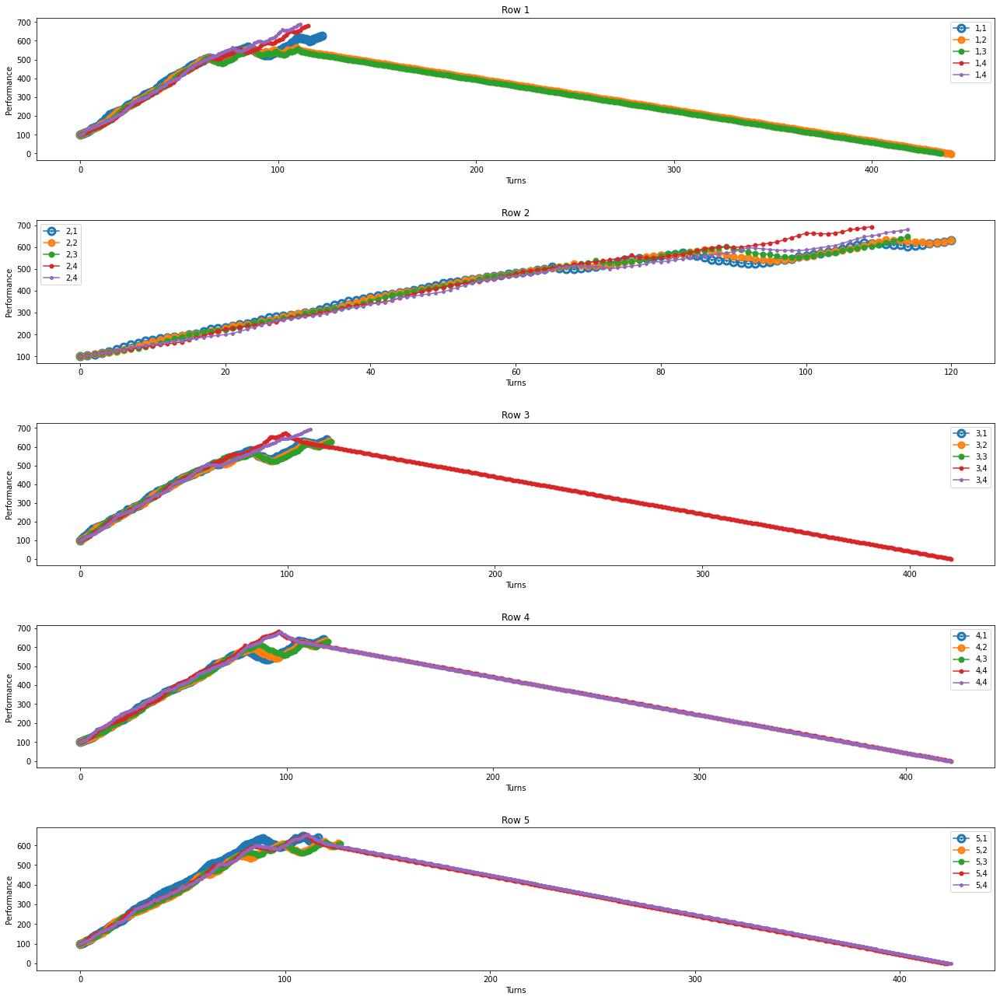

In [176]:
print_result_matrix(Nobs_model, 'Nobs_model.jpg')

## The plots show that there are some initial conditions that allow the agent to perform better than other initial positions. The fact that model based agents perform better, and that fully observable environment are easier to be solved holds.

# 4.0 Conclusions

## We made several tests to assess the performance of both agents working under two different partially and fully observable environments, where we saw the effects on the performance of the number of gold, traps, and also the starting position. In general, it is very hard to predict the behaviour of these systems, but we can conclude that the model based agent is the best performing one, and the fully observable environment is more friendly, meaning that an agent is more likely to succeed under the conditions it provides.

### We established an archaic trajectory visualization method to explore how an agent is traveling in a map.

### The more gold an environment has, the higher the expected score of a given agent will be, which is also inversely proportional to the number of traps placed. We could make even more analysis, by increasing the number of rows and columns of the environment.

### Specific conclusions and comments were made in the respective sections.

### We implemented concepts and frameworks reviewed in the first four lectures of the Intelligent Systems course